<a href="https://colab.research.google.com/github/kavyabanka/Irrigation-Cost-Optimization/blob/main/irrigationOptimization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**IRRIGATION COST OPTIMIZATION**

**Importing Libraries**

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

**Loading Data**

In [ ]:
# Load the dataset
df = pd.read_csv('/content/Train.csv')
df_test = pd.read_csv("/content/Test.csv")
data = pd.concat([df, df_test], axis=0, ignore_index=True)

In [ ]:
df.columns

Index(['ID', 'District', 'Block', 'CultLand', 'CropCultLand',
       'LandPreparationMethod', 'CropTillageDate', 'CropTillageDepth',
       'CropEstMethod', 'RcNursEstDate', 'SeedingSowingTransplanting',
       'SeedlingsPerPit', 'NursDetFactor', 'TransDetFactor',
       'TransplantingIrrigationHours', 'TransplantingIrrigationSource',
       'TransplantingIrrigationPowerSource', 'TransIrriCost', 'StandingWater',
       'OrgFertilizers', 'Ganaura', 'CropOrgFYM', 'PCropSolidOrgFertAppMethod',
       'NoFertilizerAppln', 'CropbasalFerts', 'BasalDAP', 'BasalUrea',
       'MineralFertAppMethod', 'FirstTopDressFert', '1tdUrea', '1appDaysUrea',
       '2tdUrea', '2appDaysUrea', 'MineralFertAppMethod.1', 'Harv_method',
       'Harv_date', 'Harv_hand_rent', 'Threshing_date', 'Threshing_method',
       'Residue_length', 'Residue_perc', 'Stubble_use', 'Acre', 'Yield'],
      dtype='object')

In [ ]:
df.head()

,ID,District,Block,CultLand,CropCultLand,LandPreparationMethod,CropTillageDate,CropTillageDepth,CropEstMethod,RcNursEstDate,...,Harv_method,Harv_date,Harv_hand_rent,Threshing_date,Threshing_method,Residue_length,Residue_perc,Stubble_use,Acre,Yield
0,ID_GTFAC7PEVWQ9,Nalanda,Noorsarai,45,40,TractorPlough FourWheelTracRotavator,2022-07-20,5,Manual_PuddledRandom,2022-06-27,...,machine,2022-11-16,NaN,2022-11-16,machine,30,40,plowed_in_soil,0.312500,600
1,ID_TK40ARLSPOKS,Nalanda,Rajgir,26,26,WetTillagePuddling TractorPlough FourWheelTrac...,2022-07-18,5,Manual_PuddledRandom,2022-06-20,...,hand,2022-11-25,3.0,2022-12-24,machine,24,10,plowed_in_soil,0.312500,600
2,ID_1FJY2CRIMLZZ,Gaya,Gurua,10,10,TractorPlough FourWheelTracRotavator,2022-06-30,6,Manual_PuddledRandom,2022-06-20,...,hand,2022-12-12,480.0,2023-01-11,machine,30,10,plowed_in_soil,0.148148,225
3,ID_I3IPXS4DB7NE,Gaya,Gurua,15,15,TractorPlough FourWheelTracRotavator,2022-06-16,6,Manual_PuddledRandom,2022-06-17,...,hand,2022-12-02,240.0,2022-12-29,hand,26,10,plowed_in_soil,0.222222,468
4,ID_4T8YQWXWHB4A,Nalanda,Noorsarai,60,60,TractorPlough WetTillagePuddling,2022-07-19,4,Manual_PuddledRandom,2022-06-21,...,machine,2022-11-30,NaN,2022-12-02,machine,24,40,plowed_in_soil,0.468750,550


**Exploratory Data Analysis**

In [ ]:
df.shape

(3870, 44)

In [ ]:
df.describe()

,CultLand,CropCultLand,CropTillageDepth,SeedlingsPerPit,TransplantingIrrigationHours,TransIrriCost,StandingWater,Ganaura,CropOrgFYM,NoFertilizerAppln,...,BasalUrea,1tdUrea,1appDaysUrea,2tdUrea,2appDaysUrea,Harv_hand_rent,Residue_length,Residue_perc,Acre,Yield
count,3870.000000,3870.000000,3870.000000,3581.000000,3677.000000,2988.000000,3632.000000,1453.000000,1196.000000,3870.000000,...,2166.000000,3314.000000,3314.000000,1176.000000,1170.000000,3618.000000,3870.000000,3870.000000,3870.000000,3870.000000
mean,28.527907,24.727132,4.488372,2.706507,8.017677,379.726908,3.247522,29.731590,57.445652,2.184496,...,13.351801,11.513881,29.200362,7.375000,58.764957,536.622443,26.517829,11.767442,0.292826,594.269251
std,30.454218,27.994802,1.133044,7.624397,42.612470,419.724782,2.207276,122.680882,328.251615,0.634632,...,9.701597,8.715856,12.139109,5.932502,11.356588,1138.613827,3.192873,7.064864,0.206918,651.916953
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2.000000,10.000000,0.045455,4.000000
25%,12.000000,10.000000,4.000000,2.000000,2.000000,150.000000,2.000000,1.000000,1.000000,2.000000,...,7.000000,6.000000,23.000000,4.000000,58.000000,150.000000,25.000000,10.000000,0.156250,300.000000
50%,20.000000,20.000000,4.000000,2.000000,4.000000,250.000000,3.000000,3.000000,2.000000,2.000000,...,10.000000,10.000000,28.000000,6.000000,60.000000,400.000000,26.000000,10.000000,0.227273,425.000000
75%,35.000000,30.000000,5.000000,3.000000,6.000000,450.000000,4.000000,4.000000,5.000000,3.000000,...,16.000000,15.000000,36.000000,10.000000,65.000000,700.000000,30.000000,10.000000,0.370370,740.000000
max,800.000000,800.000000,8.000000,442.000000,2000.000000,6000.000000,15.000000,1400.000000,4000.000000,4.000000,...,90.000000,90.000000,332.000000,67.000000,97.000000,60000.000000,30.000000,40.000000,2.187500,16800.000000


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3870 entries, 0 to 3869
Data columns (total 44 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   ID                                  3870 non-null   object 
 1   District                            3870 non-null   object 
 2   Block                               3870 non-null   object 
 3   CultLand                            3870 non-null   int64  
 4   CropCultLand                        3870 non-null   int64  
 5   LandPreparationMethod               3870 non-null   object 
 6   CropTillageDate                     3870 non-null   object 
 7   CropTillageDepth                    3870 non-null   int64  
 8   CropEstMethod                       3870 non-null   object 
 9   RcNursEstDate                       3787 non-null   object 
 10  SeedingSowingTransplanting          3870 non-null   object 
 11  SeedlingsPerPit                     3581 no

**Data Cleaning**

In [ ]:
df.duplicated().sum()

0

In [ ]:
df.isnull().sum()

ID                                       0
District                                 0
Block                                    0
CultLand                                 0
CropCultLand                             0
LandPreparationMethod                    0
CropTillageDate                          0
CropTillageDepth                         0
CropEstMethod                            0
RcNursEstDate                           83
SeedingSowingTransplanting               0
SeedlingsPerPit                        289
NursDetFactor                          289
TransDetFactor                         289
TransplantingIrrigationHours           193
TransplantingIrrigationSource          115
TransplantingIrrigationPowerSource     503
TransIrriCost                          882
StandingWater                          238
OrgFertilizers                        1335
Ganaura                               2417
CropOrgFYM                            2674
PCropSolidOrgFertAppMethod            1337
NoFertilize

In [ ]:
null_count = df.isnull().sum()
feature_with_null = null_count[null_count > 0].index
#.index gives the column of the not null values
print(feature_with_null)

Index(['RcNursEstDate', 'SeedlingsPerPit', 'NursDetFactor', 'TransDetFactor',
       'TransplantingIrrigationHours', 'TransplantingIrrigationSource',
       'TransplantingIrrigationPowerSource', 'TransIrriCost', 'StandingWater',
       'OrgFertilizers', 'Ganaura', 'CropOrgFYM', 'PCropSolidOrgFertAppMethod',
       'CropbasalFerts', 'BasalDAP', 'BasalUrea', 'FirstTopDressFert',
       '1tdUrea', '1appDaysUrea', '2tdUrea', '2appDaysUrea',
       'MineralFertAppMethod.1', 'Harv_hand_rent'],
      dtype='object')


In [ ]:
null_counts = df[['RcNursEstDate', 'SeedlingsPerPit', 'NursDetFactor', 'TransDetFactor',
       'TransplantingIrrigationHours', 'TransplantingIrrigationSource',
       'TransplantingIrrigationPowerSource', 'TransIrriCost', 'StandingWater',
       'OrgFertilizers', 'CropOrgFYM', 'CropbasalFerts', 'BasalDAP',
       'BasalUrea', 'FirstTopDressFert', '1tdUrea', '1appDaysUrea',
       'MineralFertAppMethod.1', 'Harv_hand_rent']].isnull().sum()
print(null_counts)

RcNursEstDate                           83
SeedlingsPerPit                        289
NursDetFactor                          289
TransDetFactor                         289
TransplantingIrrigationHours           193
TransplantingIrrigationSource          115
TransplantingIrrigationPowerSource     503
TransIrriCost                          882
StandingWater                          238
OrgFertilizers                        1335
CropOrgFYM                            2674
CropbasalFerts                         188
BasalDAP                               543
BasalUrea                             1704
FirstTopDressFert                      485
1tdUrea                                556
1appDaysUrea                           556
MineralFertAppMethod.1                 481
Harv_hand_rent                         252
dtype: int64


In [ ]:
# object columns consist of data type object and numeric columns consist of data type float, integer
object_col = df.select_dtypes(include = 'object').columns.tolist()
numeric_col = df.select_dtypes(include = ['int', 'float']).columns.tolist()
print("object columns : ", object_col)
print("numeric columns : ", numeric_col)

object columns :  ['ID', 'District', 'Block', 'LandPreparationMethod', 'CropTillageDate', 'CropEstMethod', 'RcNursEstDate', 'SeedingSowingTransplanting', 'NursDetFactor', 'TransDetFactor', 'TransplantingIrrigationSource', 'TransplantingIrrigationPowerSource', 'OrgFertilizers', 'PCropSolidOrgFertAppMethod', 'CropbasalFerts', 'MineralFertAppMethod', 'FirstTopDressFert', 'MineralFertAppMethod.1', 'Harv_method', 'Harv_date', 'Threshing_date', 'Threshing_method', 'Stubble_use']
numeric columns :  ['CultLand', 'CropCultLand', 'CropTillageDepth', 'SeedlingsPerPit', 'TransplantingIrrigationHours', 'TransIrriCost', 'StandingWater', 'Ganaura', 'CropOrgFYM', 'NoFertilizerAppln', 'BasalDAP', 'BasalUrea', '1tdUrea', '1appDaysUrea', '2tdUrea', '2appDaysUrea', 'Harv_hand_rent', 'Residue_length', 'Residue_perc', 'Acre', 'Yield']


In [ ]:
# Impute missing values in categorical columns with the mode
categorical_columns = data.select_dtypes(include=['object']).columns
for col in categorical_columns:
    data[col].fillna(data[col].mode()[0], inplace=True)

# Impute missing values in numerical columns with the mean
numerical_columns = data.select_dtypes(exclude=['object']).columns
for col in numerical_columns:
    data[col].fillna(data[col].mean(), inplace=True)
data['Yield']

0       600.000000
1       600.000000
2       225.000000
3       468.000000
4       550.000000
           ...    
5155    594.269251
5156    594.269251
5157    594.269251
5158    594.269251
5159    594.269251
Name: Yield, Length: 5160, dtype: float64

In [ ]:
df.describe()

,CultLand,CropCultLand,CropTillageDepth,SeedlingsPerPit,TransplantingIrrigationHours,TransIrriCost,StandingWater,Ganaura,CropOrgFYM,NoFertilizerAppln,...,BasalUrea,1tdUrea,1appDaysUrea,2tdUrea,2appDaysUrea,Harv_hand_rent,Residue_length,Residue_perc,Acre,Yield
count,3870.000000,3870.000000,3870.000000,3581.000000,3677.000000,2988.000000,3632.000000,1453.000000,1196.000000,3870.000000,...,2166.000000,3314.000000,3314.000000,1176.000000,1170.000000,3618.000000,3870.000000,3870.000000,3870.000000,3870.000000
mean,28.527907,24.727132,4.488372,2.706507,8.017677,379.726908,3.247522,29.731590,57.445652,2.184496,...,13.351801,11.513881,29.200362,7.375000,58.764957,536.622443,26.517829,11.767442,0.292826,594.269251
std,30.454218,27.994802,1.133044,7.624397,42.612470,419.724782,2.207276,122.680882,328.251615,0.634632,...,9.701597,8.715856,12.139109,5.932502,11.356588,1138.613827,3.192873,7.064864,0.206918,651.916953
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2.000000,10.000000,0.045455,4.000000
25%,12.000000,10.000000,4.000000,2.000000,2.000000,150.000000,2.000000,1.000000,1.000000,2.000000,...,7.000000,6.000000,23.000000,4.000000,58.000000,150.000000,25.000000,10.000000,0.156250,300.000000
50%,20.000000,20.000000,4.000000,2.000000,4.000000,250.000000,3.000000,3.000000,2.000000,2.000000,...,10.000000,10.000000,28.000000,6.000000,60.000000,400.000000,26.000000,10.000000,0.227273,425.000000
75%,35.000000,30.000000,5.000000,3.000000,6.000000,450.000000,4.000000,4.000000,5.000000,3.000000,...,16.000000,15.000000,36.000000,10.000000,65.000000,700.000000,30.000000,10.000000,0.370370,740.000000
max,800.000000,800.000000,8.000000,442.000000,2000.000000,6000.000000,15.000000,1400.000000,4000.000000,4.000000,...,90.000000,90.000000,332.000000,67.000000,97.000000,60000.000000,30.000000,40.000000,2.187500,16800.000000


THERE ARE NO NULL VALUES IN OUR DATA

In [ ]:
df.nunique()

ID                                    3870
District                                 4
Block                                    9
CultLand                                95
CropCultLand                            91
LandPreparationMethod                   43
CropTillageDate                         78
CropTillageDepth                         8
CropEstMethod                            4
RcNursEstDate                           61
SeedingSowingTransplanting              62
SeedlingsPerPit                         21
NursDetFactor                          125
TransDetFactor                         155
TransplantingIrrigationHours            43
TransplantingIrrigationSource            6
TransplantingIrrigationPowerSource       3
TransIrriCost                          100
StandingWater                           14
OrgFertilizers                          31
Ganaura                                 35
CropOrgFYM                              44
PCropSolidOrgFertAppMethod               4
NoFertilize

**Data Visualization**

UNIVARIANT

In [ ]:
#count plot using plotly we can use this as reference
for i in object_col:
  fig = go.Figure(data = [go.Bar(x = df[i].value_counts().index, y = df[i].value_counts())])
  fig.update_layout(
      title = i,
      xaxis_title = i,
      yaxis_title = 'Count')
  fig.show()

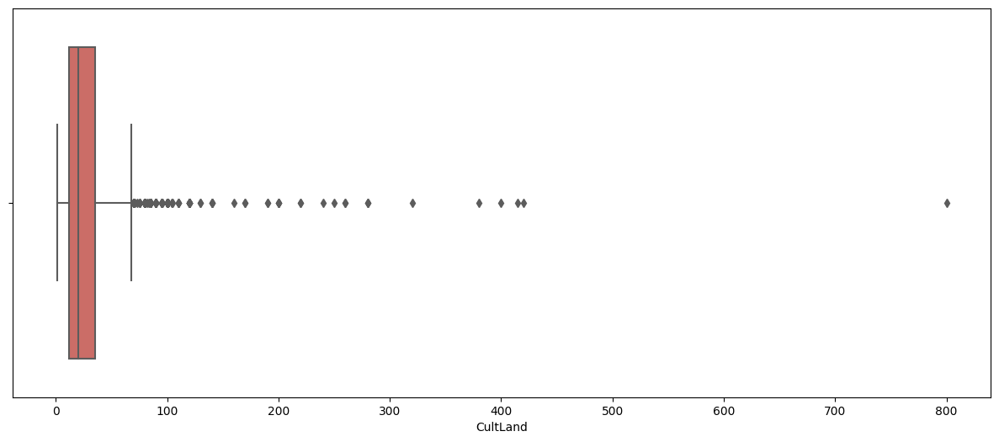

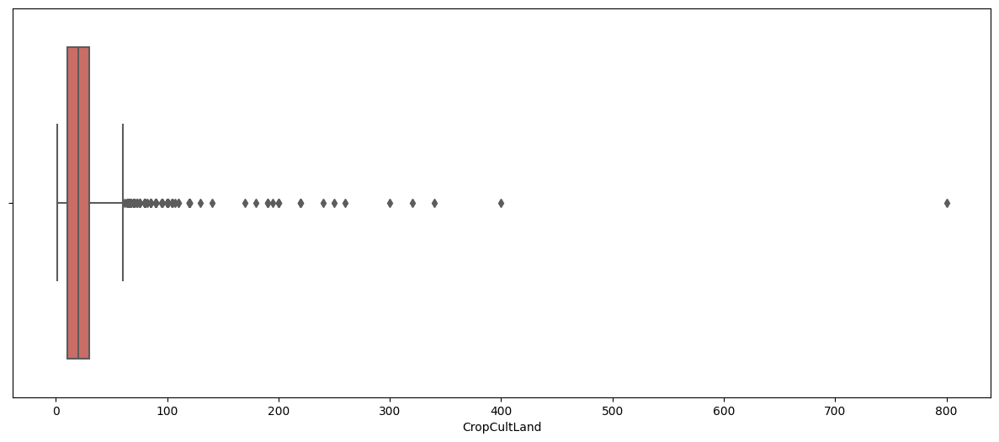

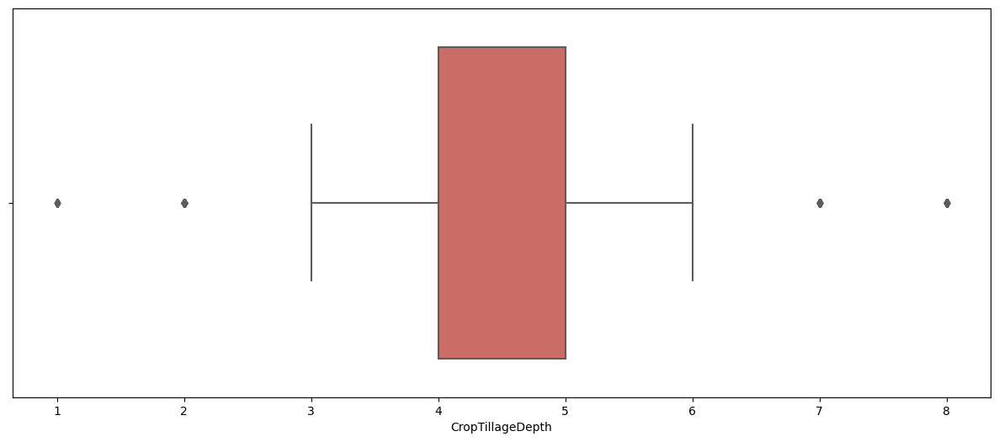

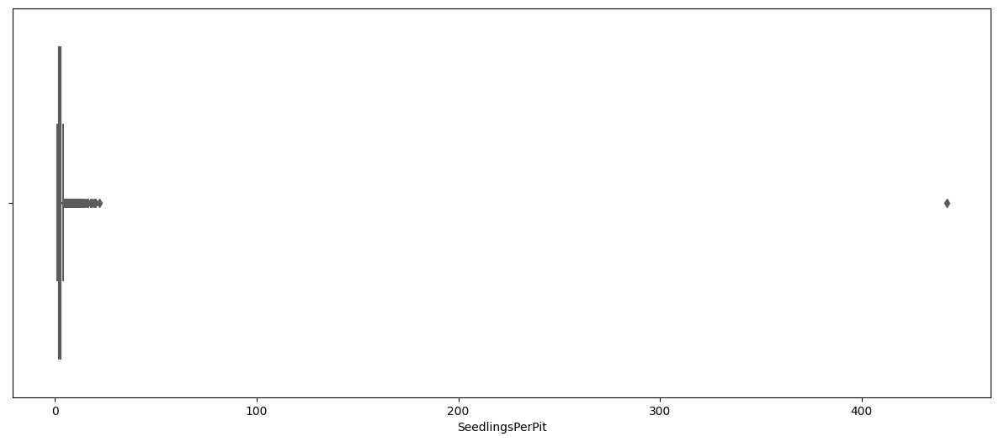

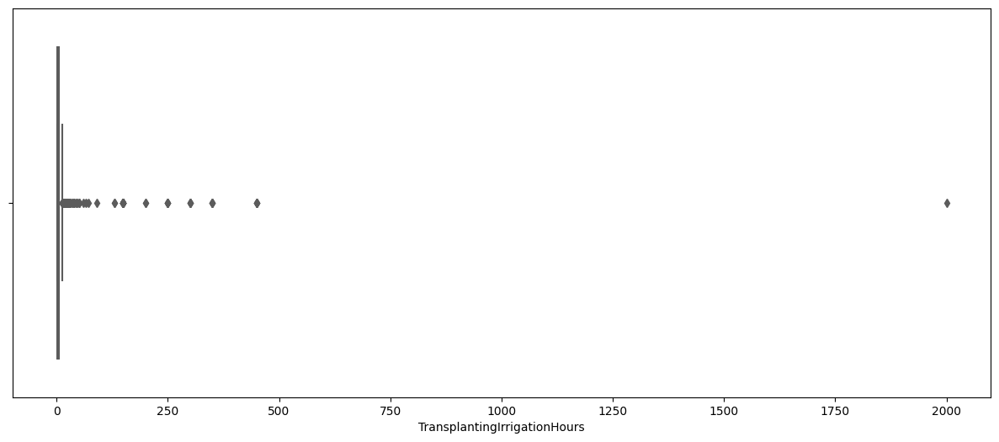

...

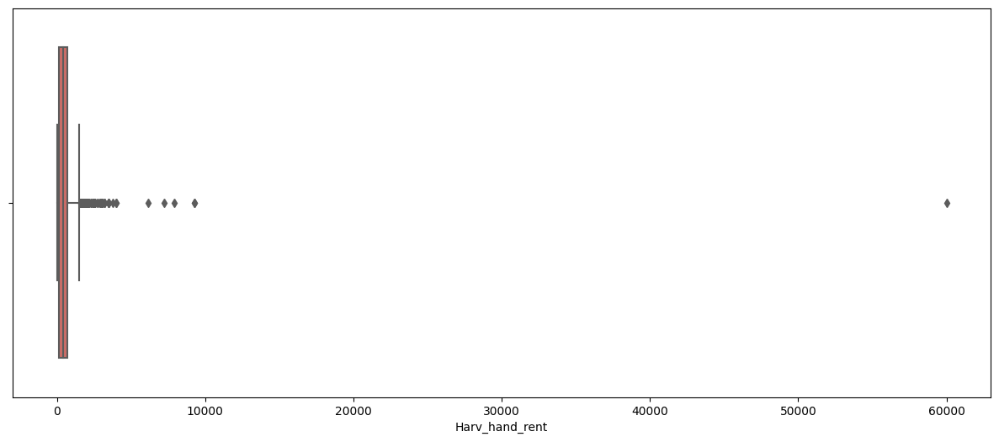

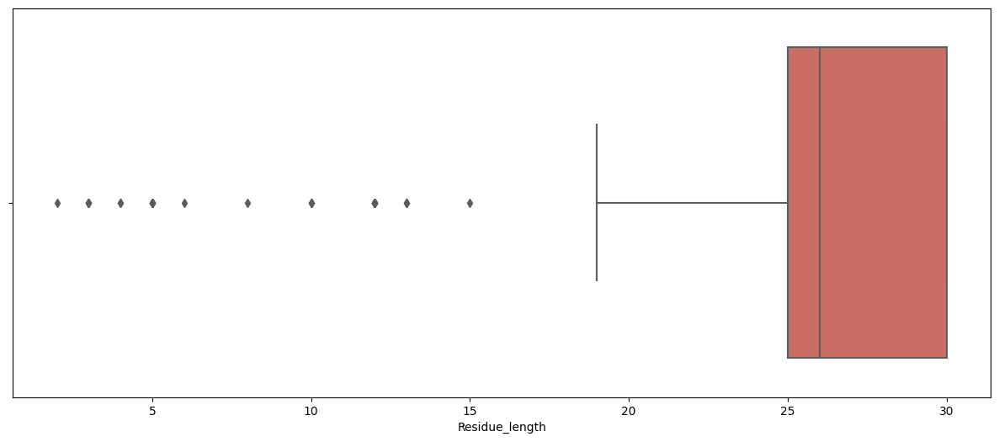

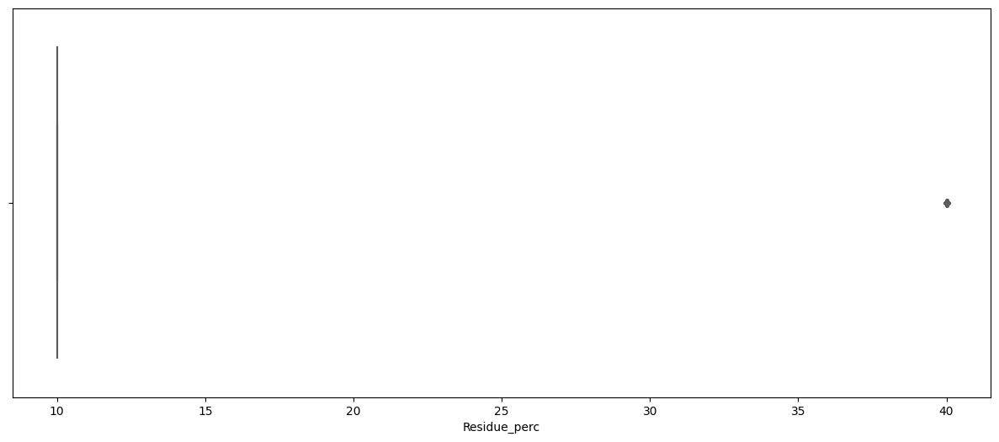

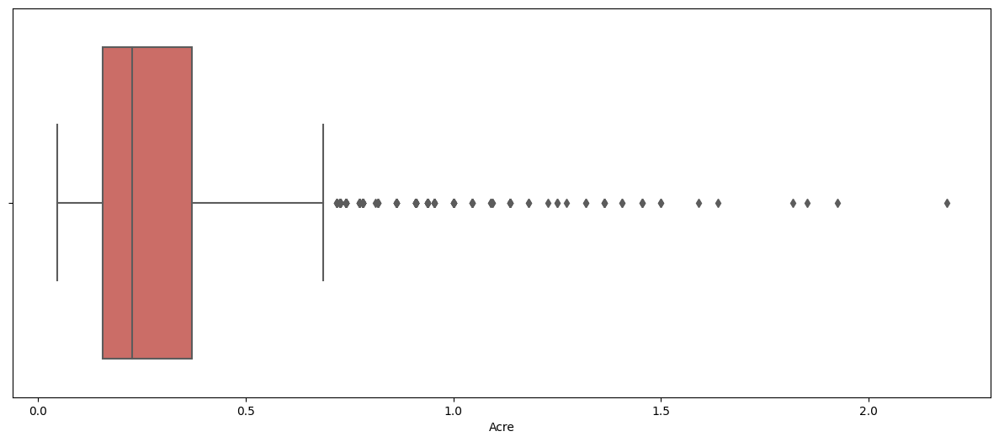

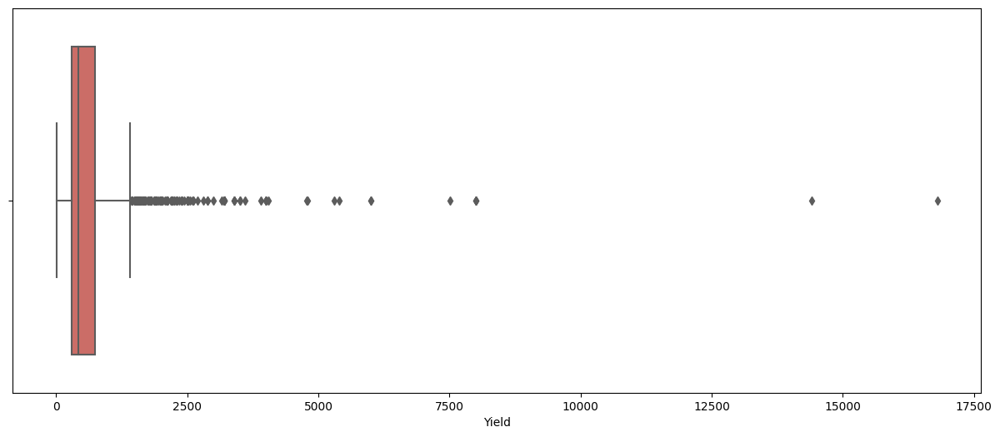

In [ ]:
for i in numeric_col:
  plt.figure(figsize = (15, 6))
  sns.boxplot(x = df[i],data =  df, palette = 'hls')
  plt.xticks(rotation = 0)
  plt.show()

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




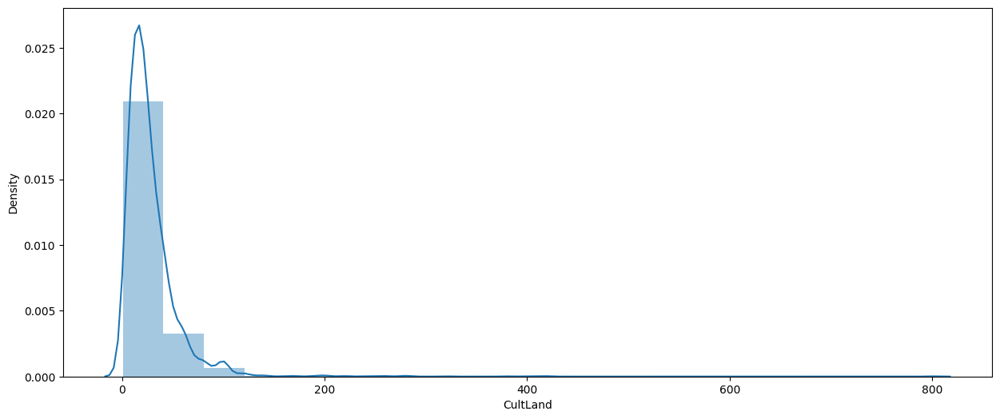

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




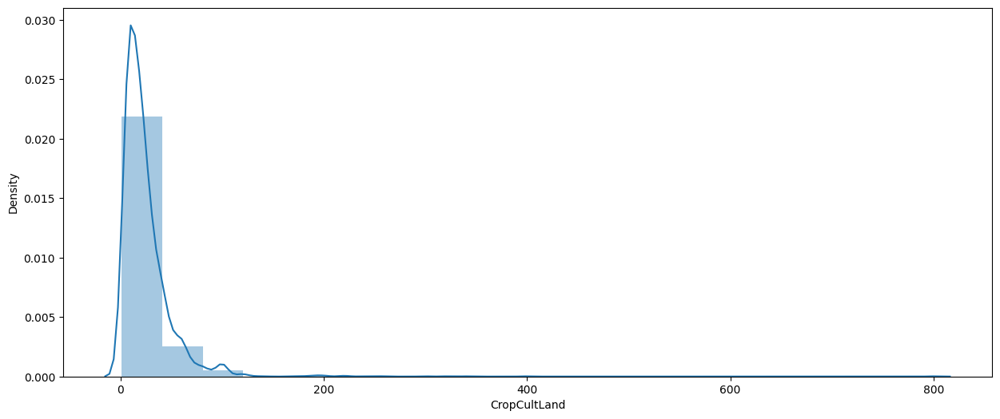

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




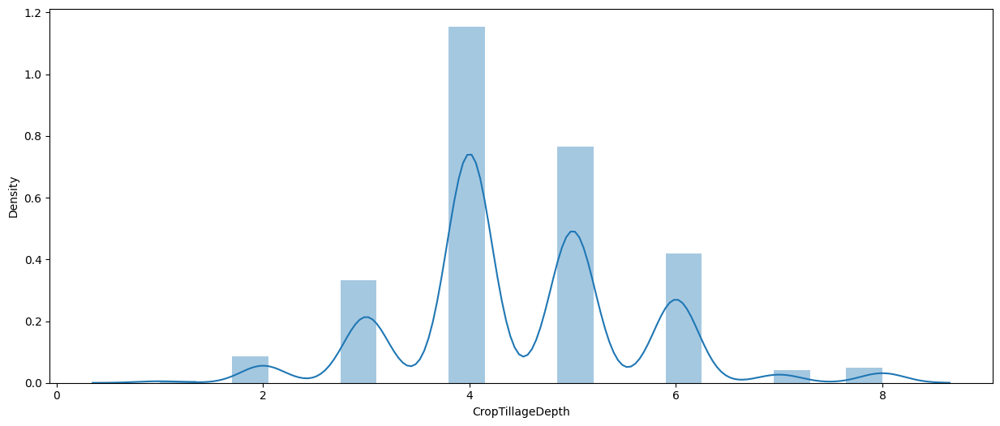

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




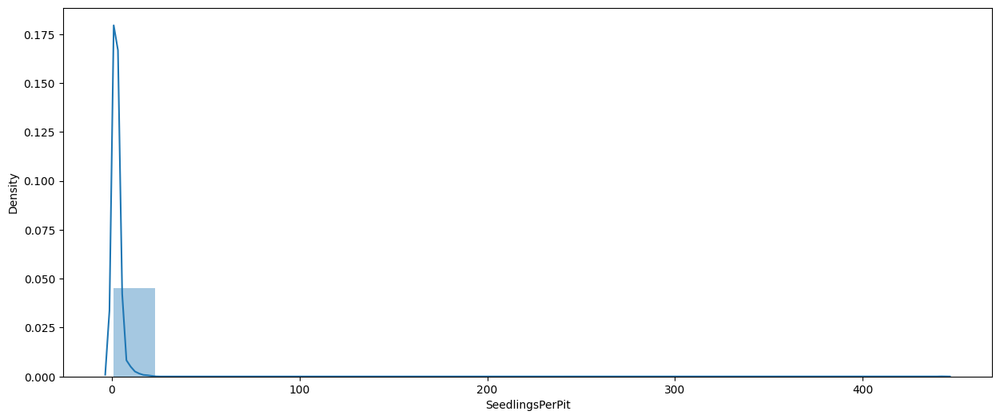

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




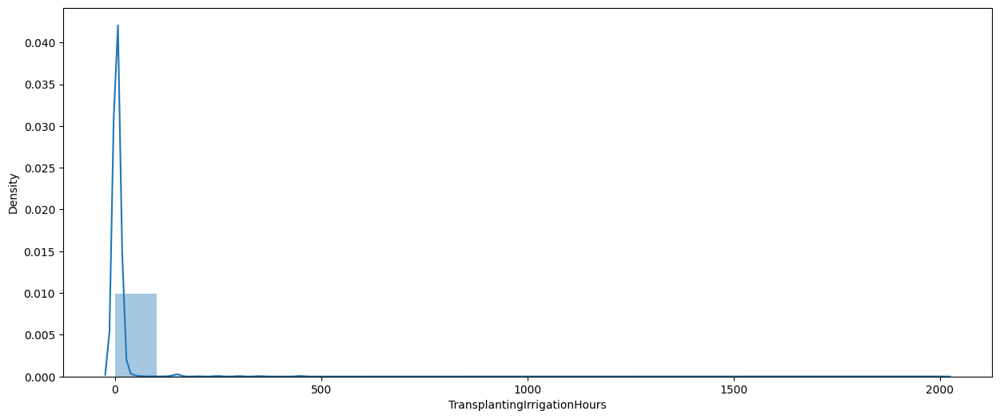

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




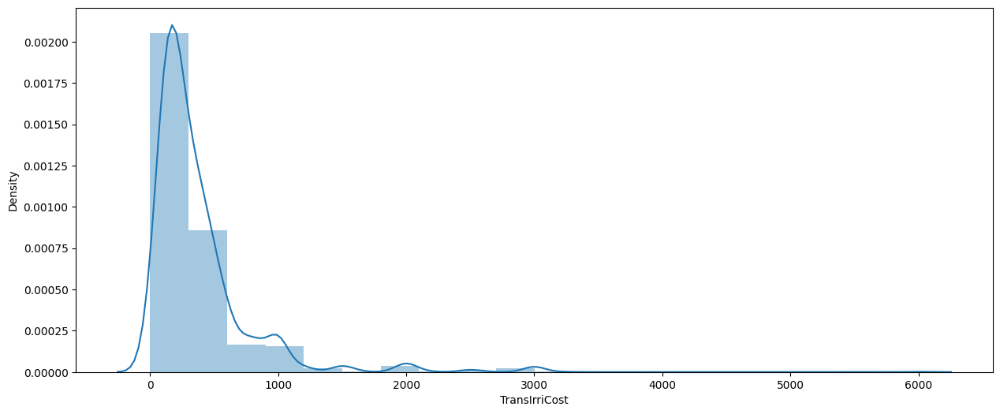

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




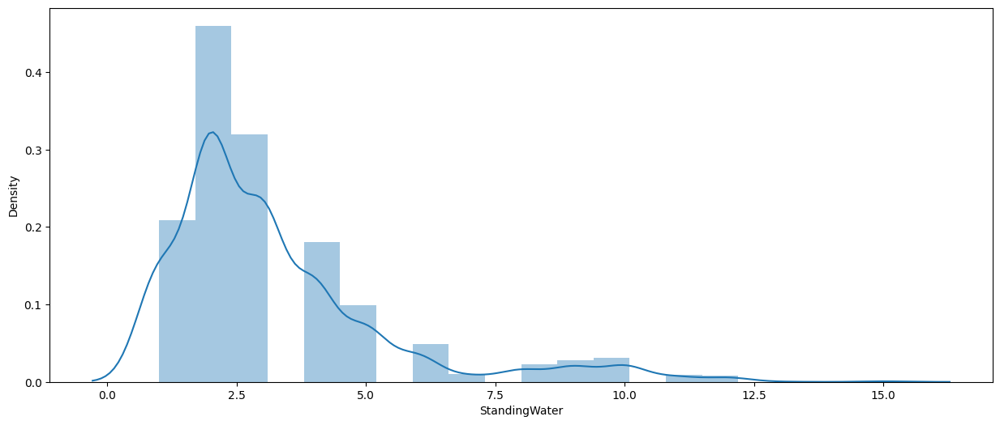

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




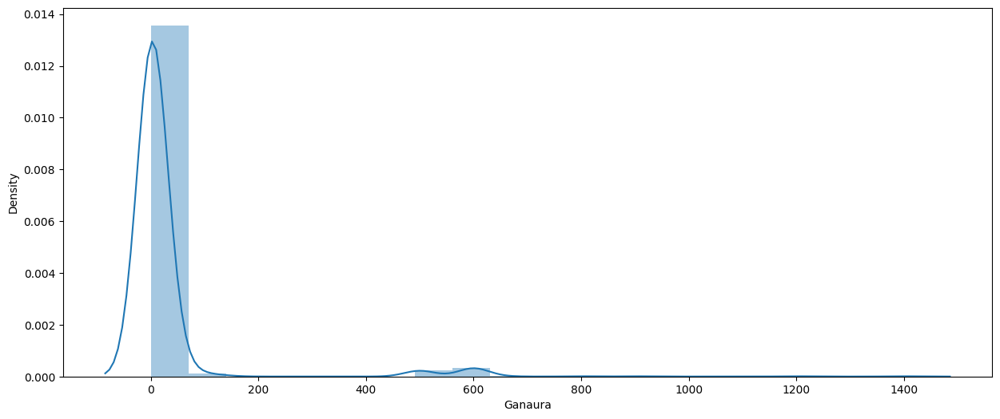

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




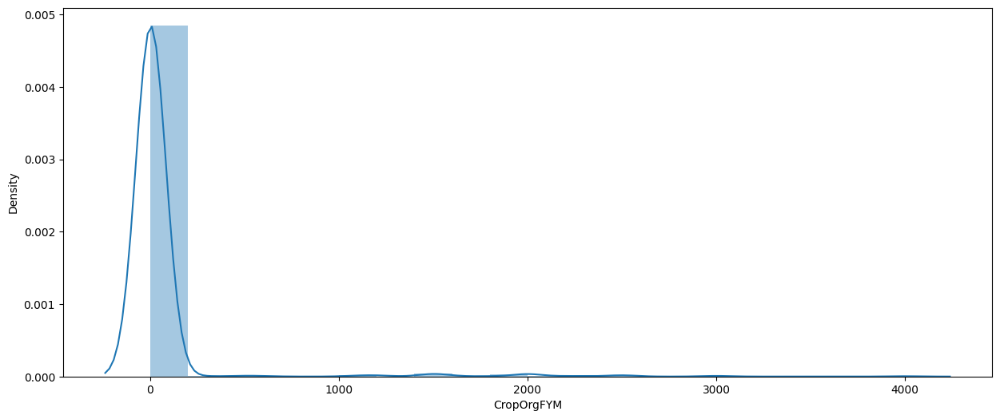

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




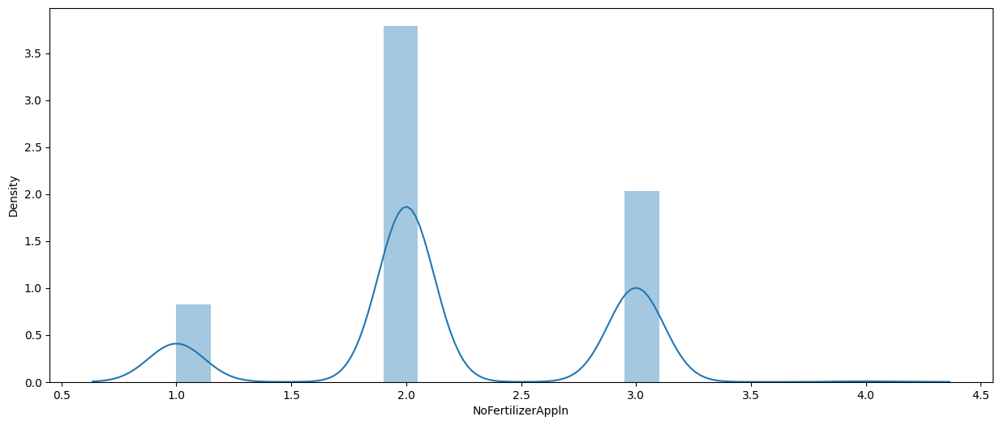

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




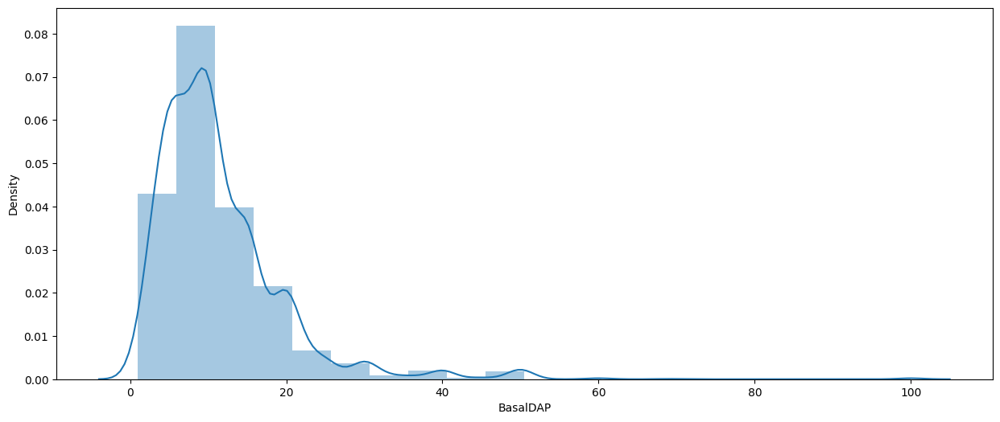

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




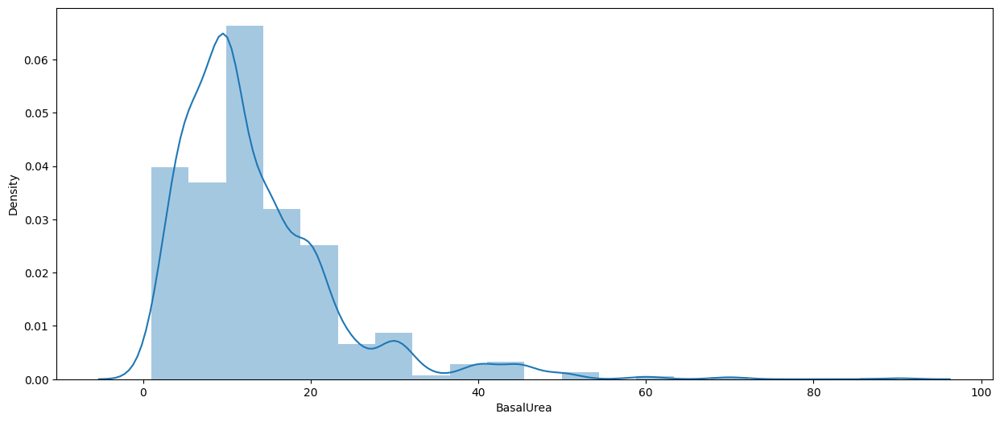

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




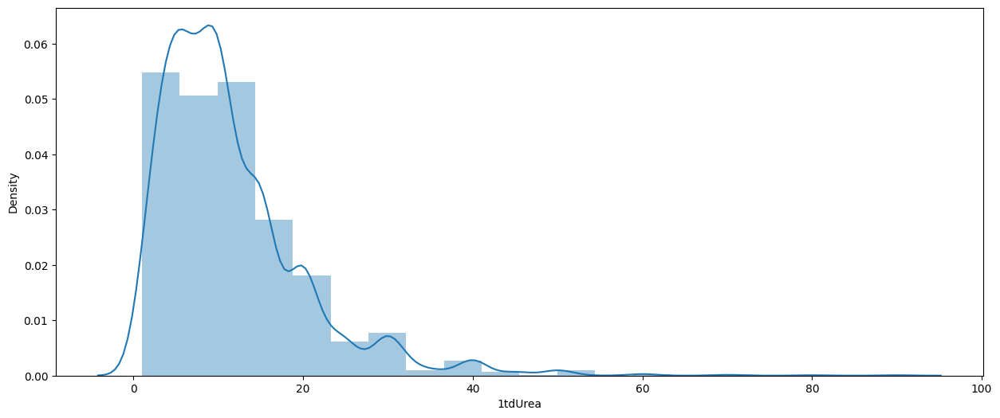

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




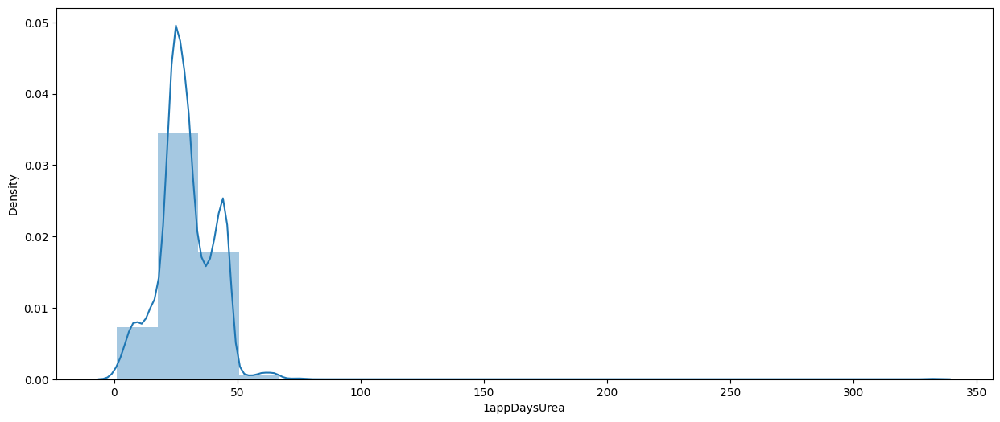

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




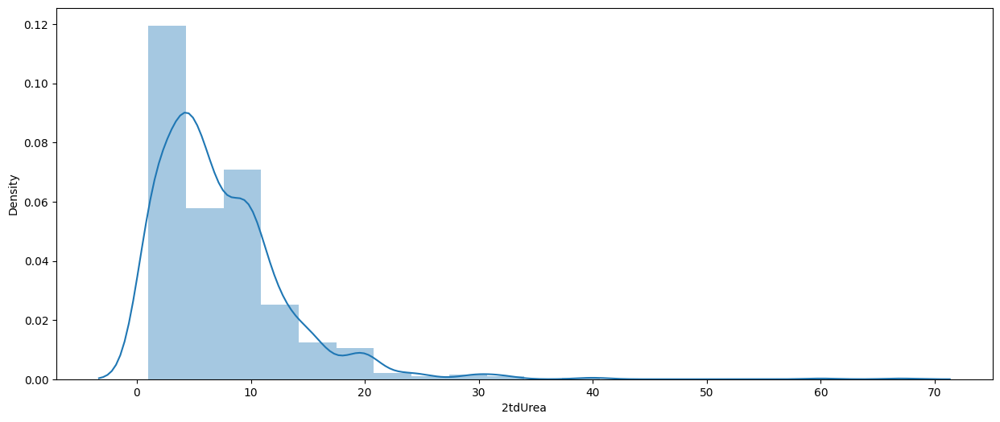

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




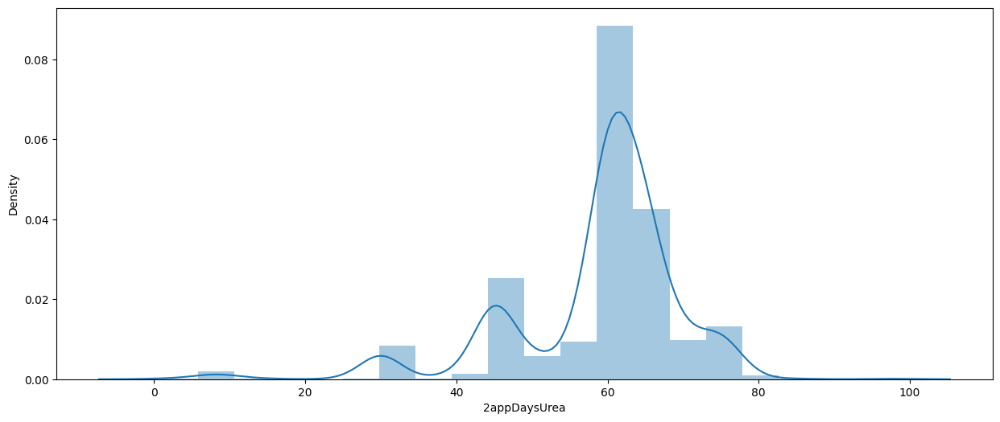

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




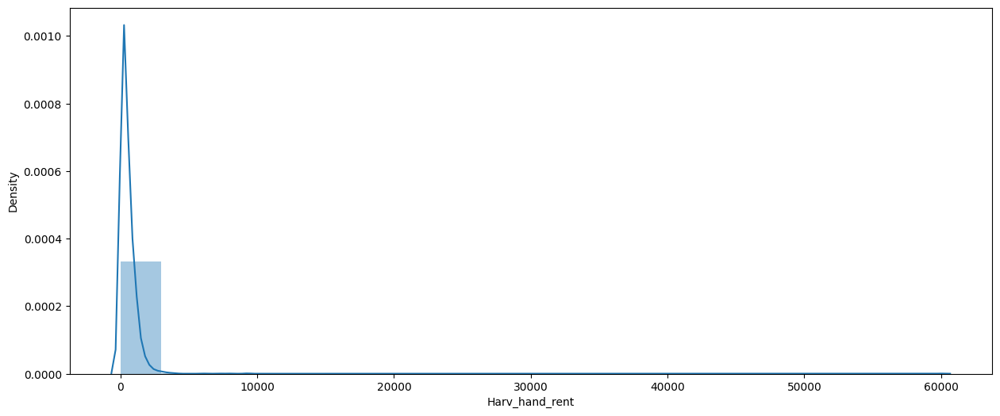

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




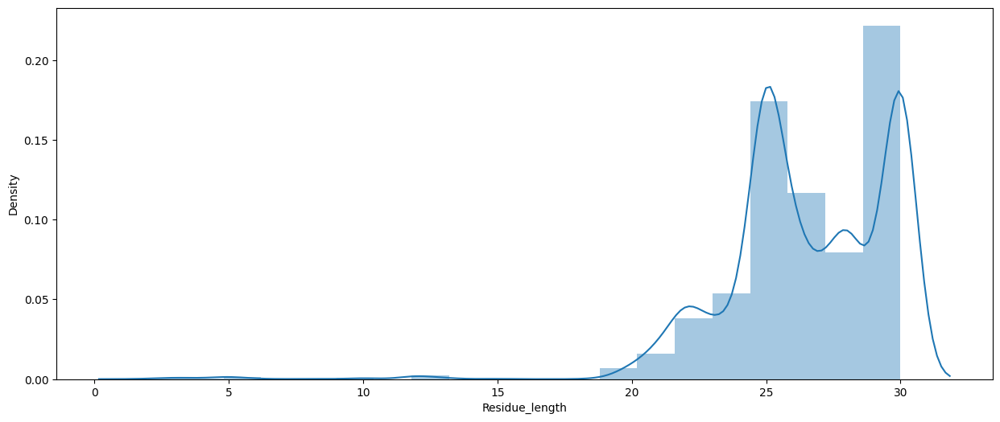

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




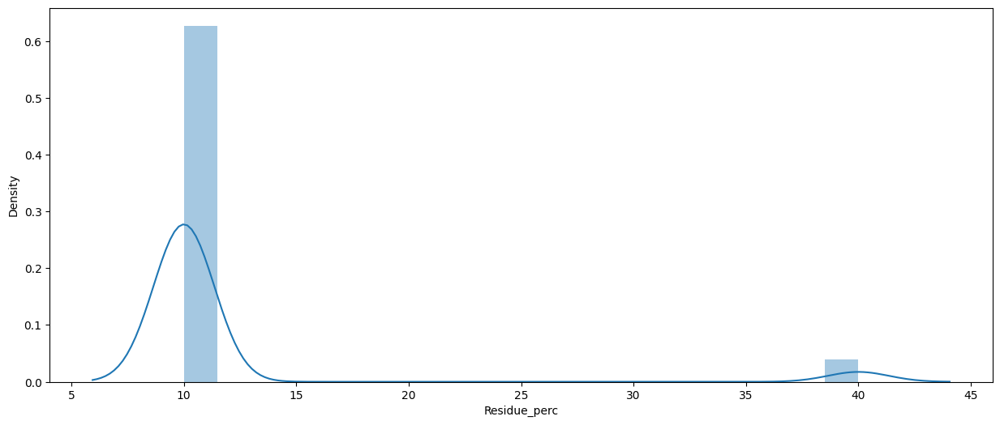

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




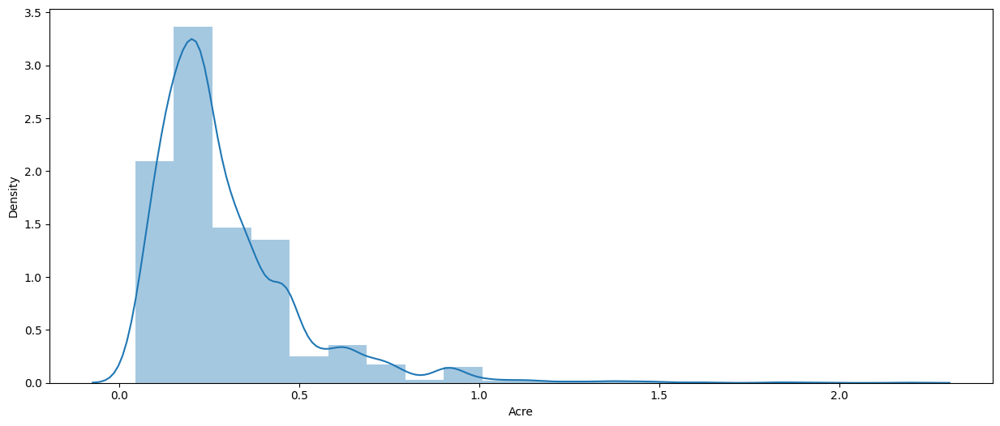

<ipython-input-53-988a764e5dfa>:3: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




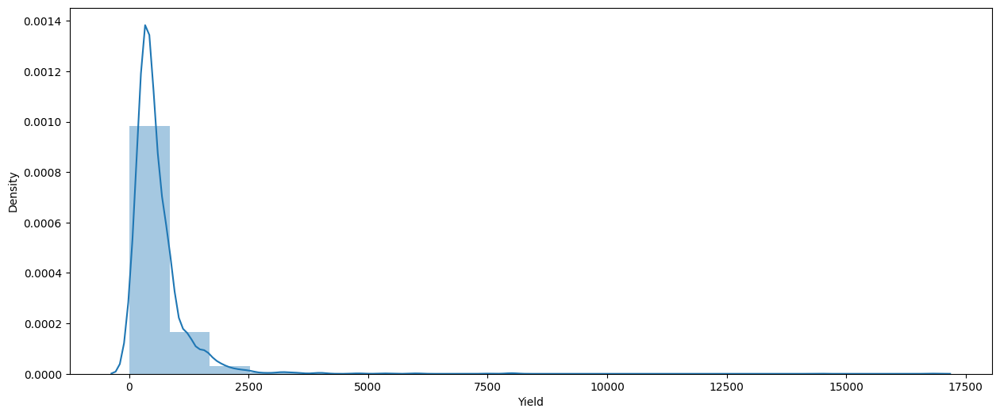

In [ ]:
for i in numeric_col:
  plt.figure(figsize = (15, 6))
  sns.distplot(df[i], kde = True, bins = 20)
  plt.xticks(rotation = 0)
  plt.show()

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



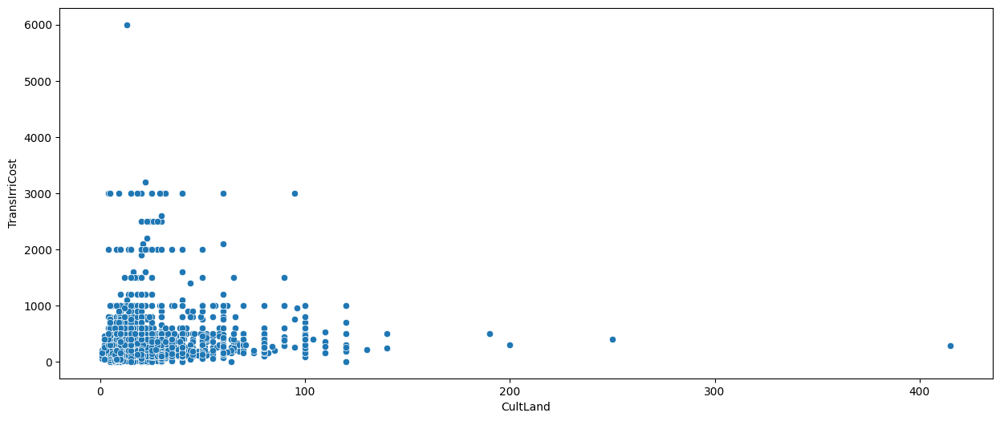

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



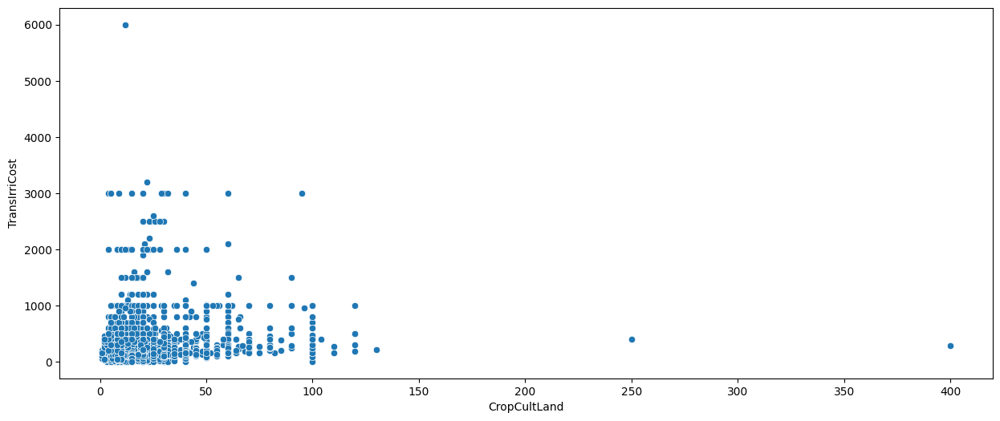

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



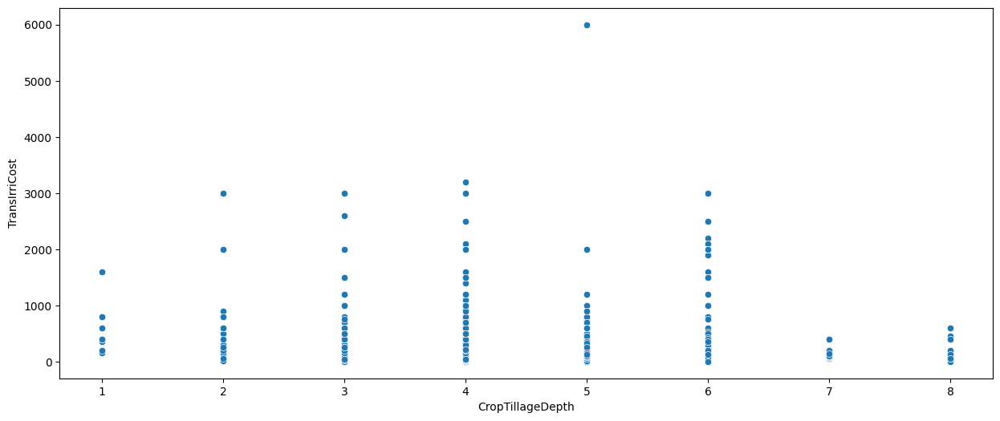

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



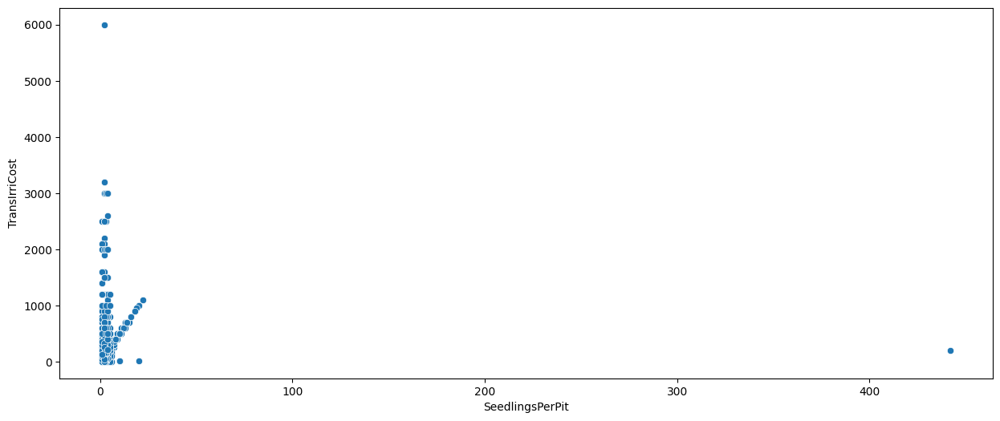

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



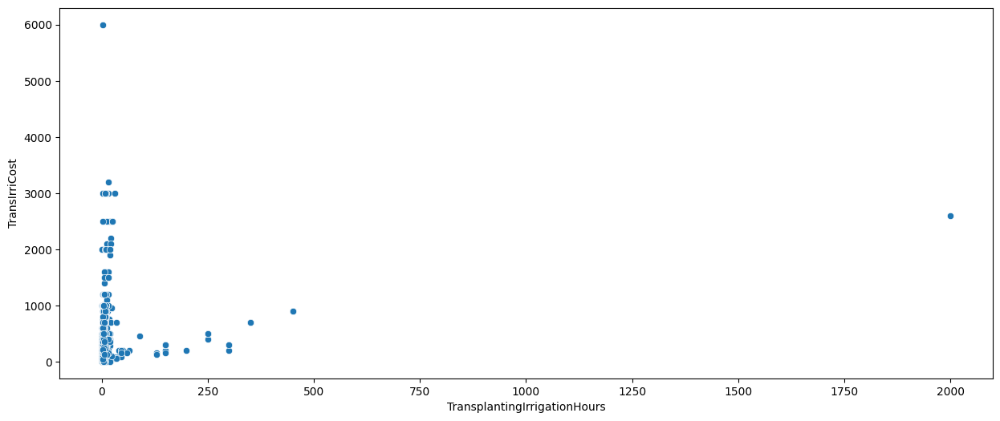

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



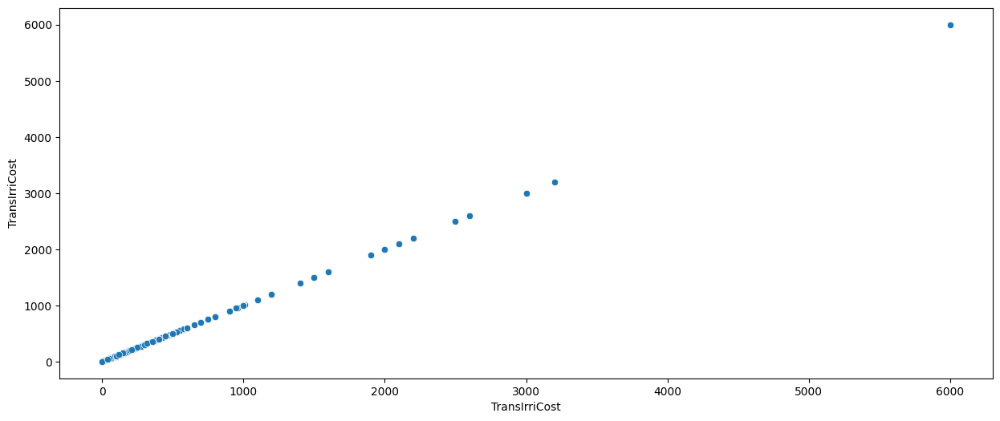

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



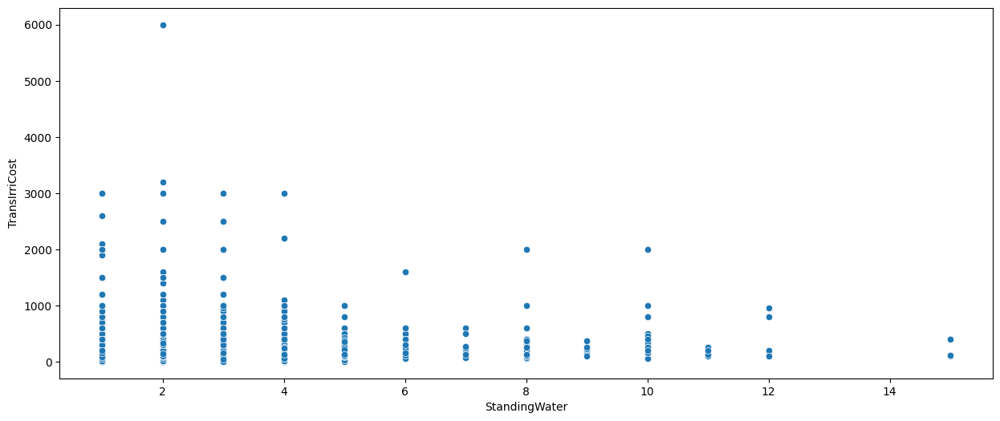

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



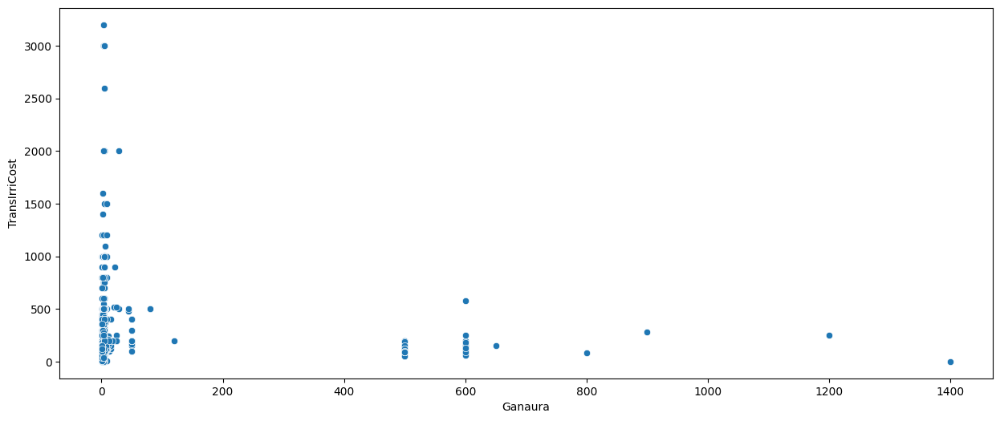

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



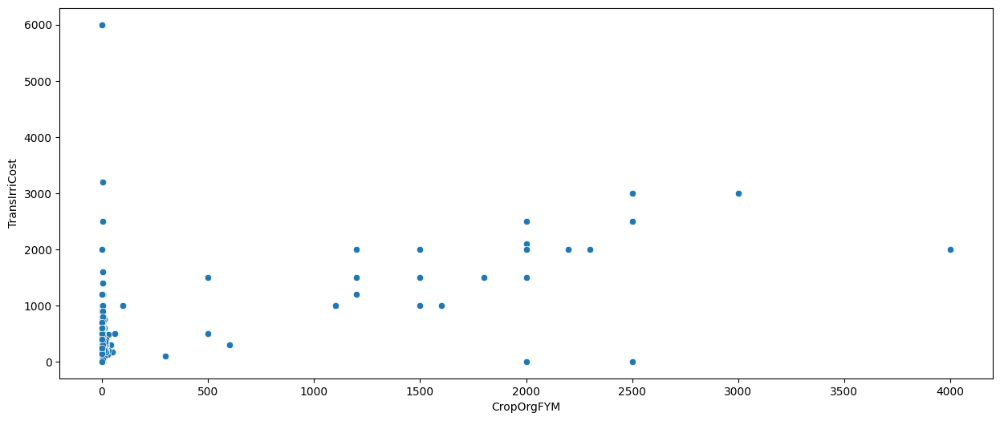

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



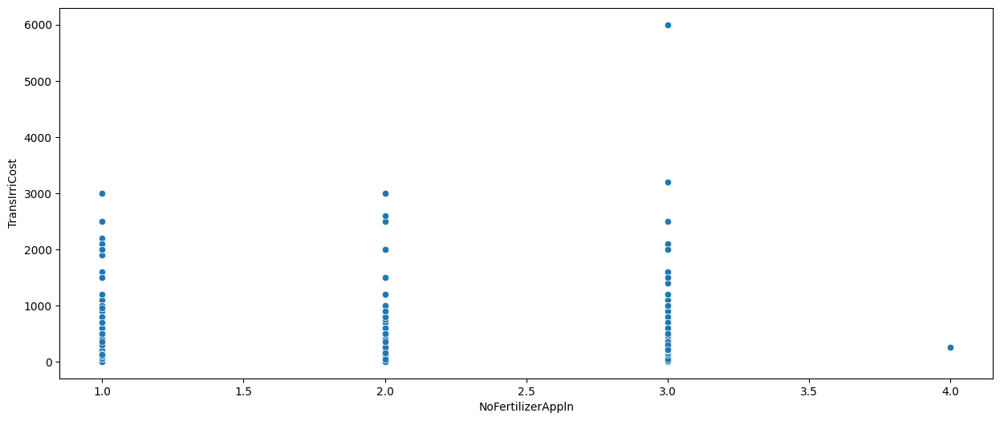

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



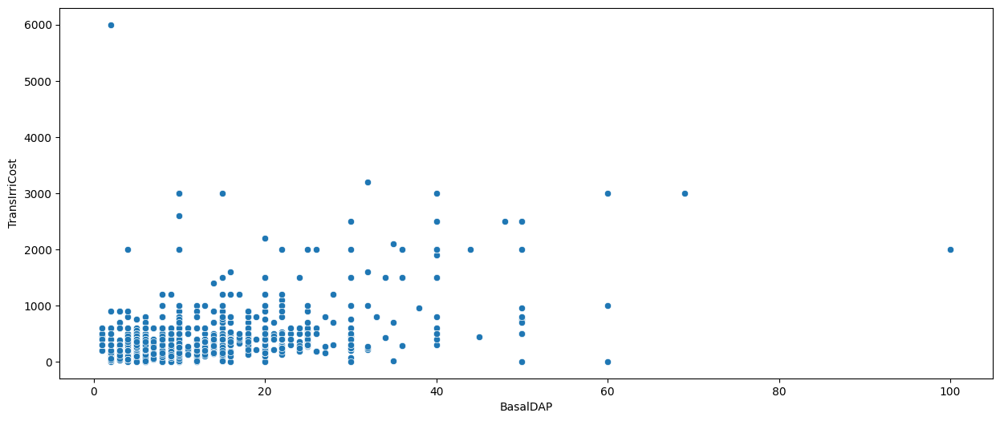

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



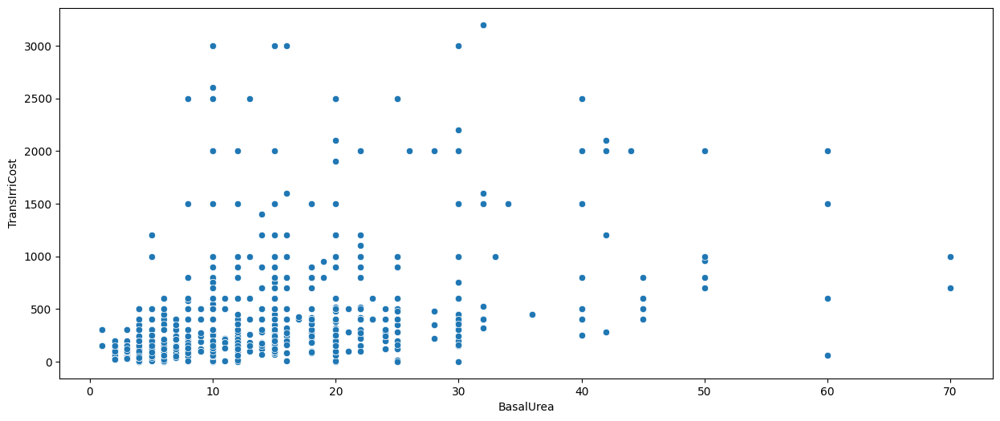

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



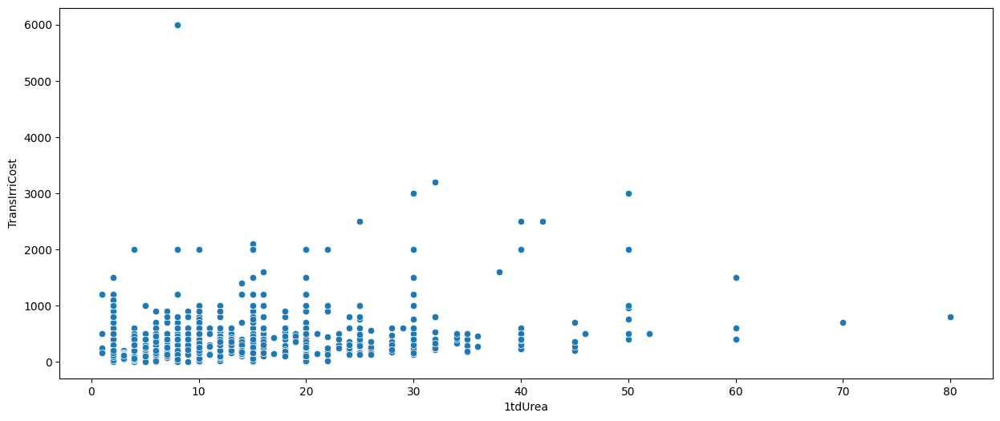

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



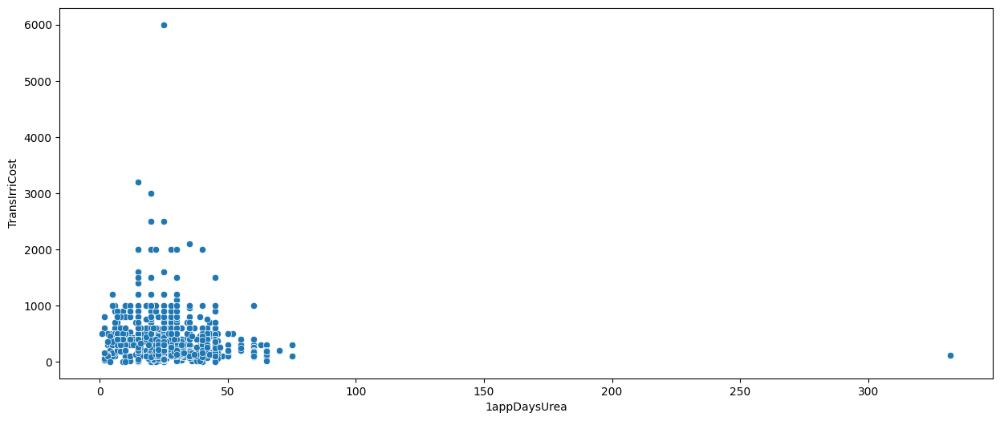

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



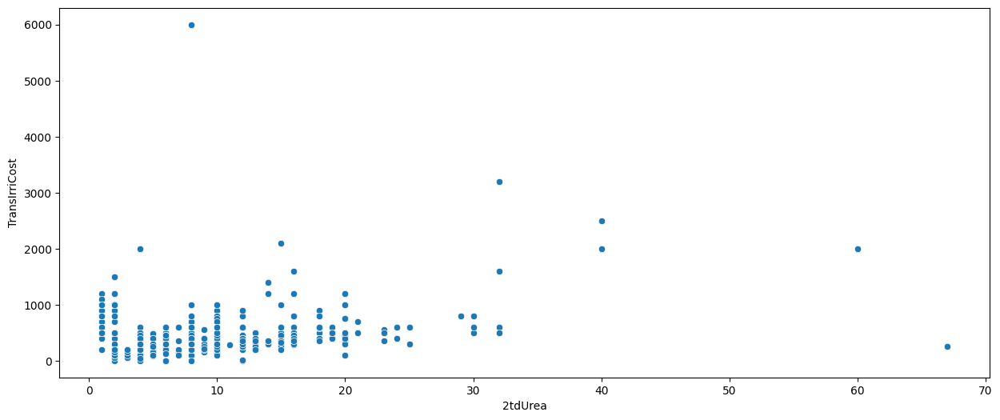

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



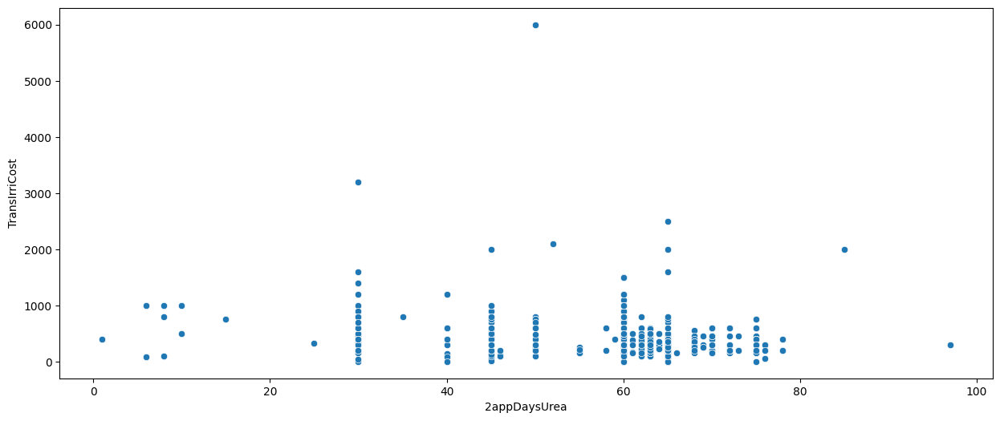

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



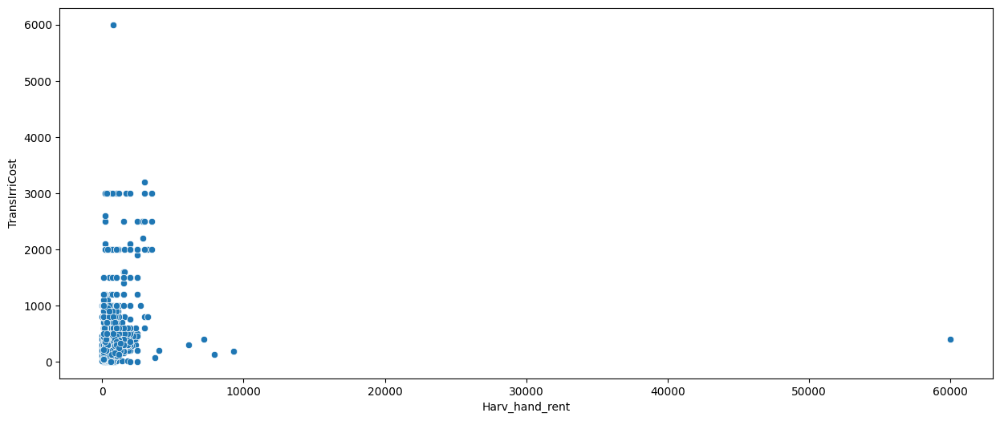

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



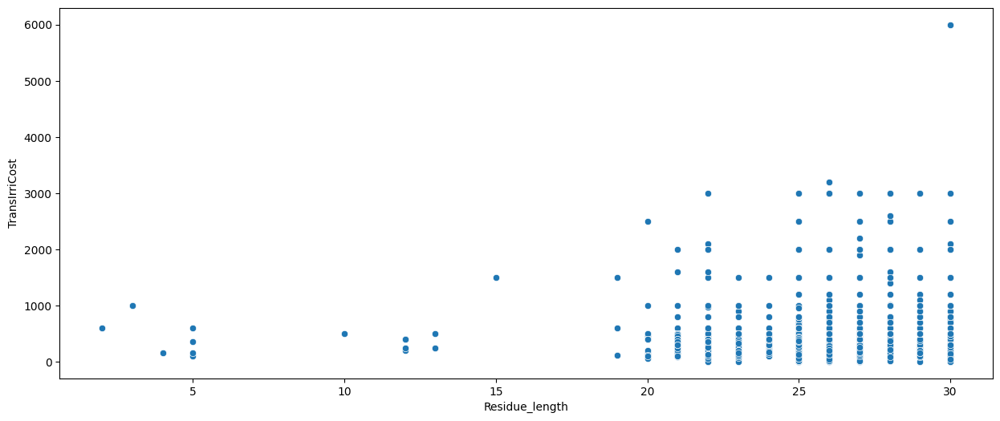

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



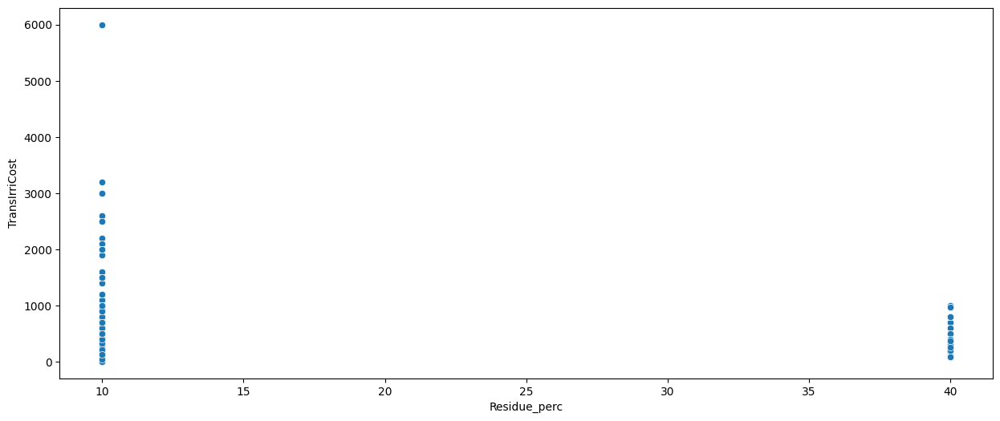

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



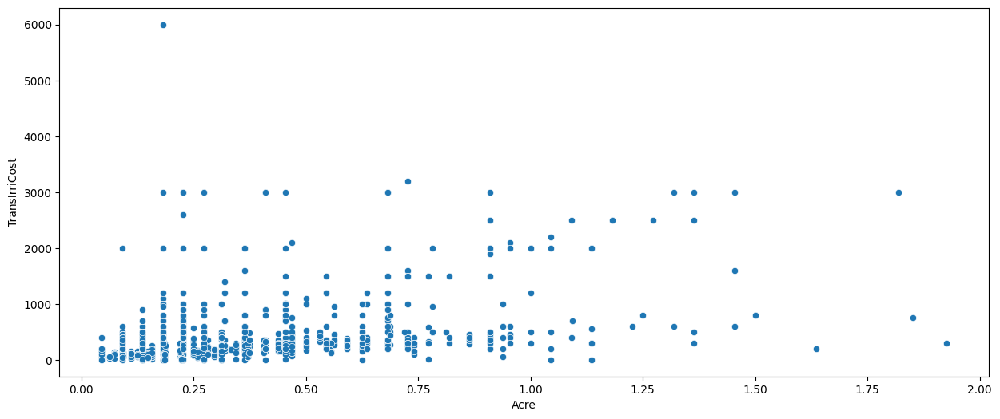

<ipython-input-54-05ed9f69224e>:3: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



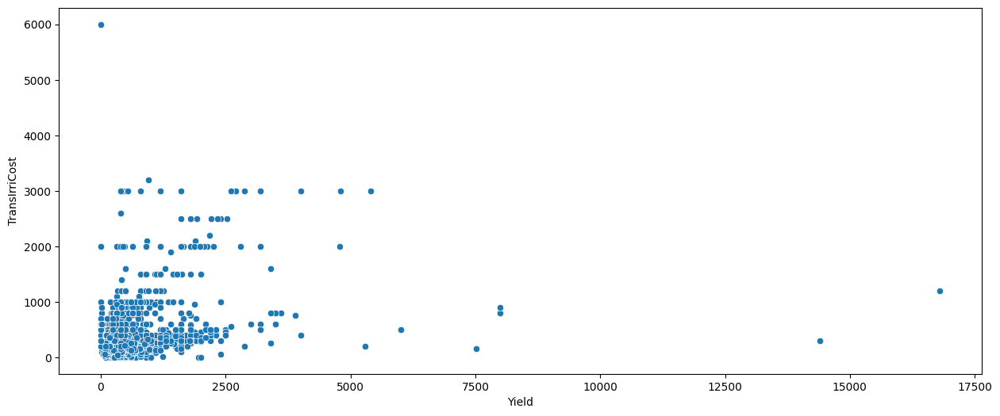

In [ ]:
for i in numeric_col:
  plt.figure(figsize = (15, 6))
  sns.scatterplot(x = df[i], y = df['TransIrriCost'], data = df, palette = 'hls')
  plt.show()

BIVARIANT PLOT

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




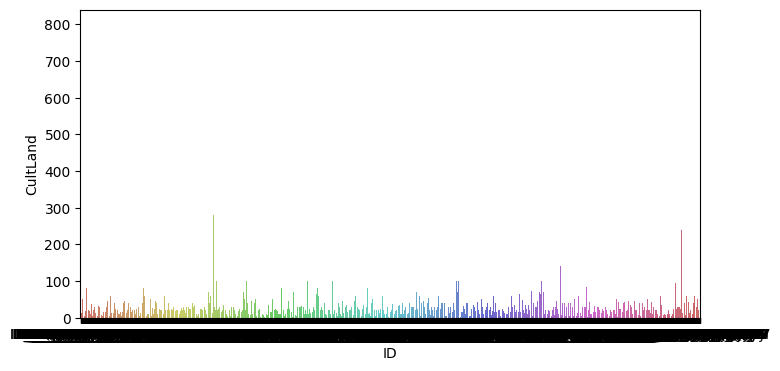

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




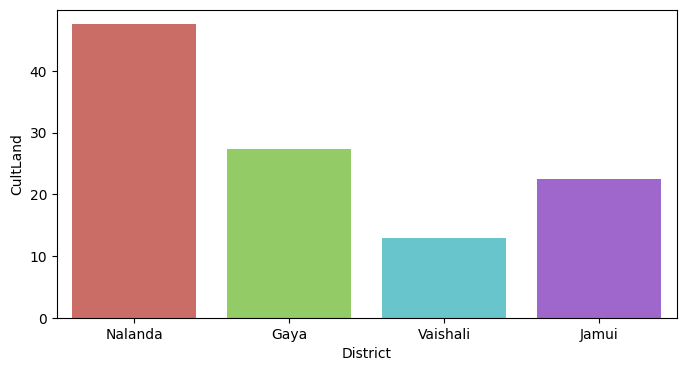

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




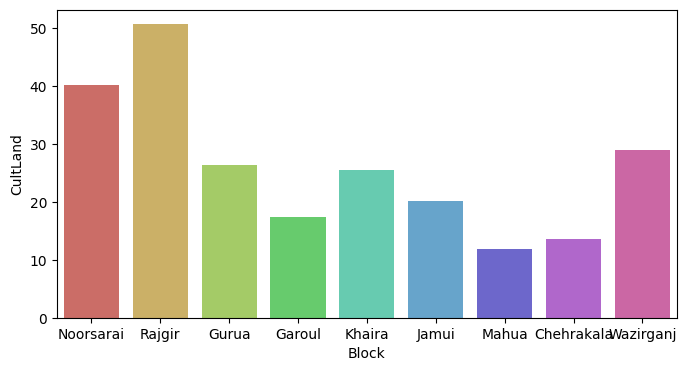

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




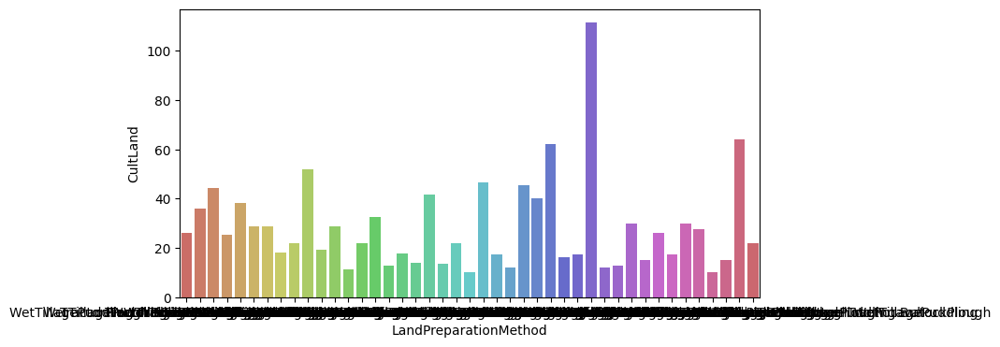

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




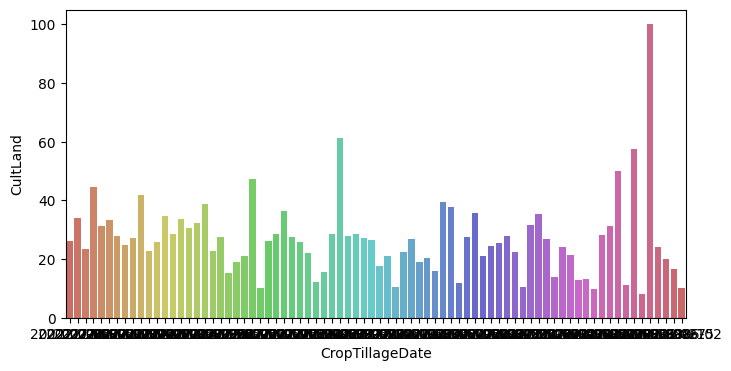

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




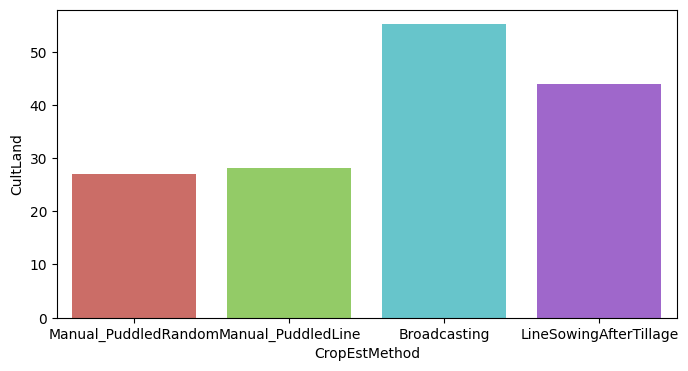

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




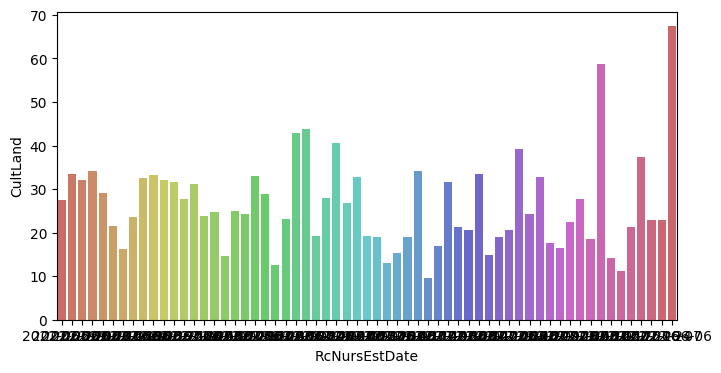

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




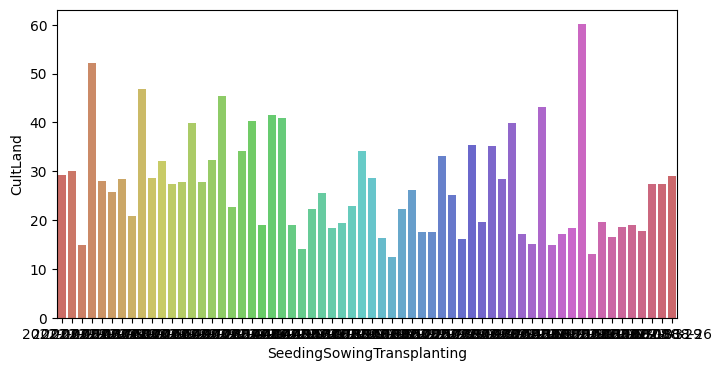

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




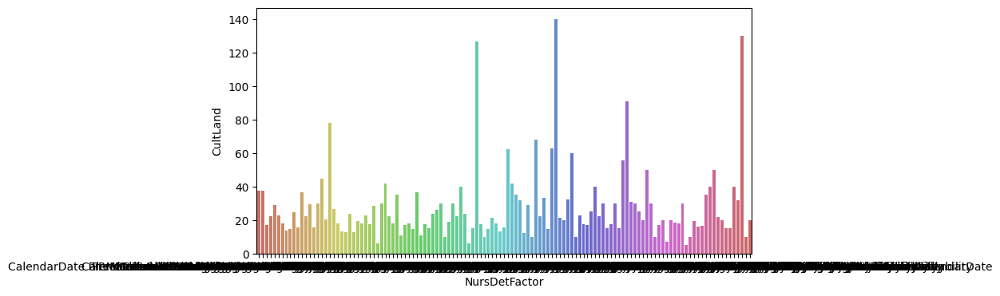

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




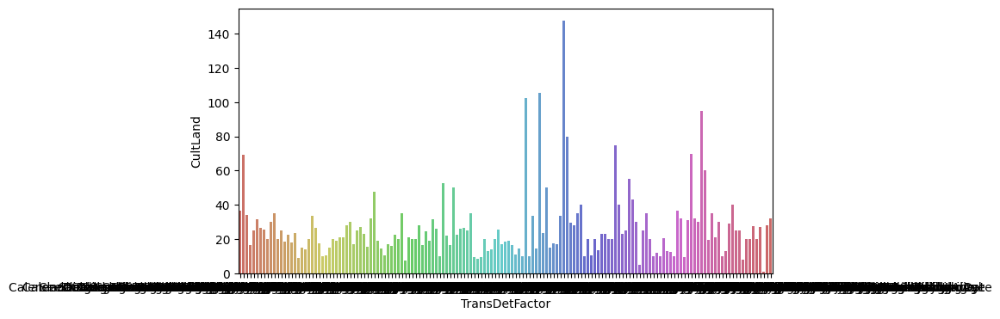

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




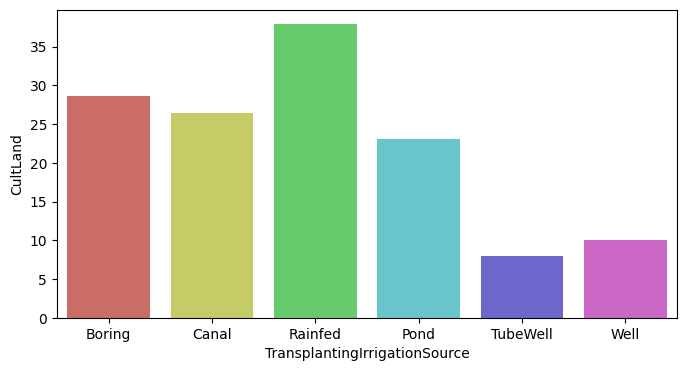

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




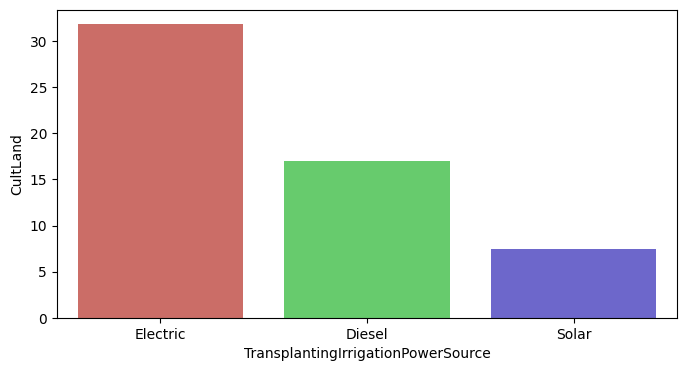

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




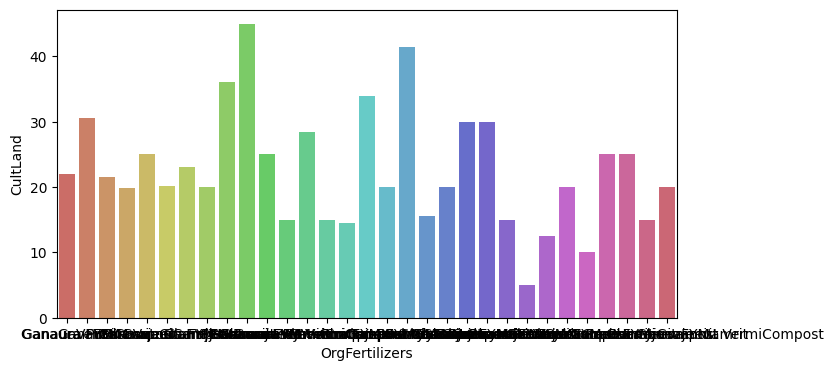

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




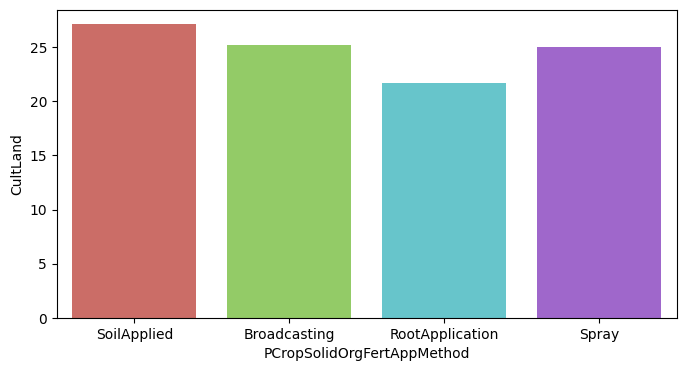

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




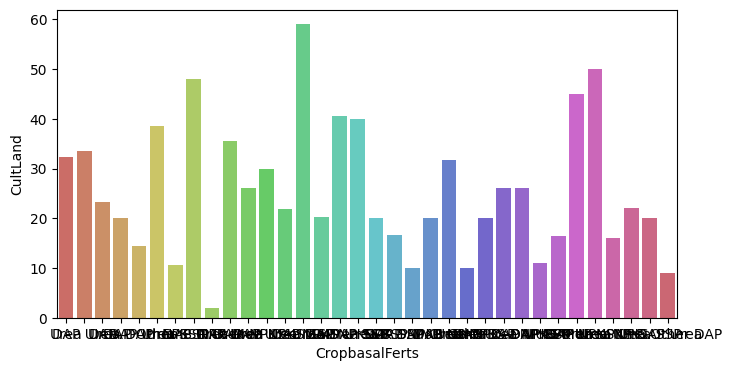

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




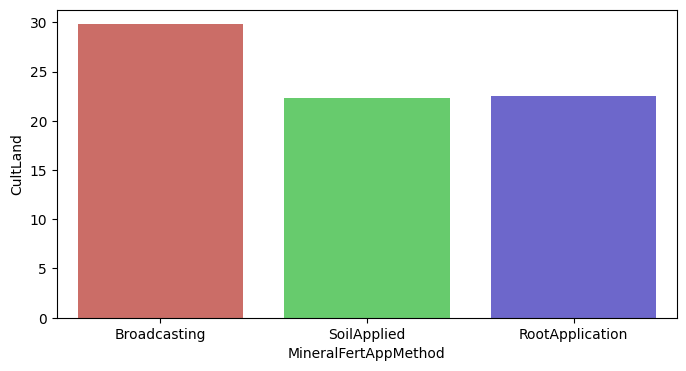

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




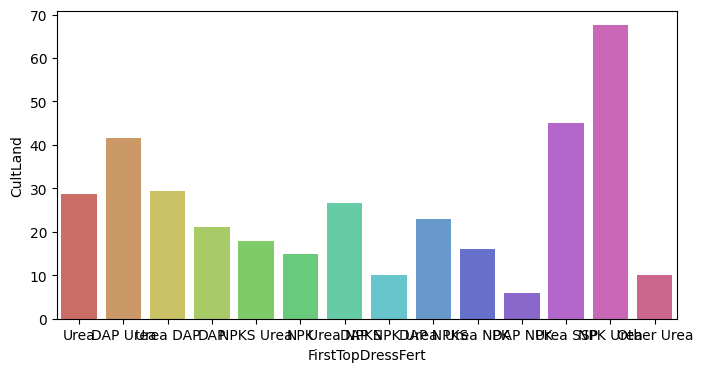

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




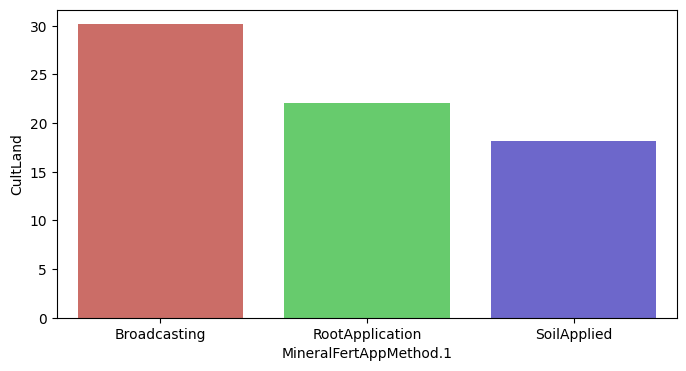

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




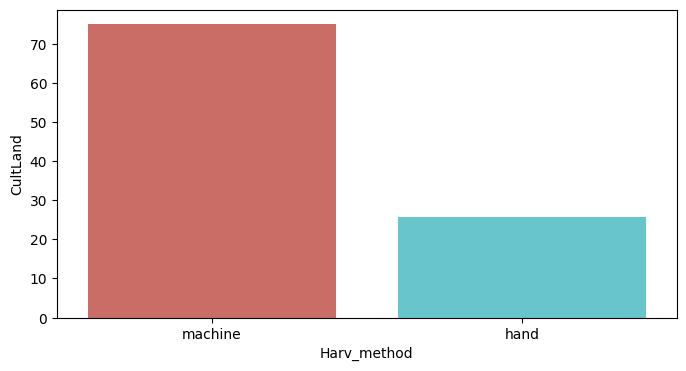

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




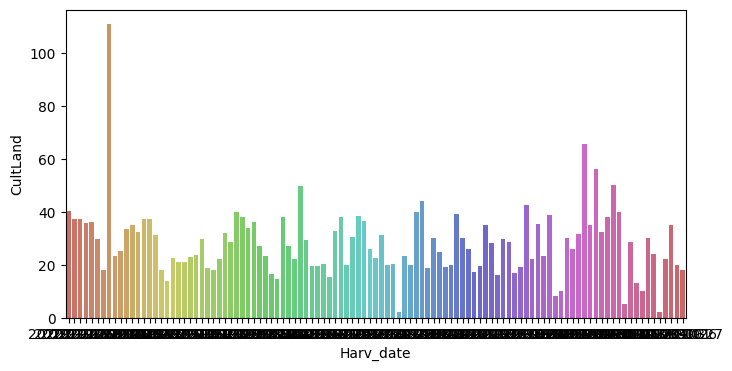

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




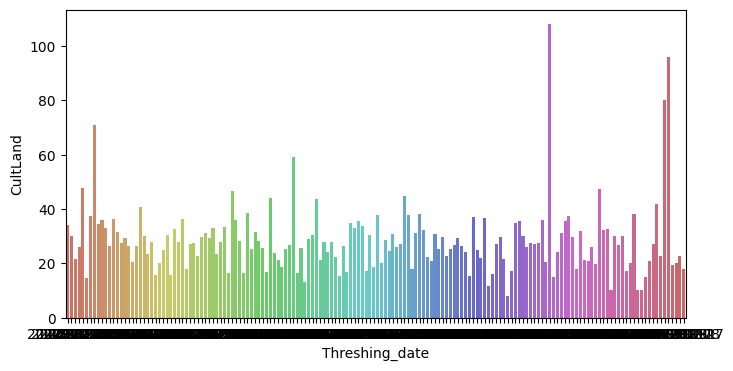

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




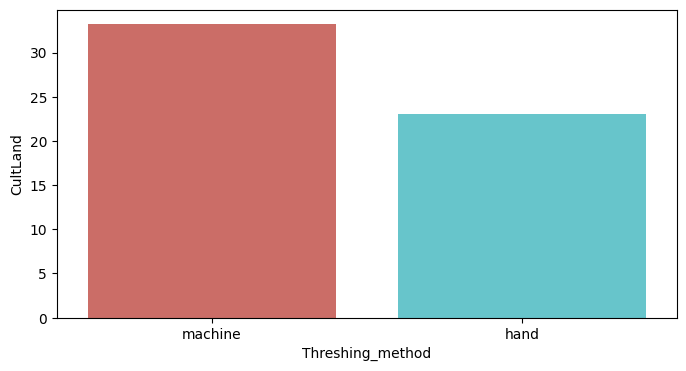

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




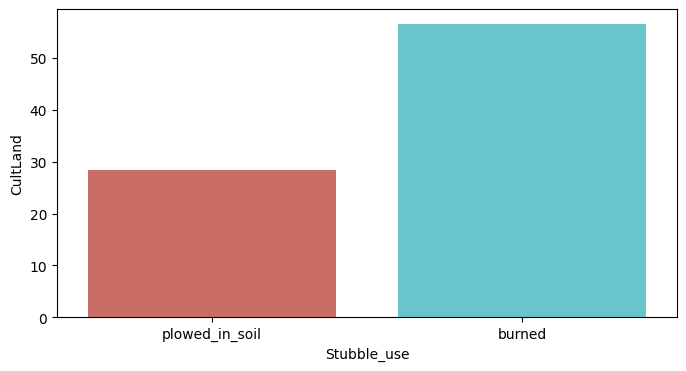

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




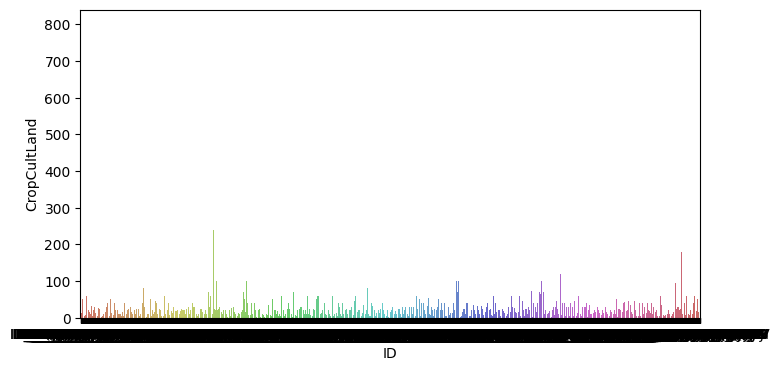

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




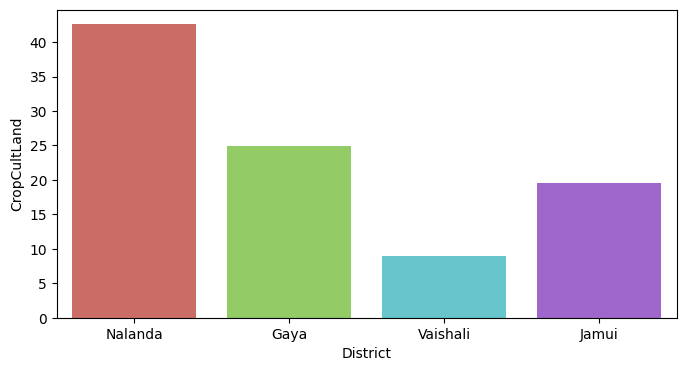

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




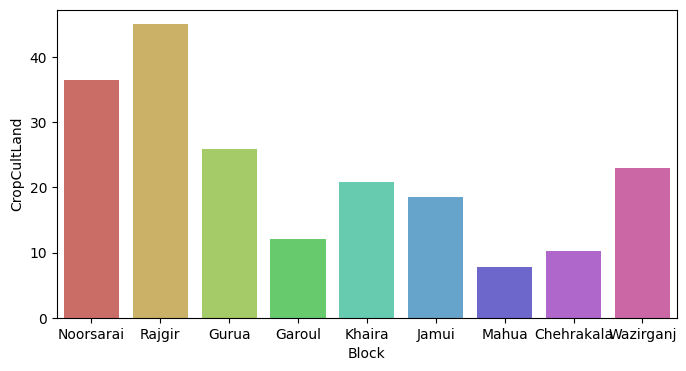

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




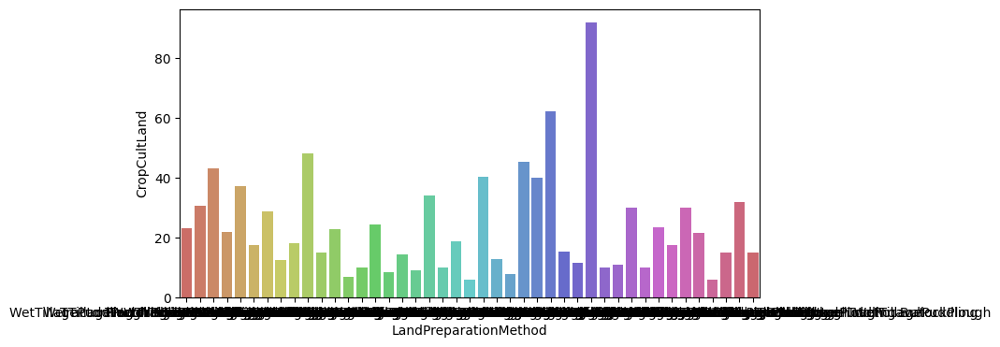

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




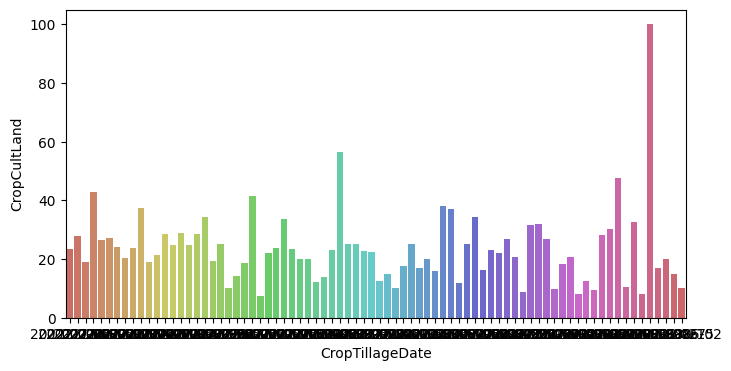

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




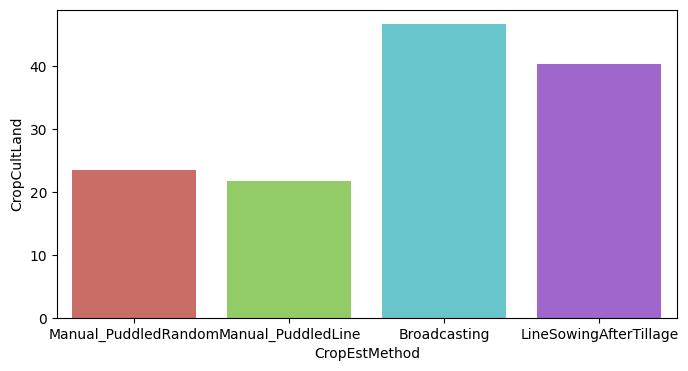

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




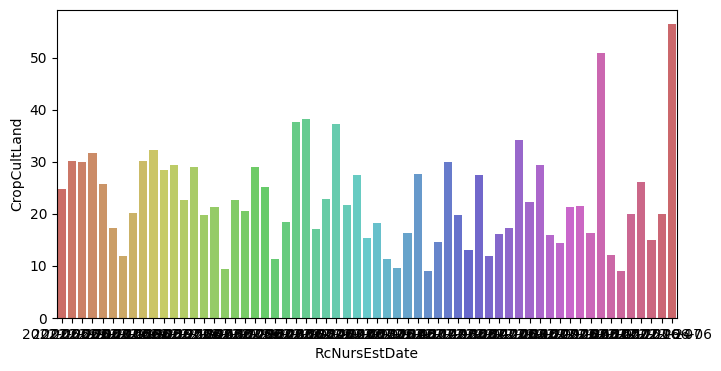

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




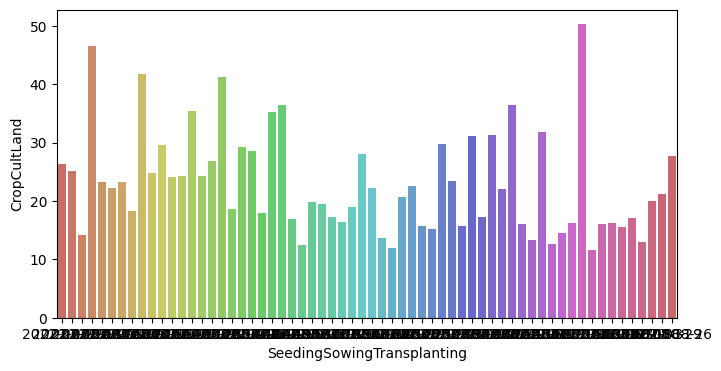

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




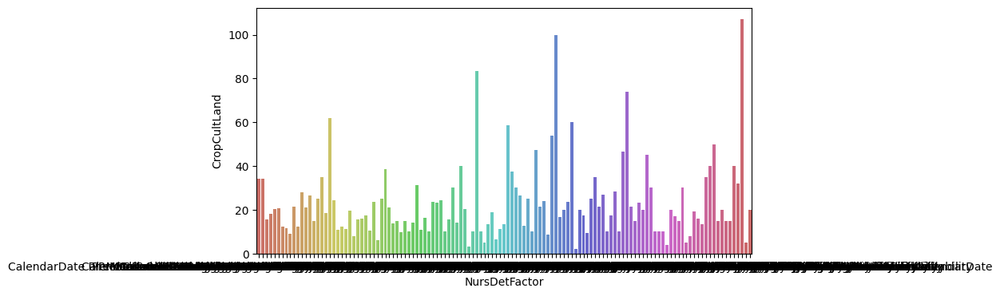

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




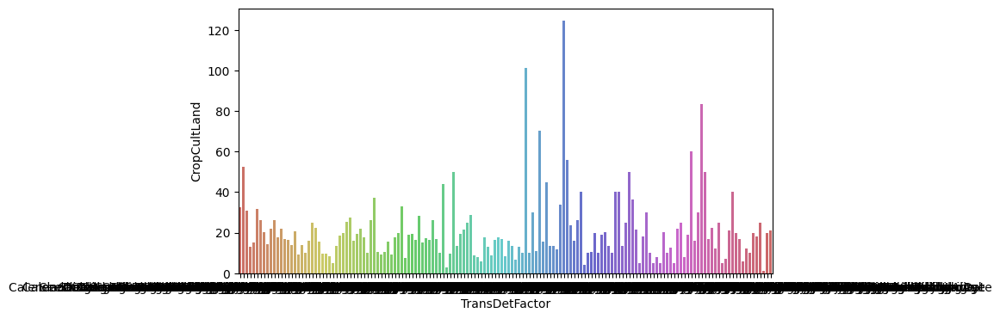

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




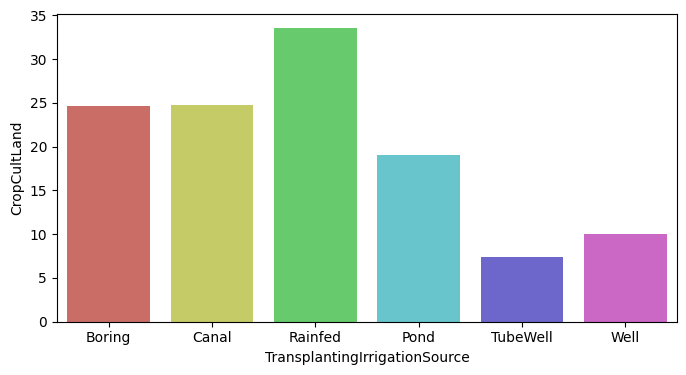

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




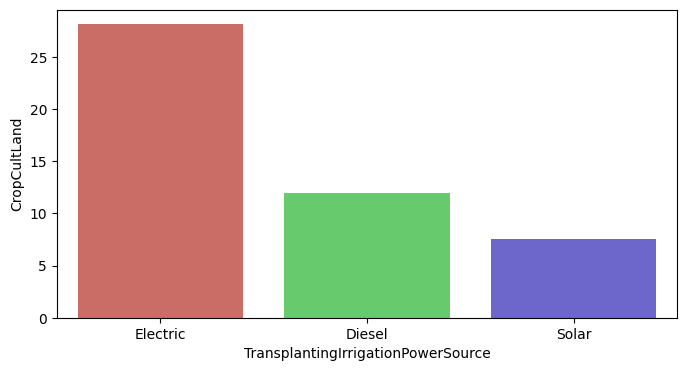

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




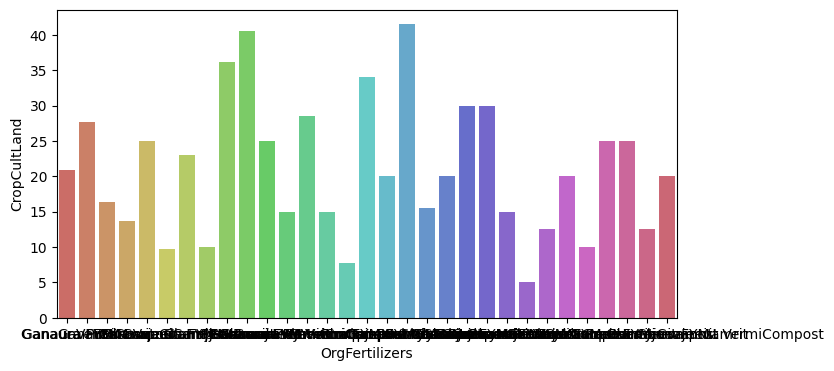

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




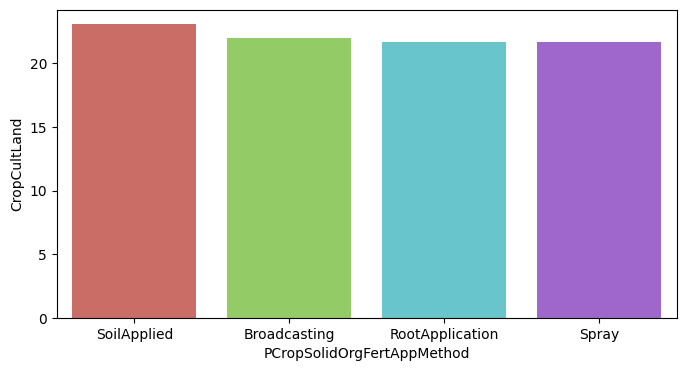

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




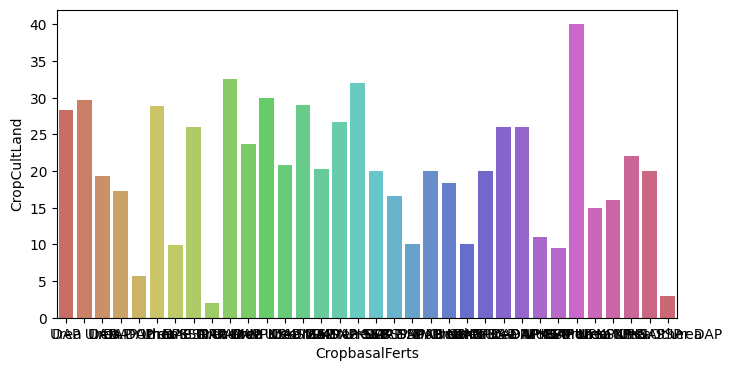

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




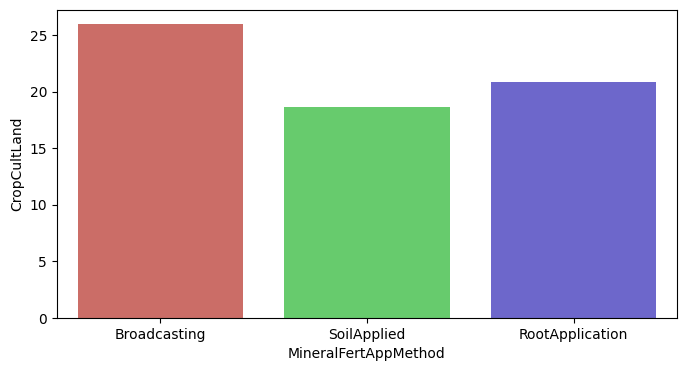

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




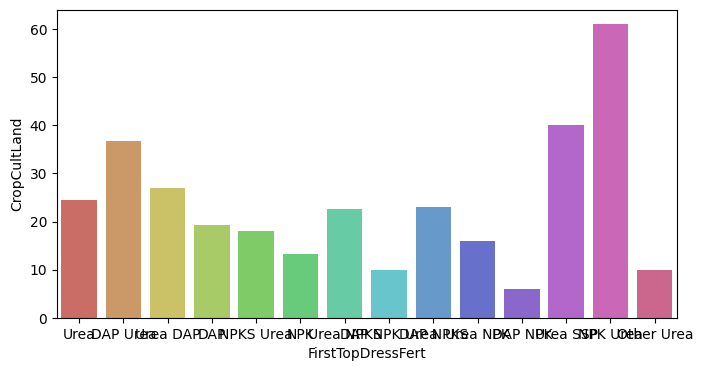

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




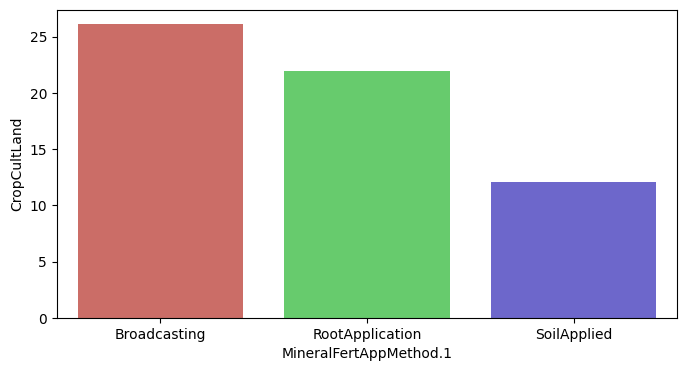

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




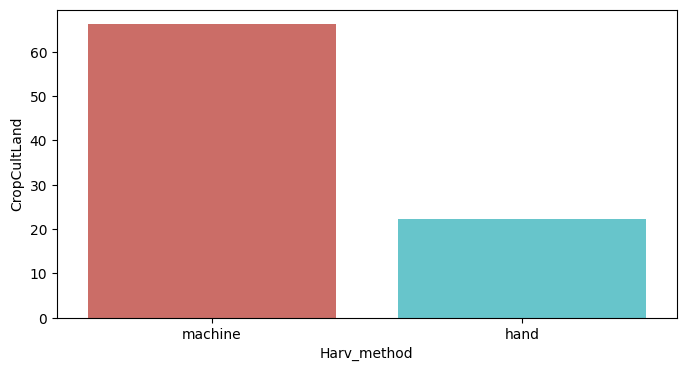

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




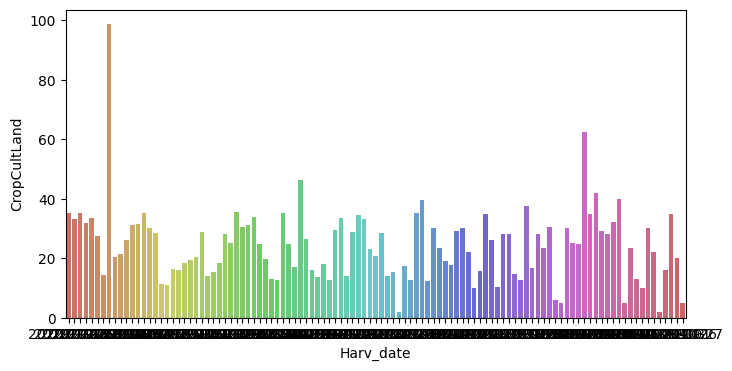

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




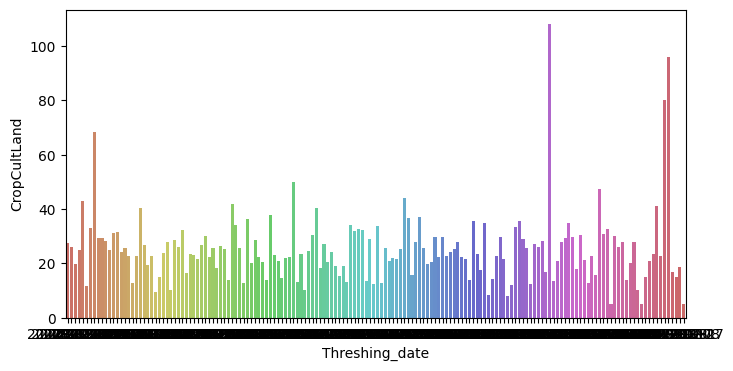

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




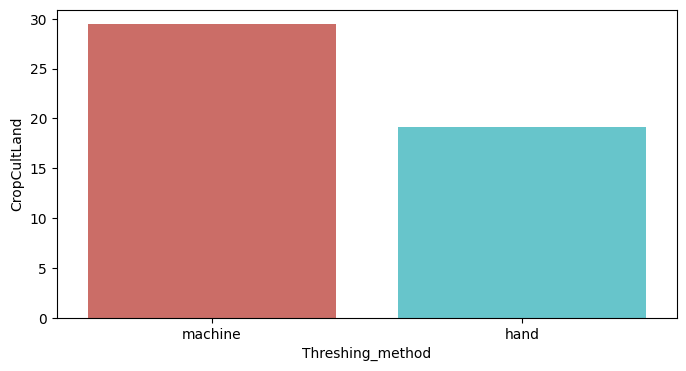

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




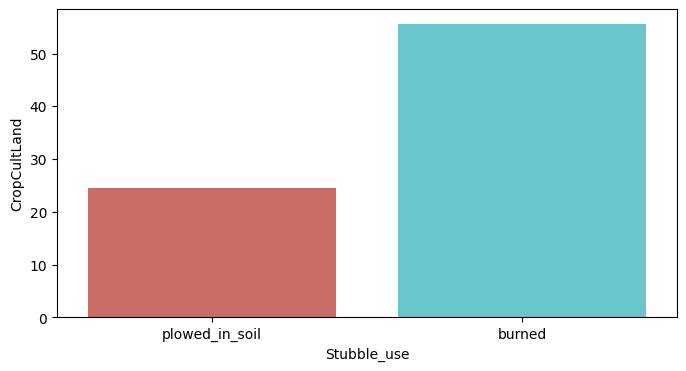

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




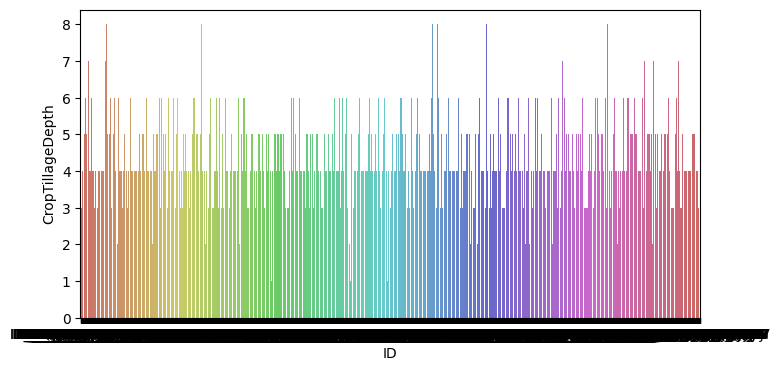

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




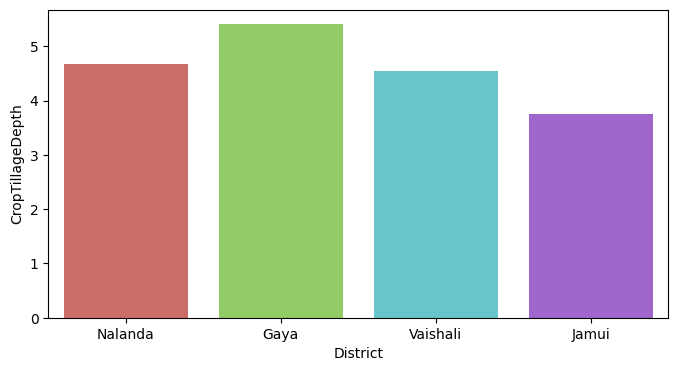

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




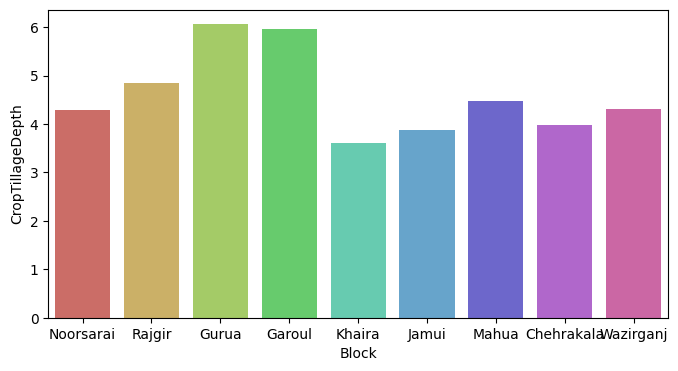

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




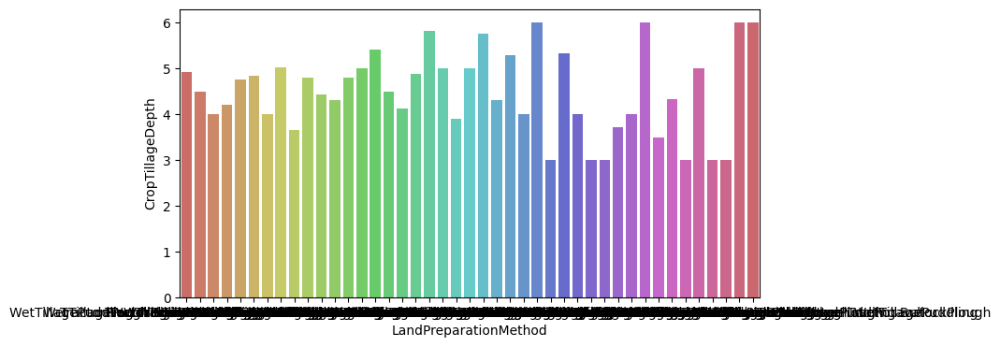

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




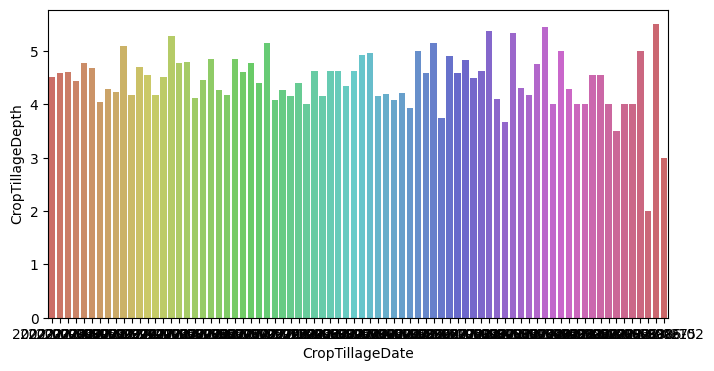

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




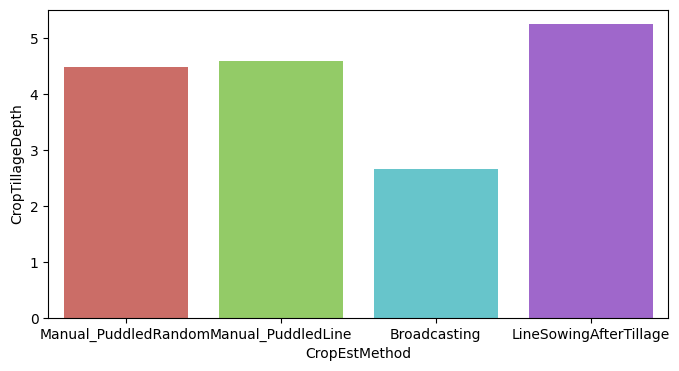

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




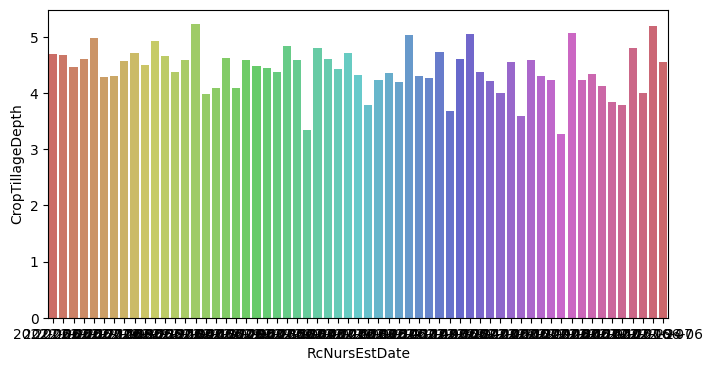

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




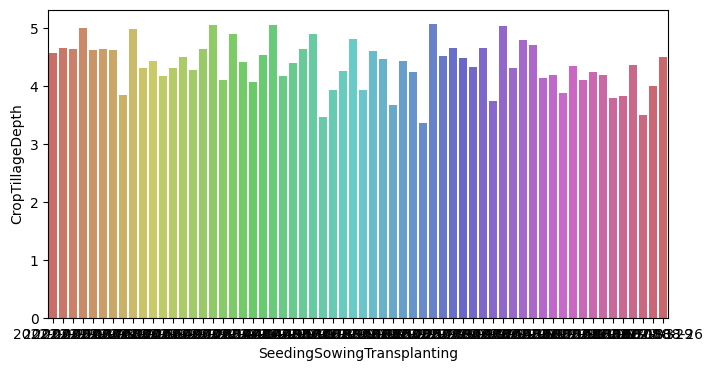

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




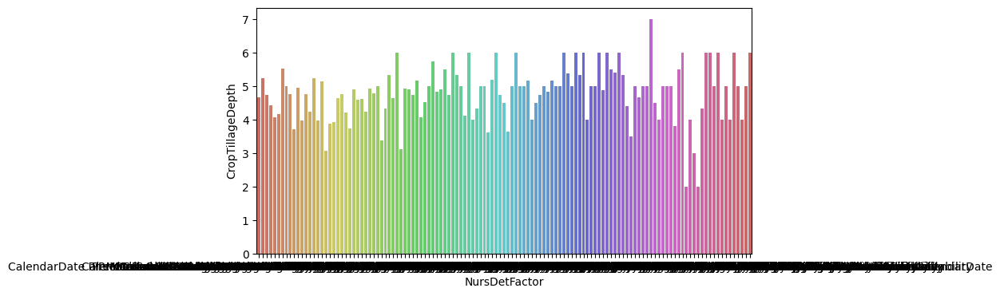

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




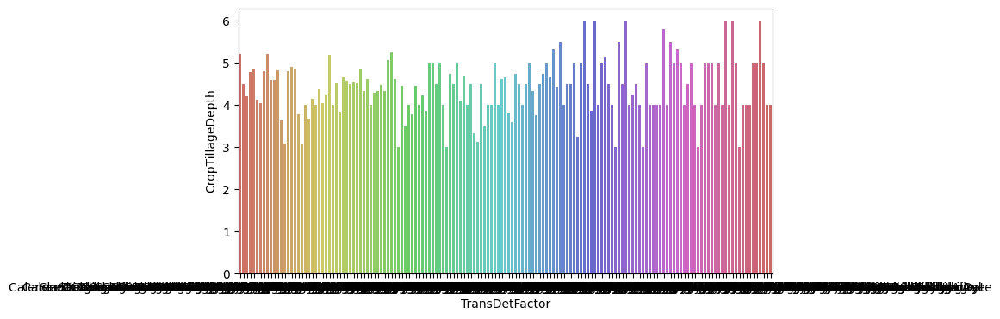

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




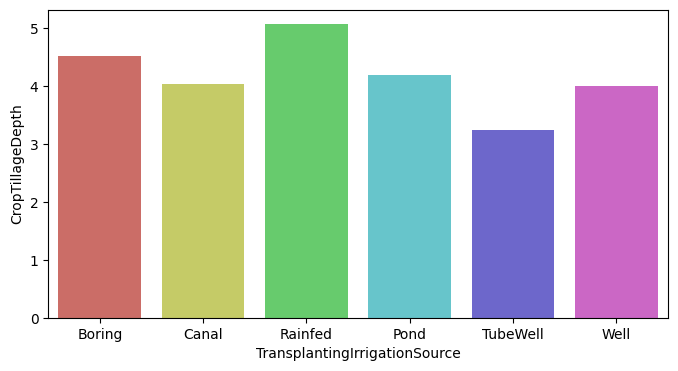

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




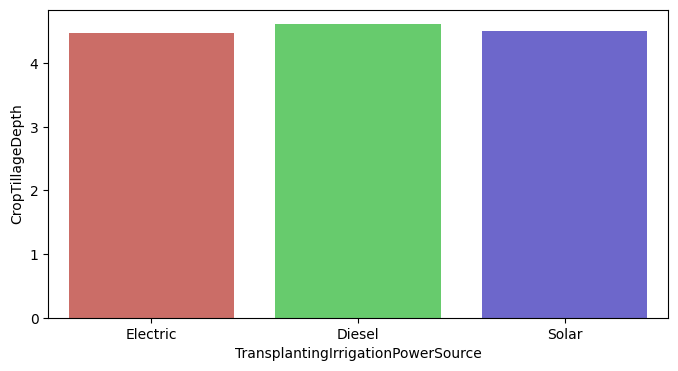

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




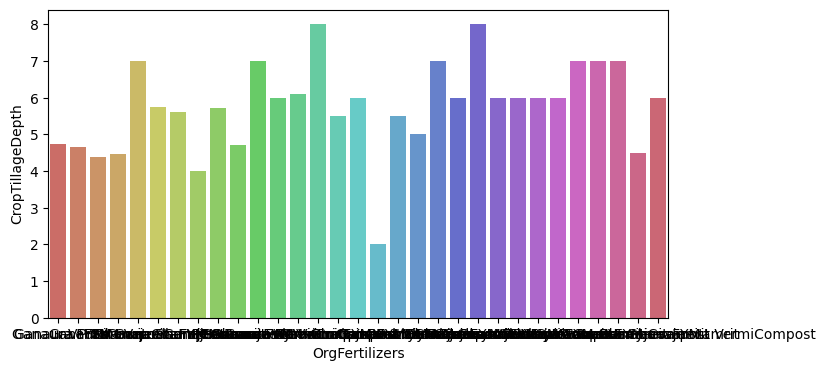

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




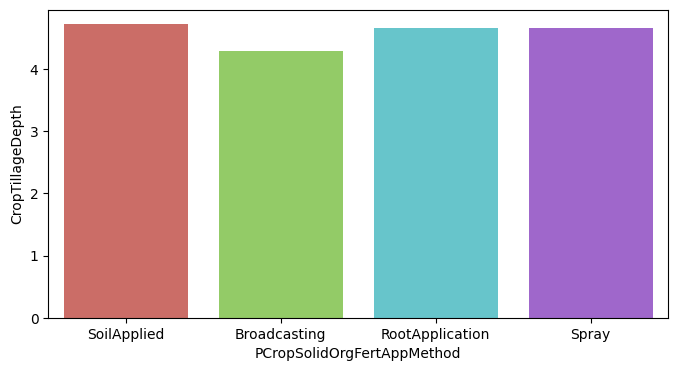

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




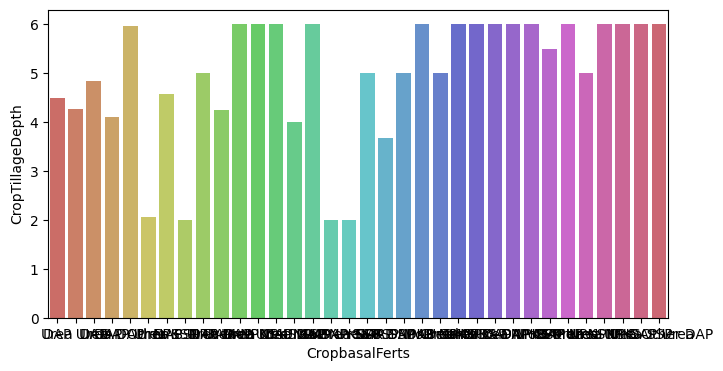

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




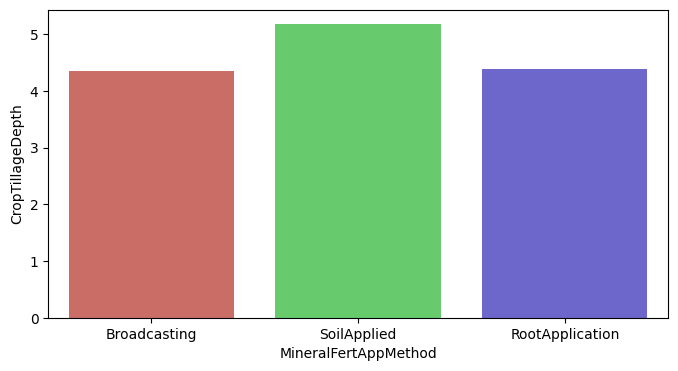

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




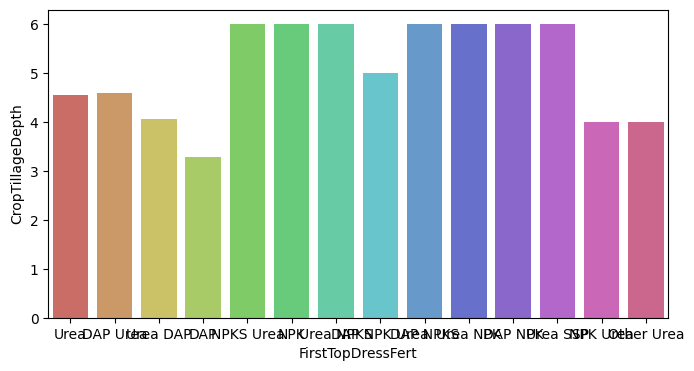

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




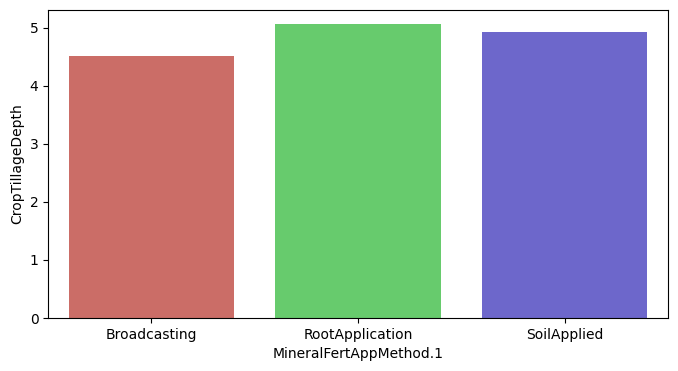

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




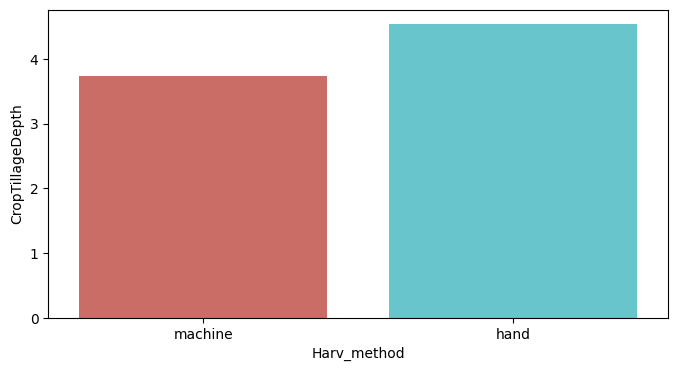

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




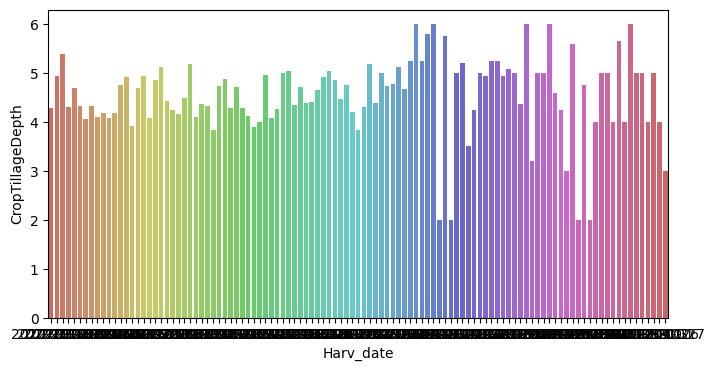

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




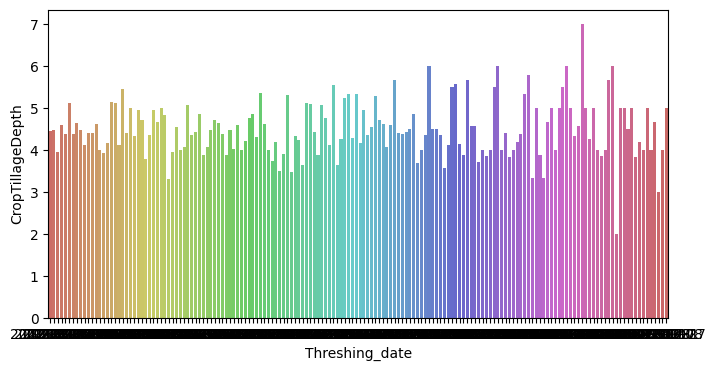

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




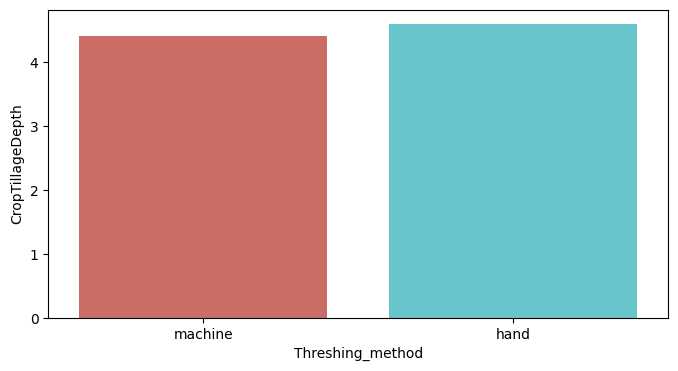

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




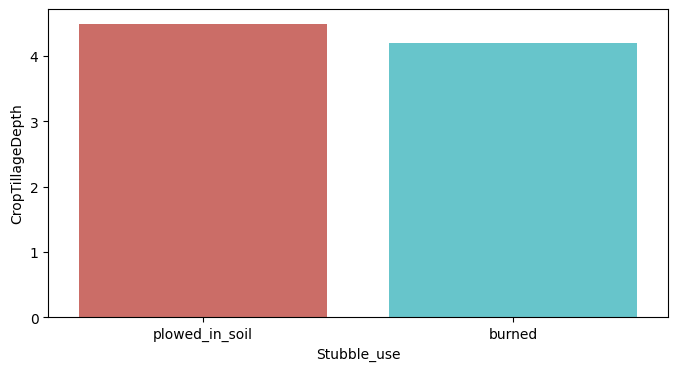

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




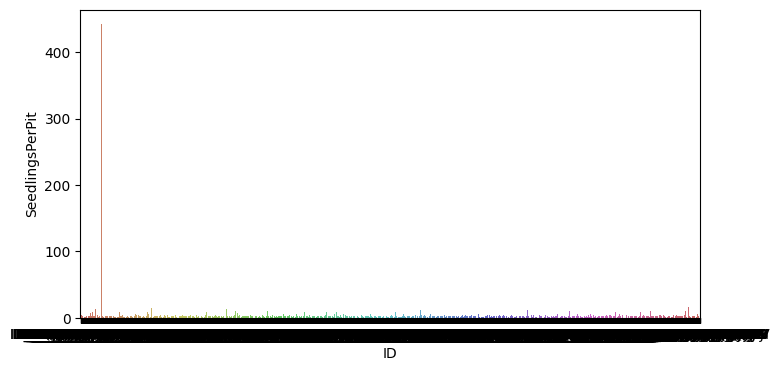

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




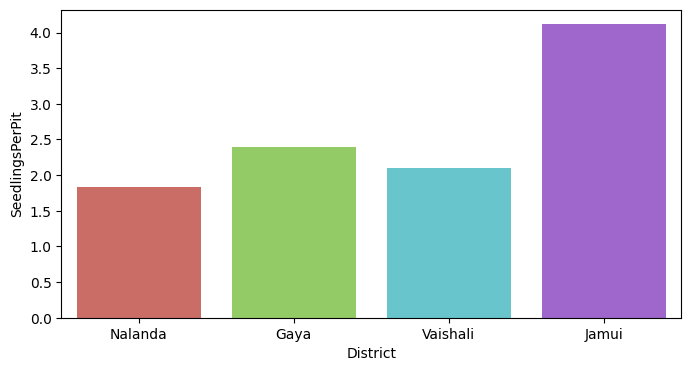

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




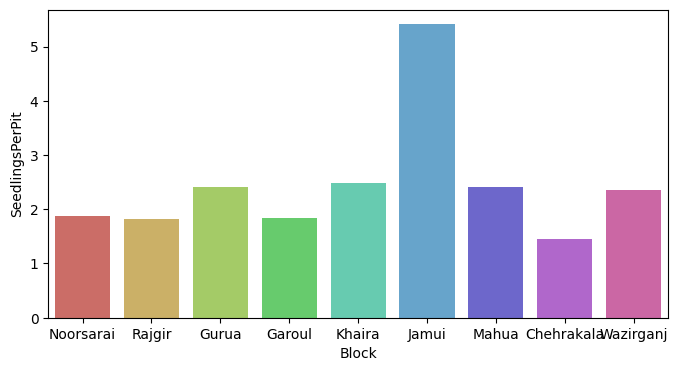

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




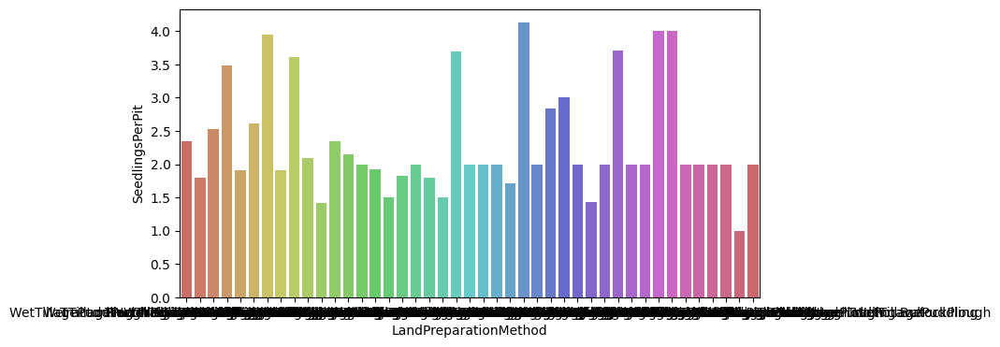

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




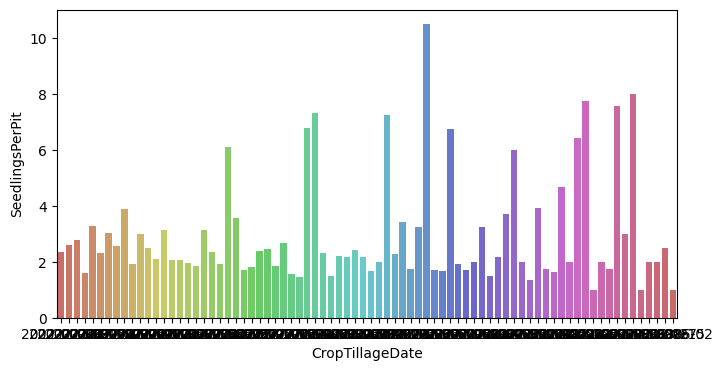

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




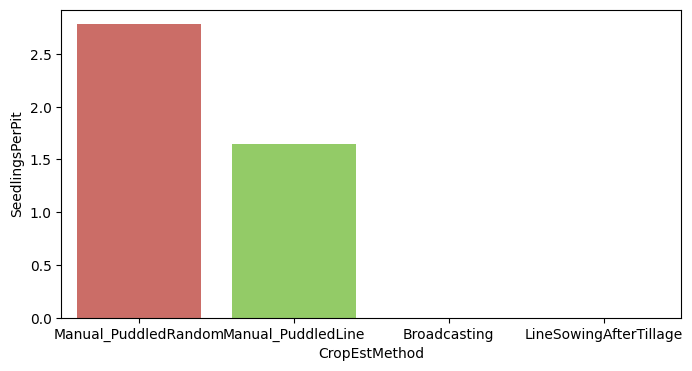

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




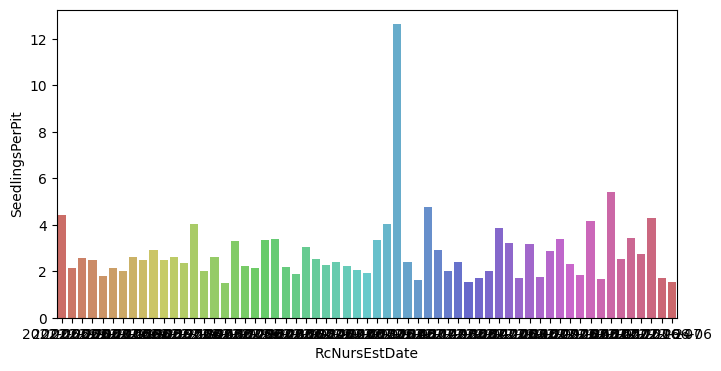

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




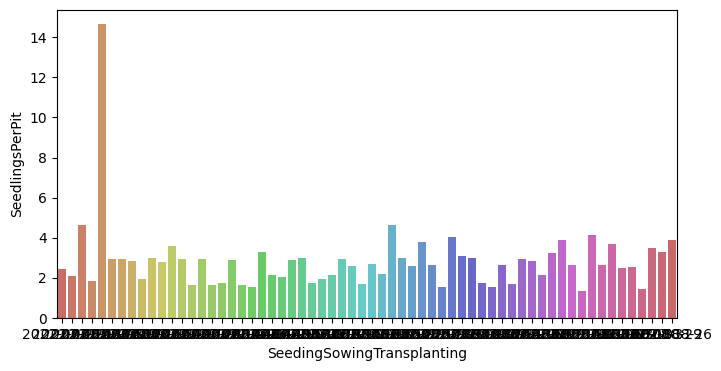

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




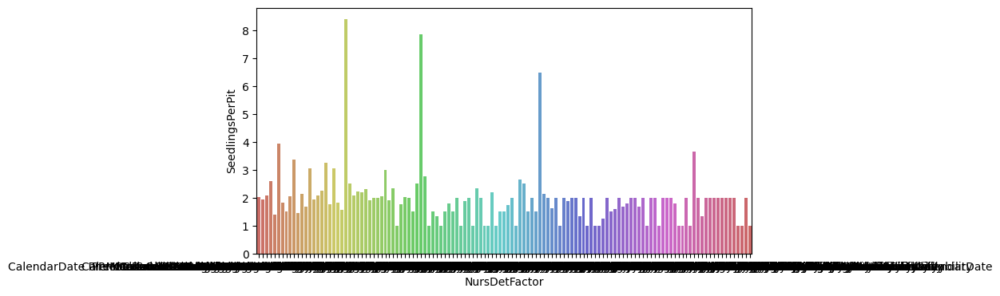

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




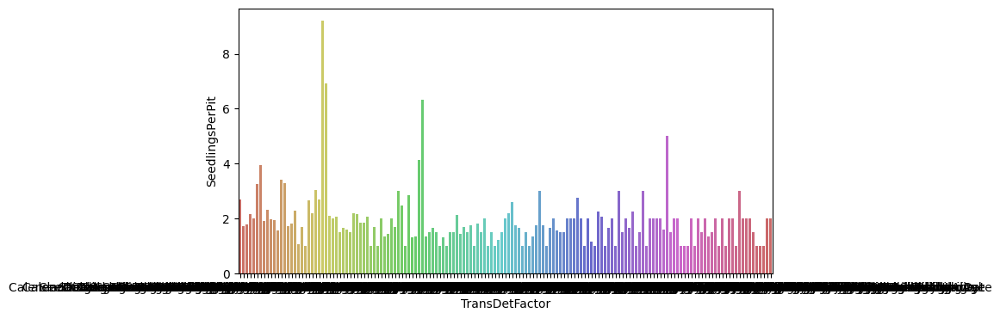

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




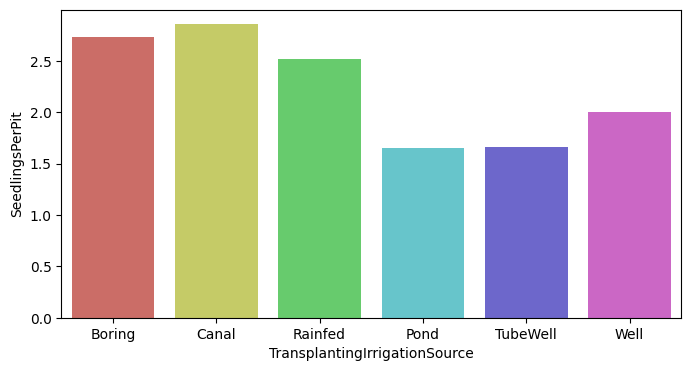

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




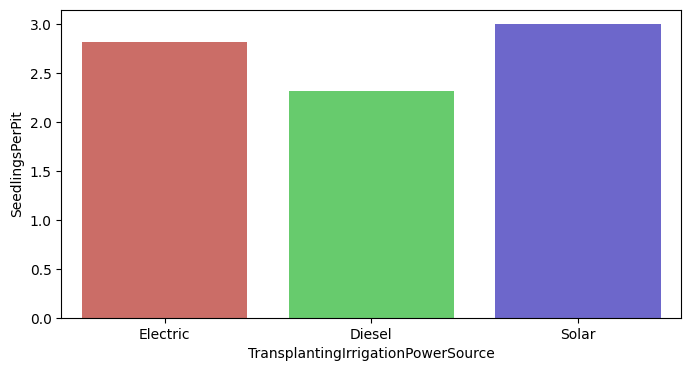

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




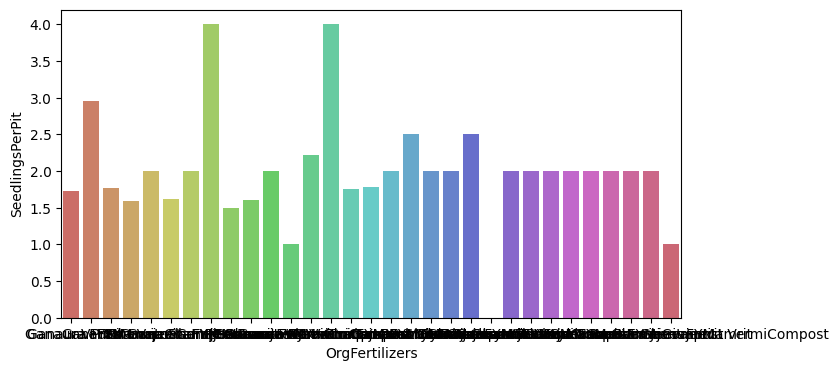

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




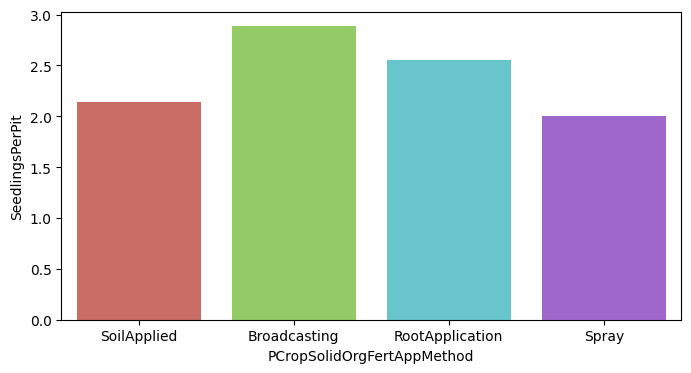

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




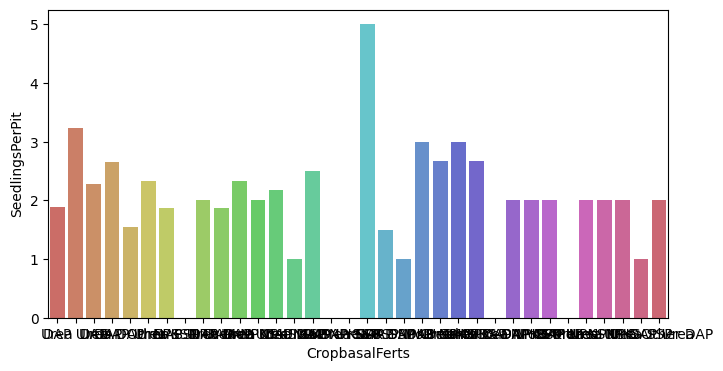

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




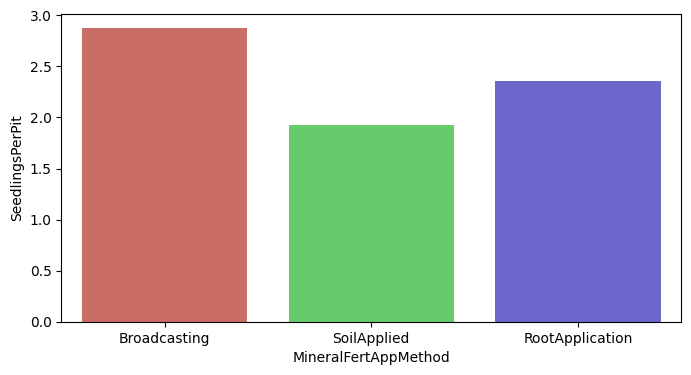

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




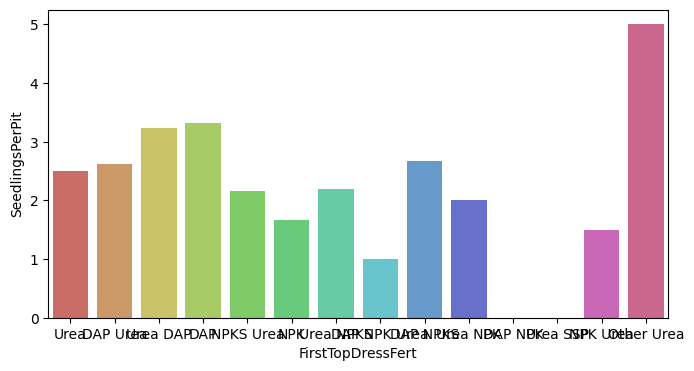

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




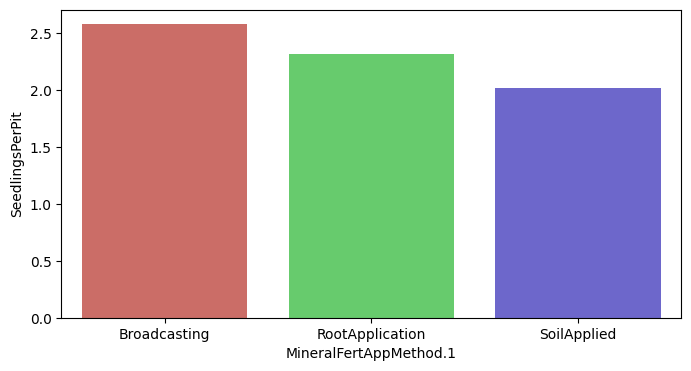

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




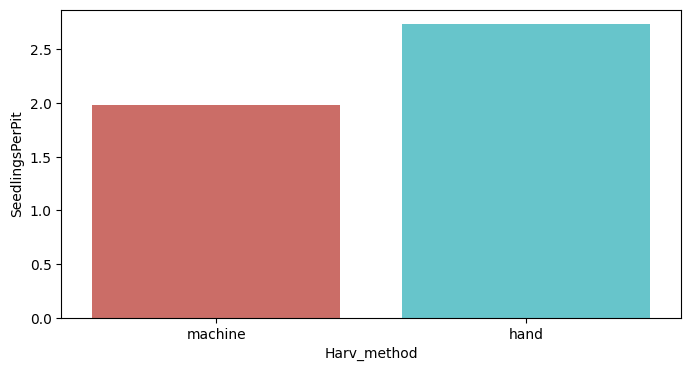

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




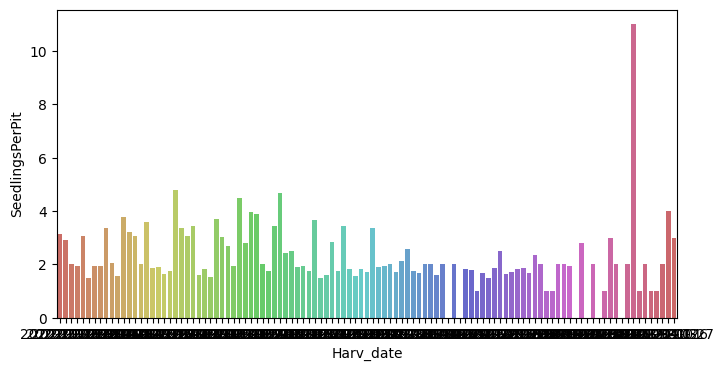

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




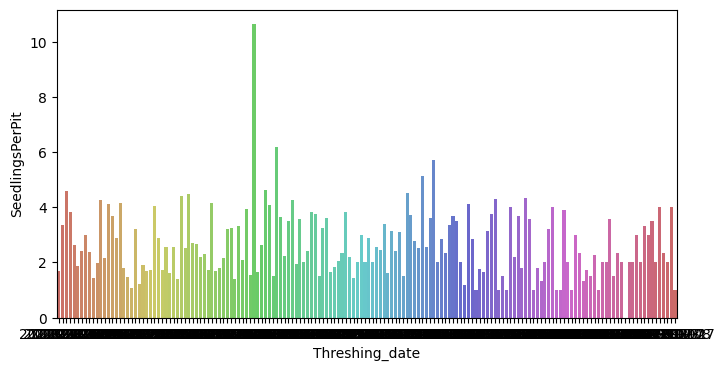

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




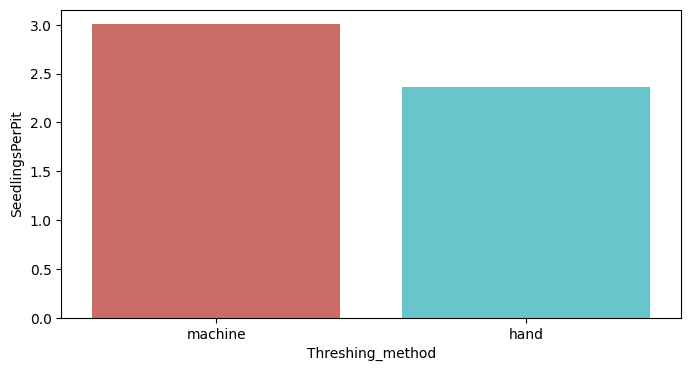

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




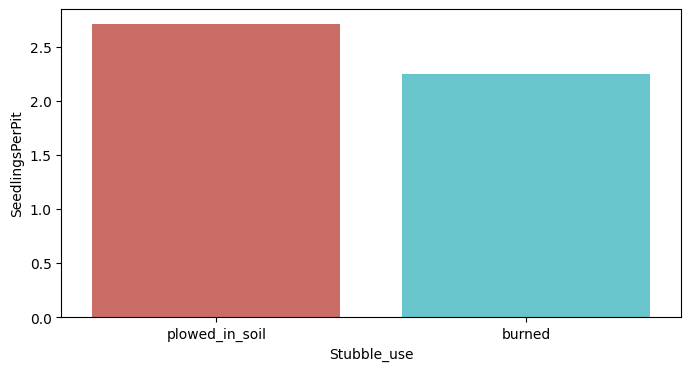

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




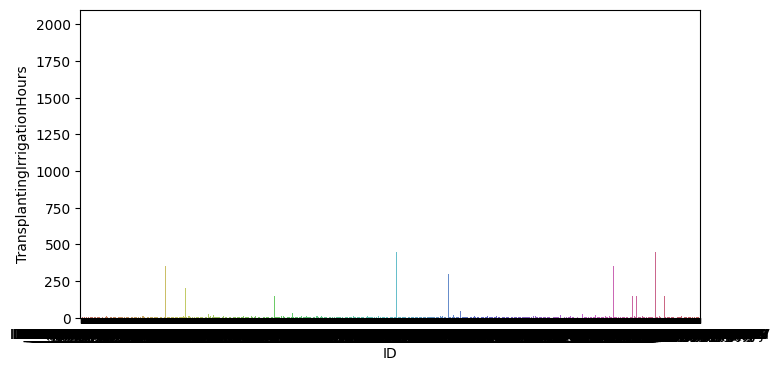

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




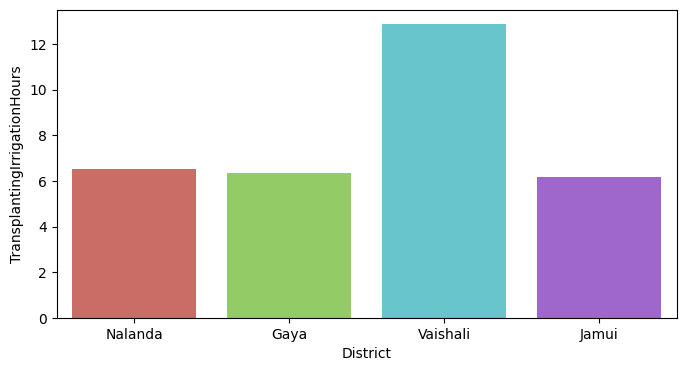

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




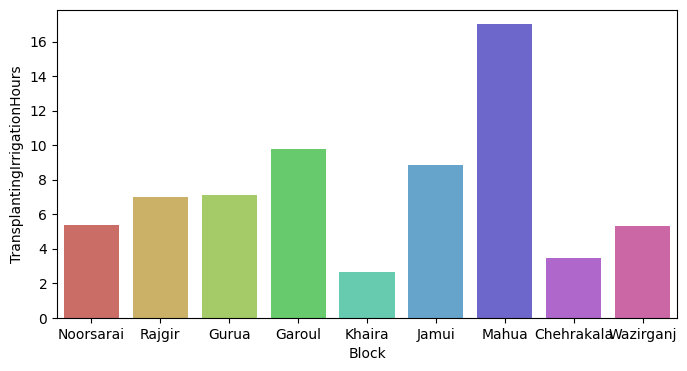

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




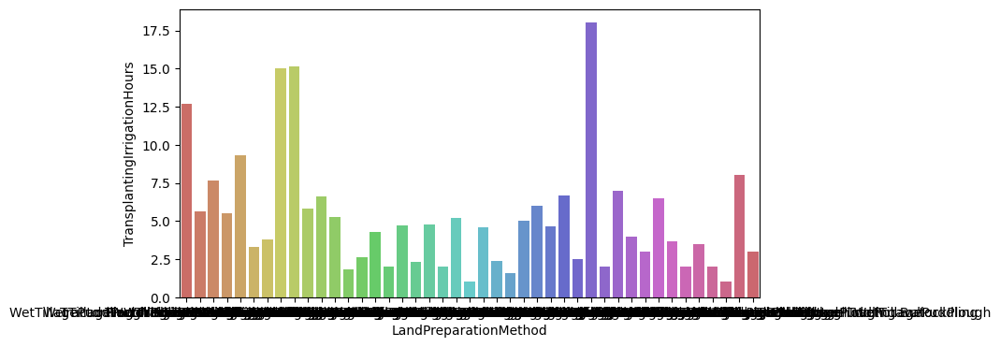

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




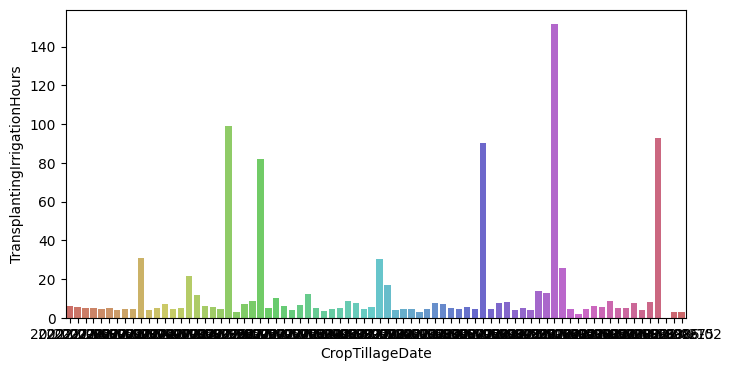

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




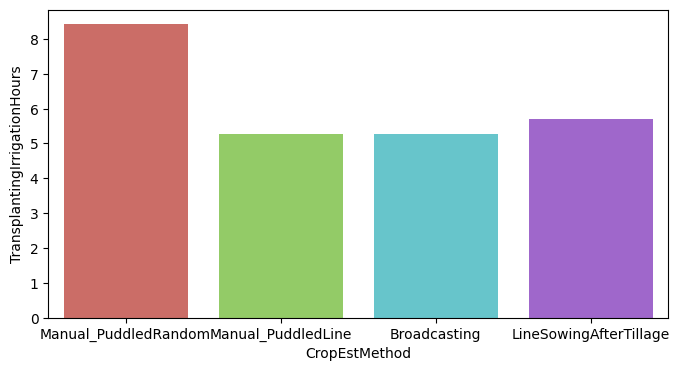

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




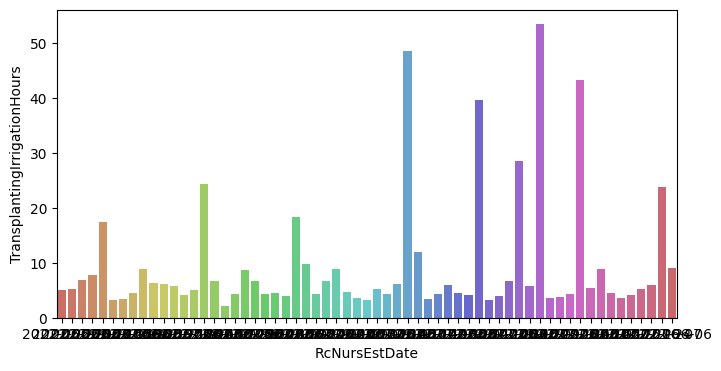

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




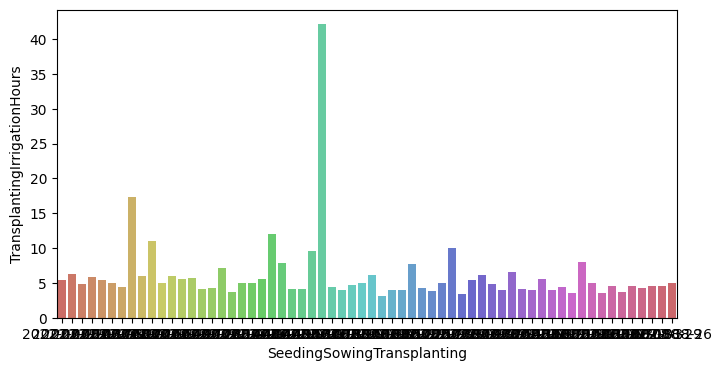

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




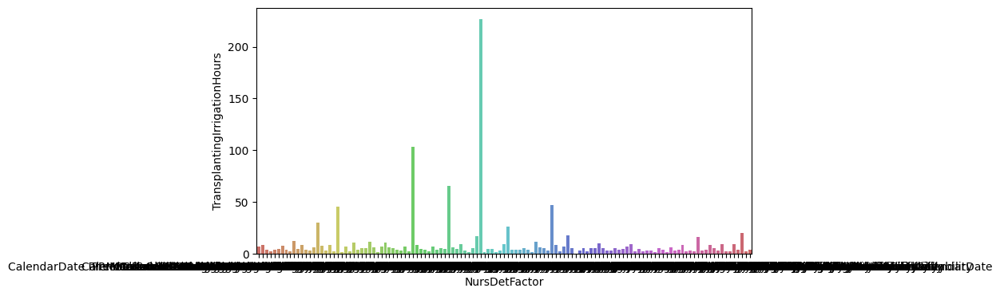

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




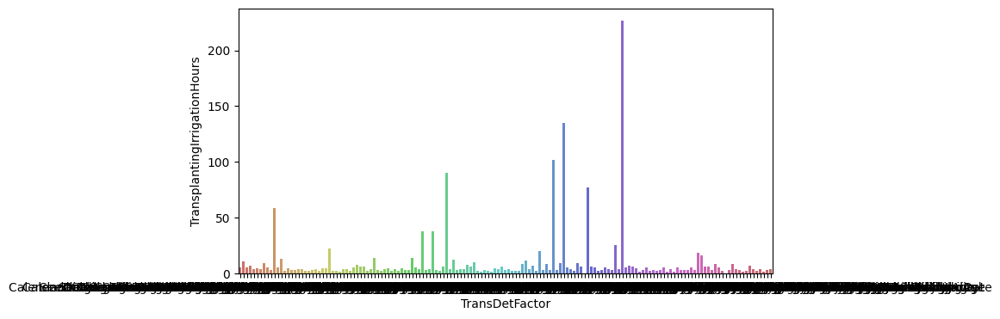

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




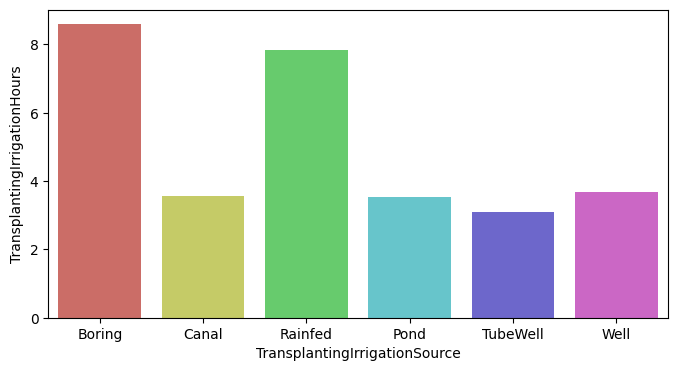

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




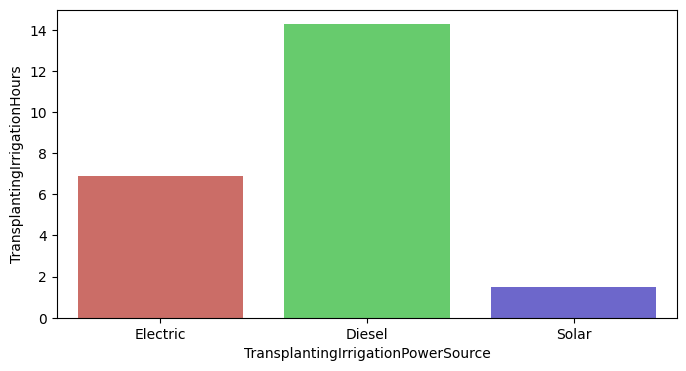

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




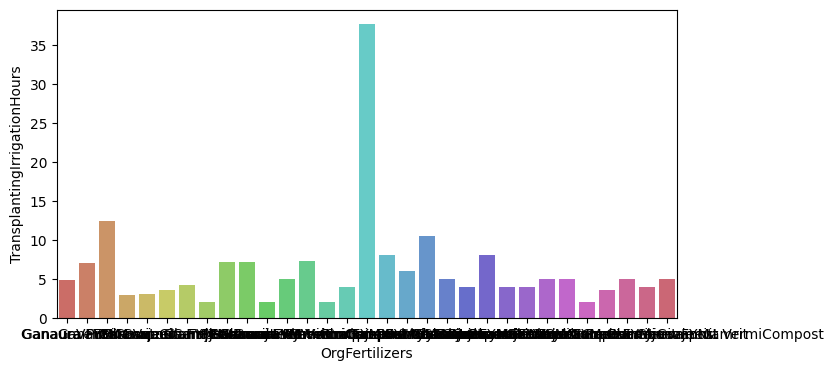

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




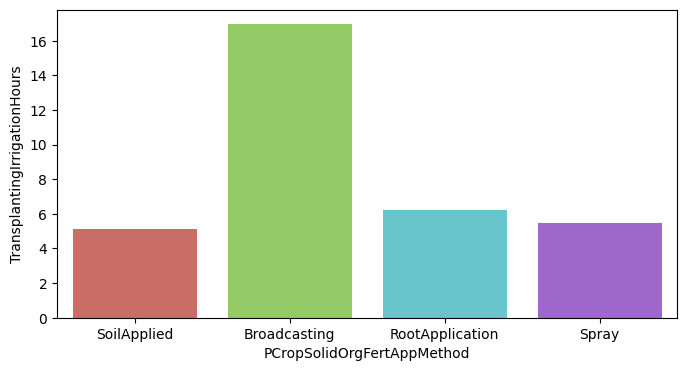

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




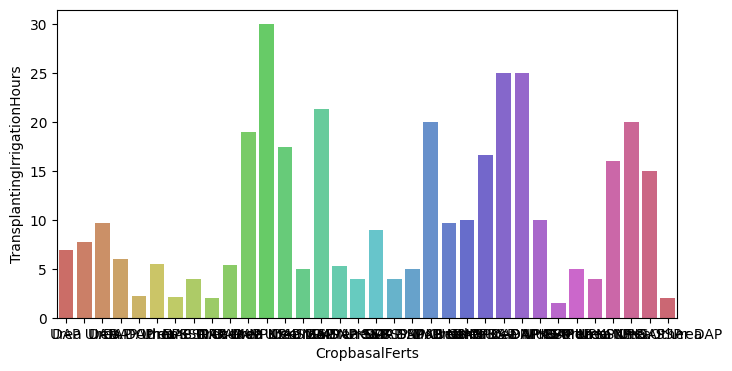

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




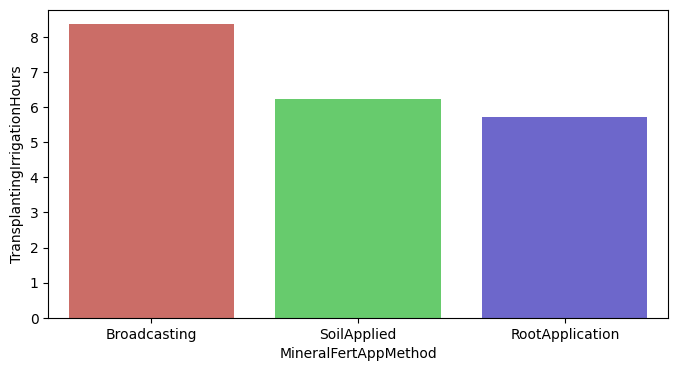

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




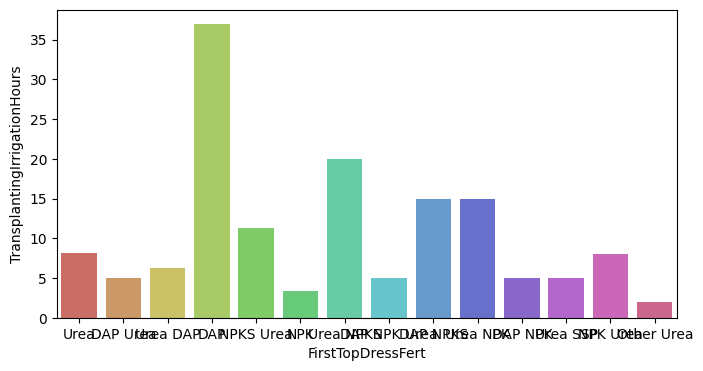

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




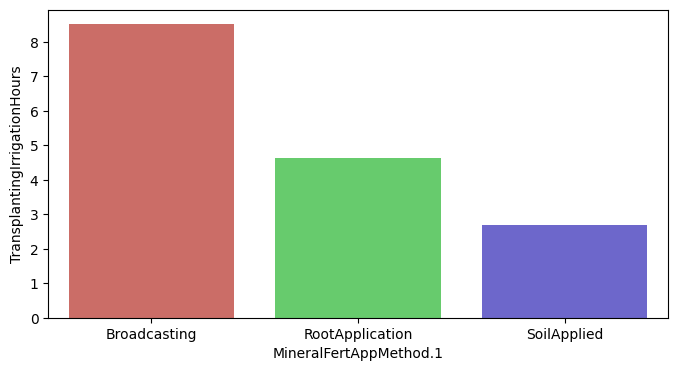

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




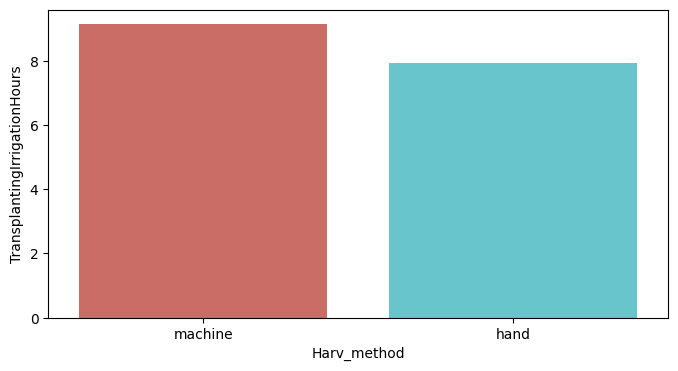

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




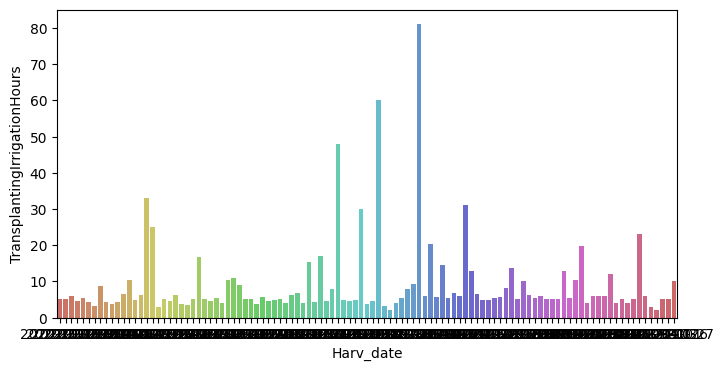

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




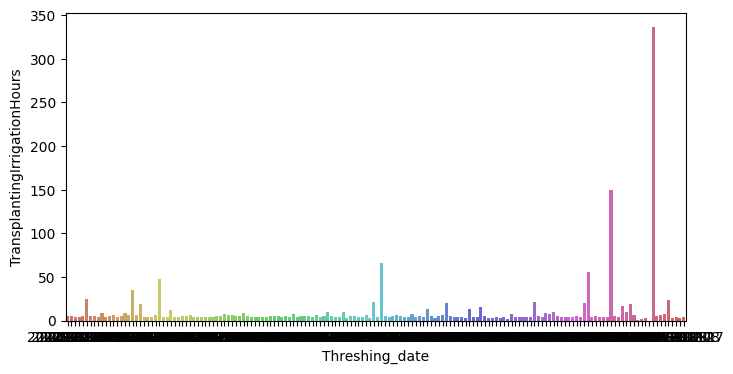

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




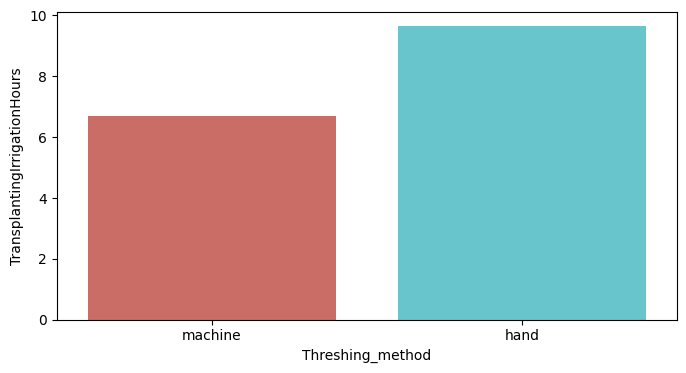

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




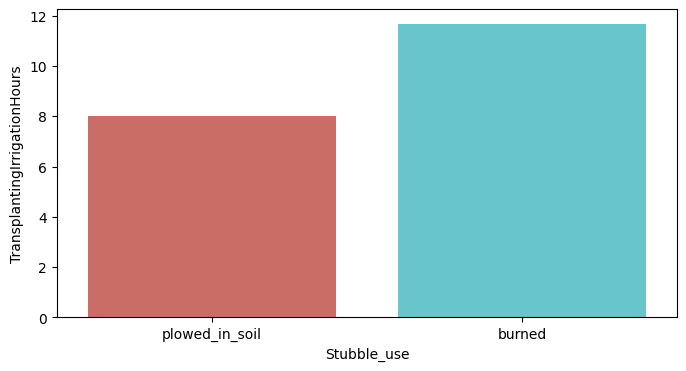

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




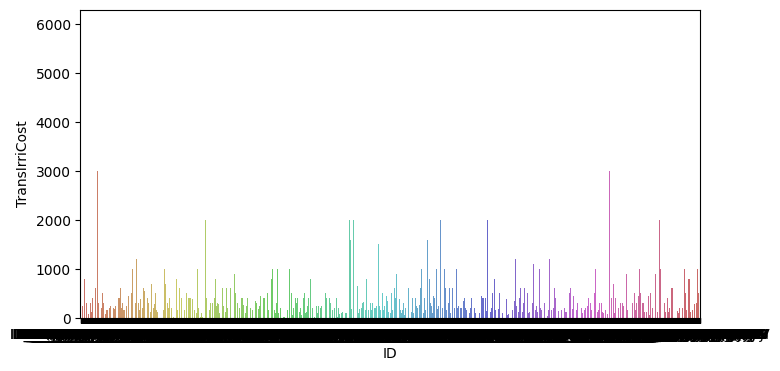

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




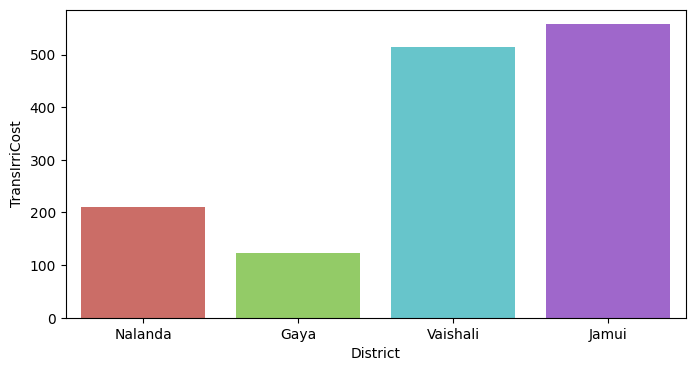

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




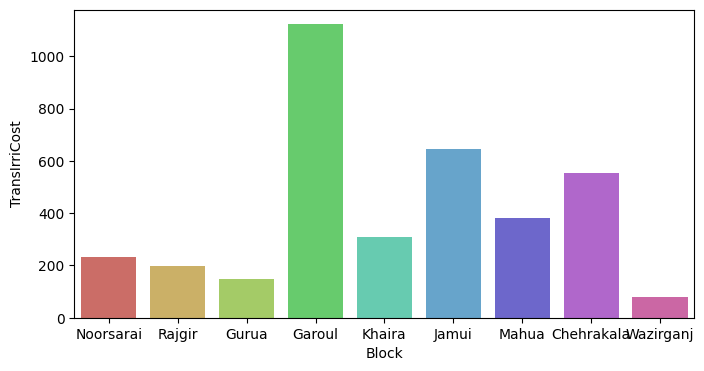

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




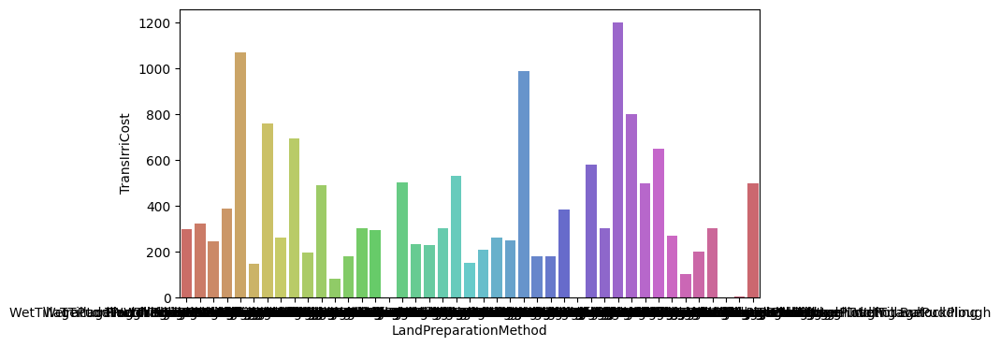

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




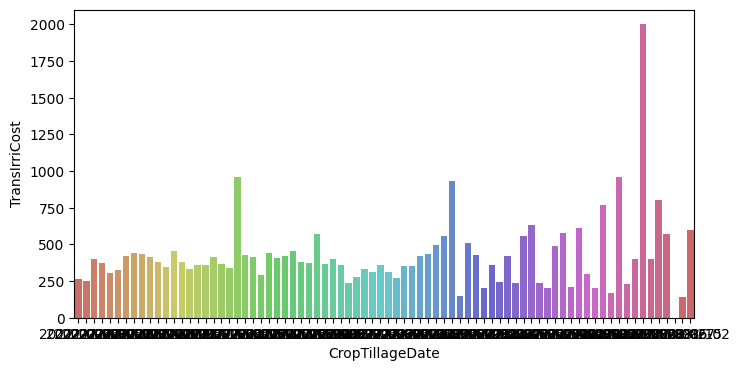

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




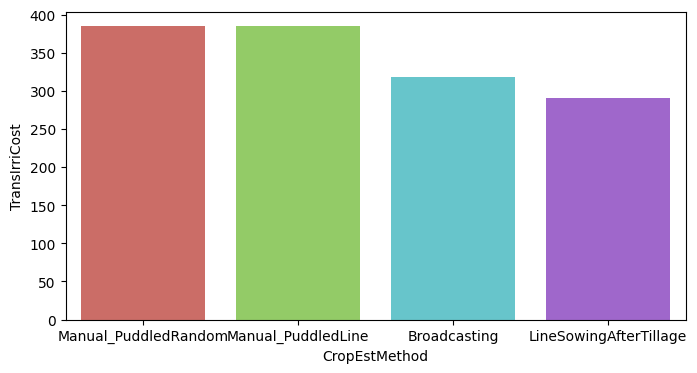

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




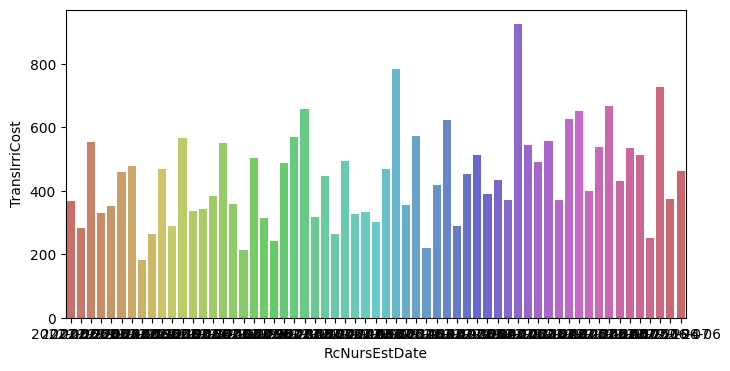

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




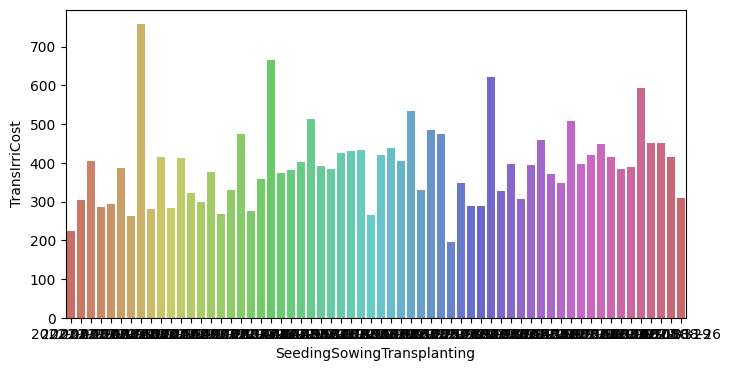

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




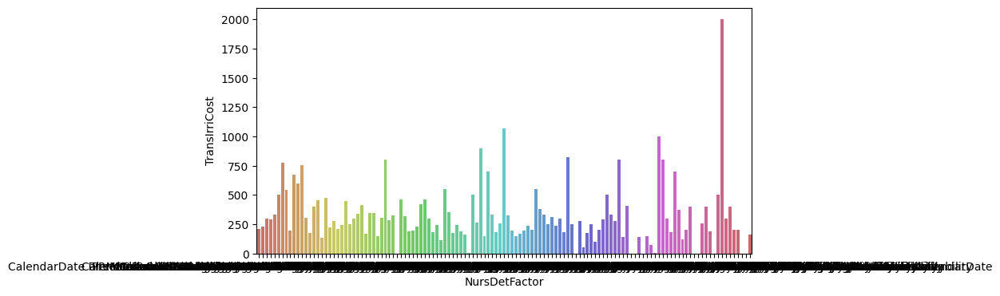

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




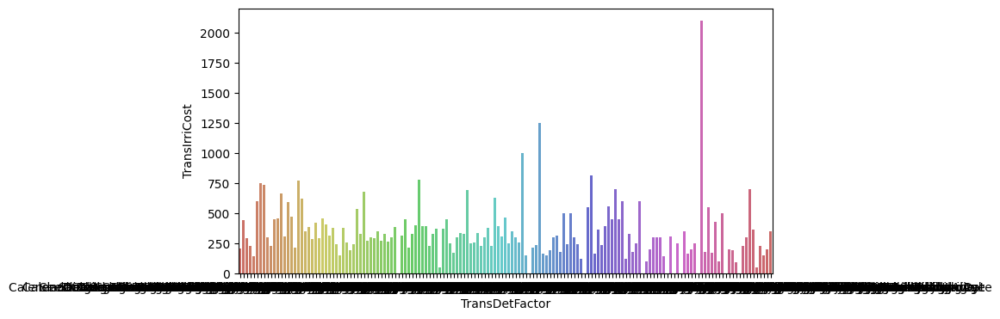

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




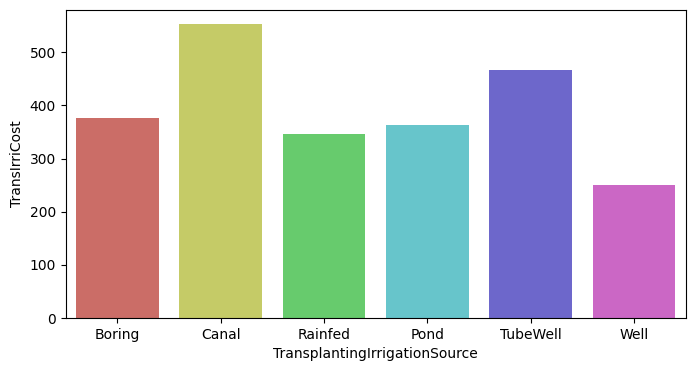

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




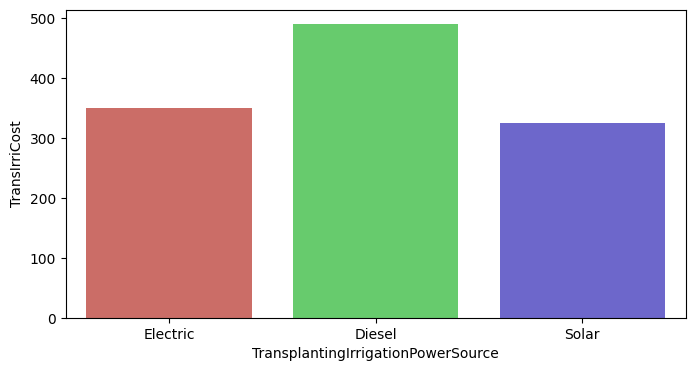

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




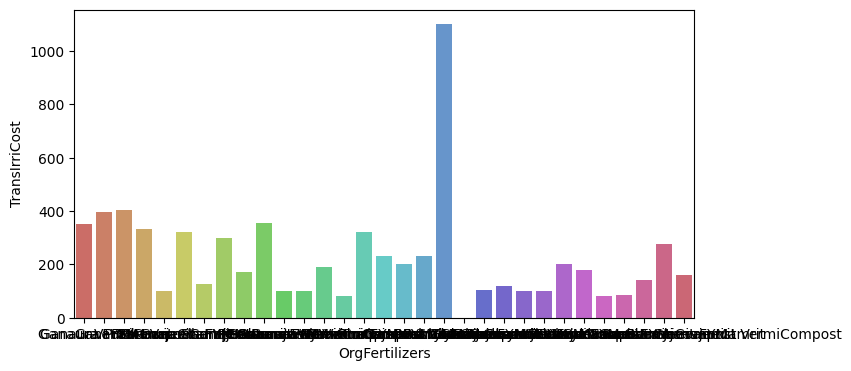

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




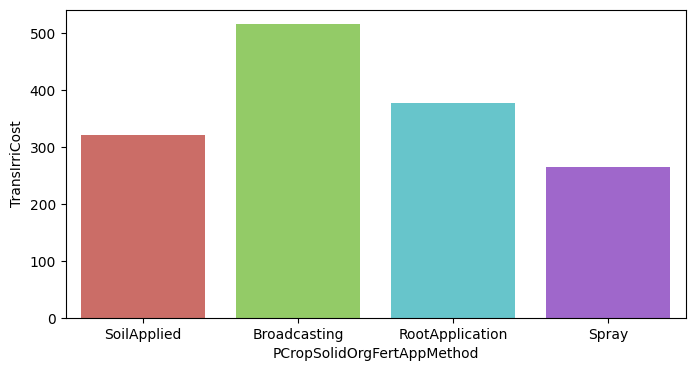

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




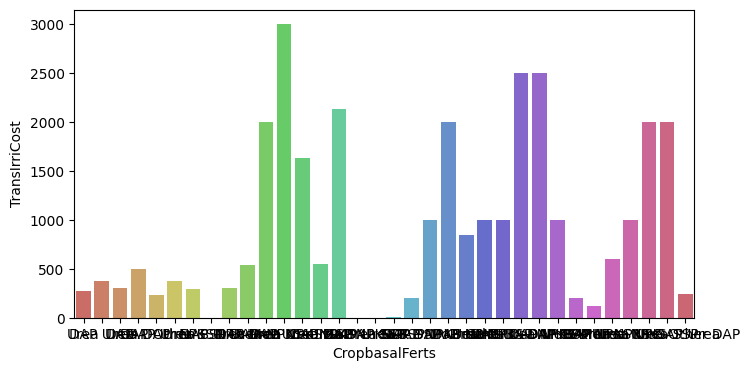

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




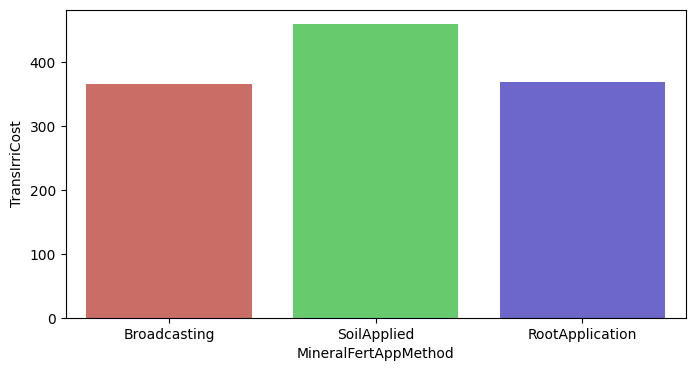

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




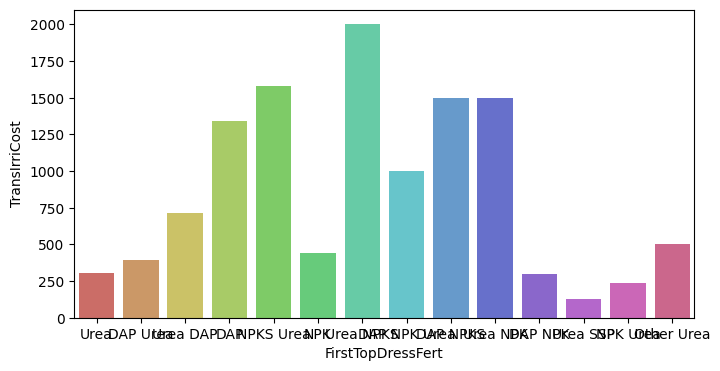

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




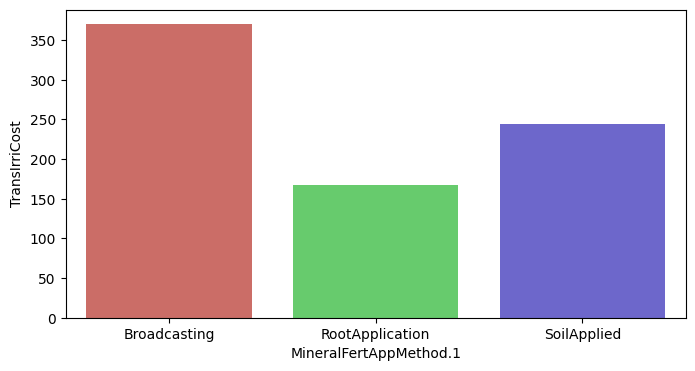

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




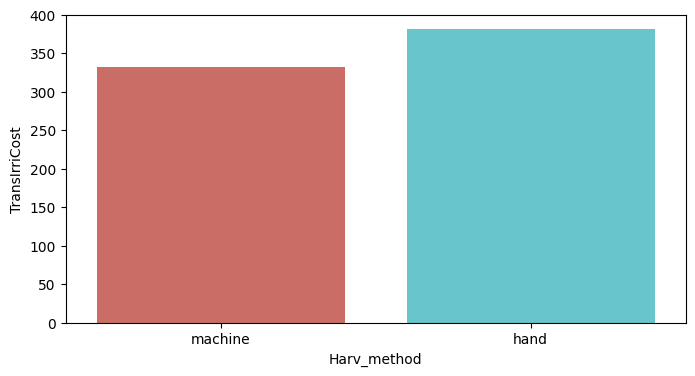

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




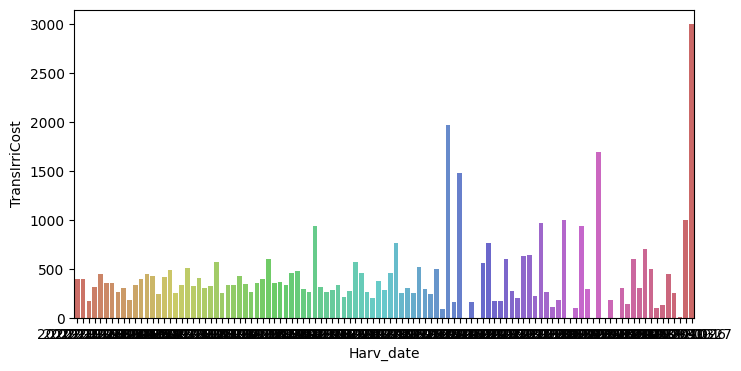

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




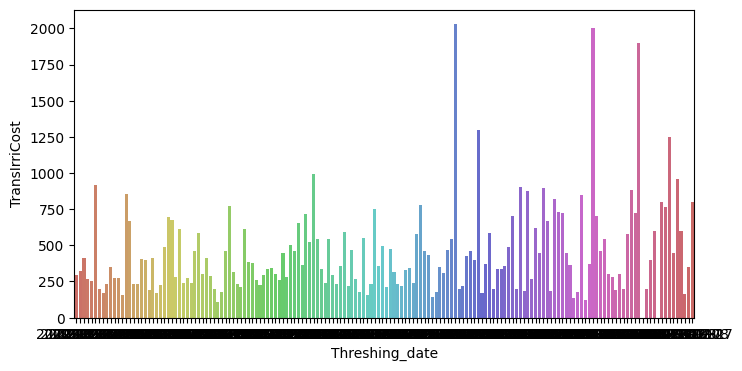

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




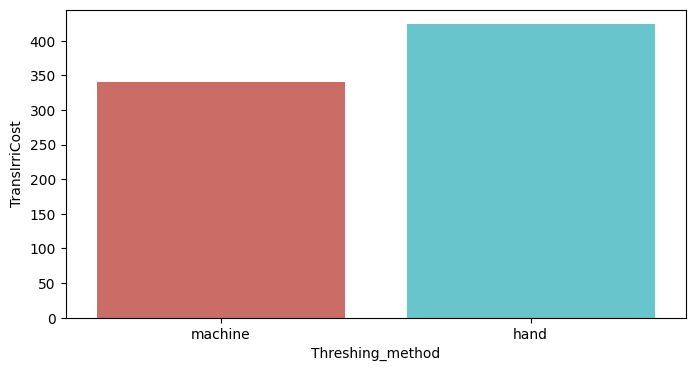

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




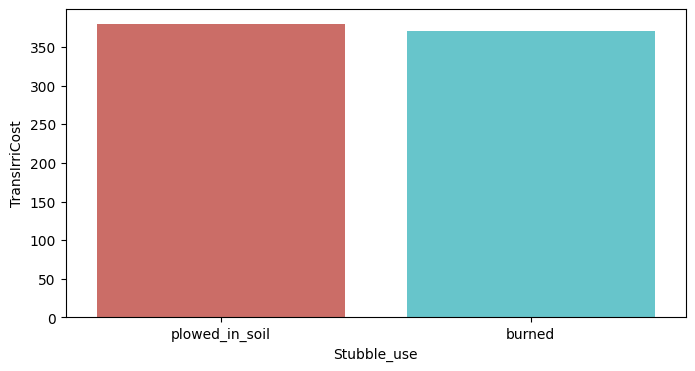

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




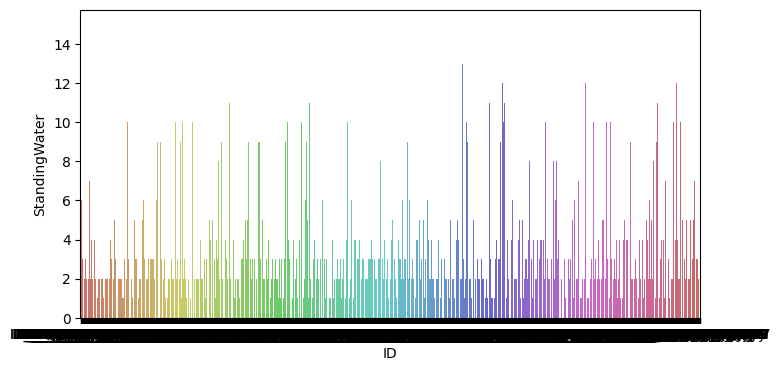

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




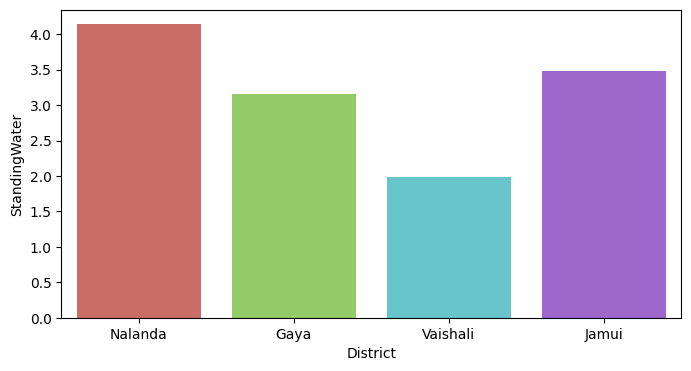

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




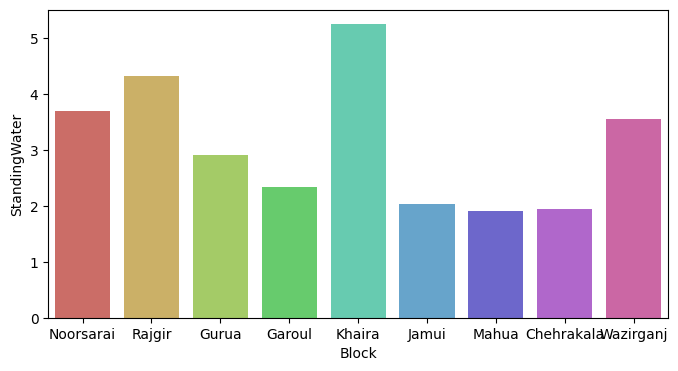

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




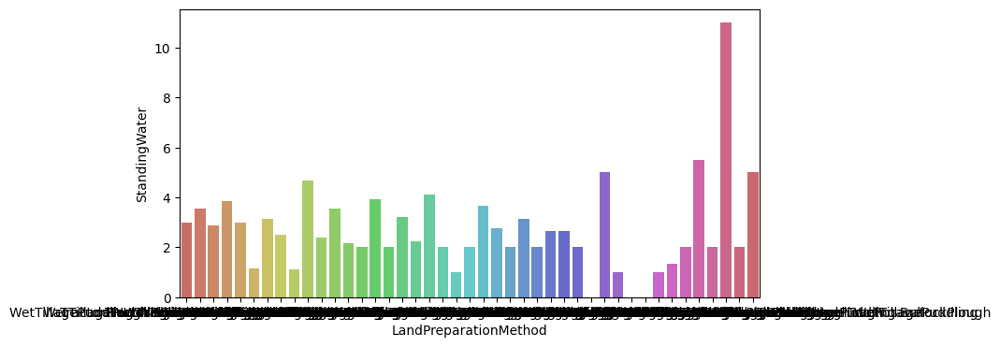

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




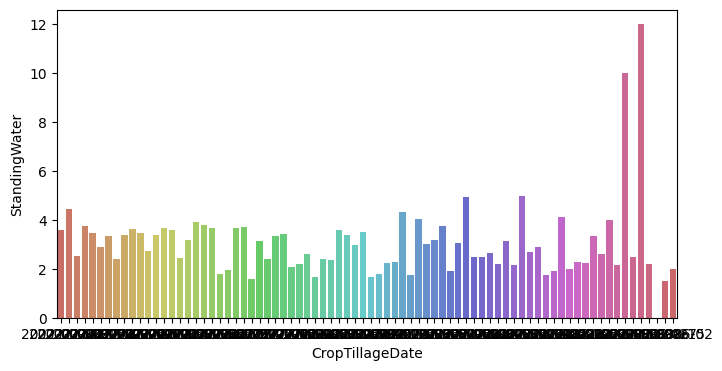

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




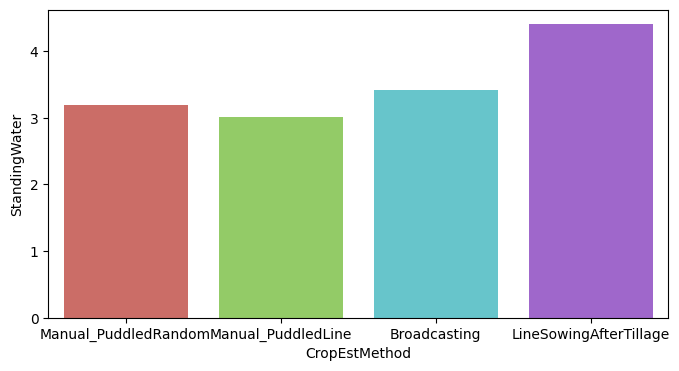

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




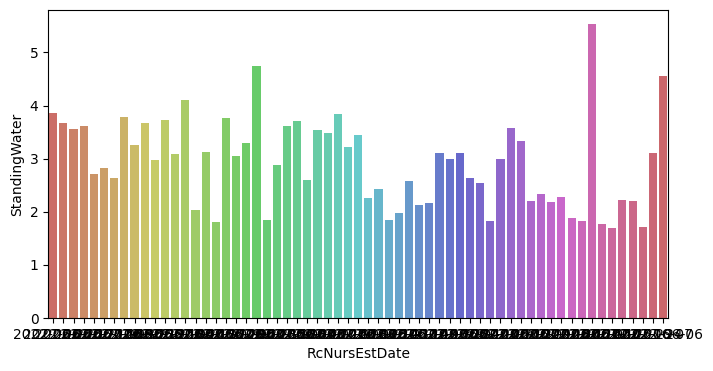

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




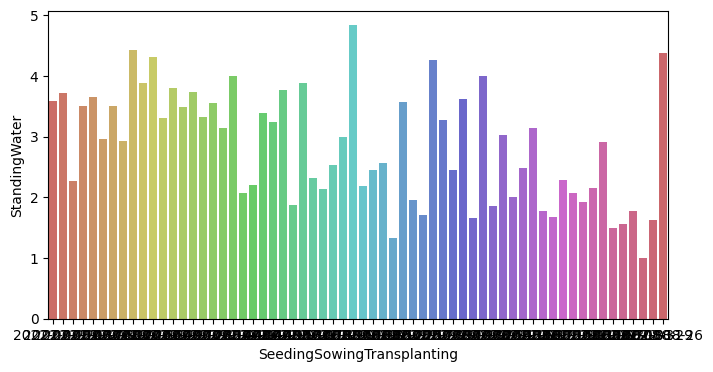

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




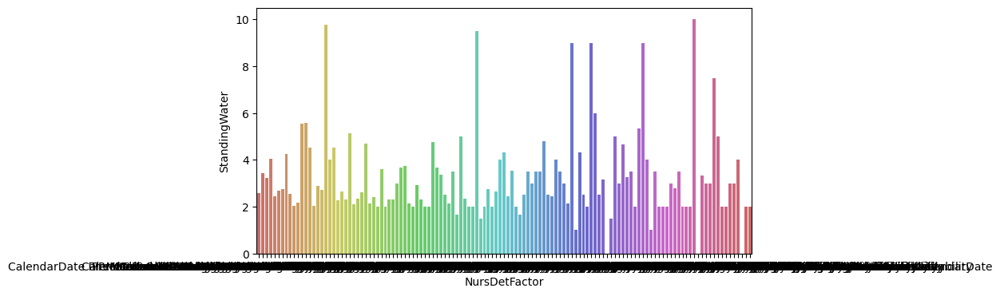

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




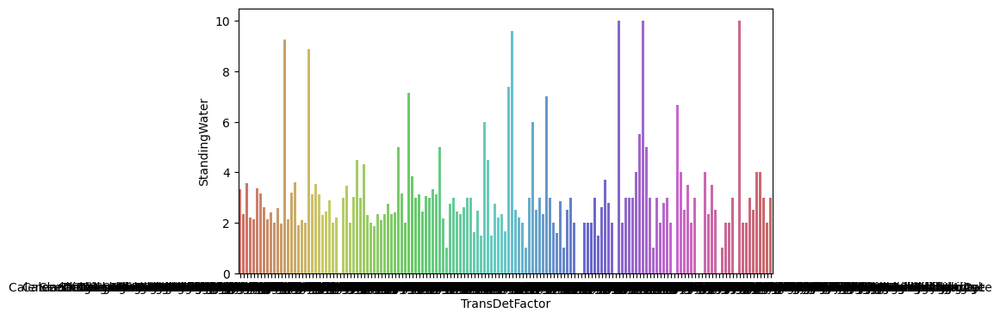

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




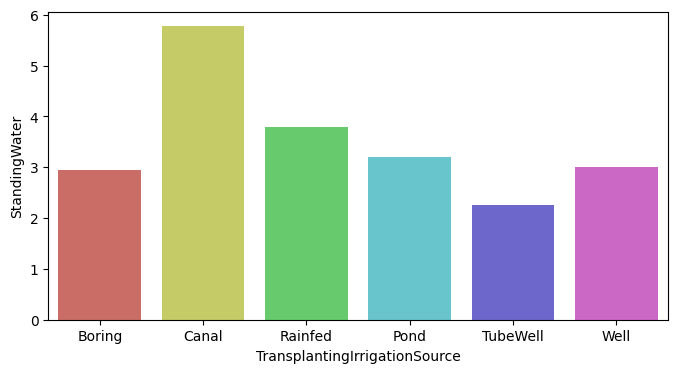

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




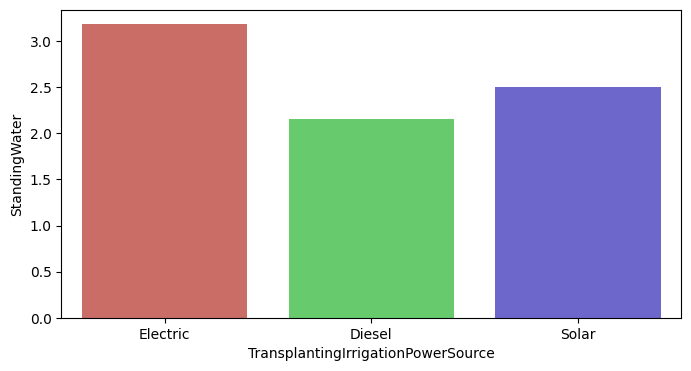

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




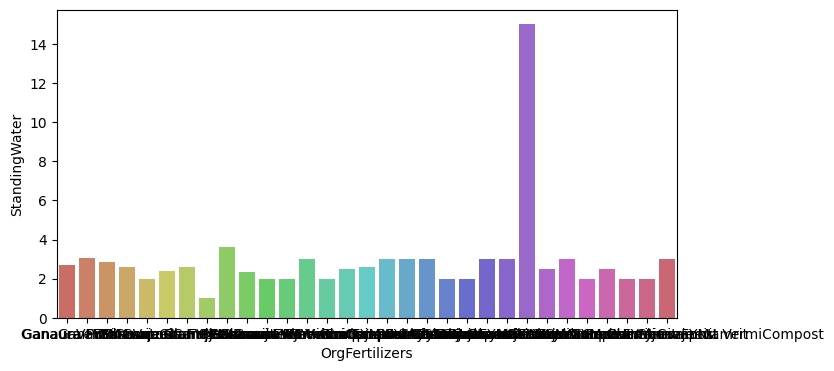

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




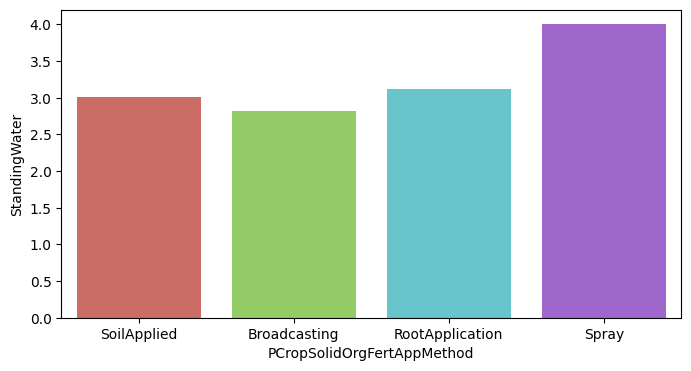

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




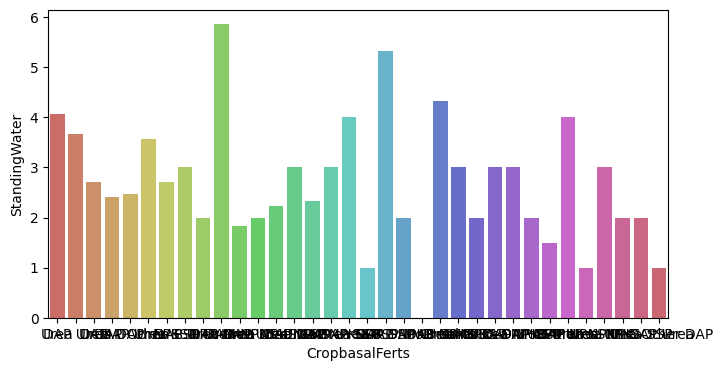

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




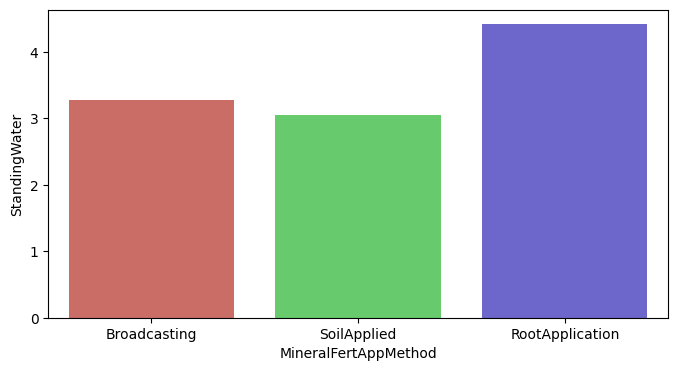

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




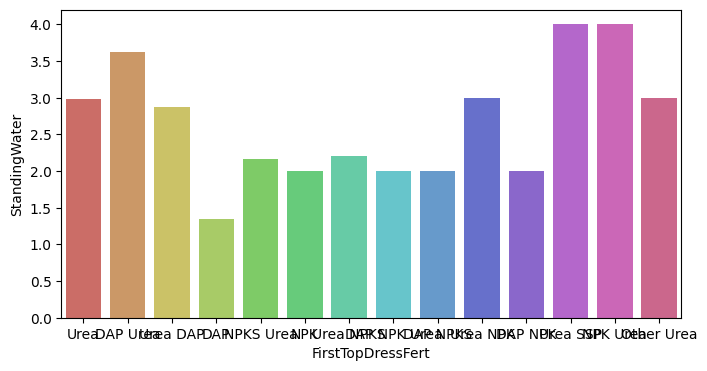

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




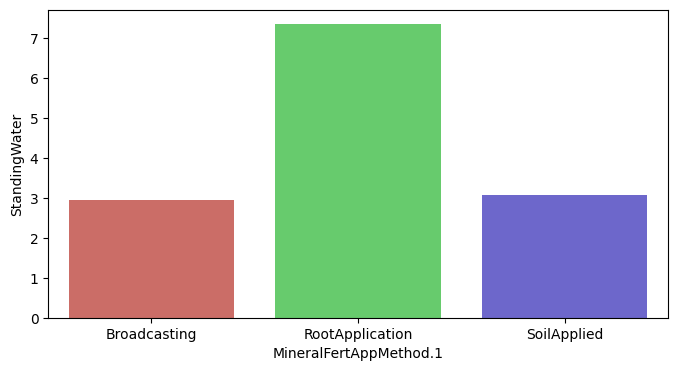

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




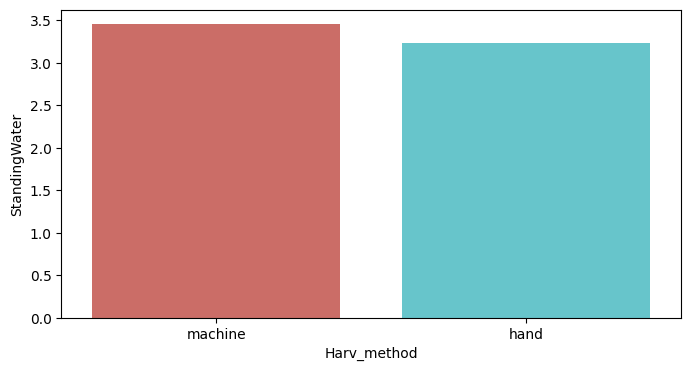

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




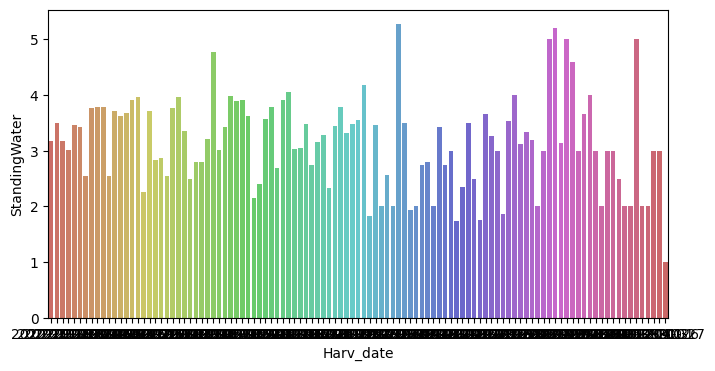

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




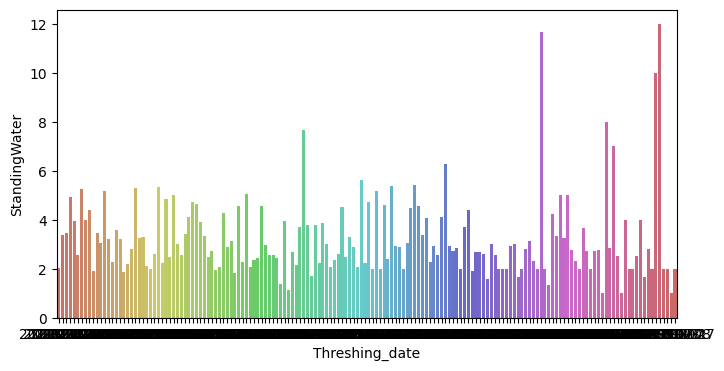

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




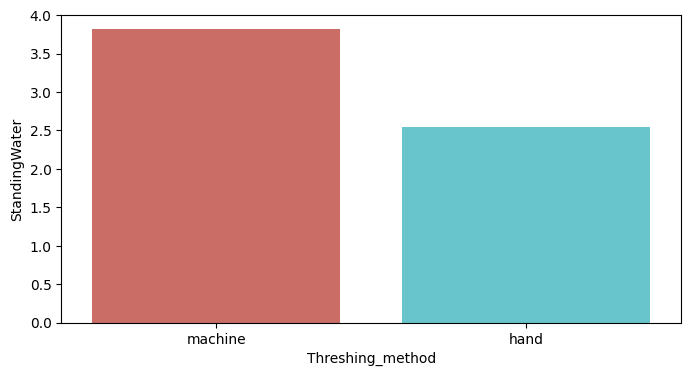

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




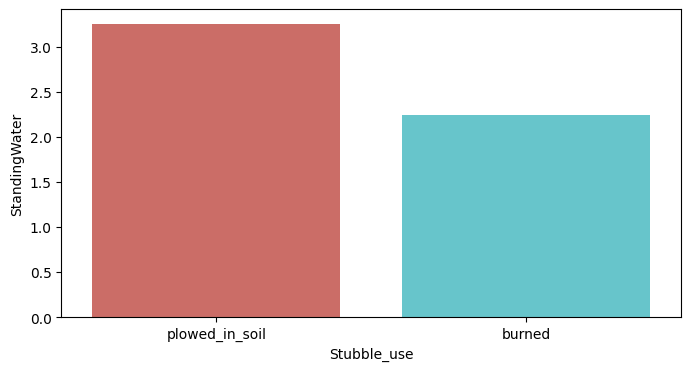

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




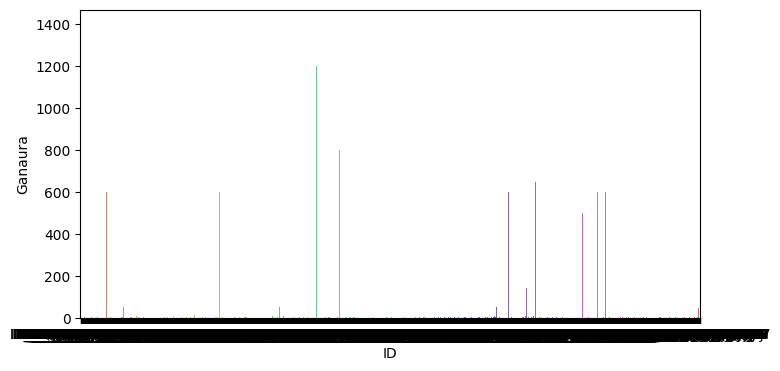

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




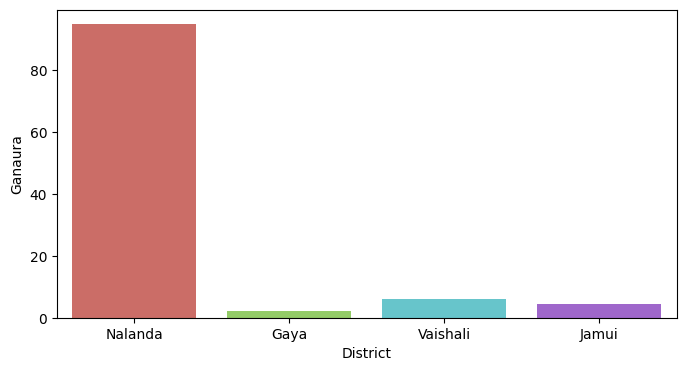

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




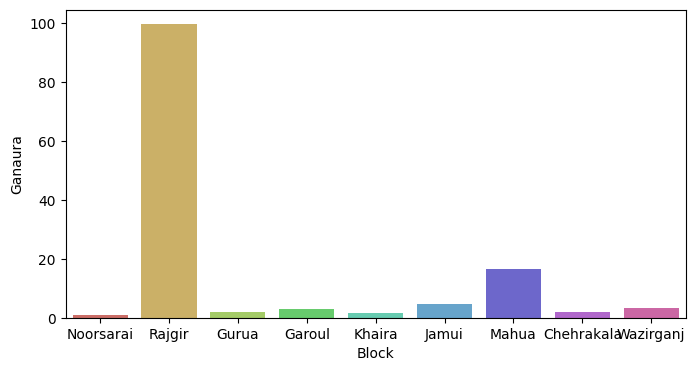

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




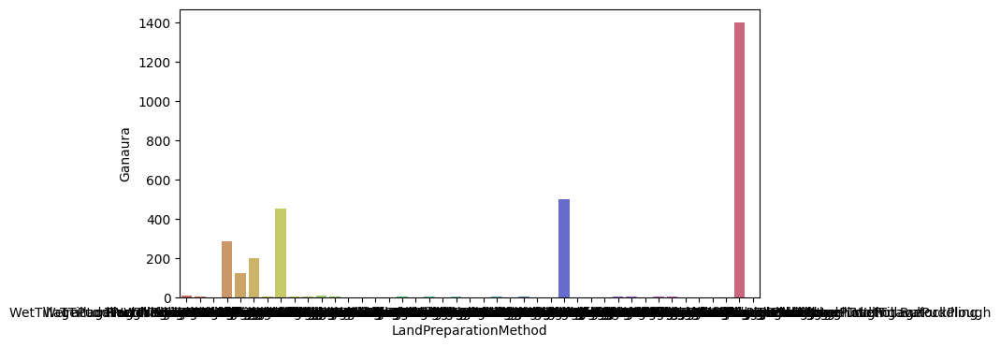

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




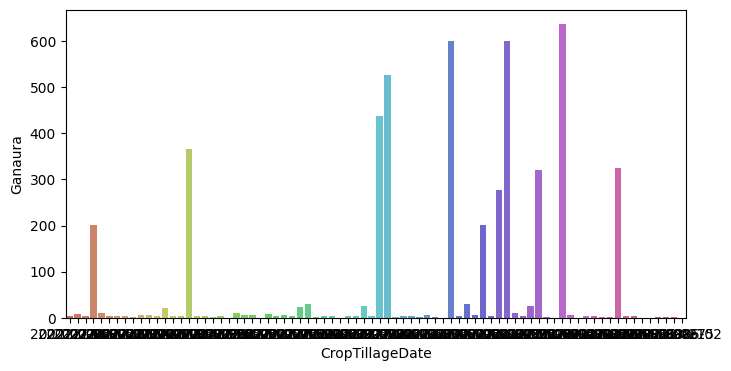

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




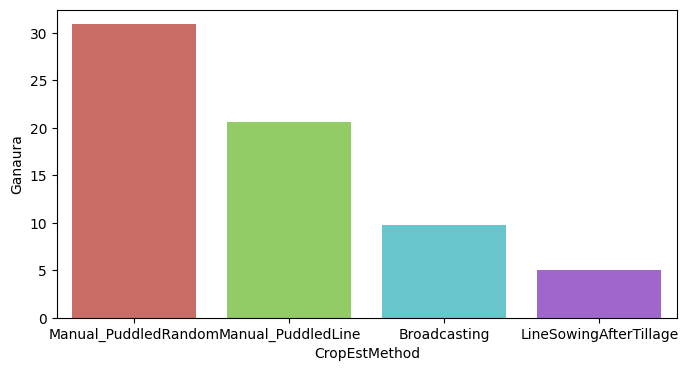

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




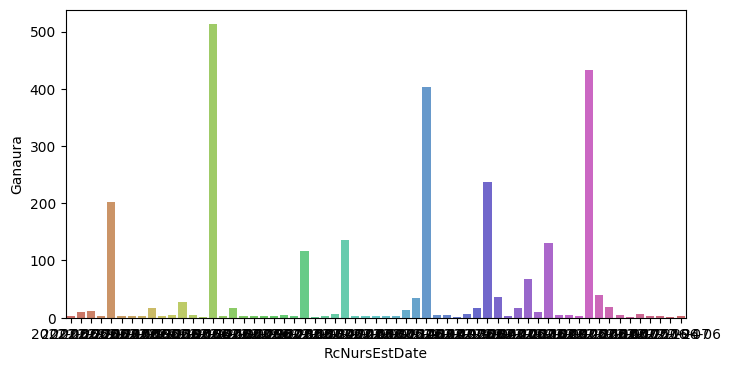

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




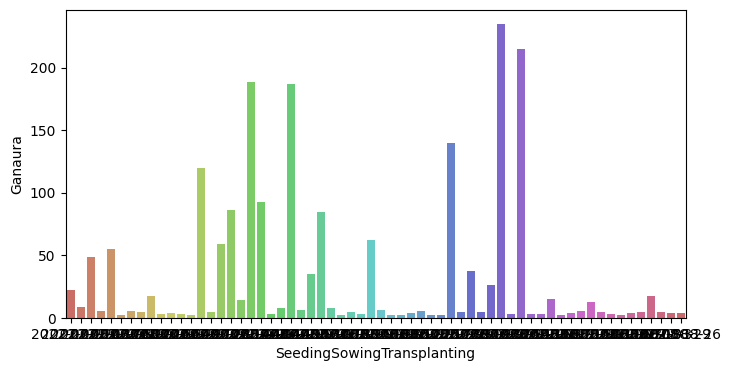

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




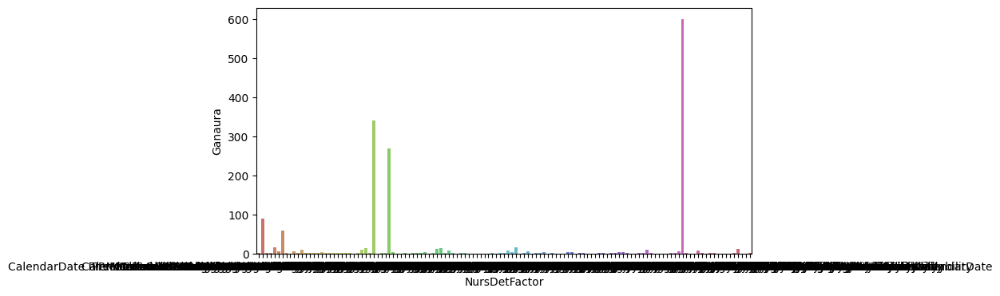

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




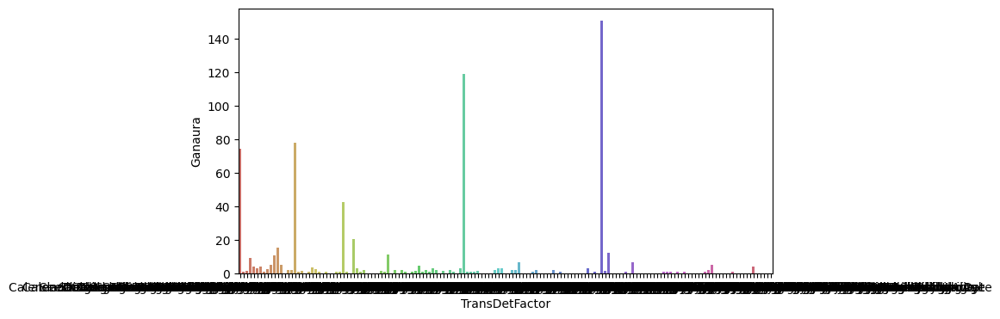

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




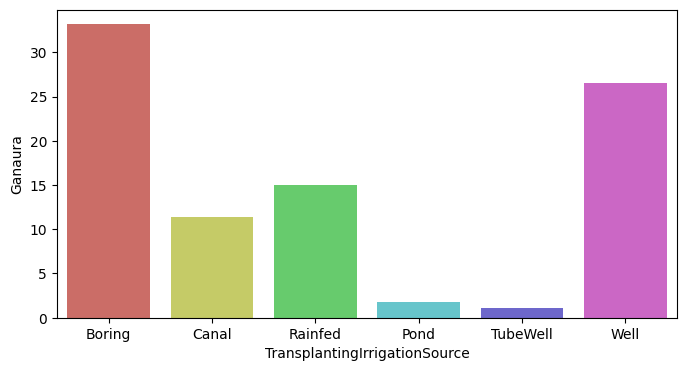

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




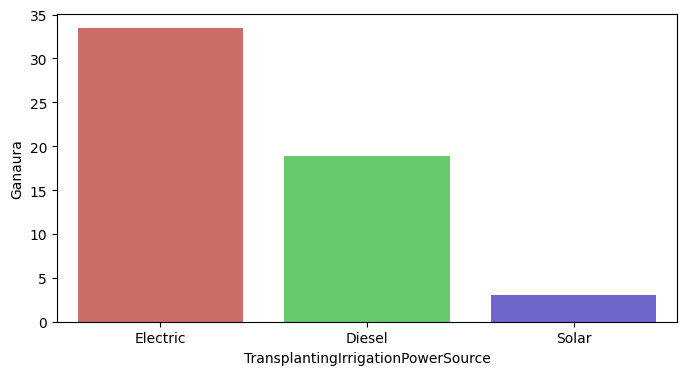

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




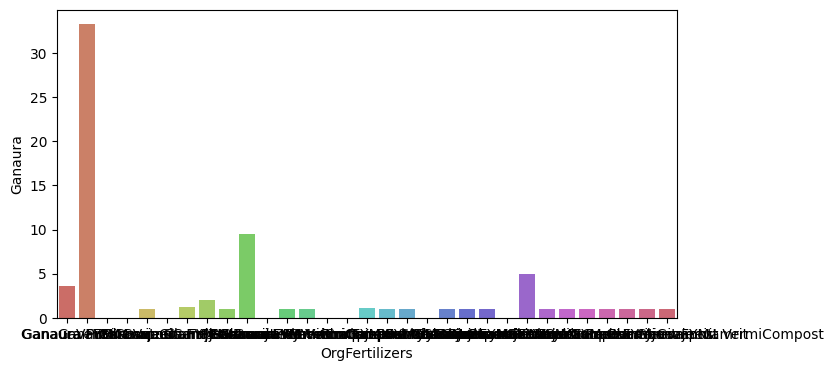

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




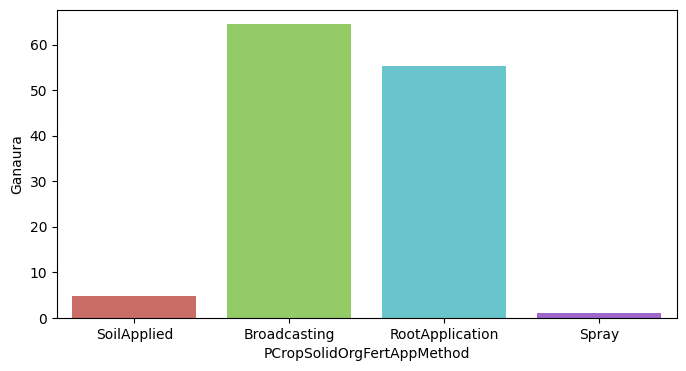

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




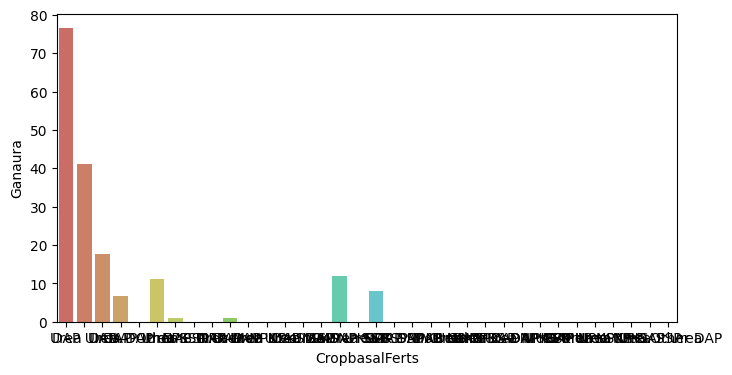

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




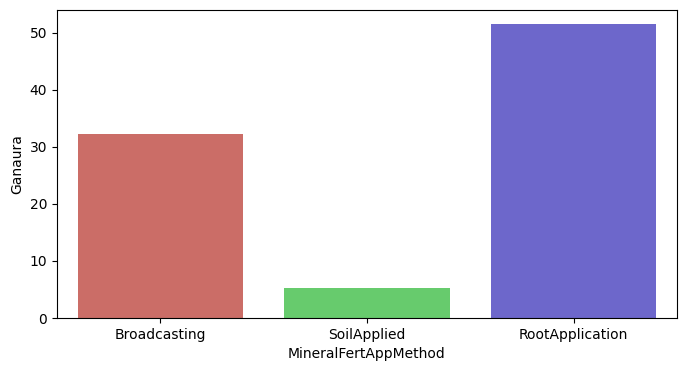

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




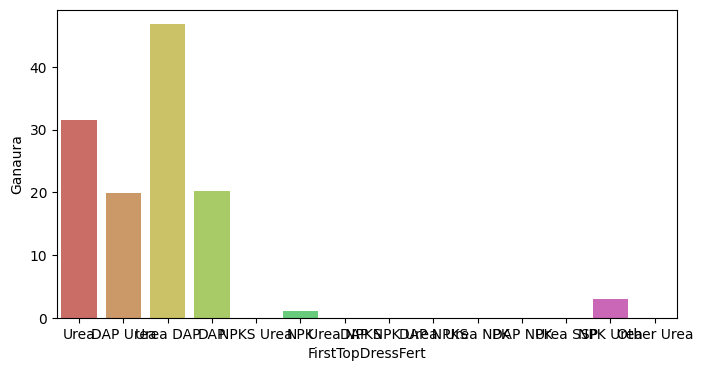

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




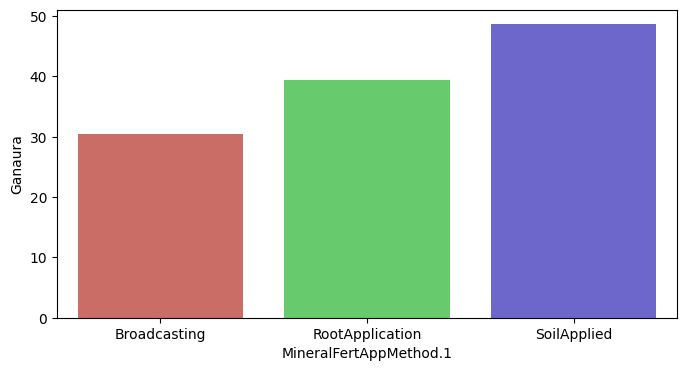

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




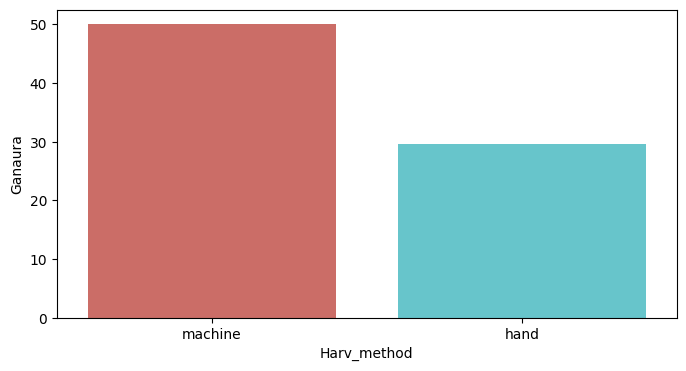

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




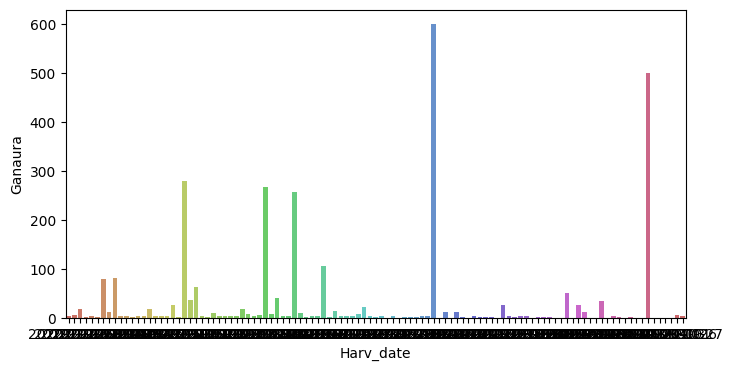

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




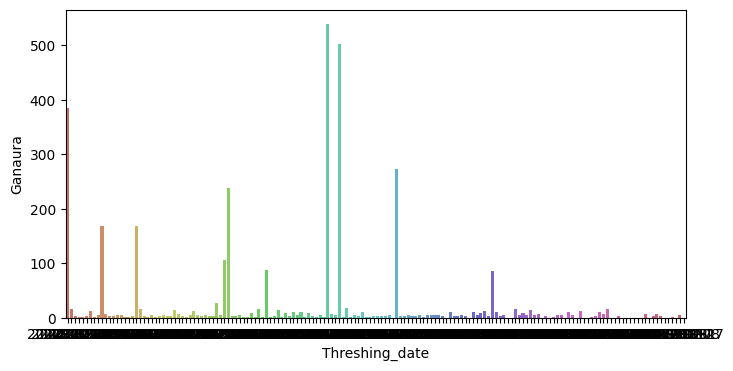

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




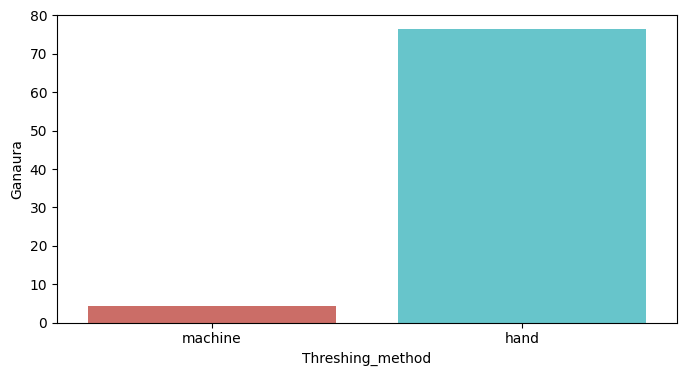

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




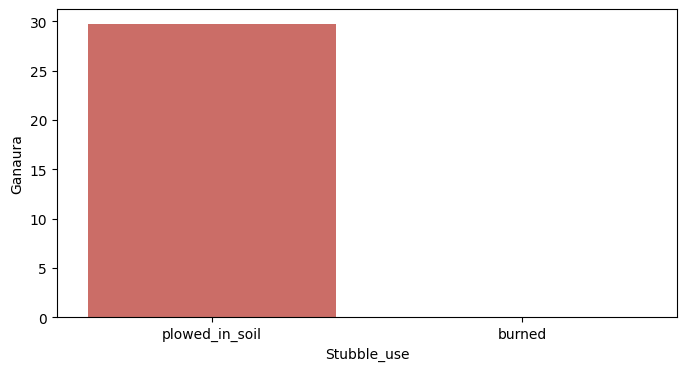

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




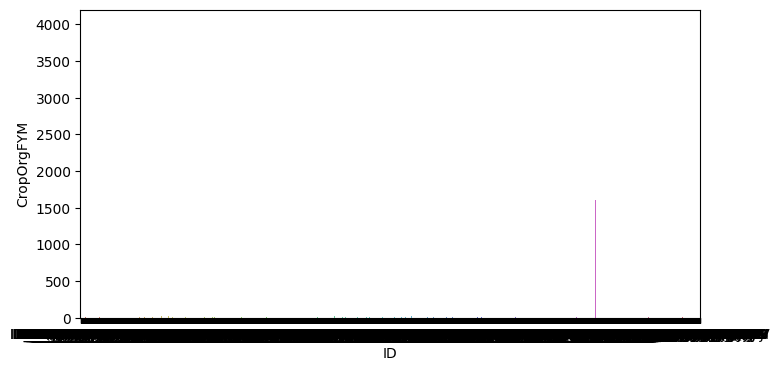

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




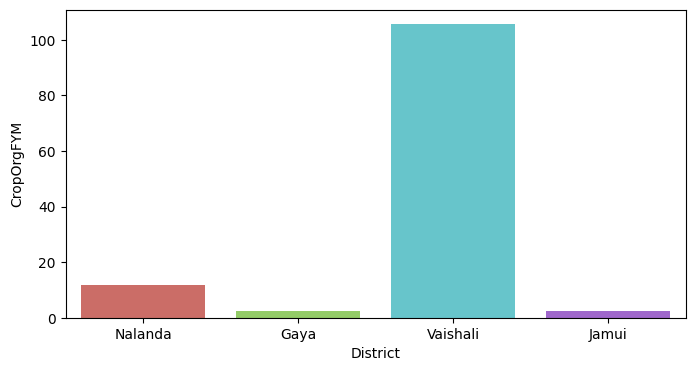

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




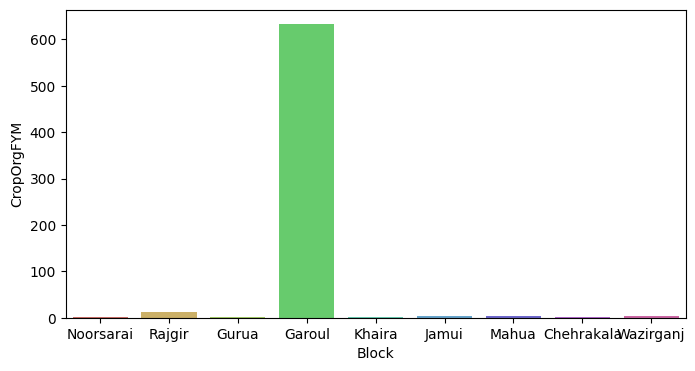

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




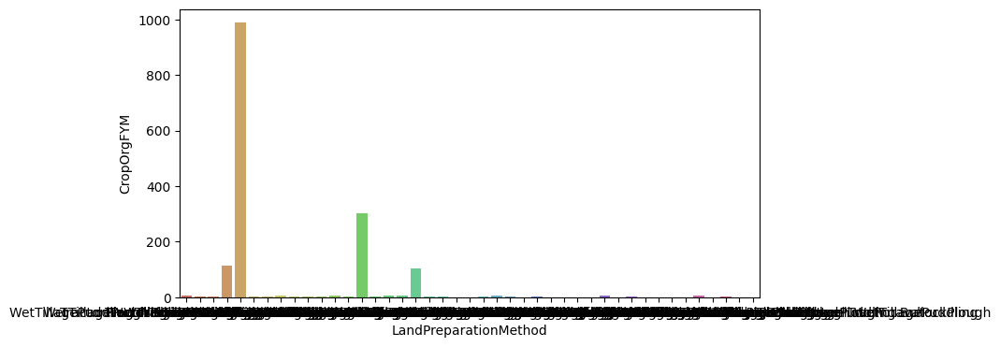

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




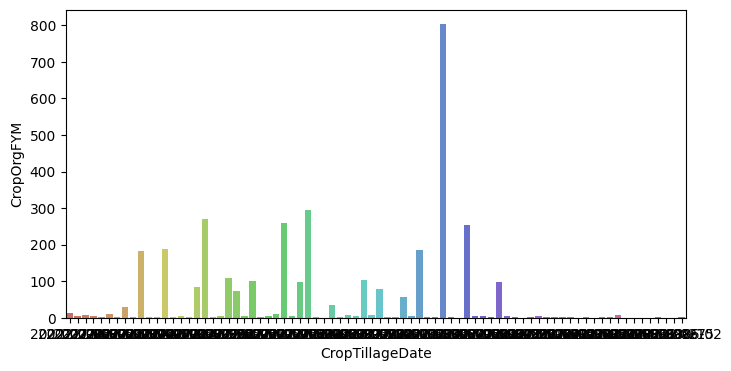

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




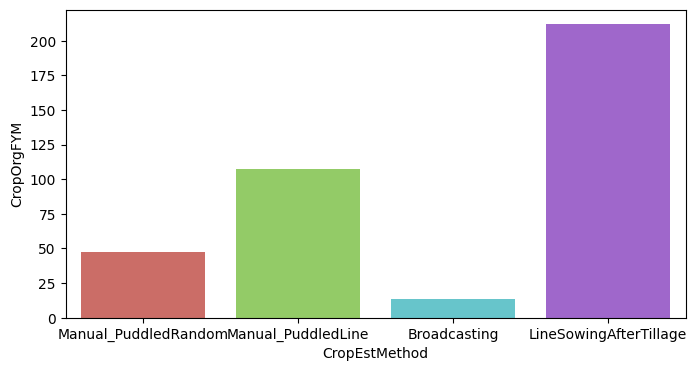

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




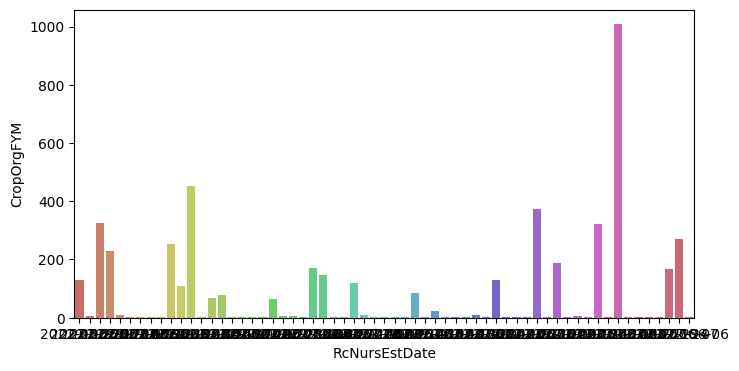

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




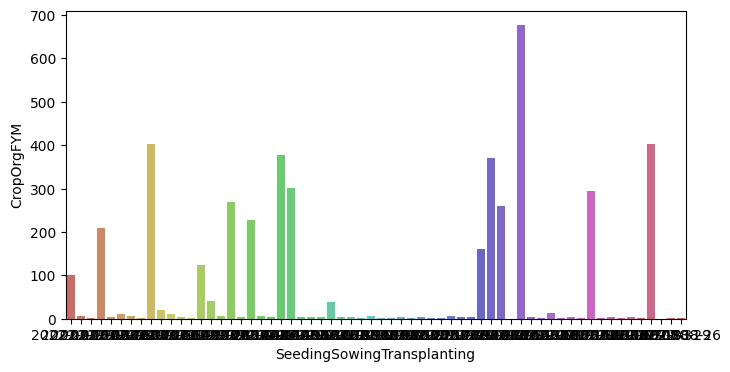

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




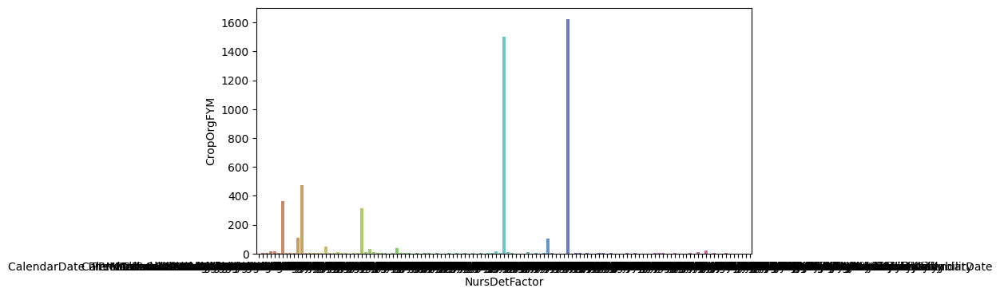

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




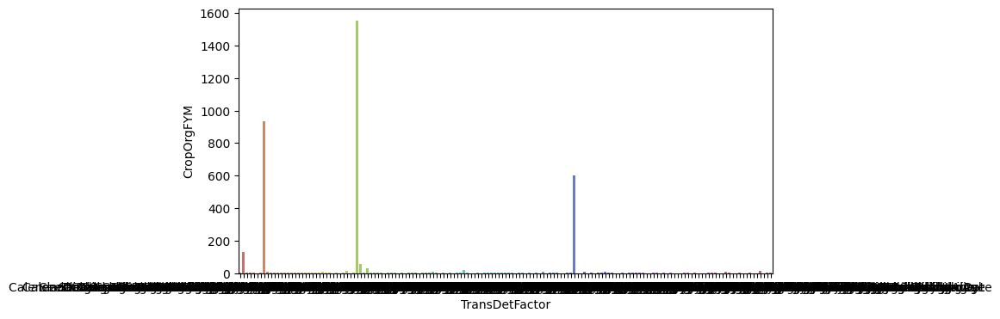

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




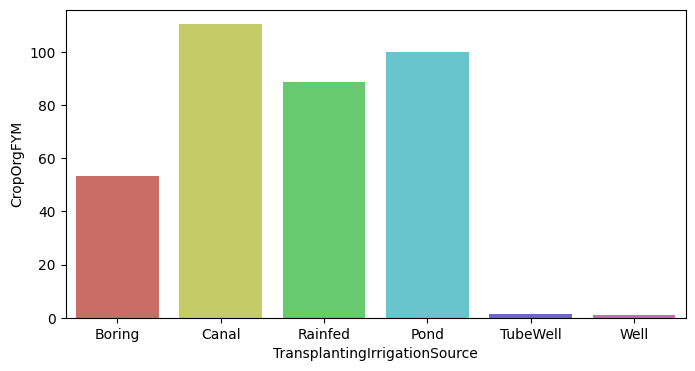

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




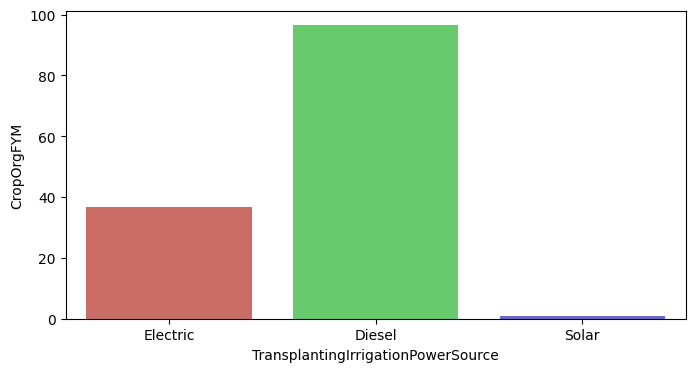

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




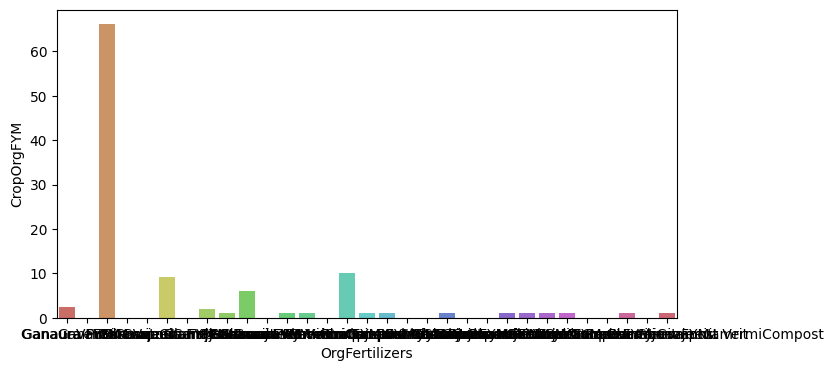

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




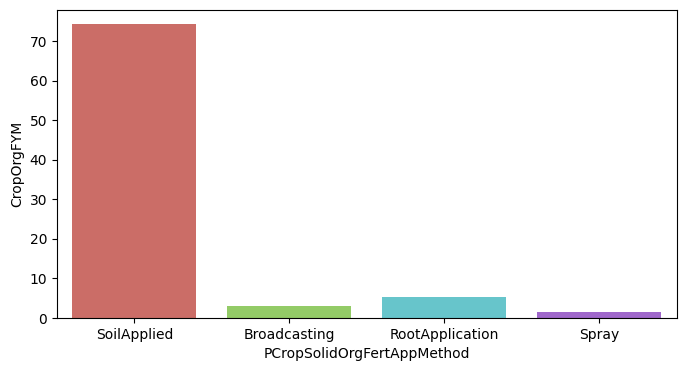

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




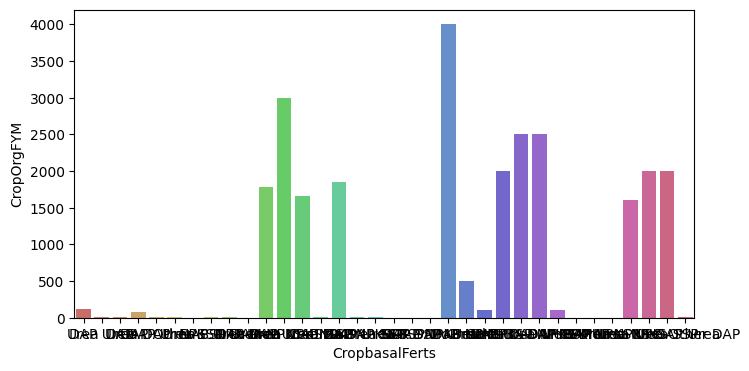

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




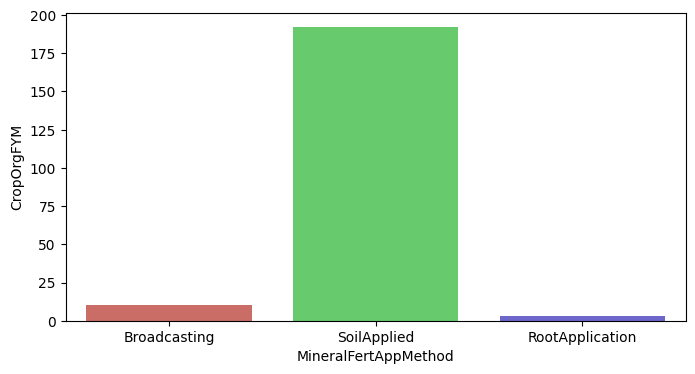

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




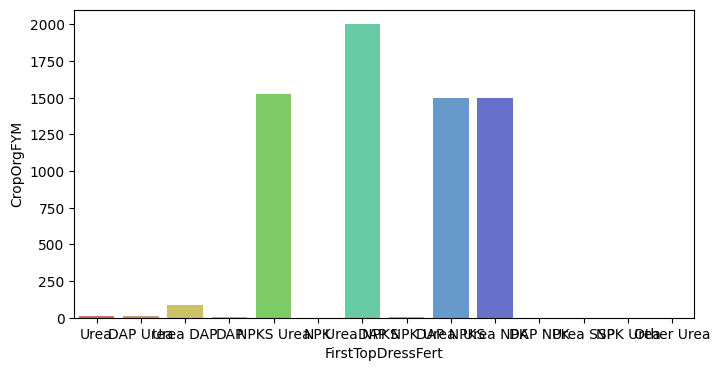

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




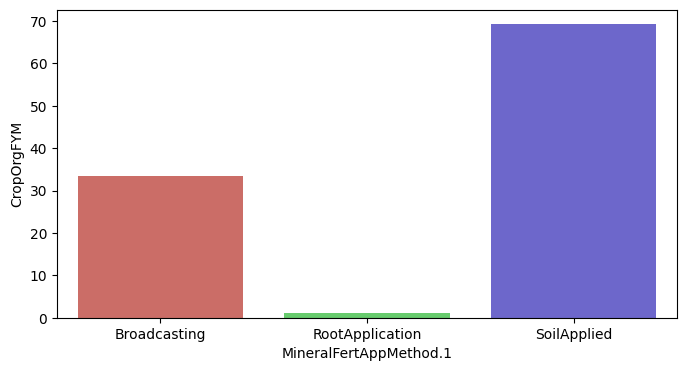

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




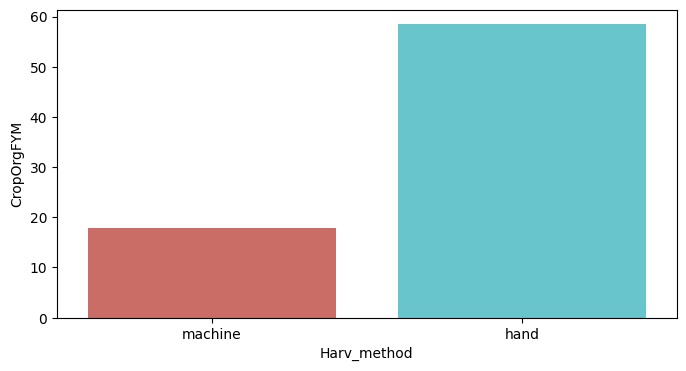

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




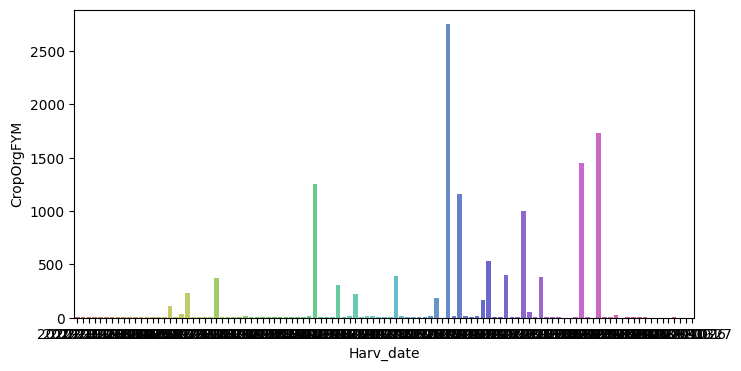

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




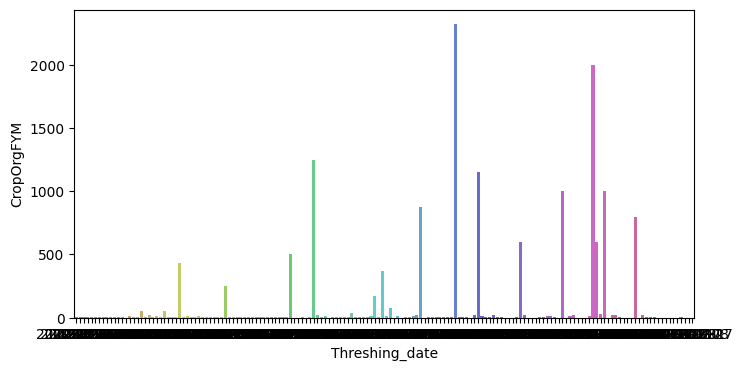

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




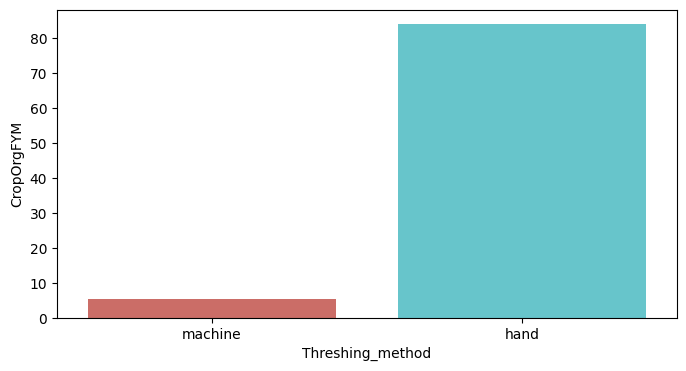

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




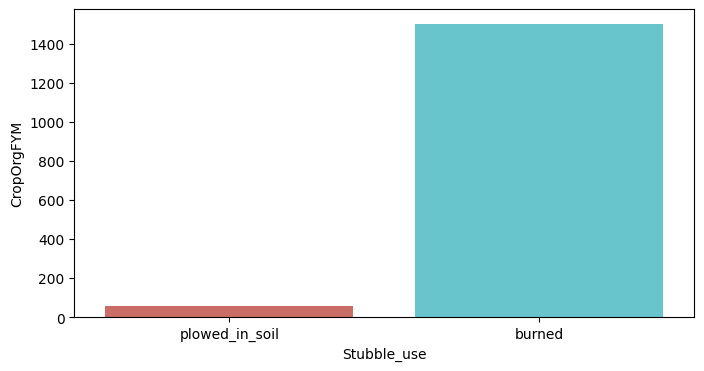

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




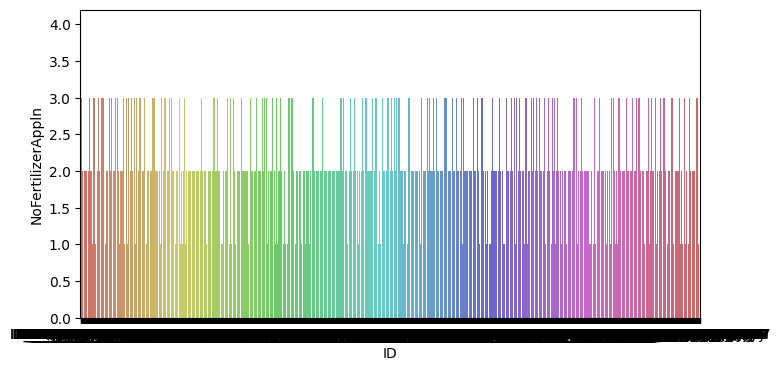

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




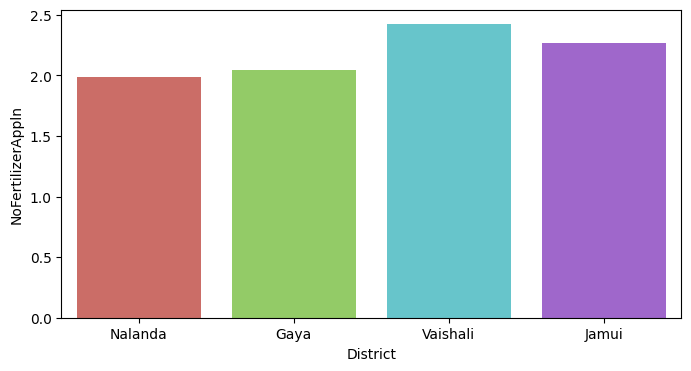

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




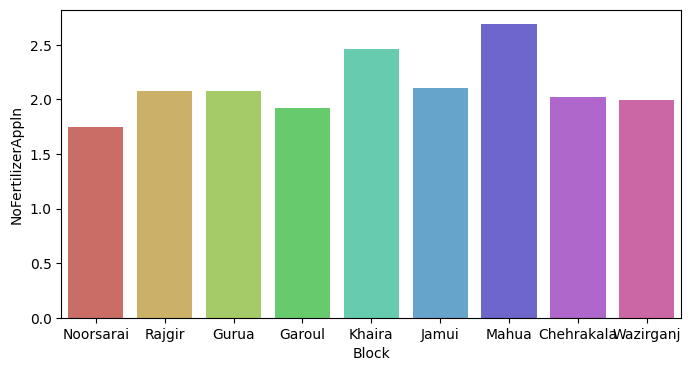

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




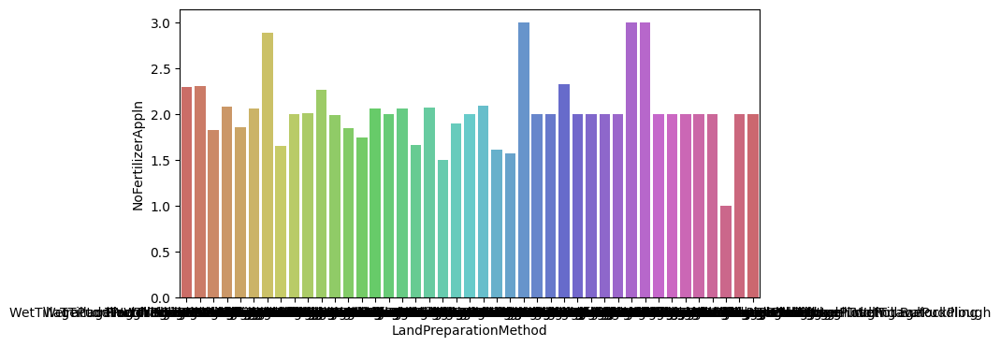

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




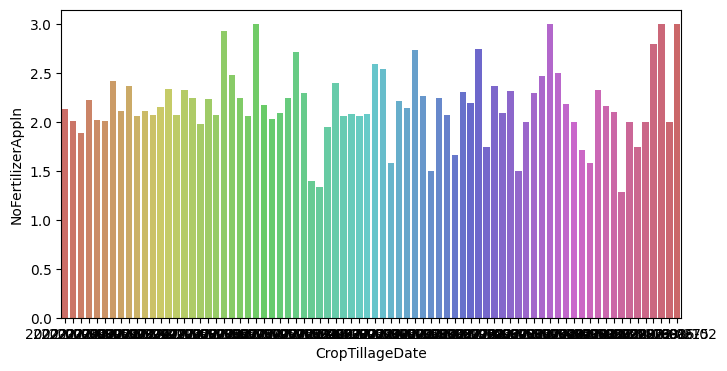

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




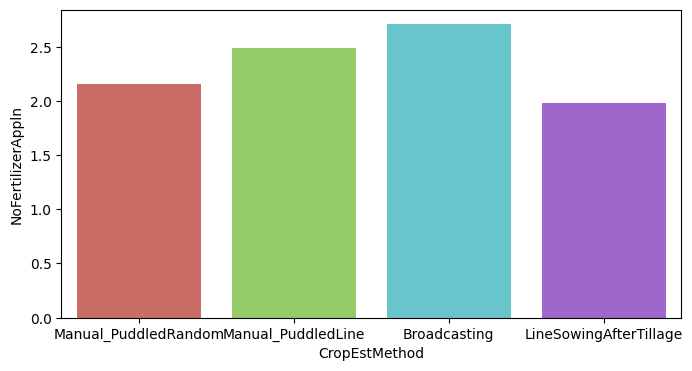

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




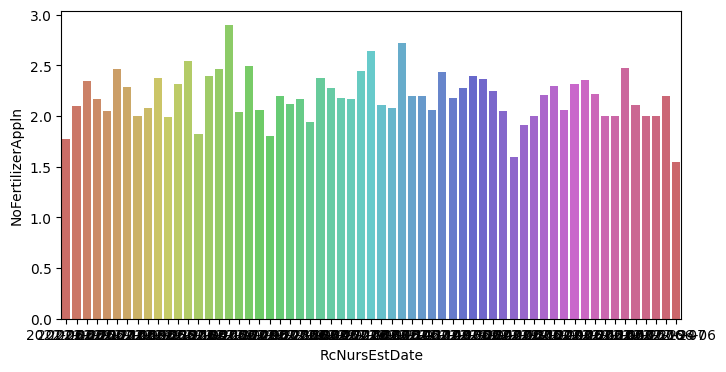

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




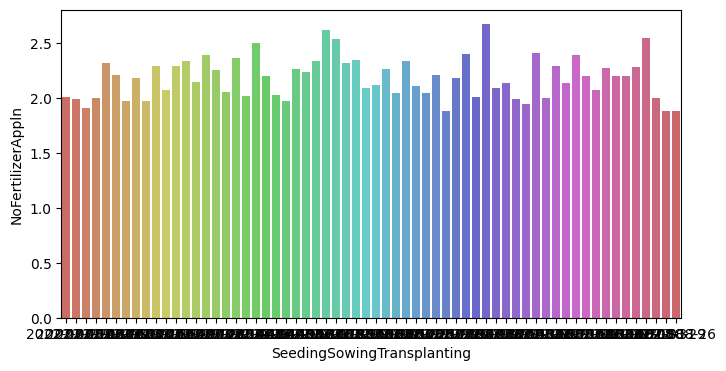

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




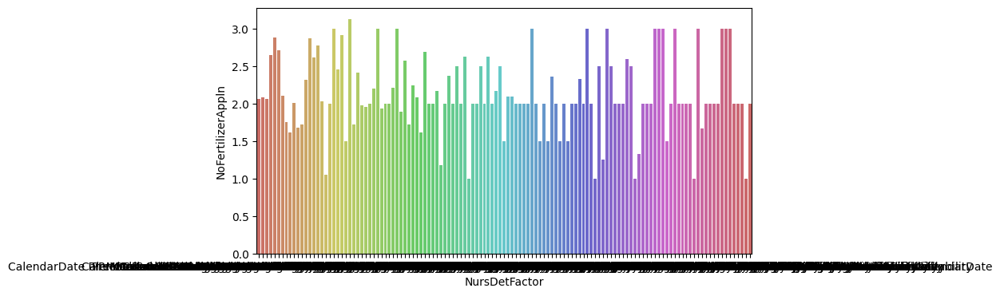

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




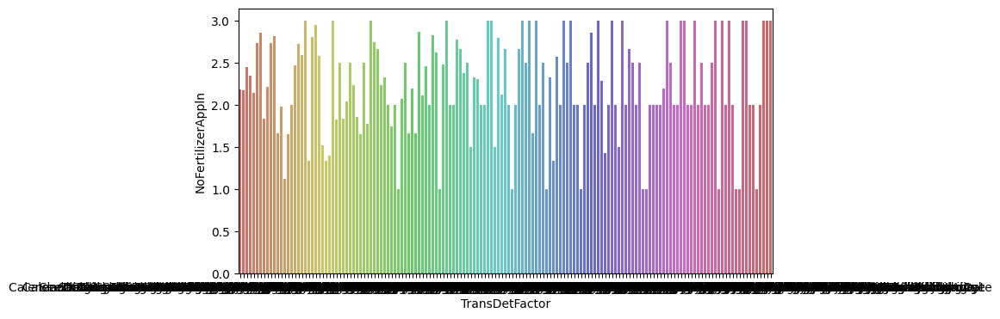

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




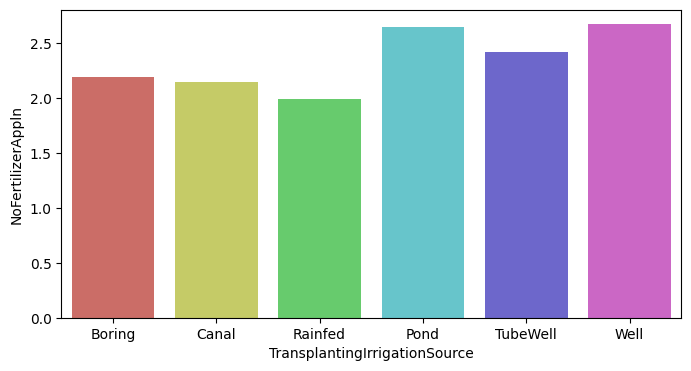

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




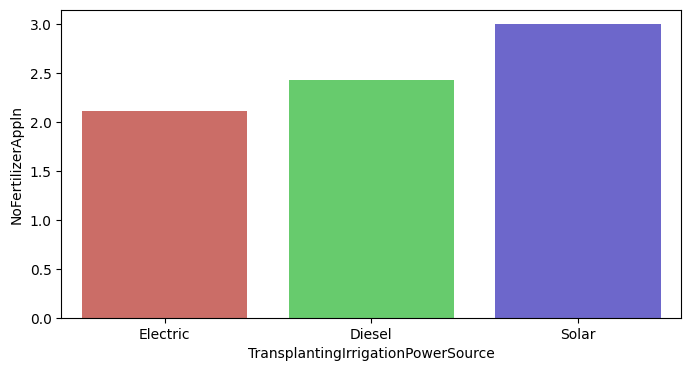

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




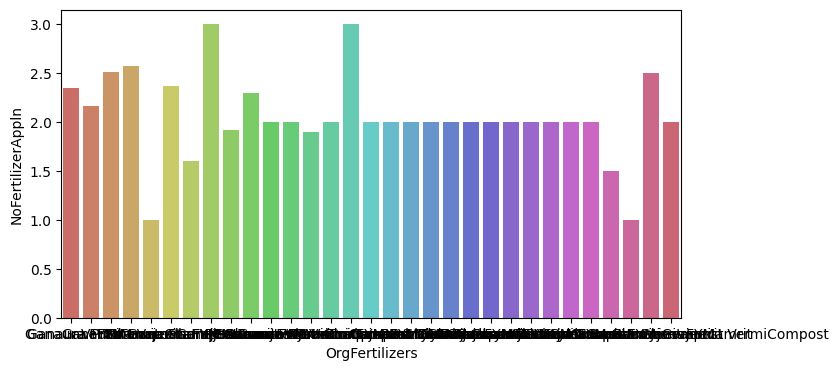

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




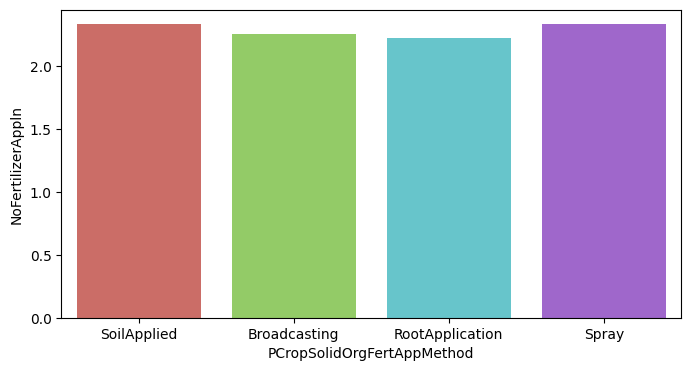

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




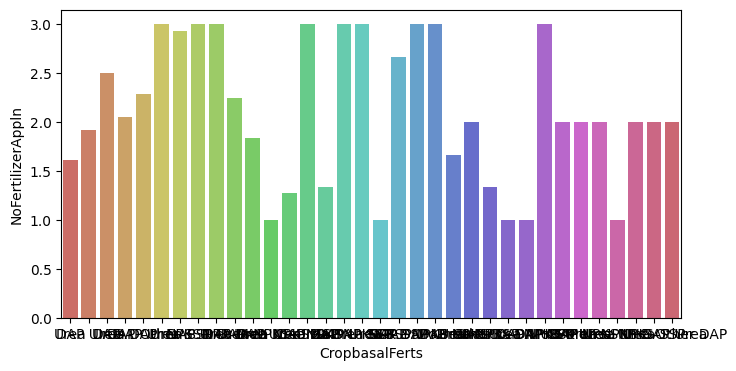

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




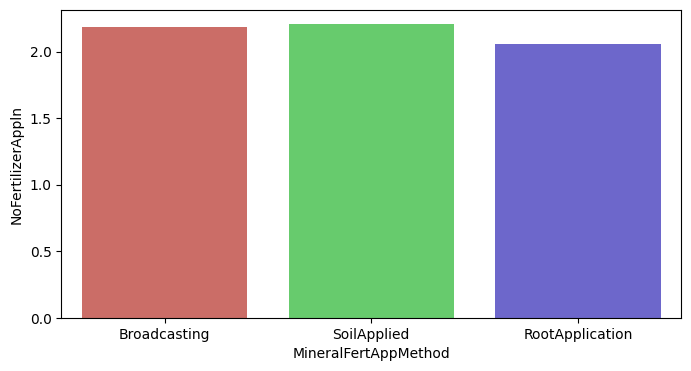

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




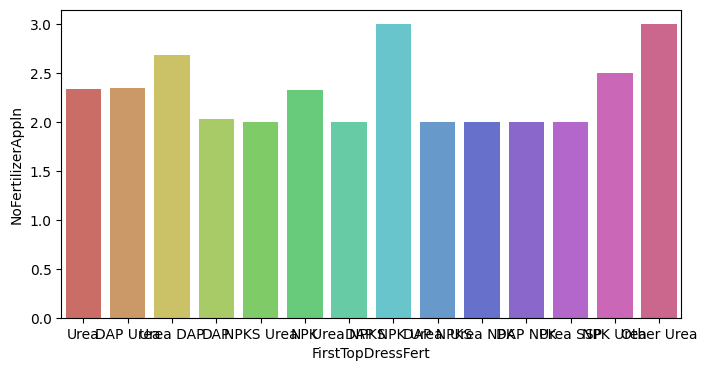

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




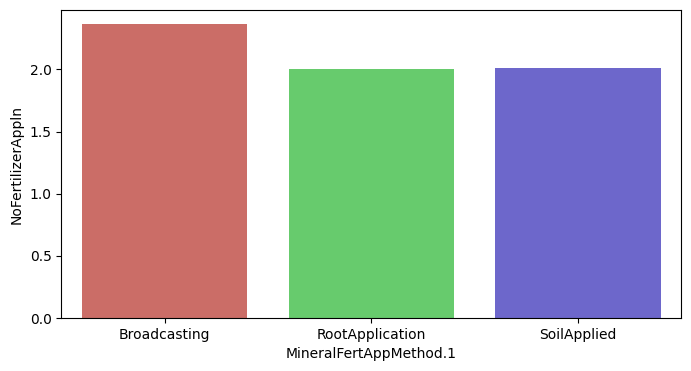

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




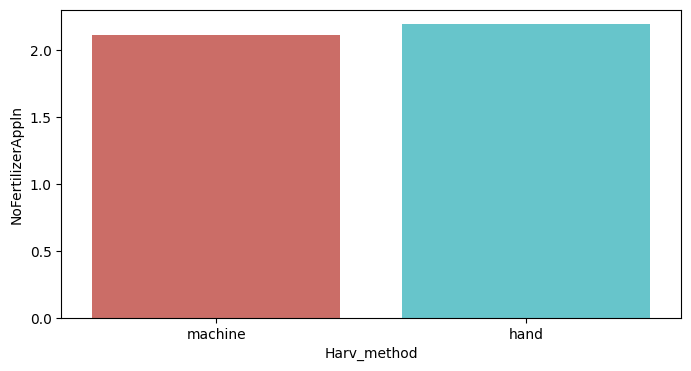

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




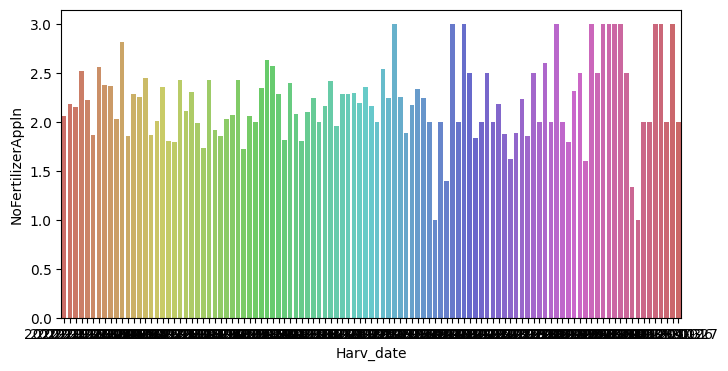

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




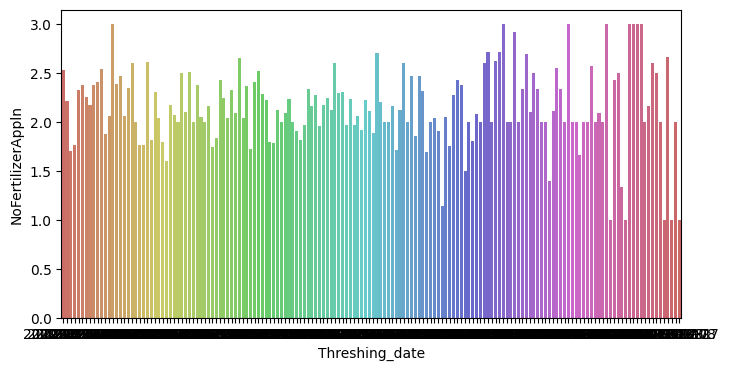

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




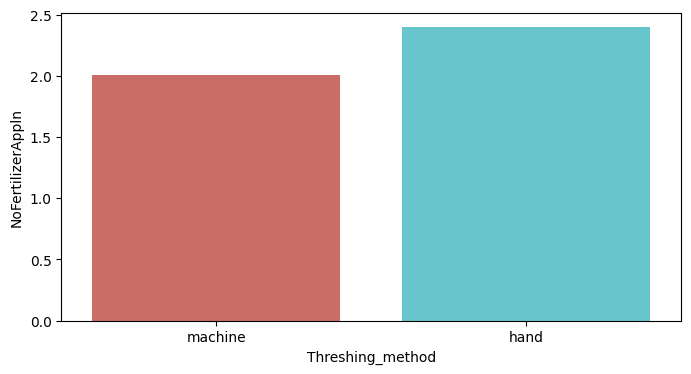

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




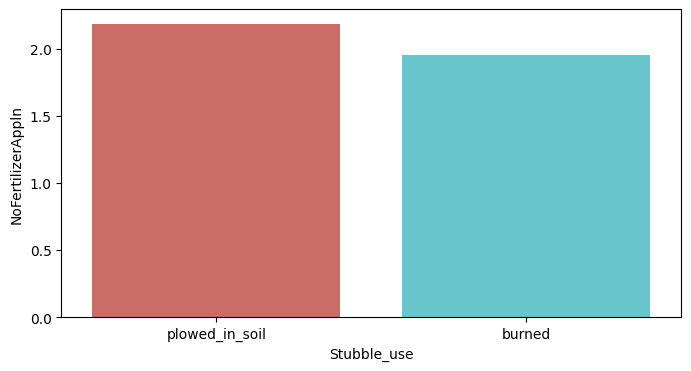

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




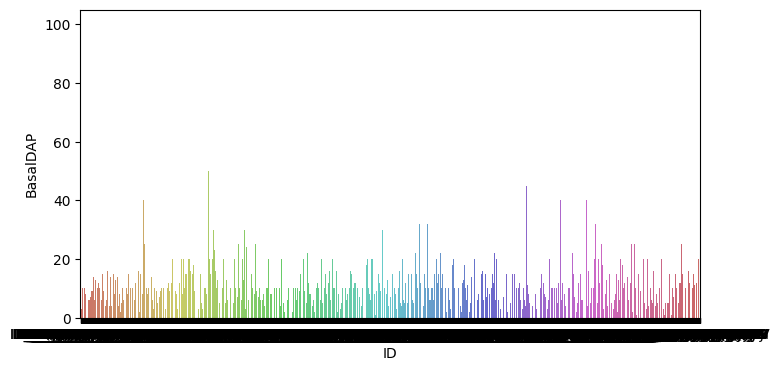

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




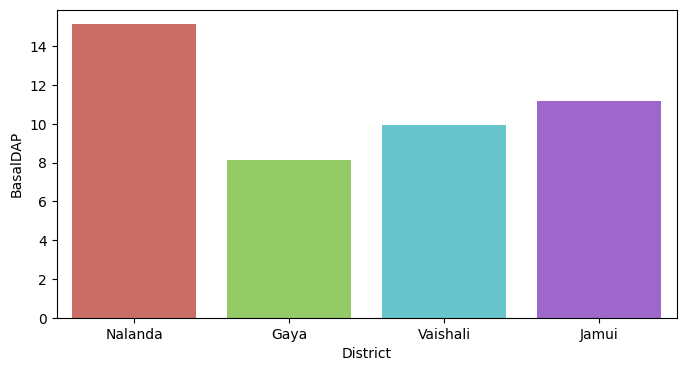

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




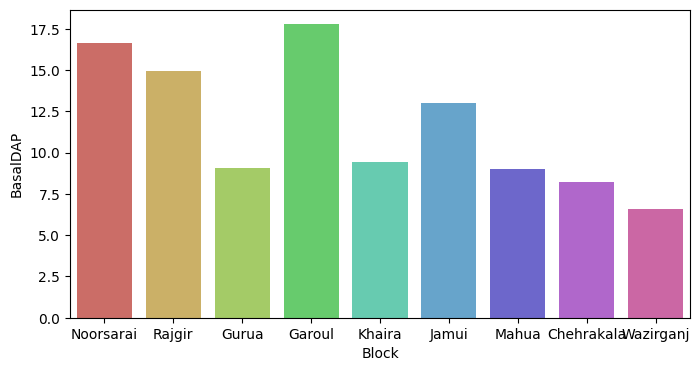

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




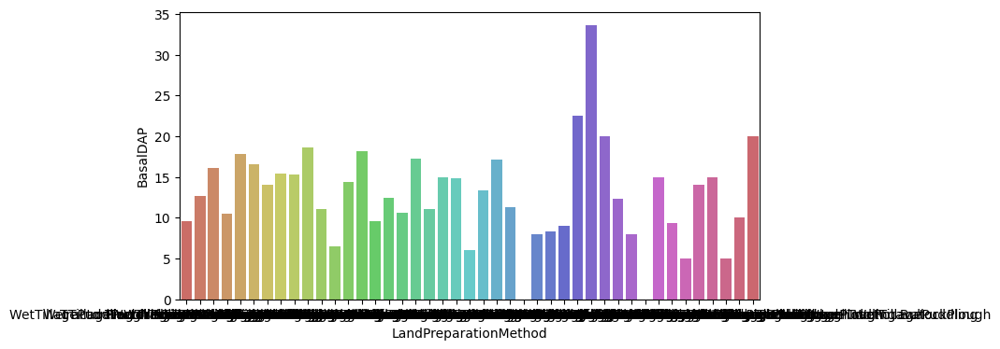

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




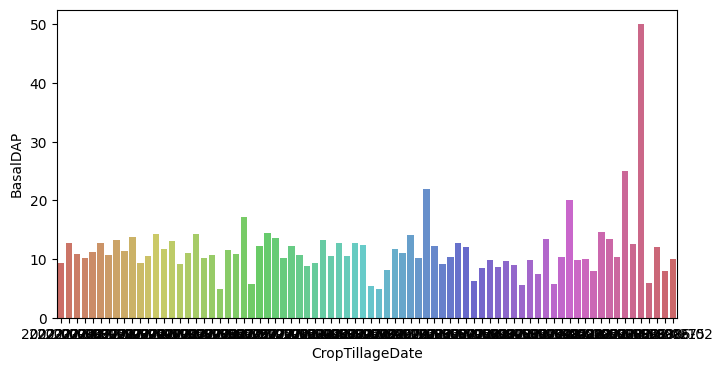

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




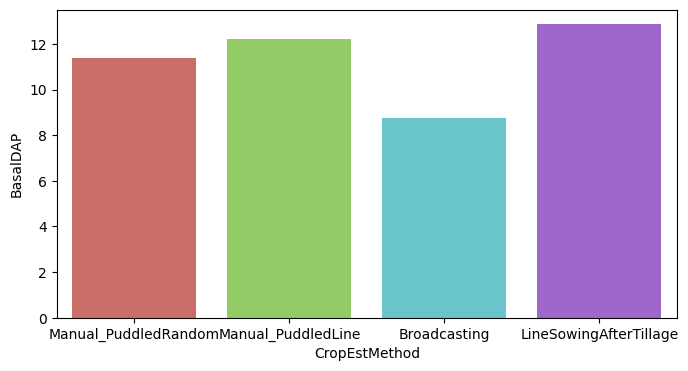

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




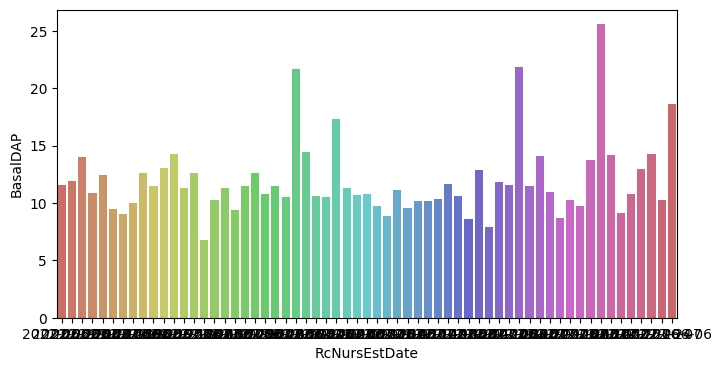

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




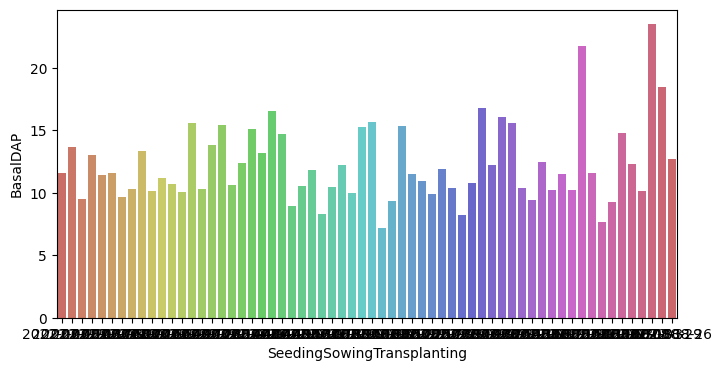

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




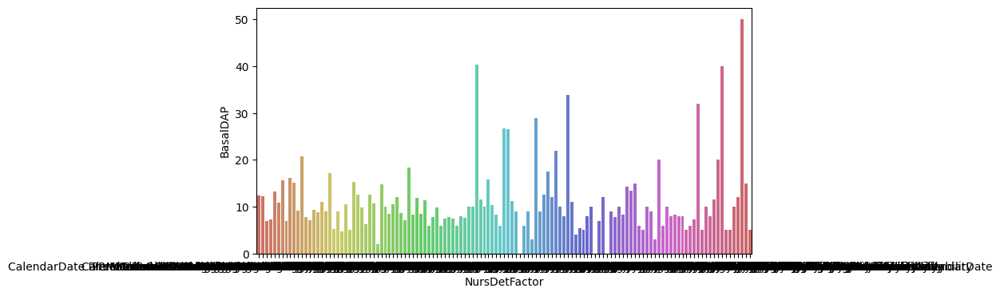

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




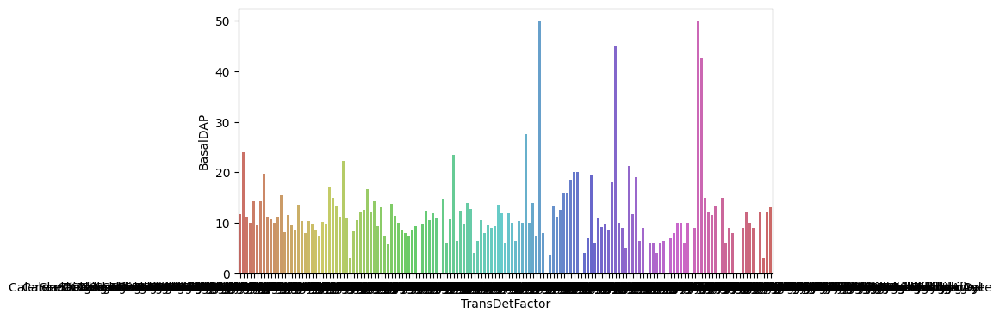

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




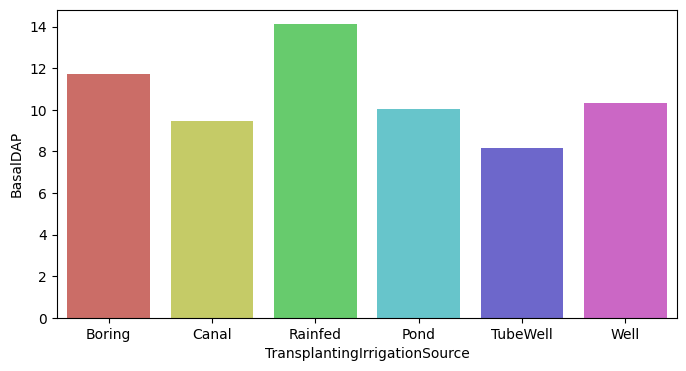

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




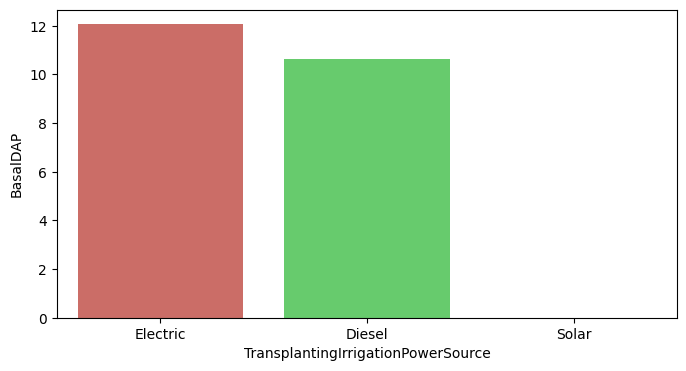

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




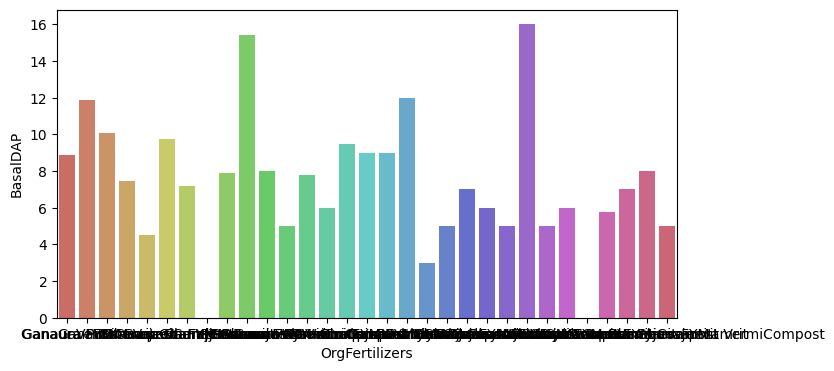

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




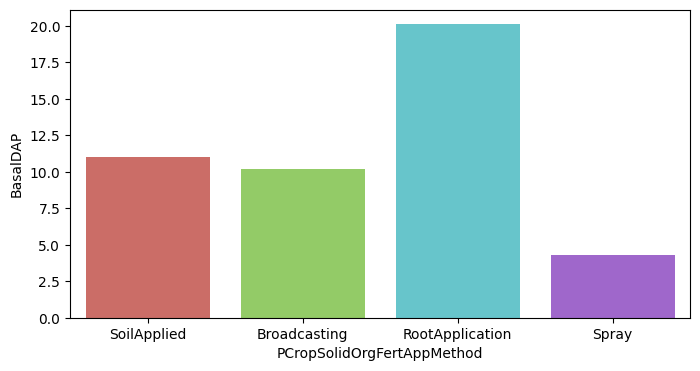

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




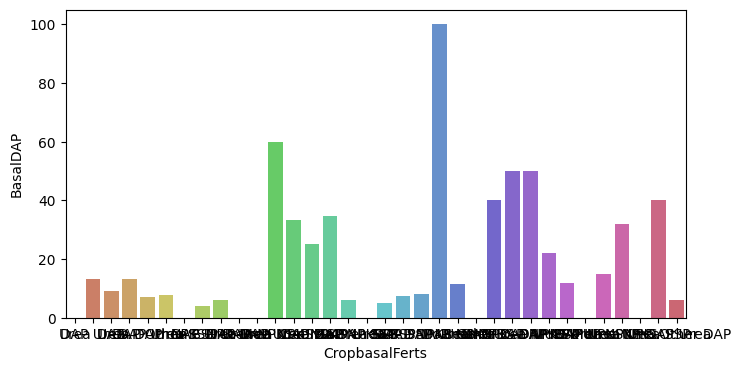

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




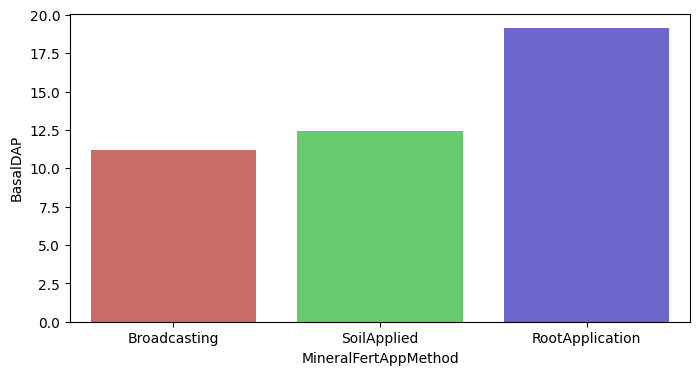

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




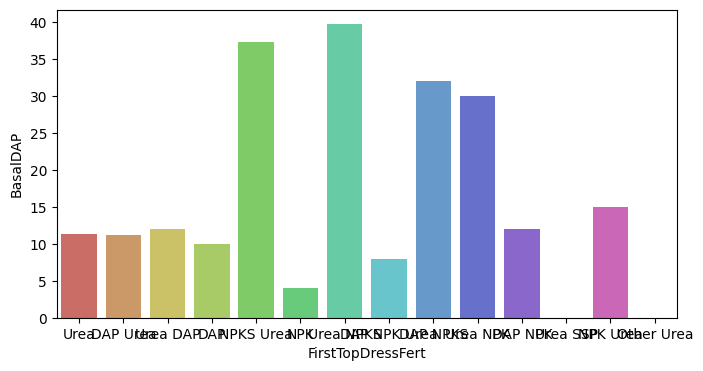

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




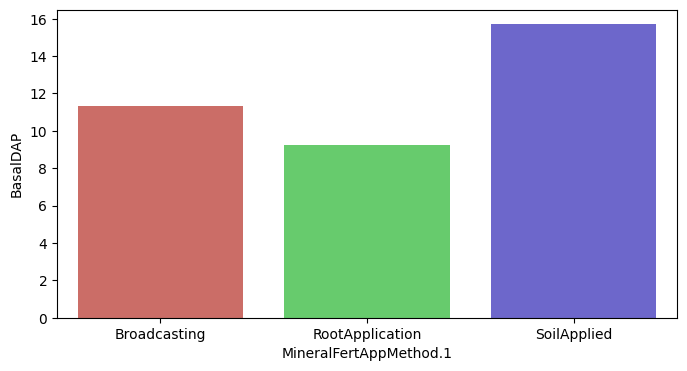

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




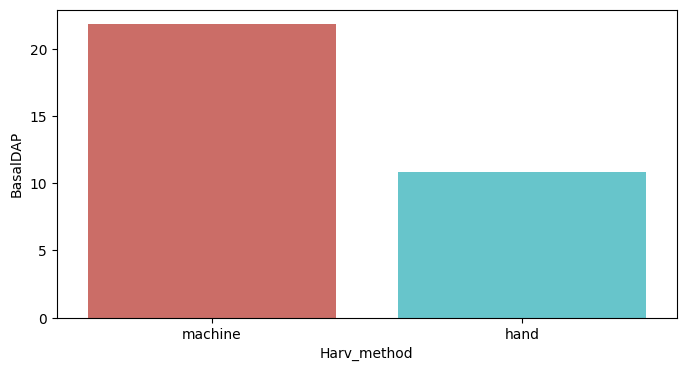

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




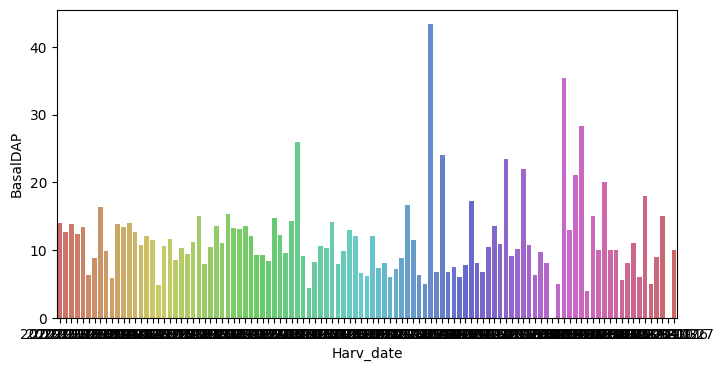

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




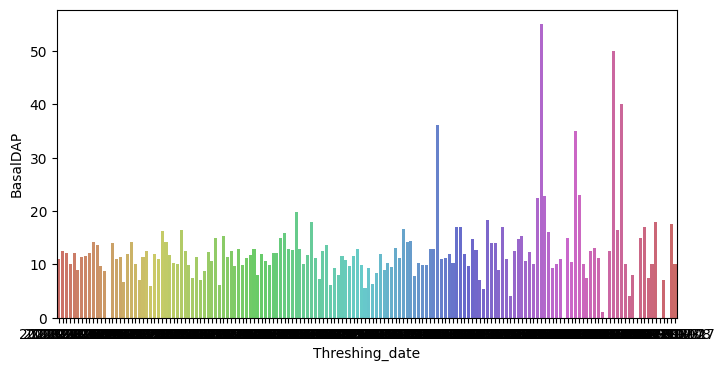

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




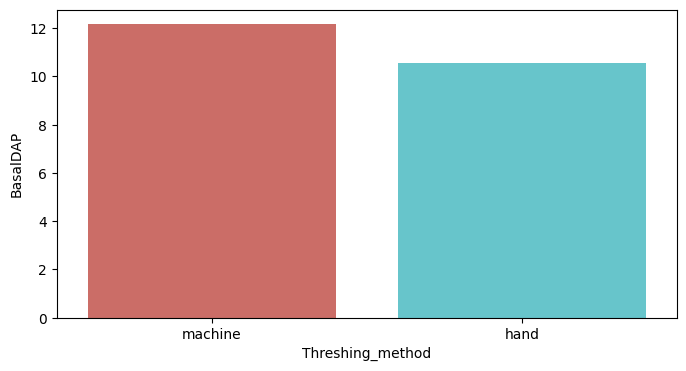

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




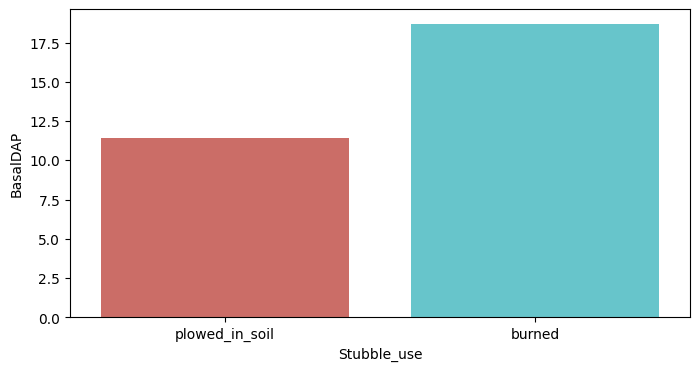

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




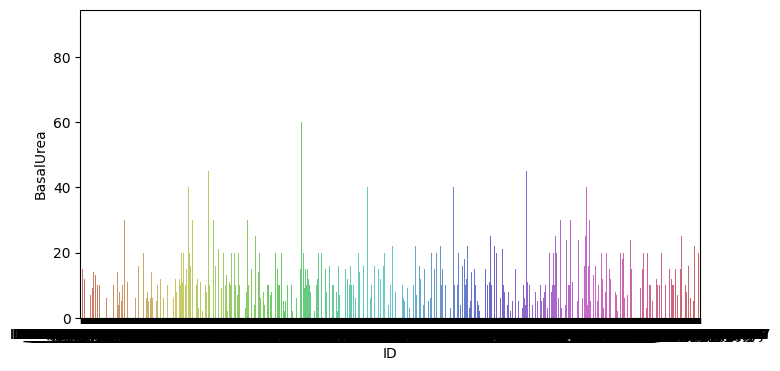

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




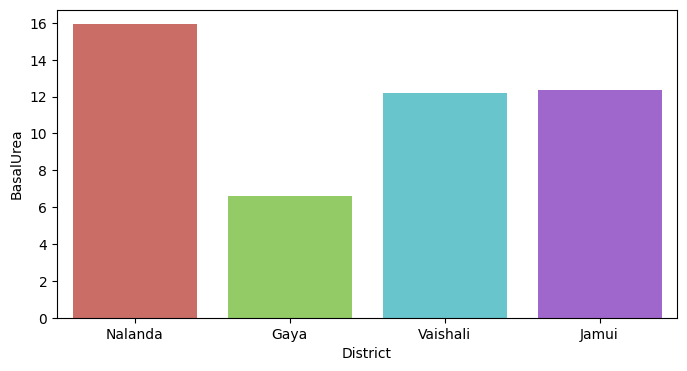

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




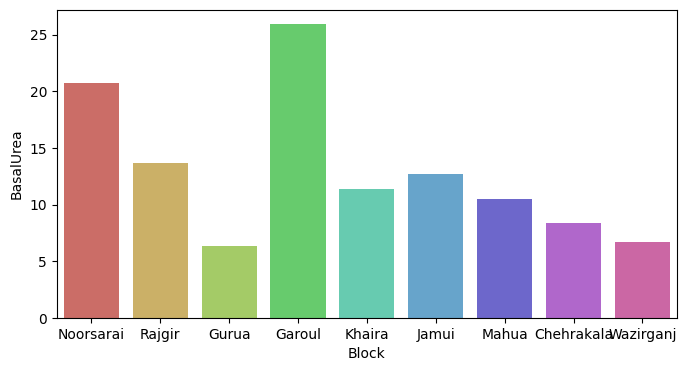

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




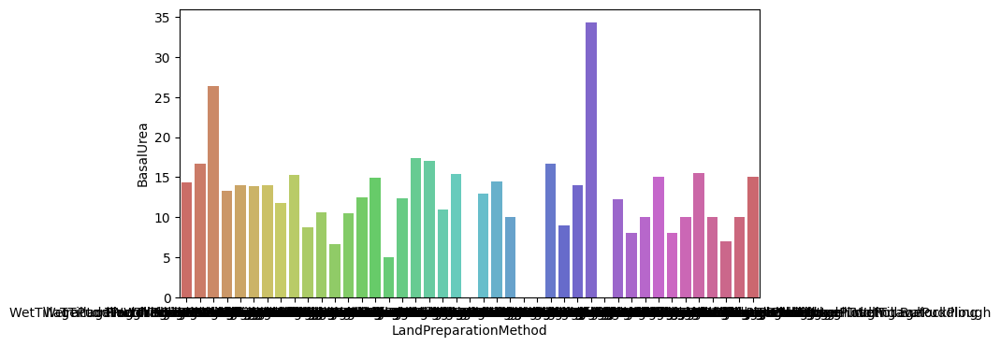

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




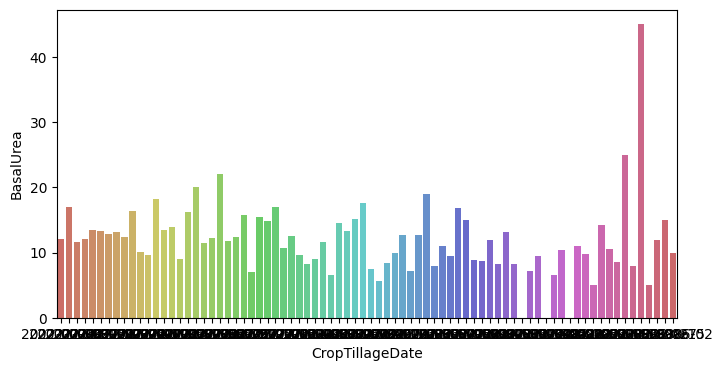

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




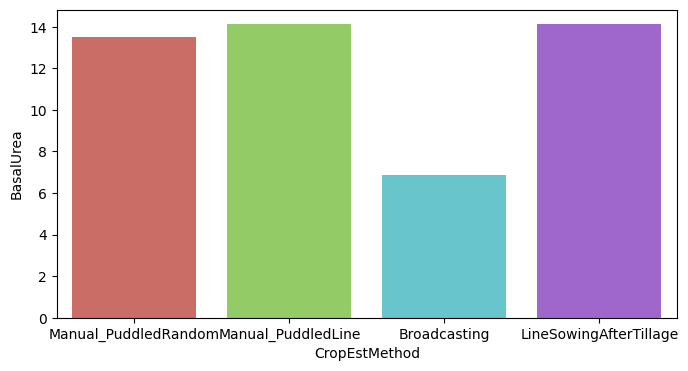

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




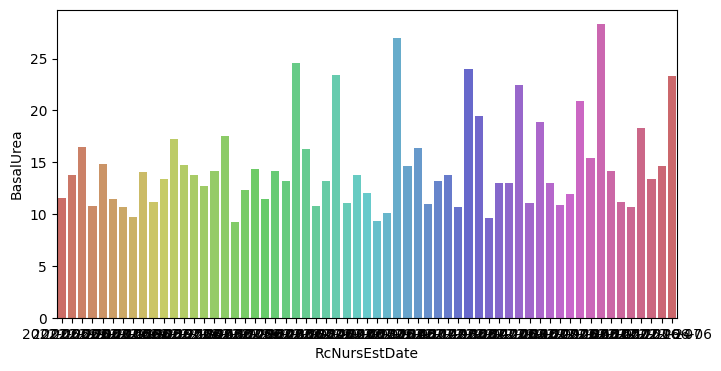

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




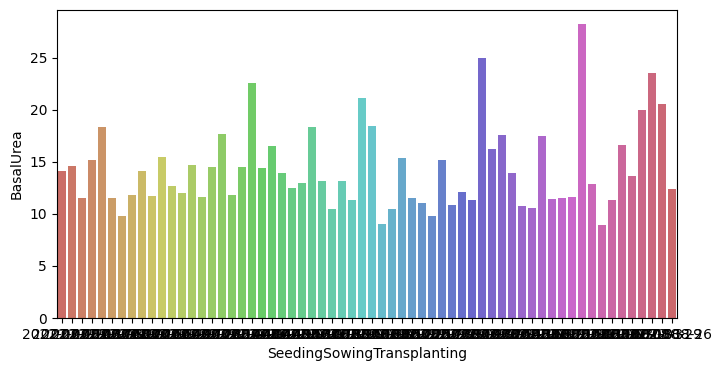

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




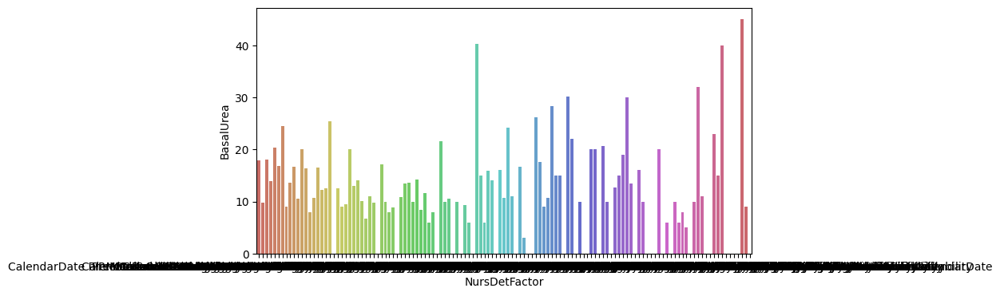

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




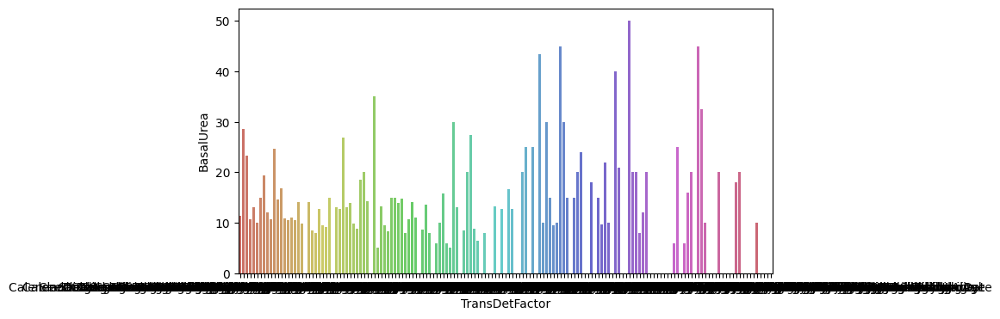

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




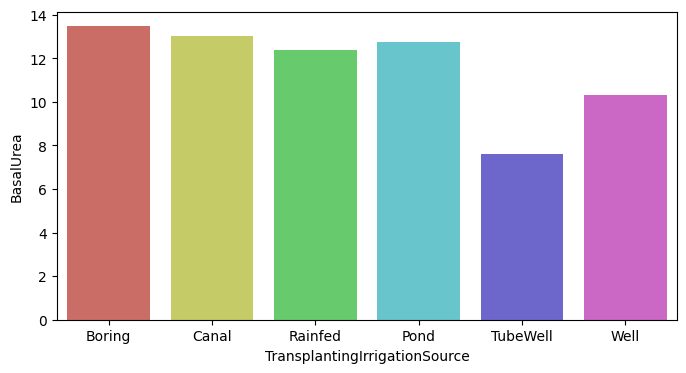

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




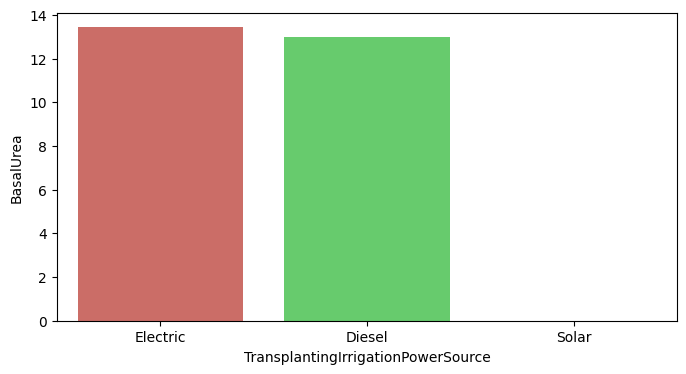

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




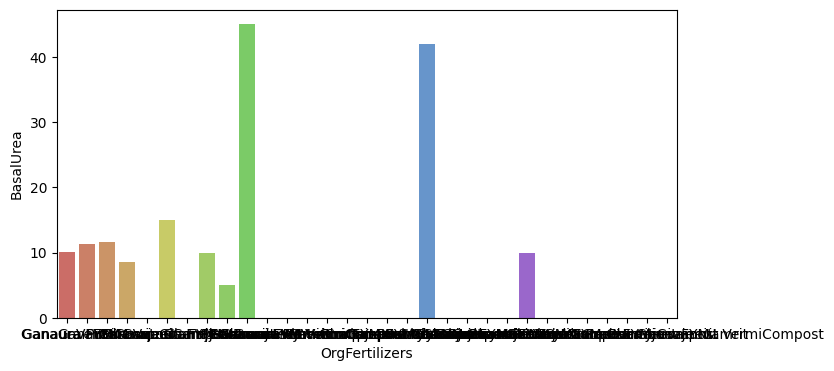

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




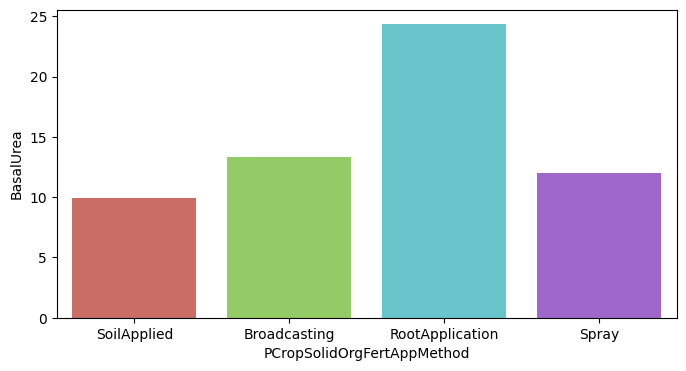

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




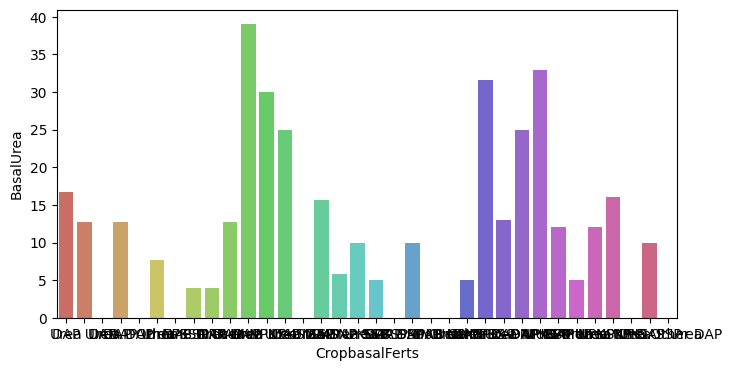

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




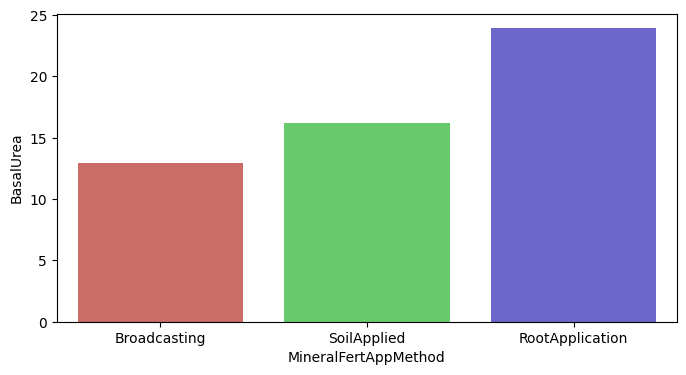

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




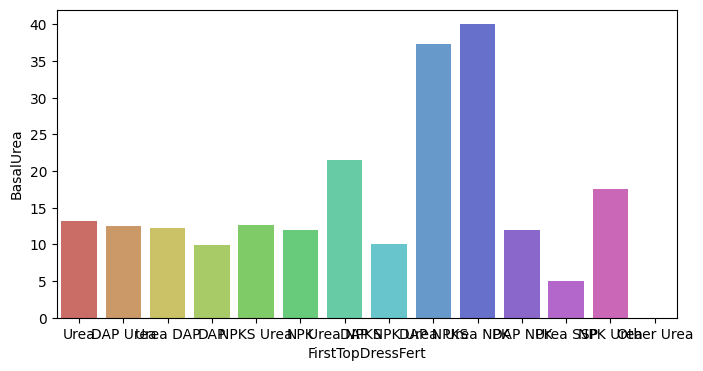

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




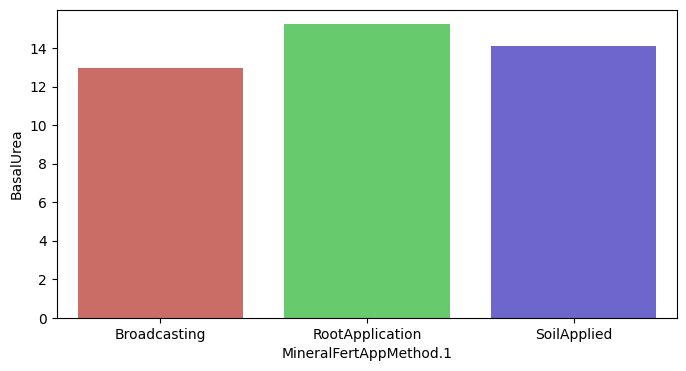

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




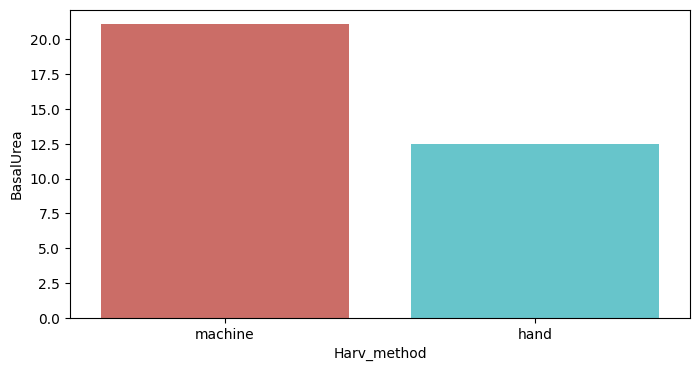

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




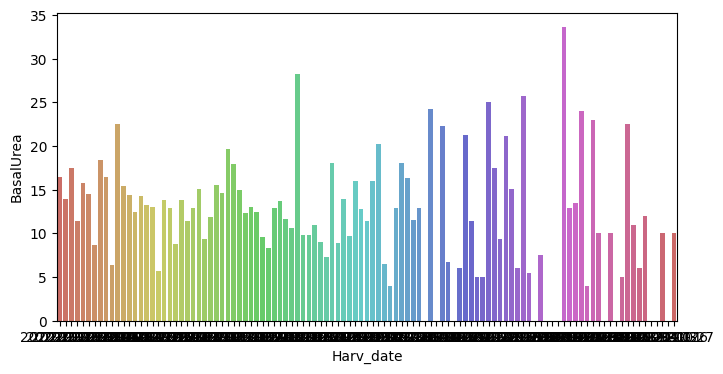

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




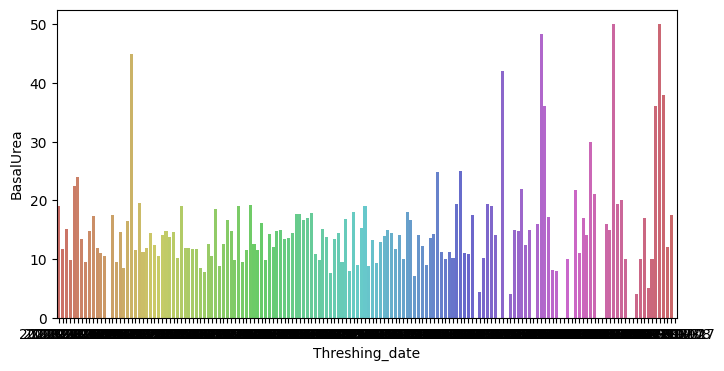

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




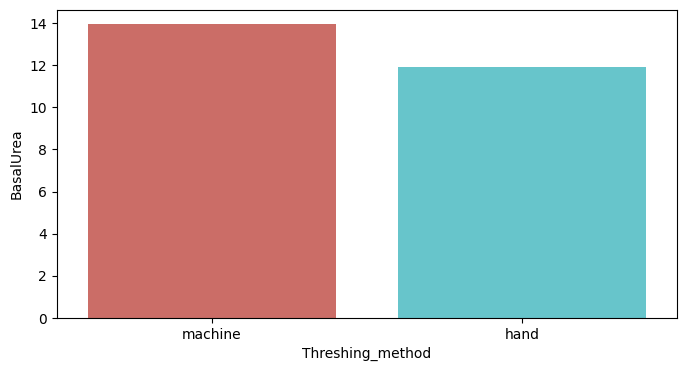

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




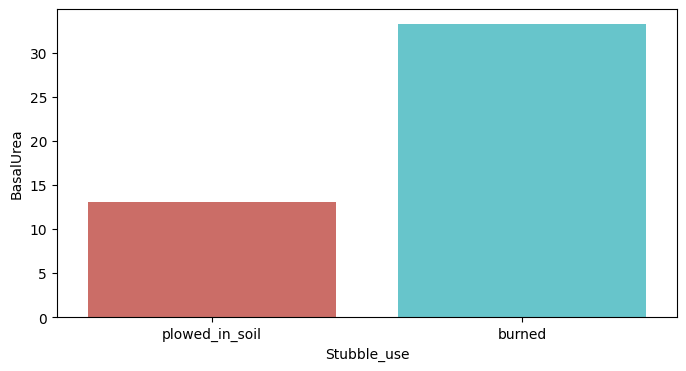

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




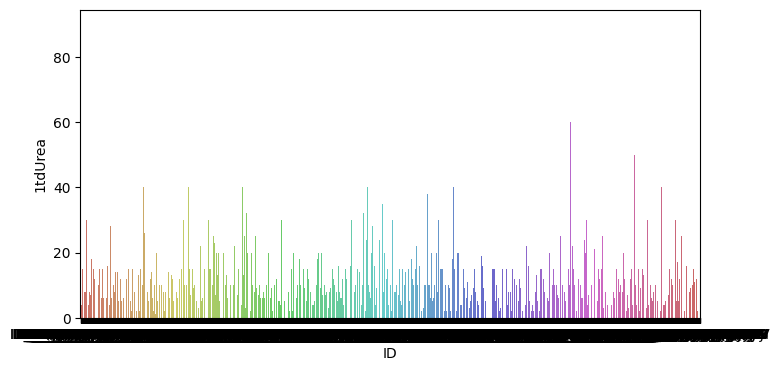

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




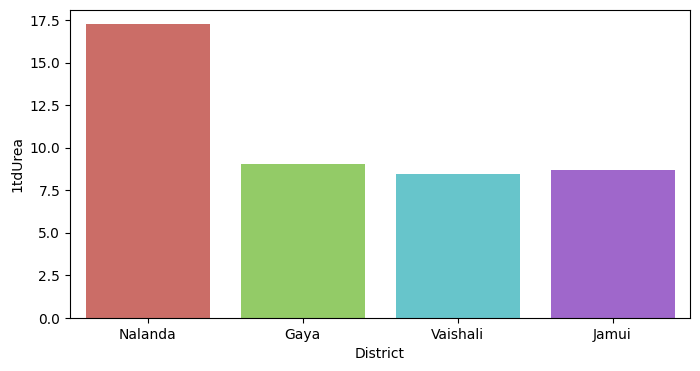

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




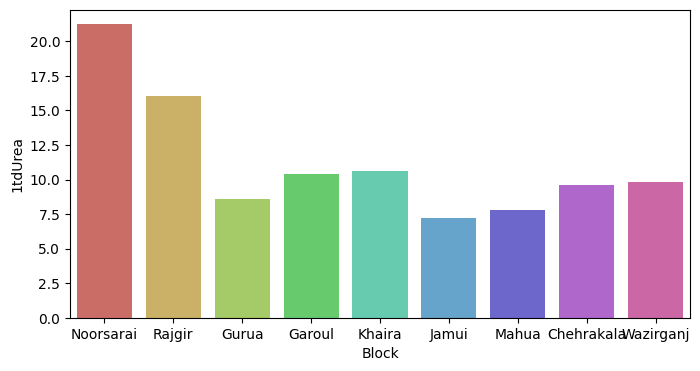

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




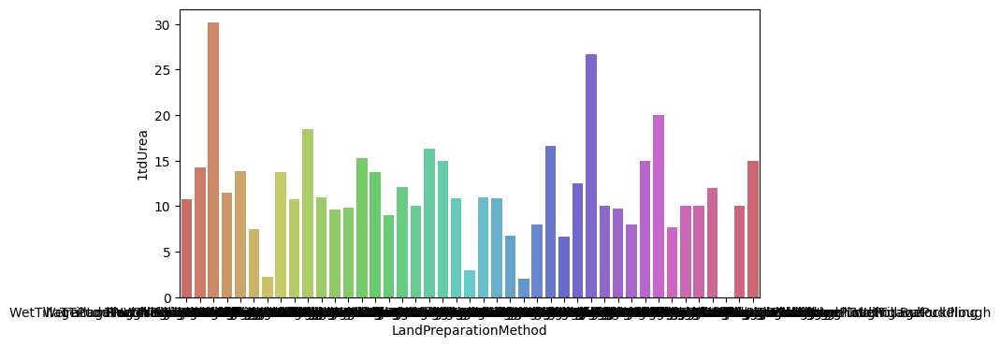

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




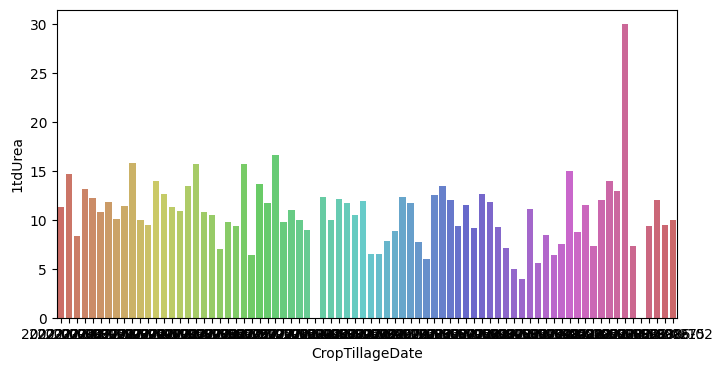

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




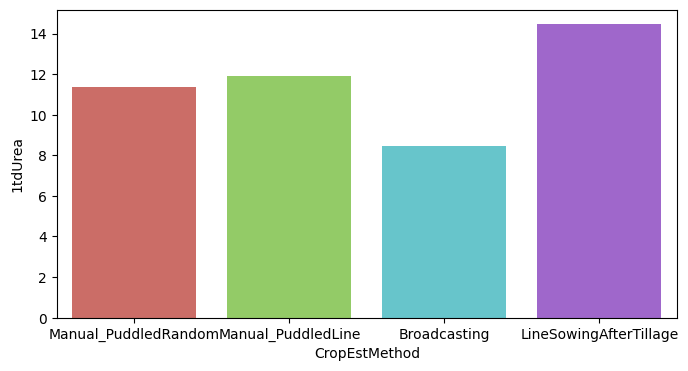

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




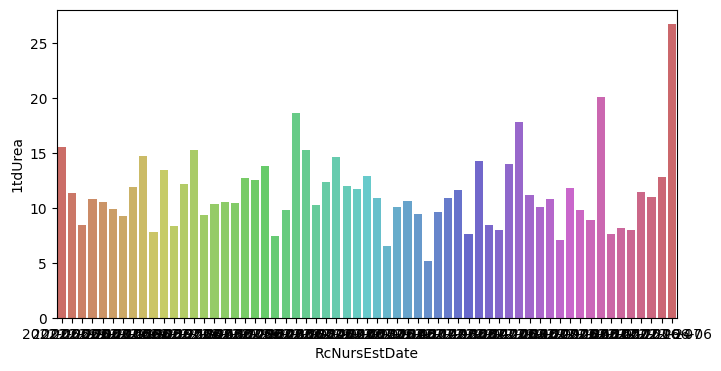

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




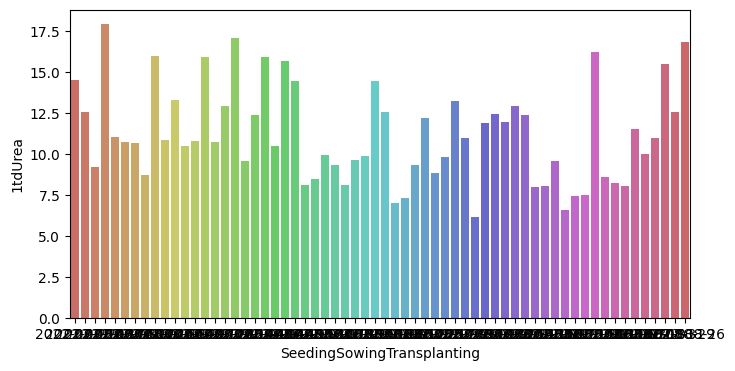

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




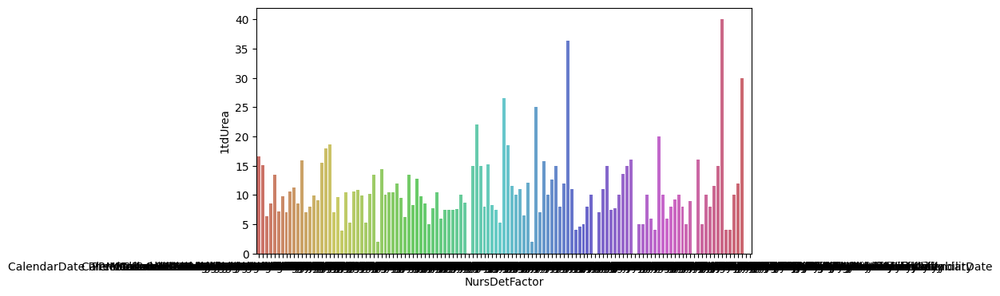

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




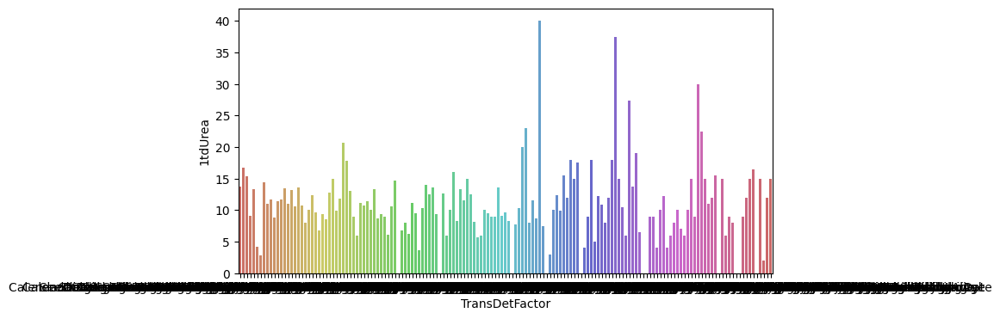

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




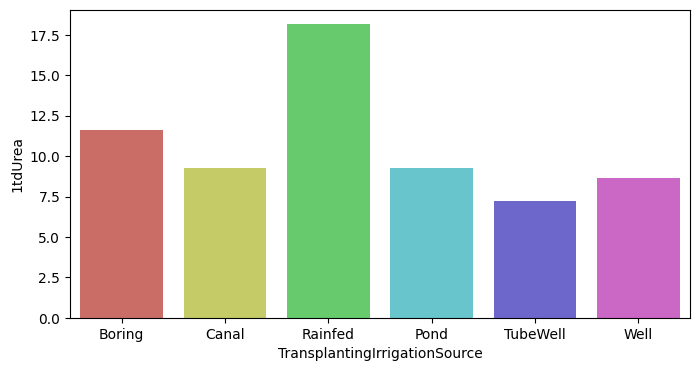

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




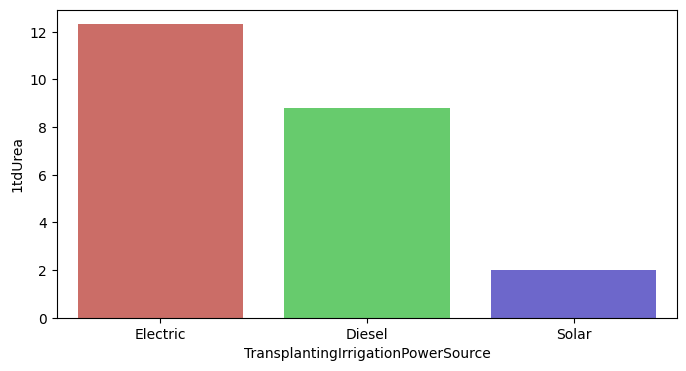

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




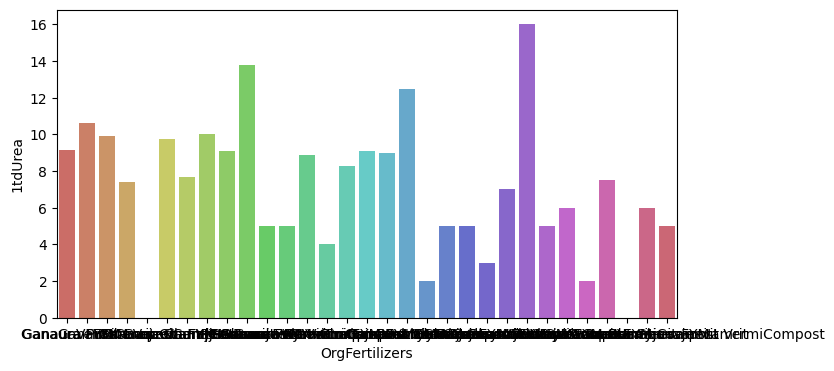

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




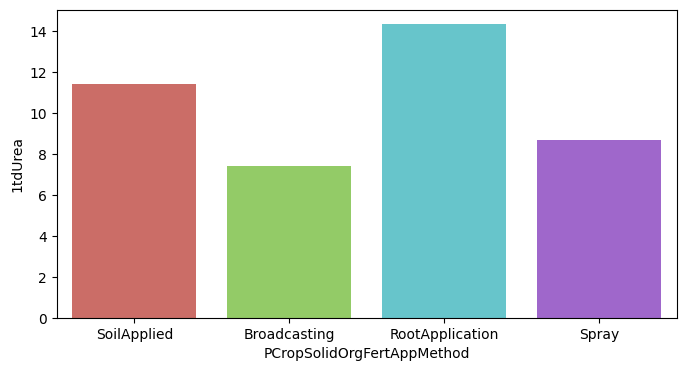

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




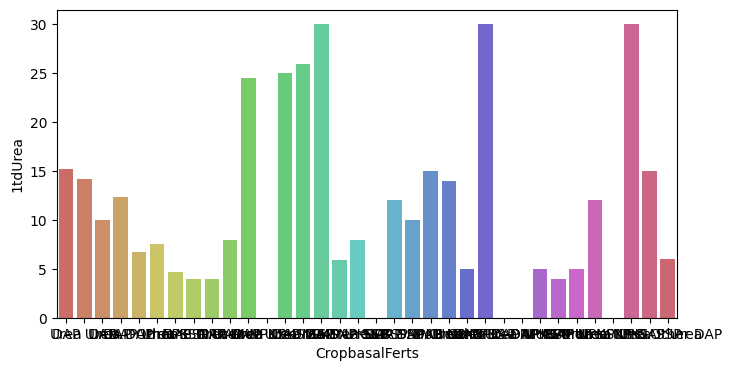

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




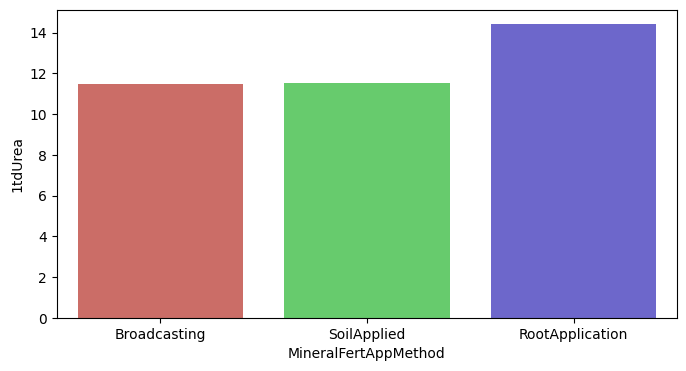

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




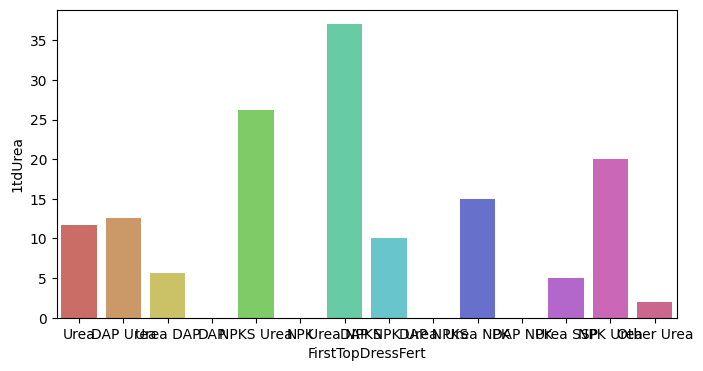

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




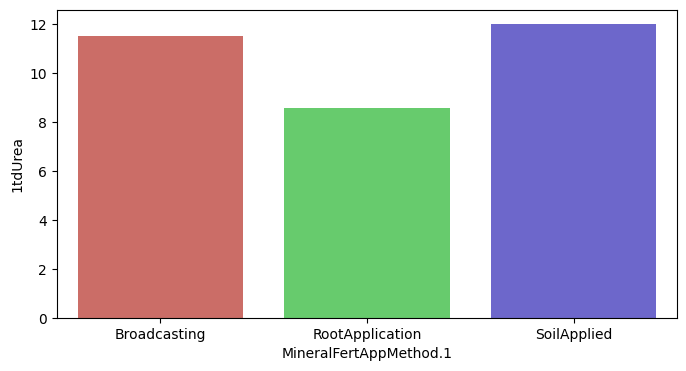

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




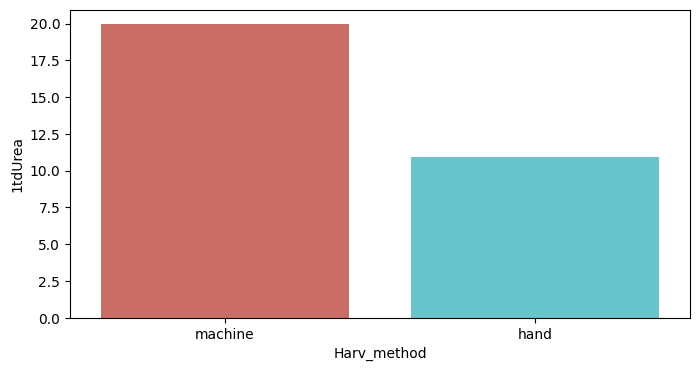

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




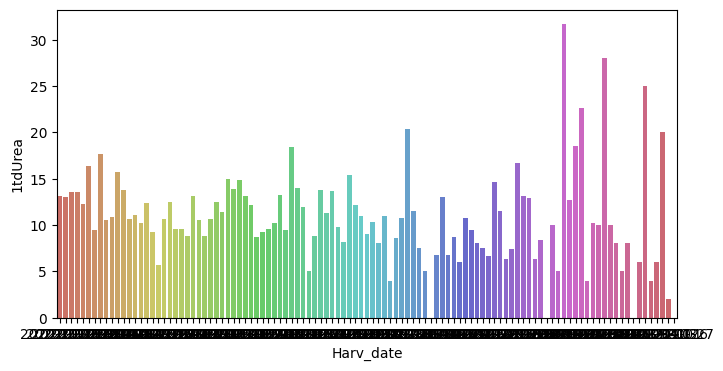

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




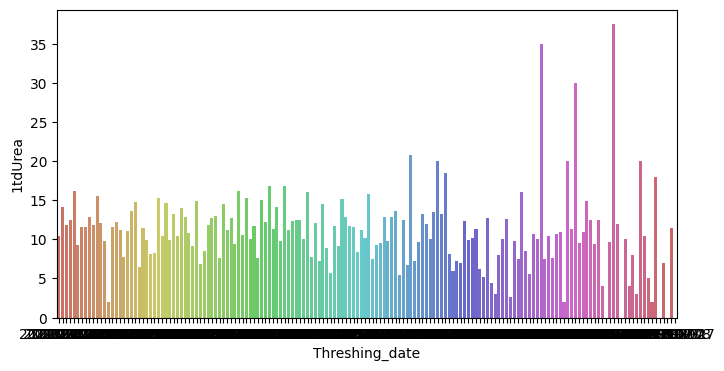

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




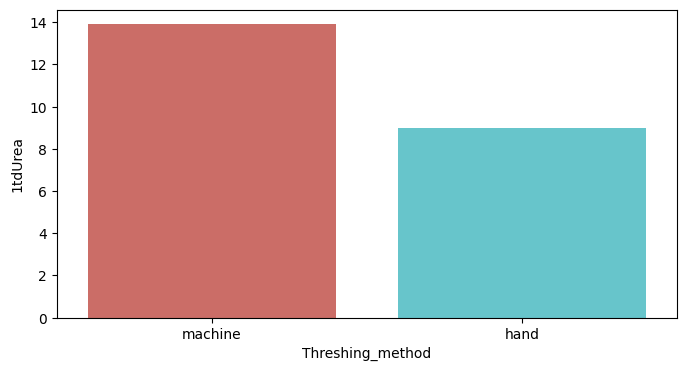

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




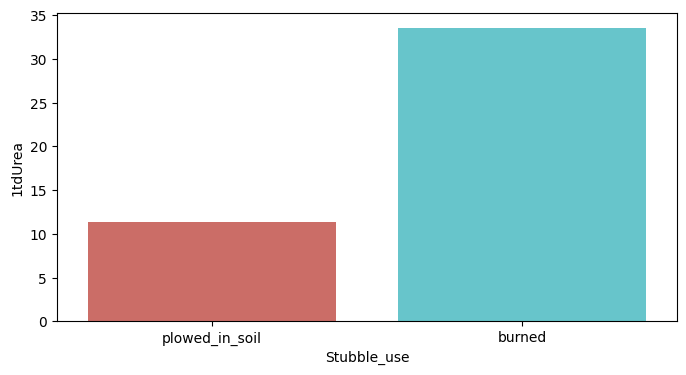

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




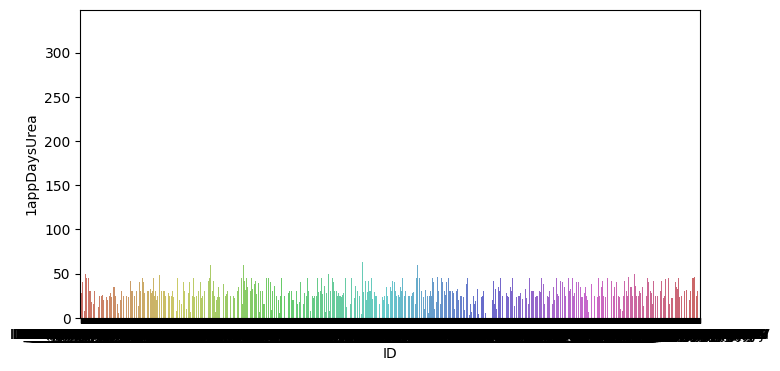

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




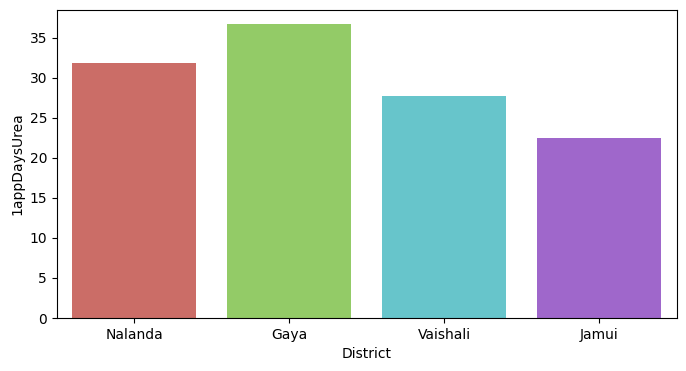

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




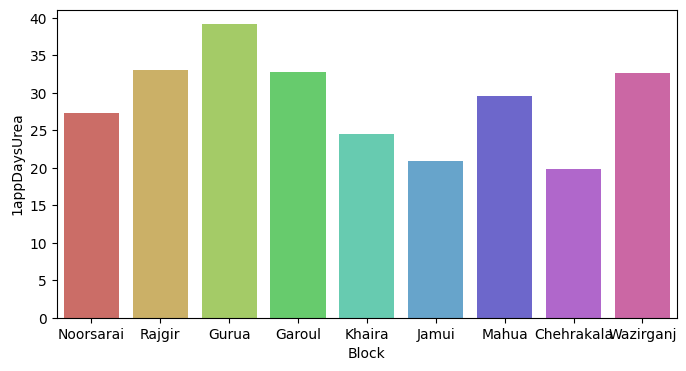

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




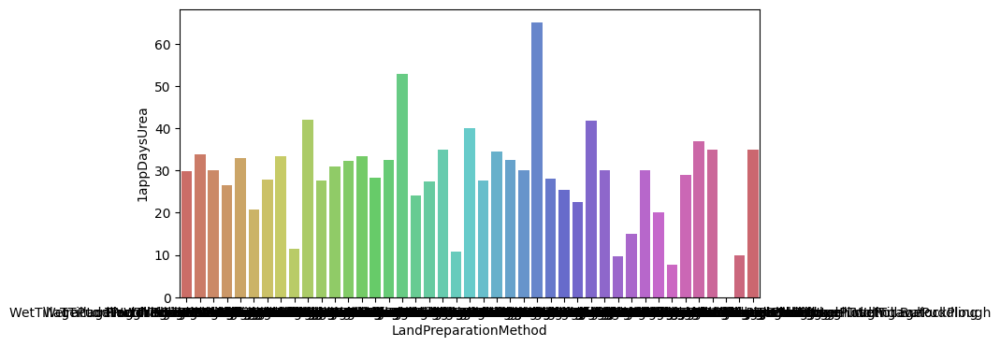

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




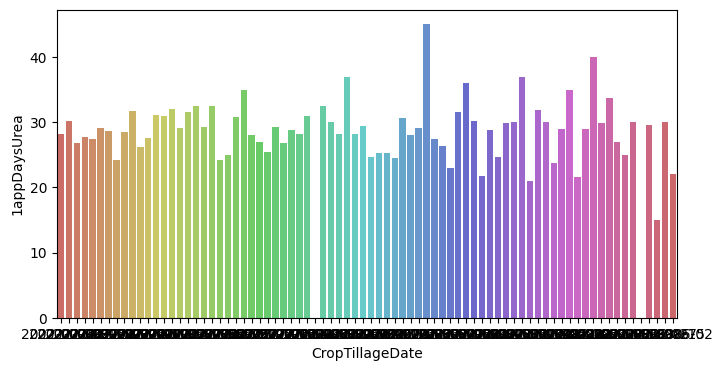

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




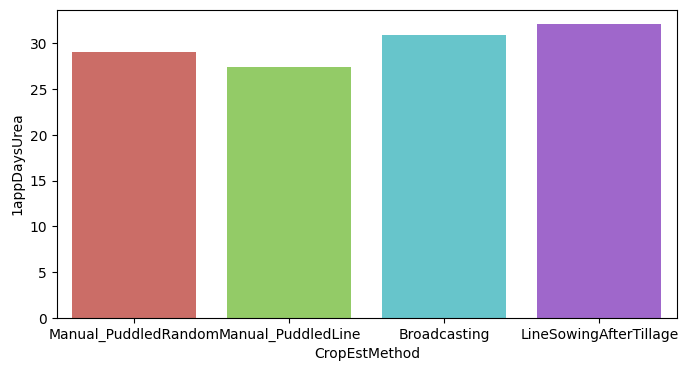

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




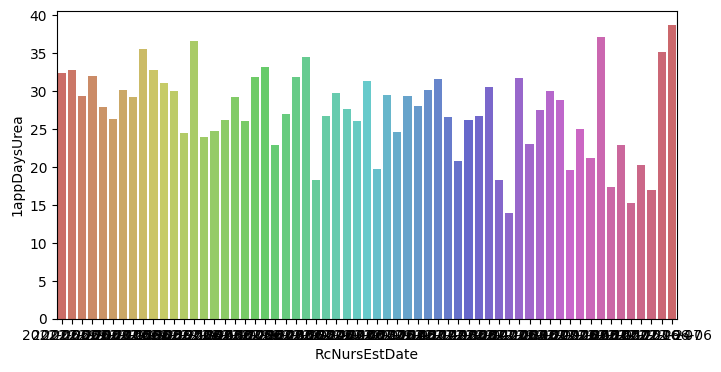

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




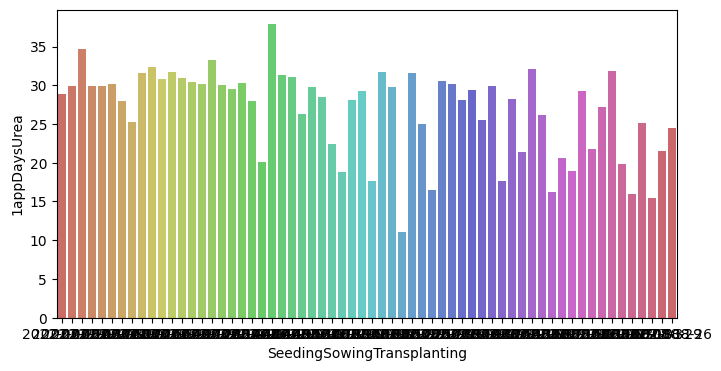

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




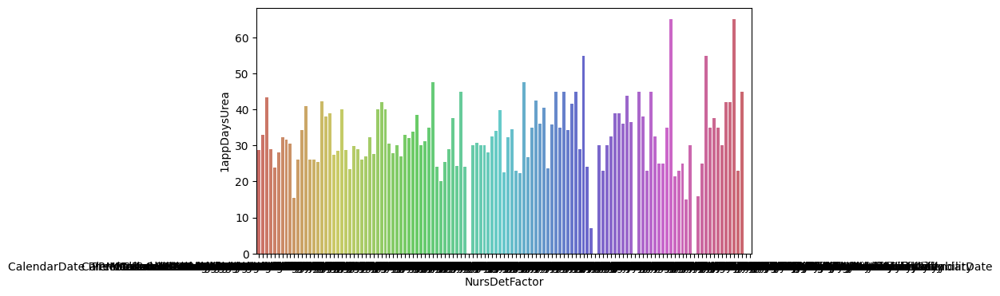

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




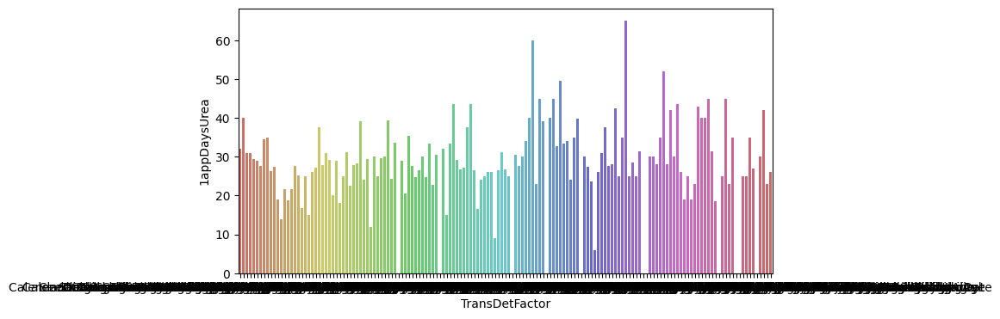

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




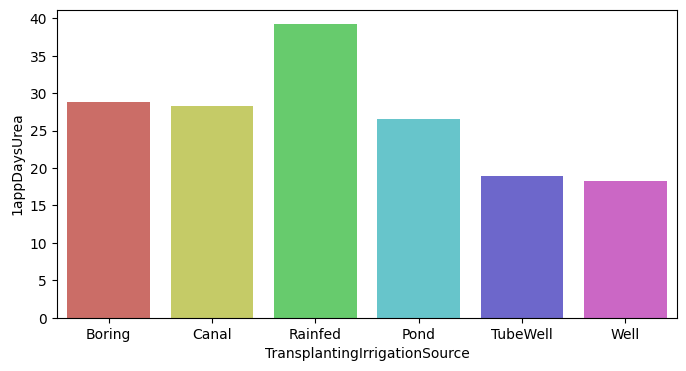

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




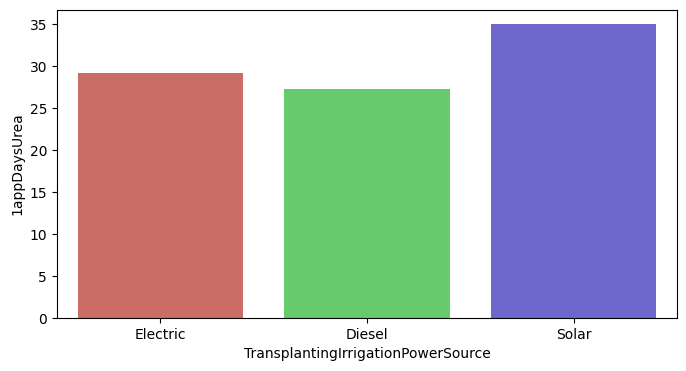

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




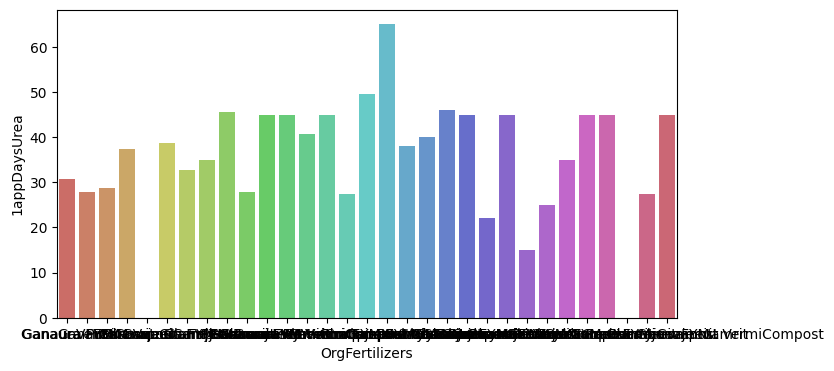

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




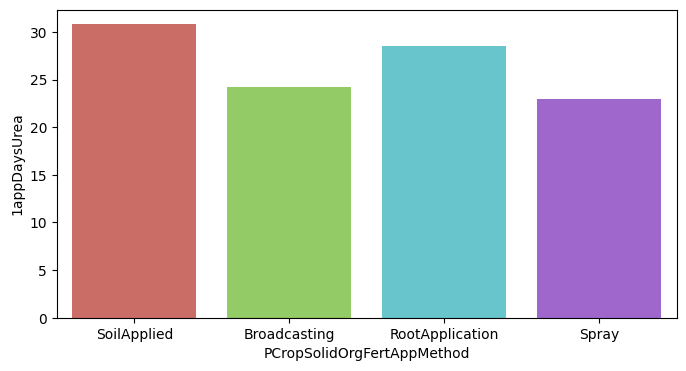

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




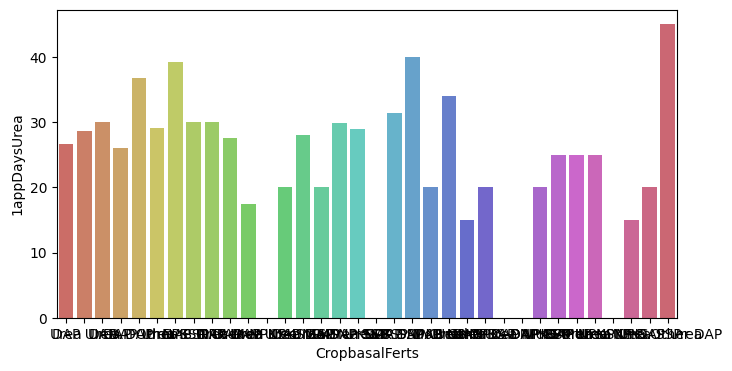

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




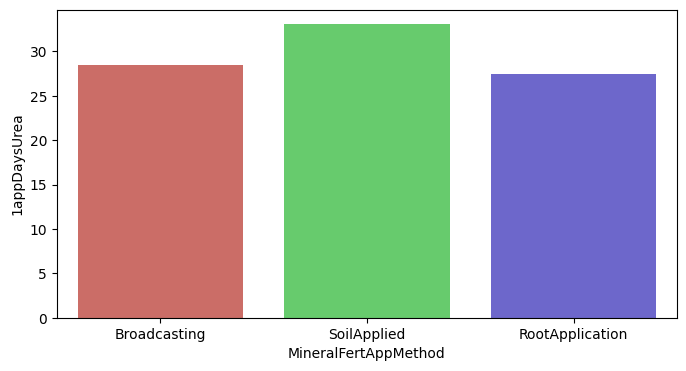

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




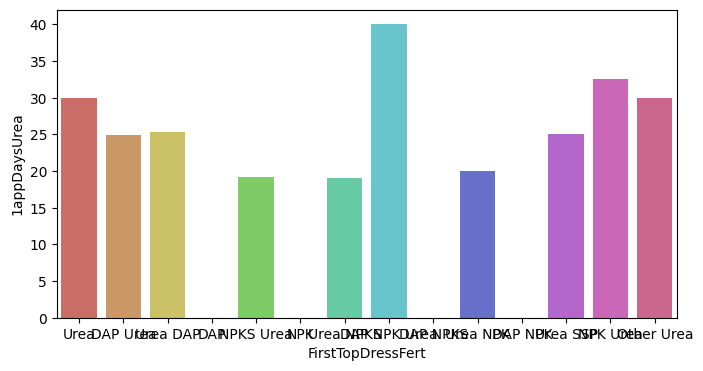

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




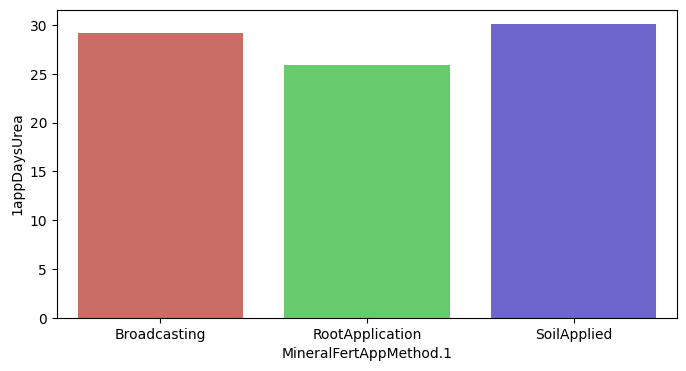

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




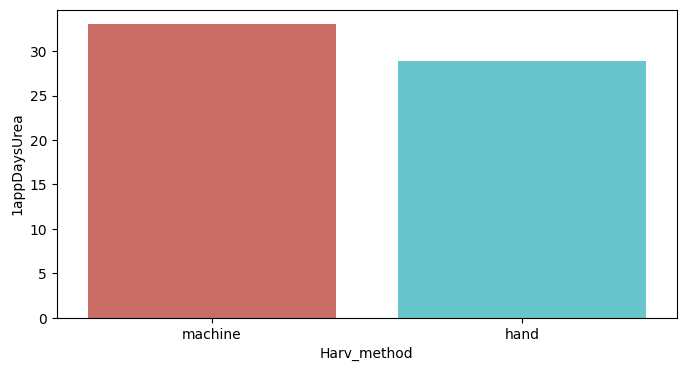

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




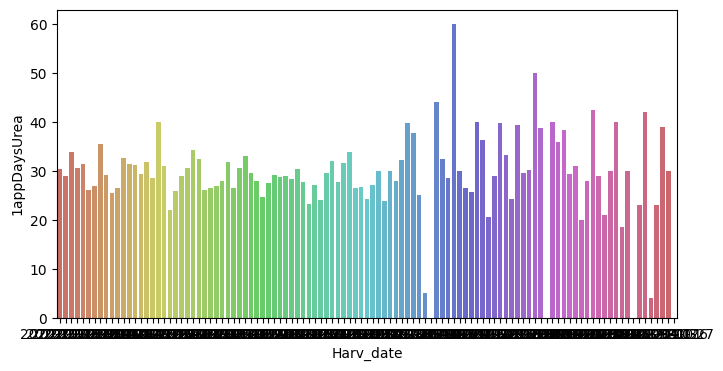

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




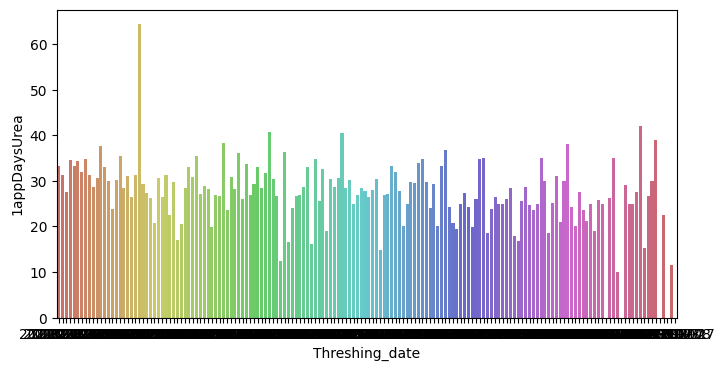

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




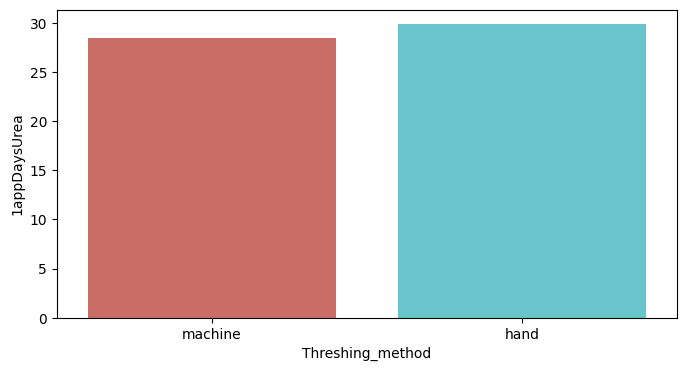

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




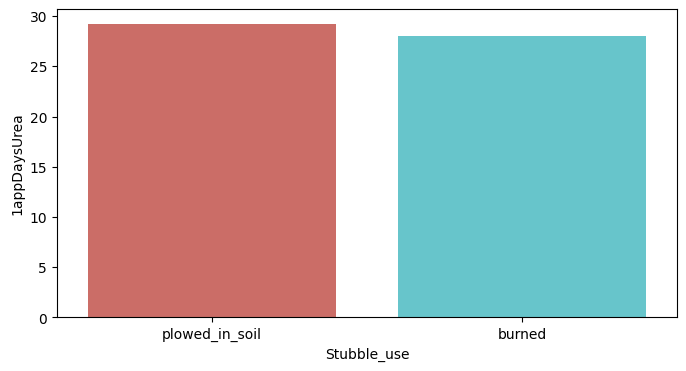

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




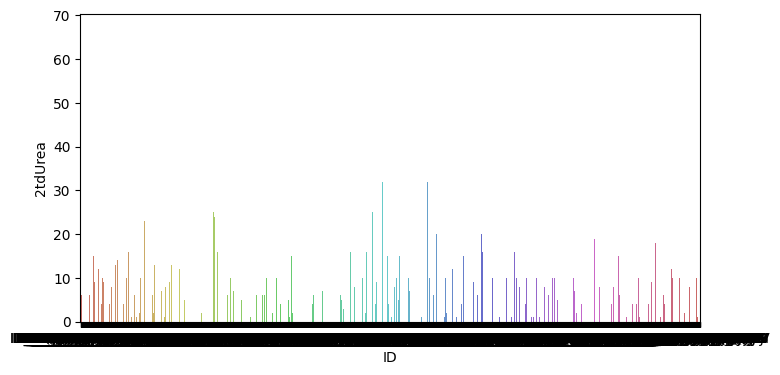

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




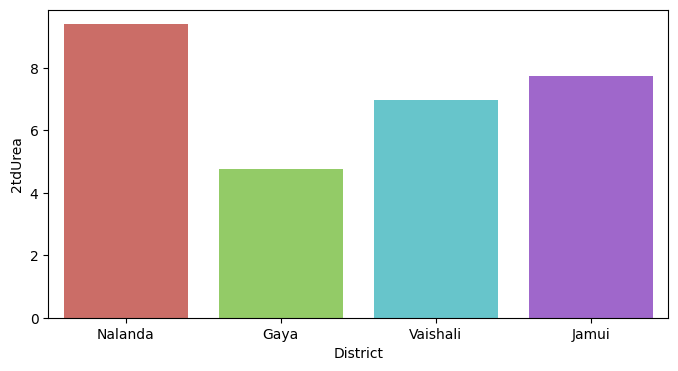

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




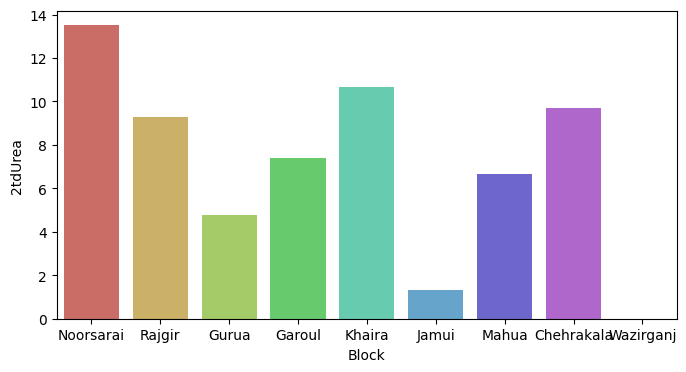

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




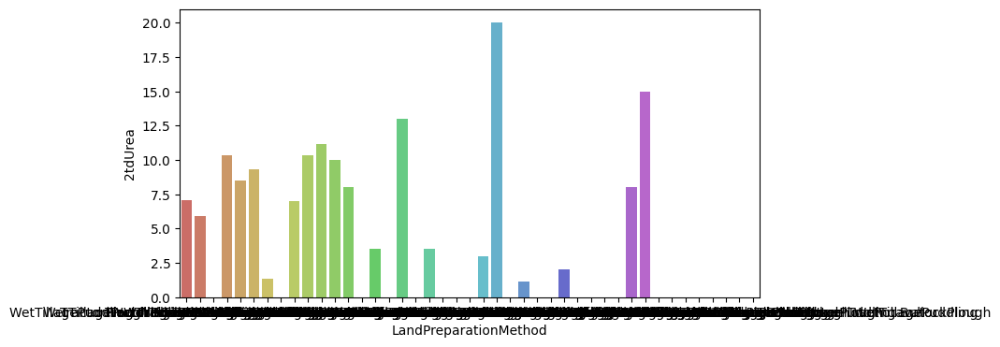

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




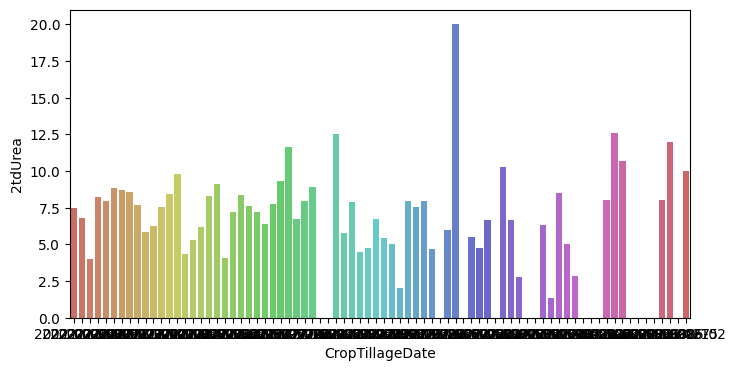

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




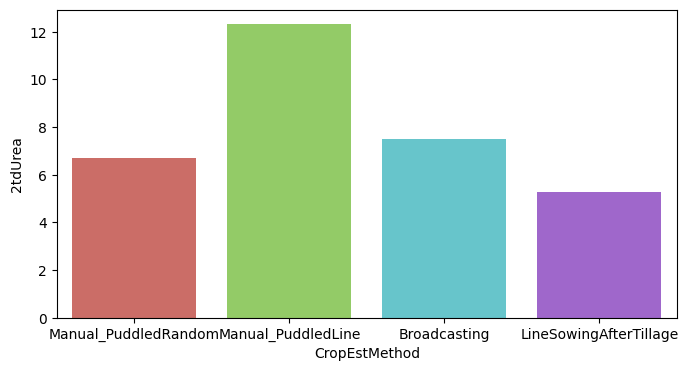

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




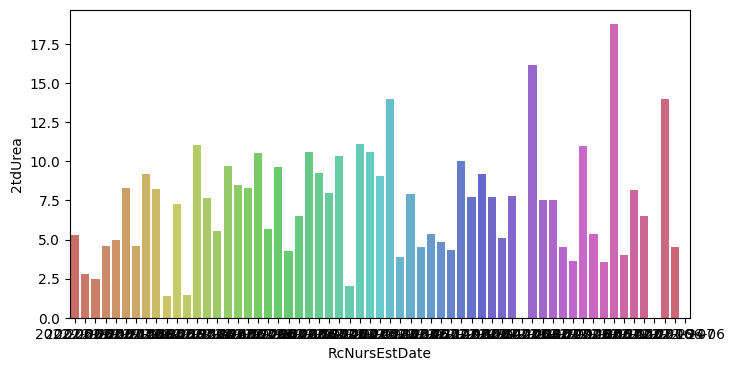

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




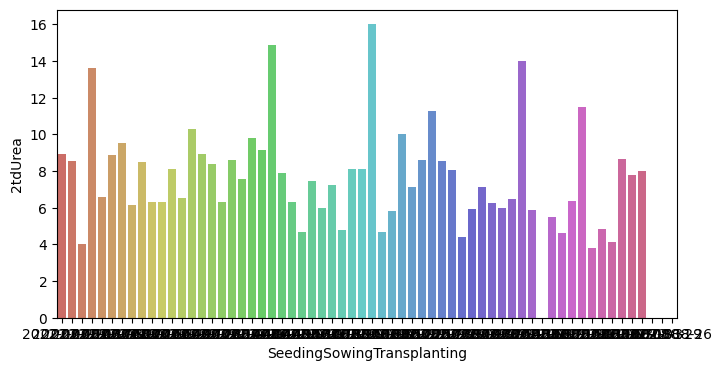

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




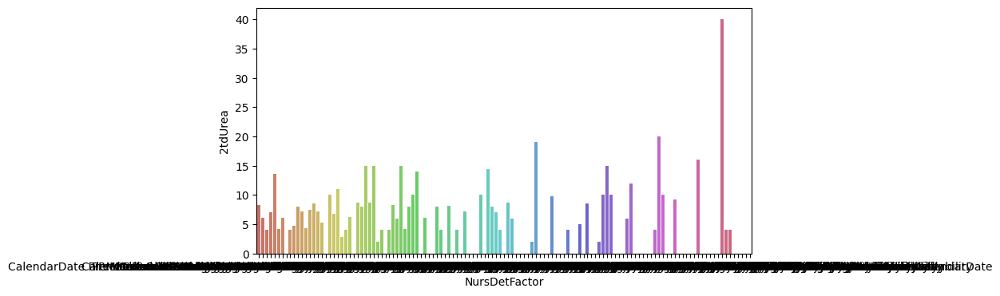

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




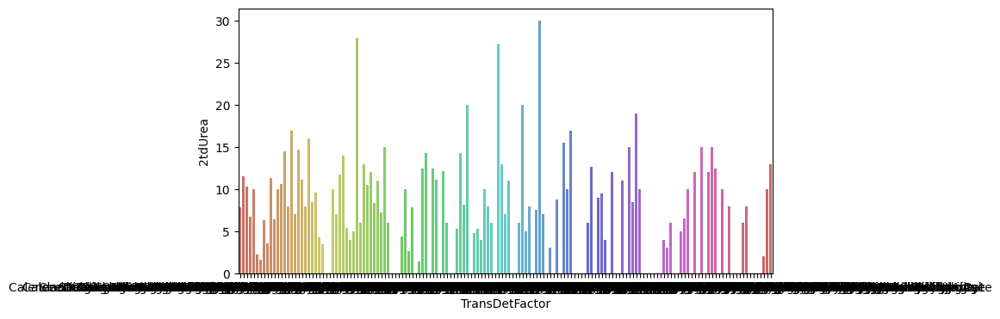

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




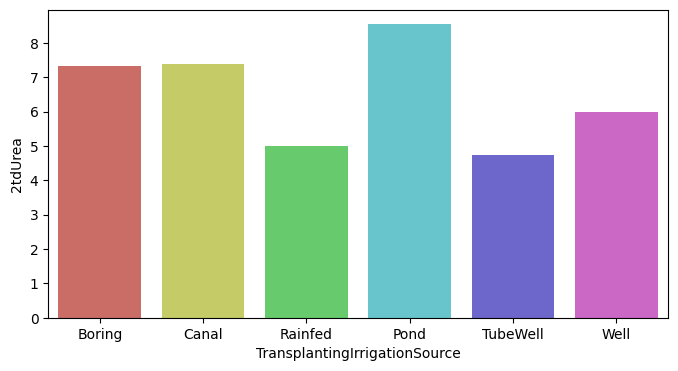

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




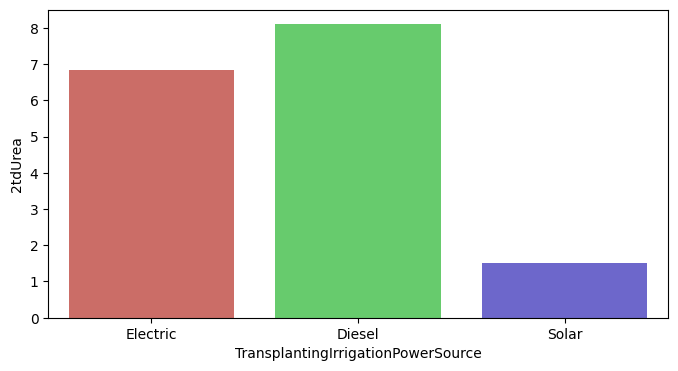

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




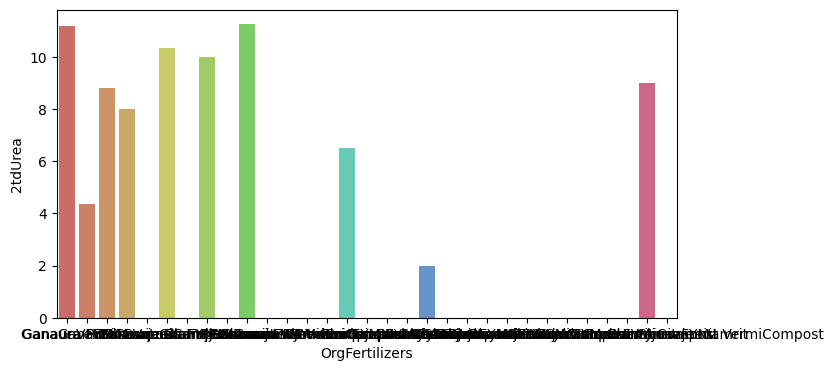

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




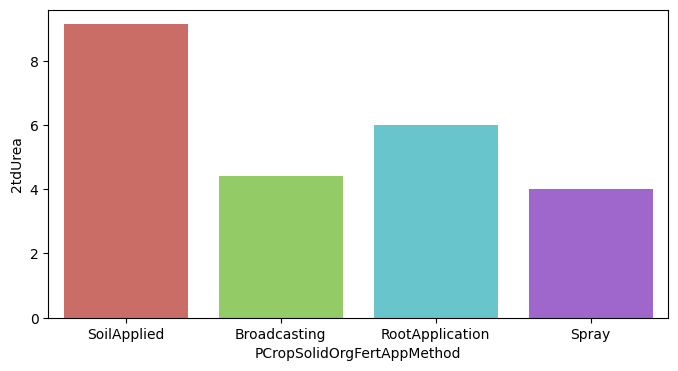

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




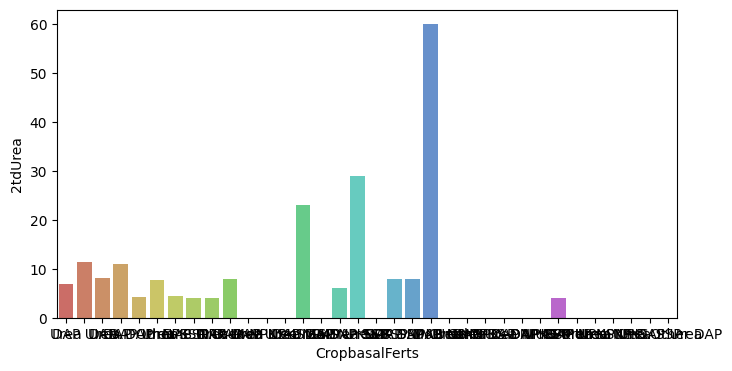

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




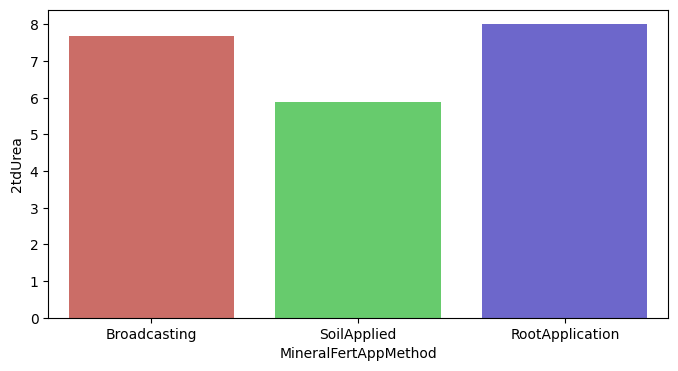

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




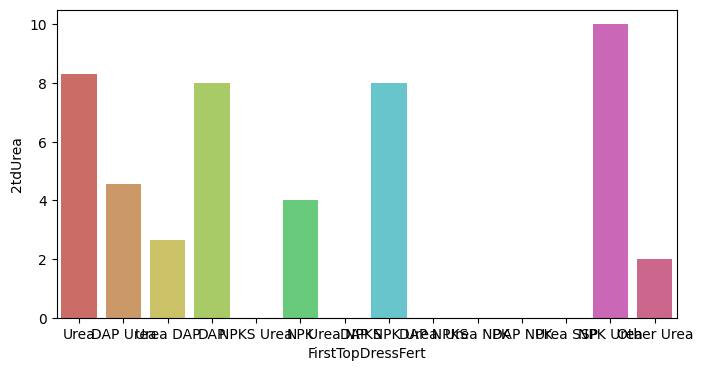

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




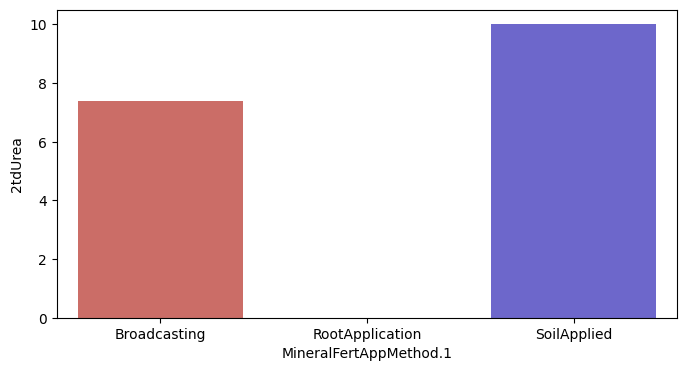

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




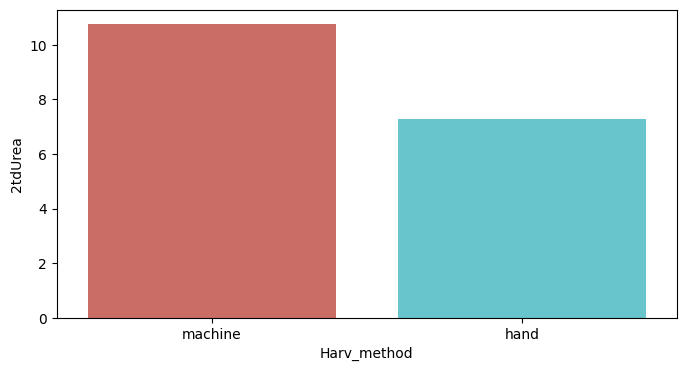

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




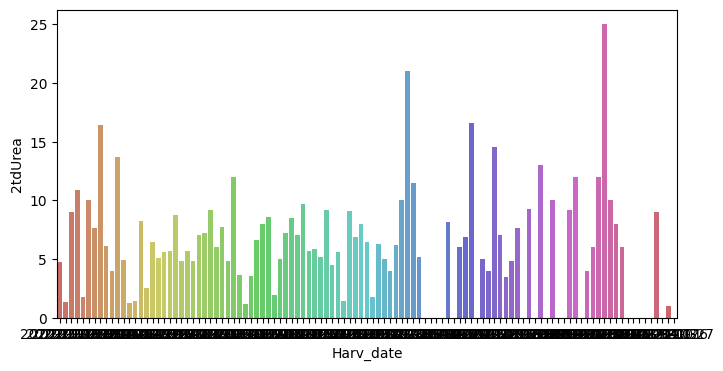

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




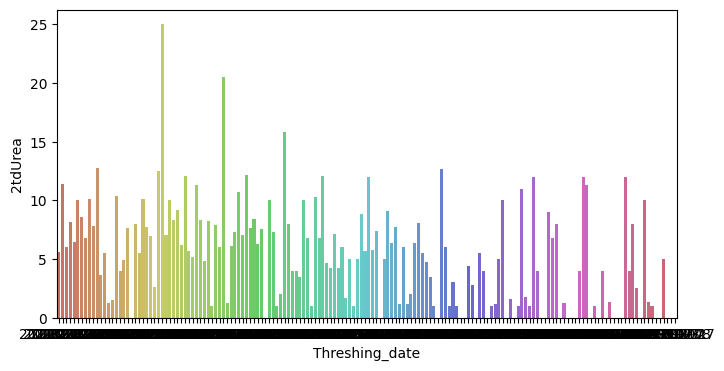

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




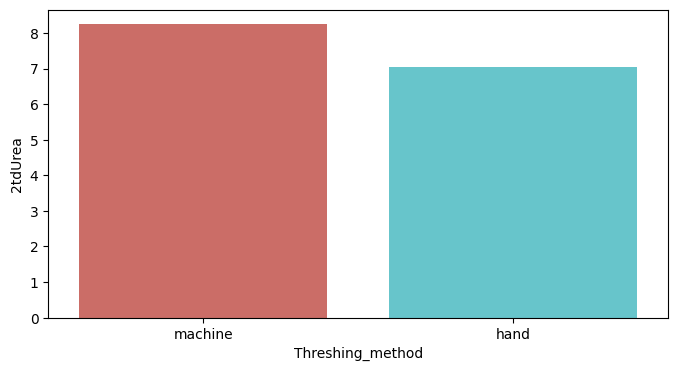

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




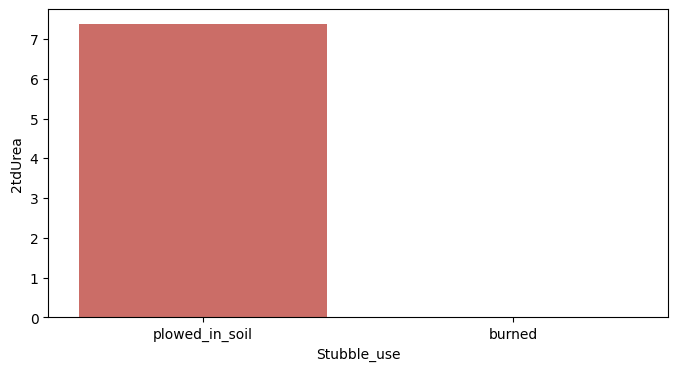

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




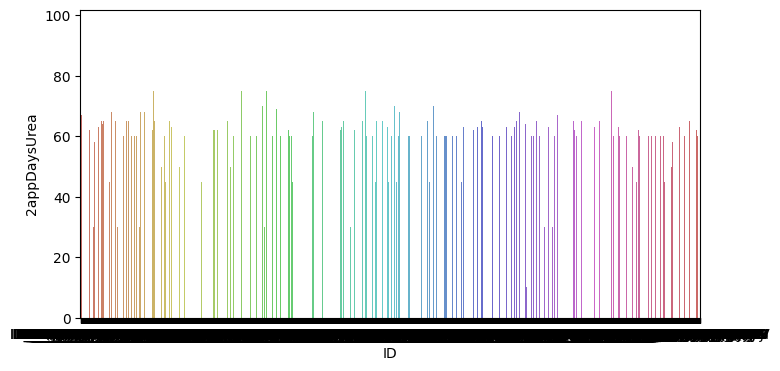

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




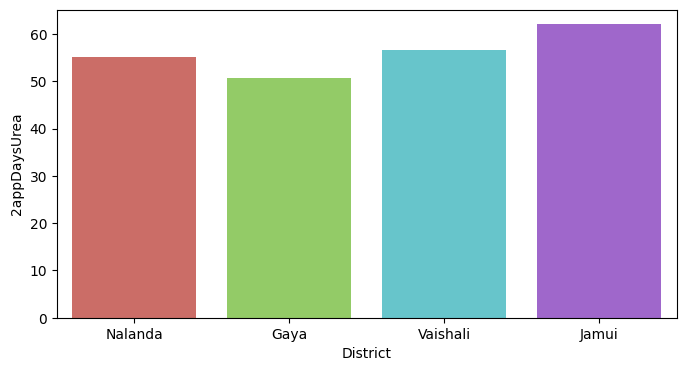

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




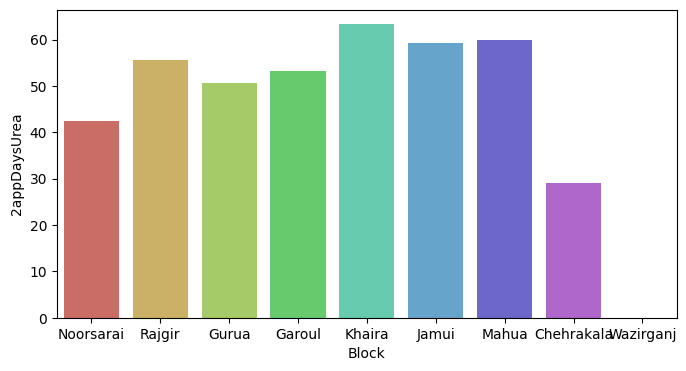

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




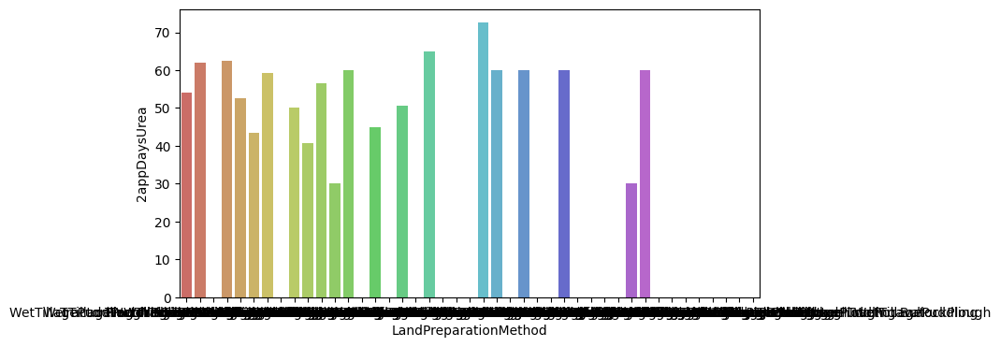

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




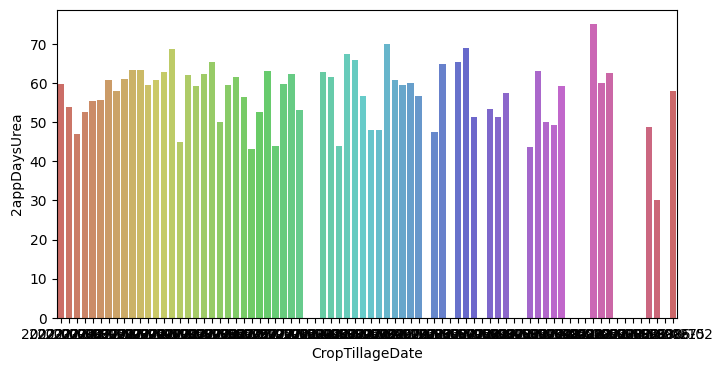

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




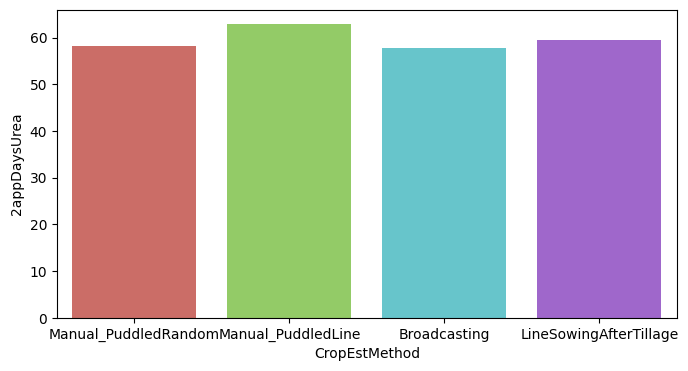

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




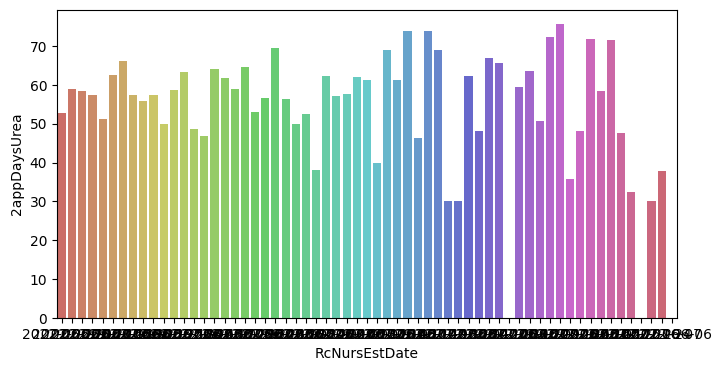

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




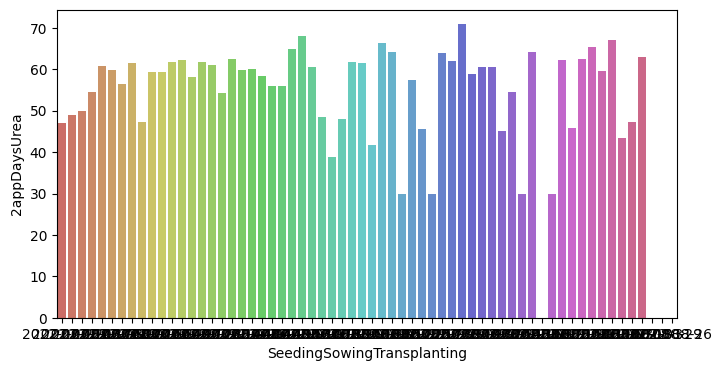

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




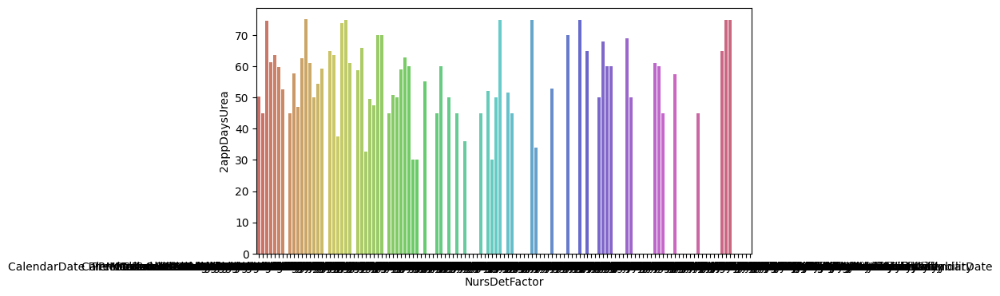

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




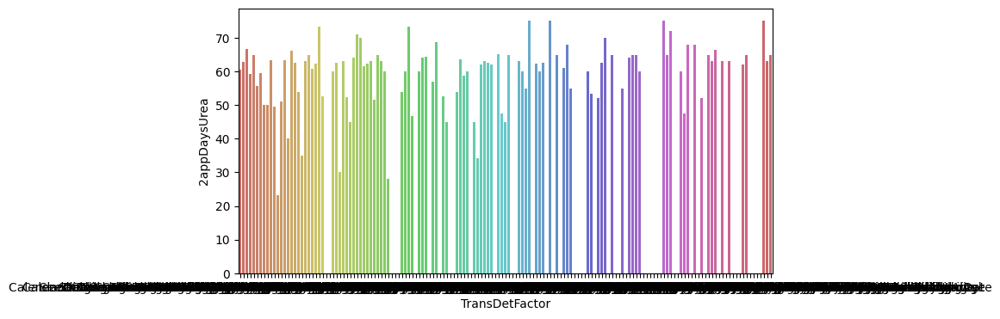

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




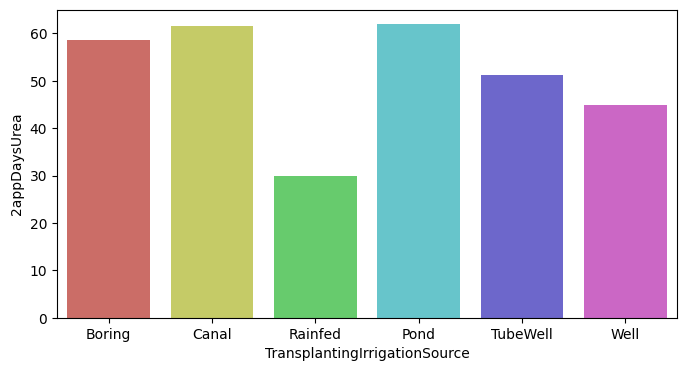

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




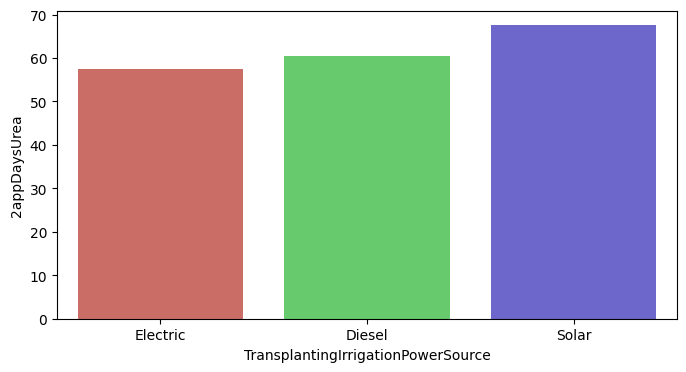

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




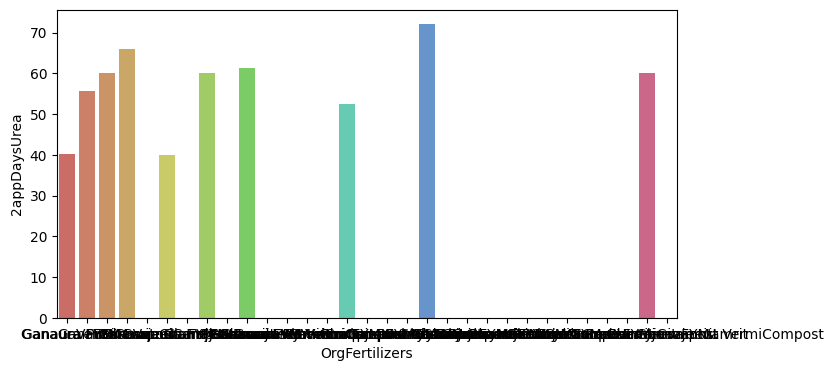

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




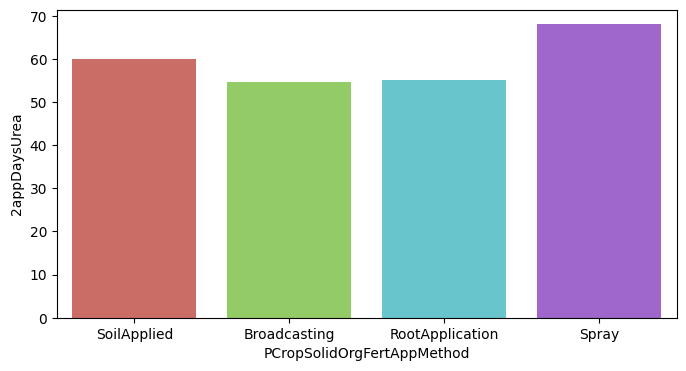

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




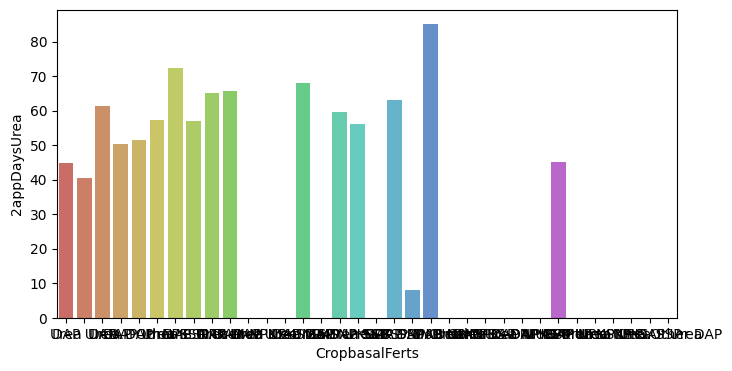

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




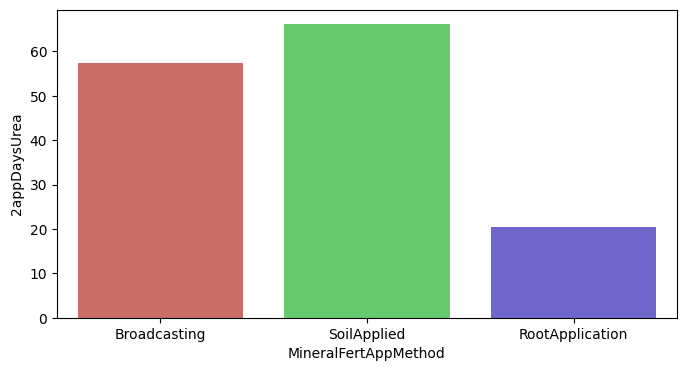

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




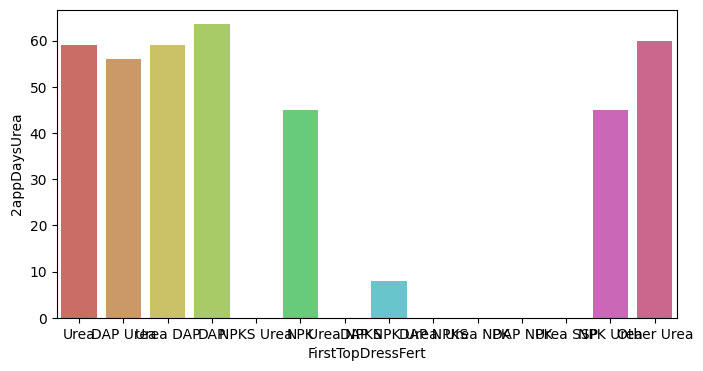

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




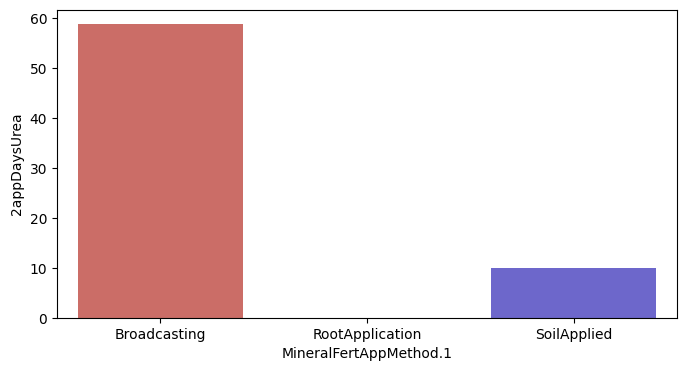

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




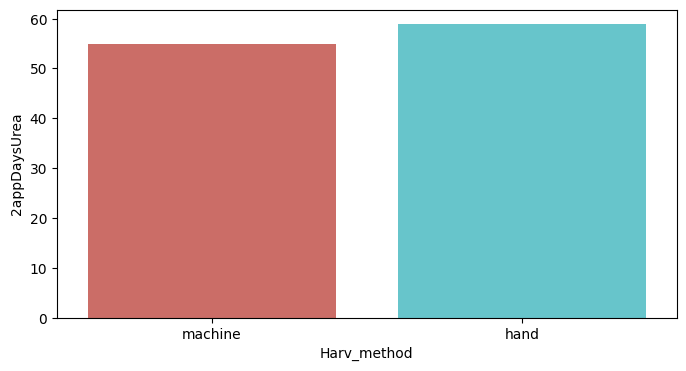

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




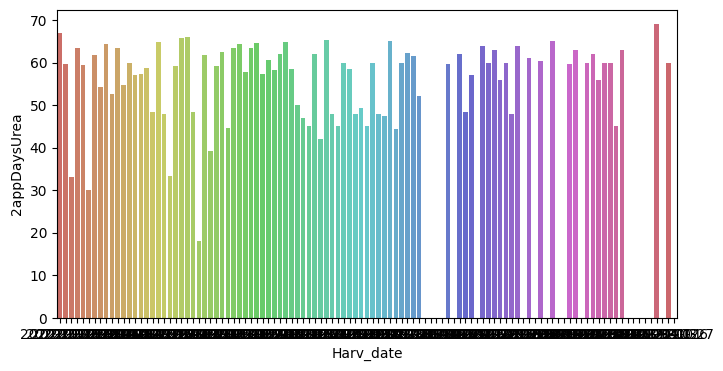

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




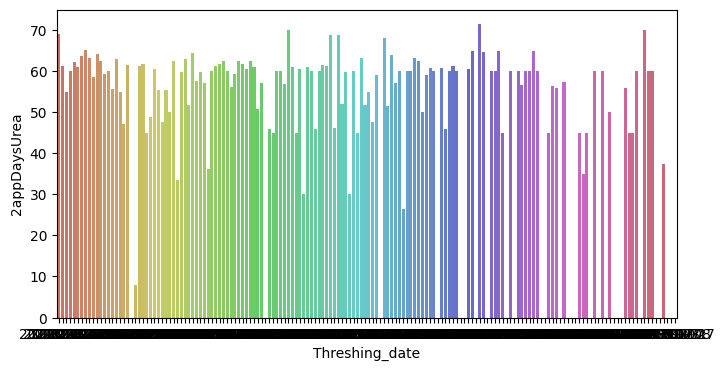

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




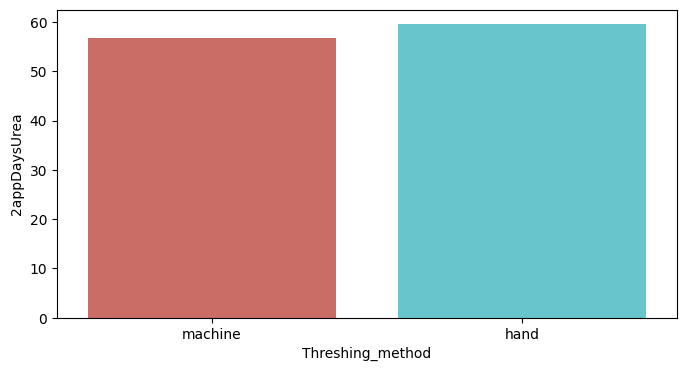

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




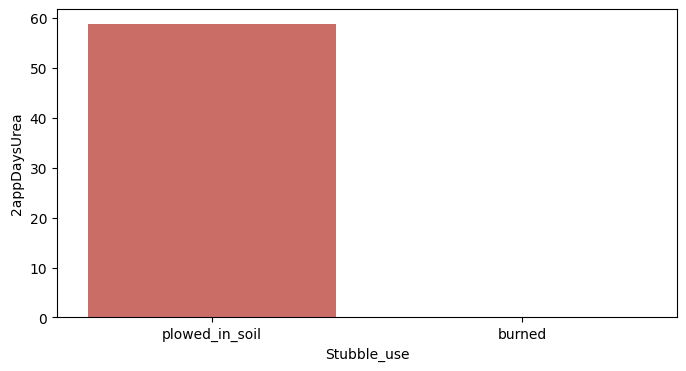

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




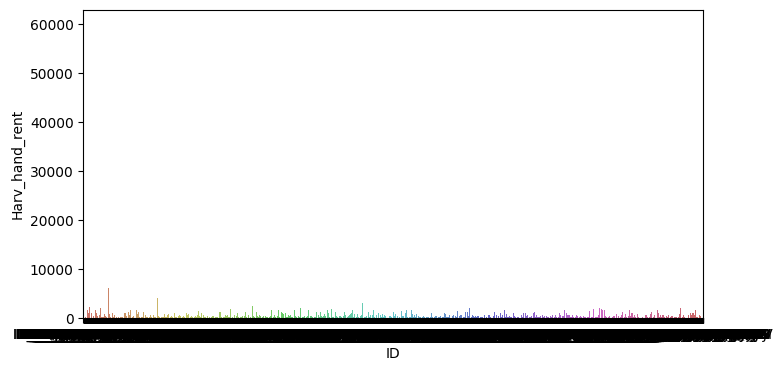

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




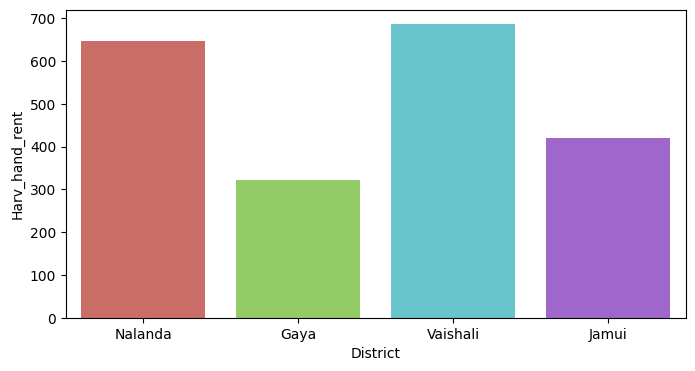

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




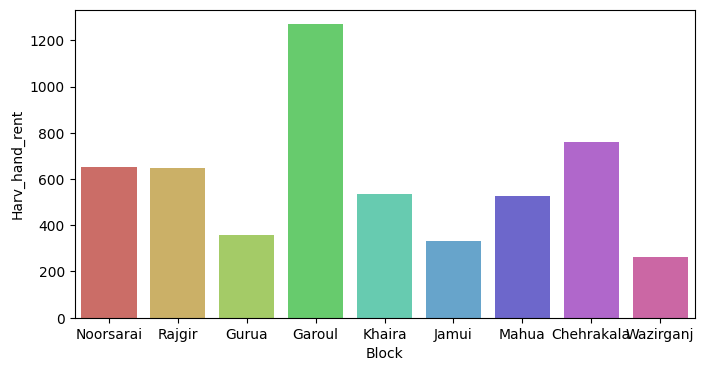

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




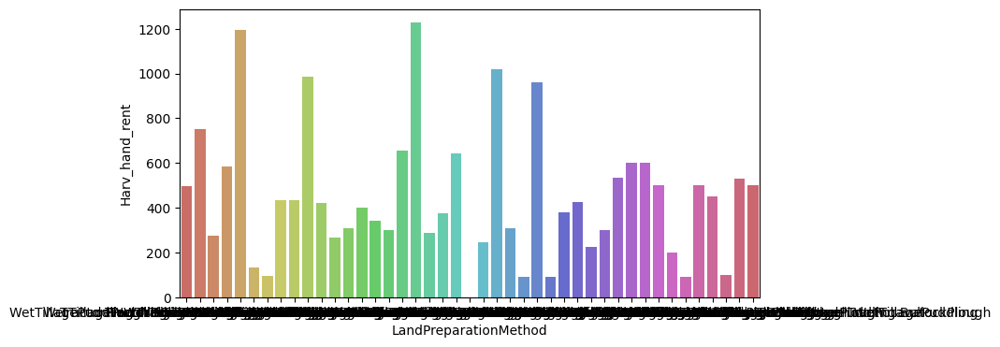

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




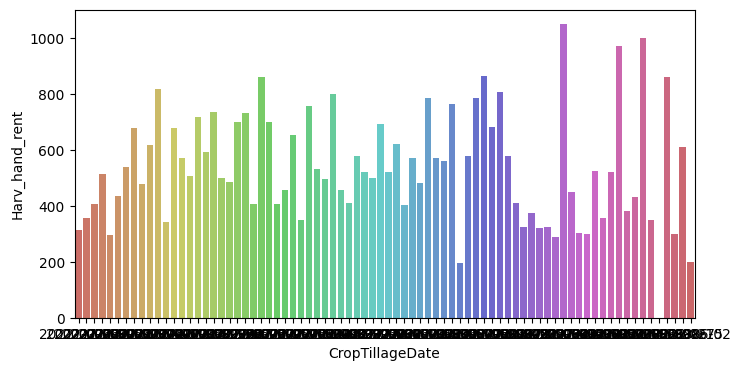

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




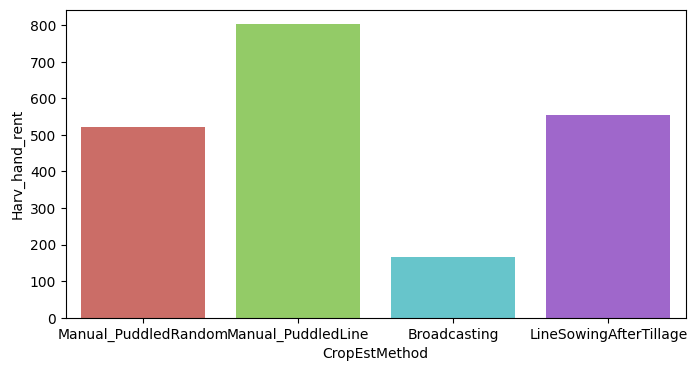

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




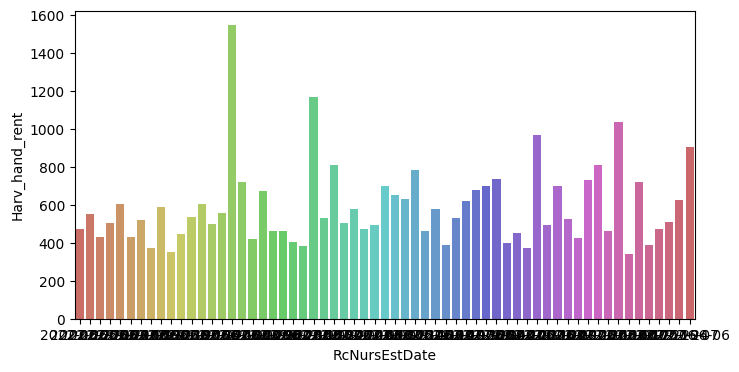

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




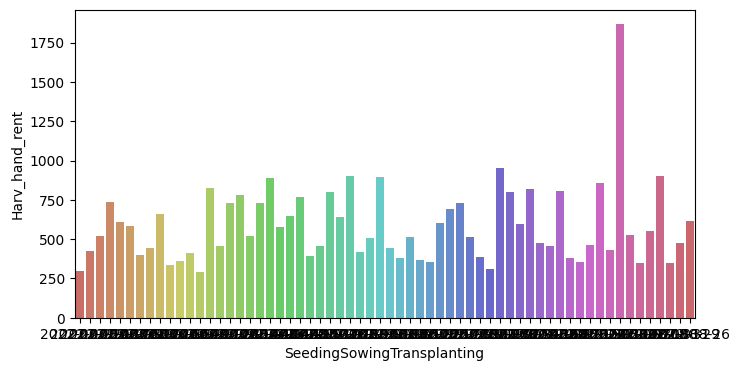

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




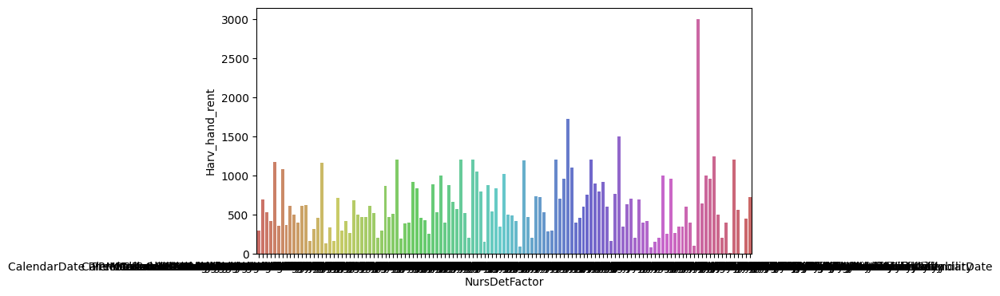

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




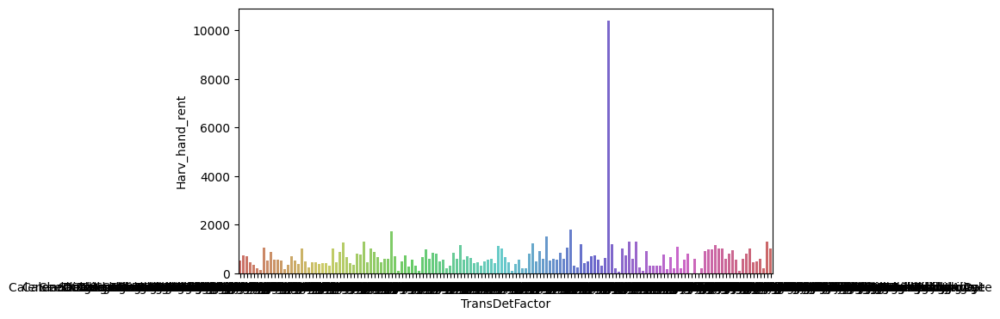

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




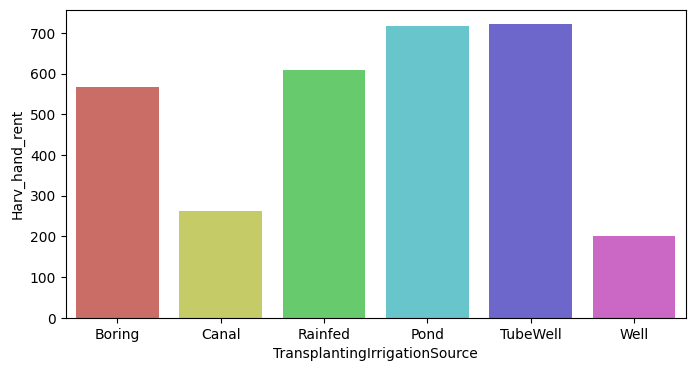

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




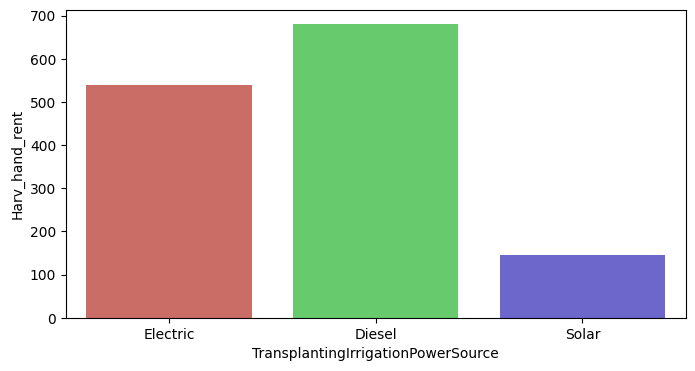

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




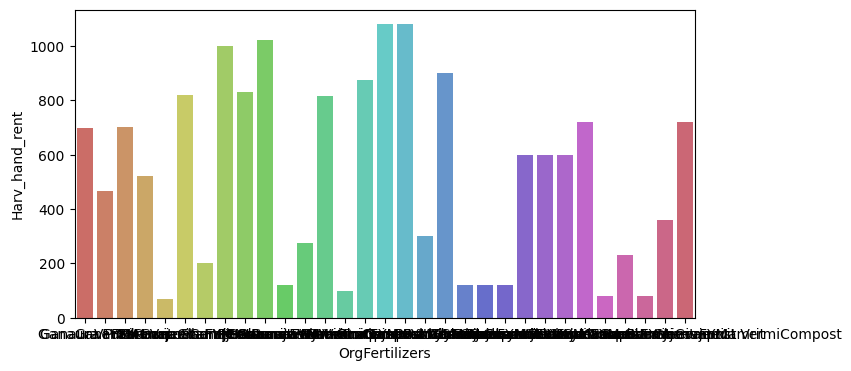

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




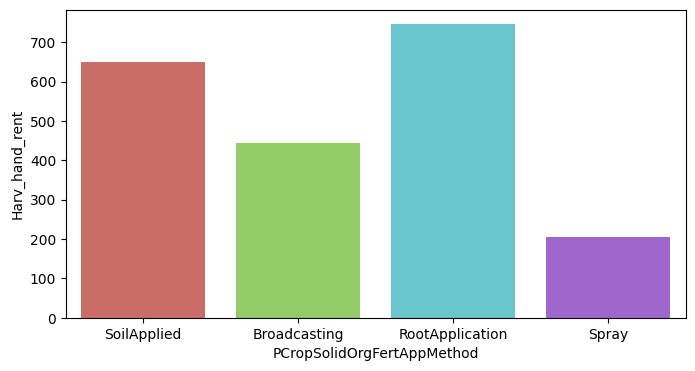

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




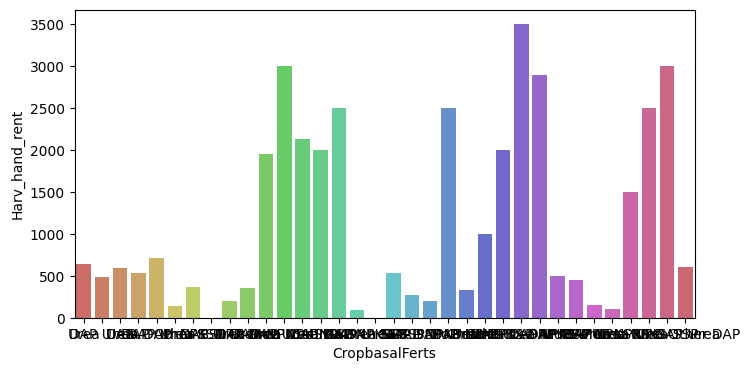

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




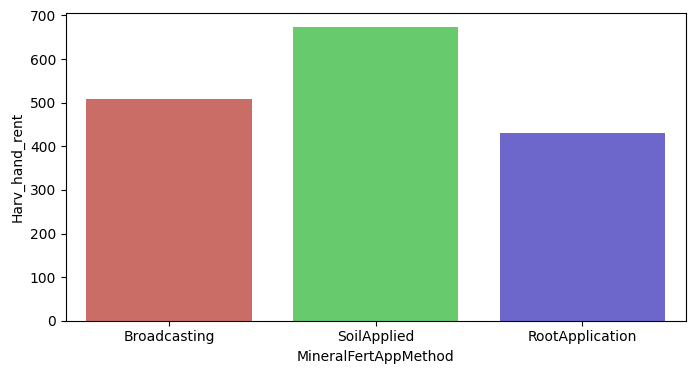

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




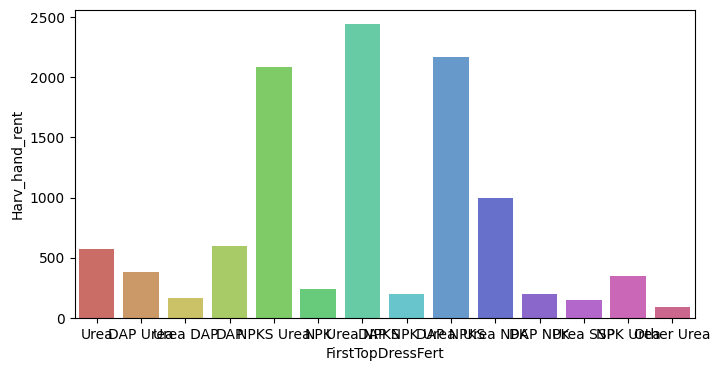

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




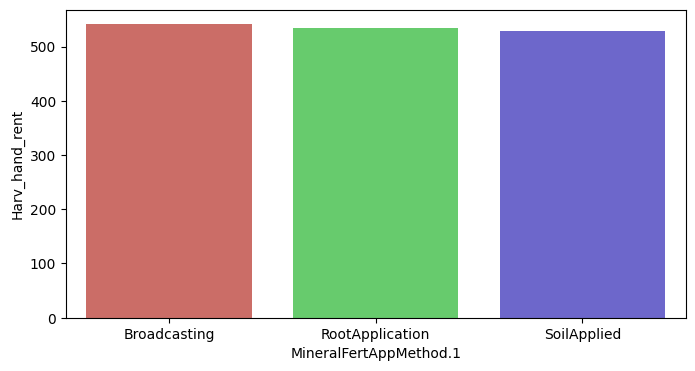

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




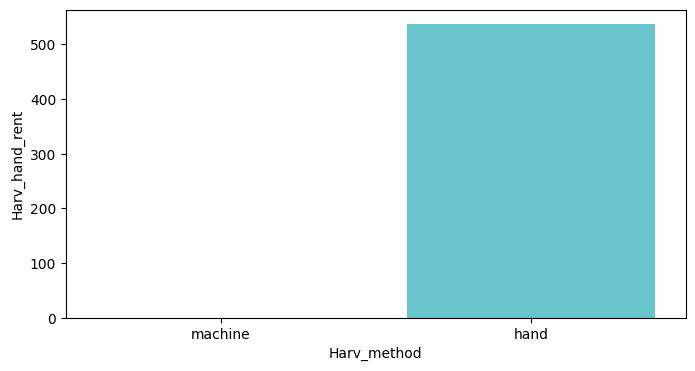

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




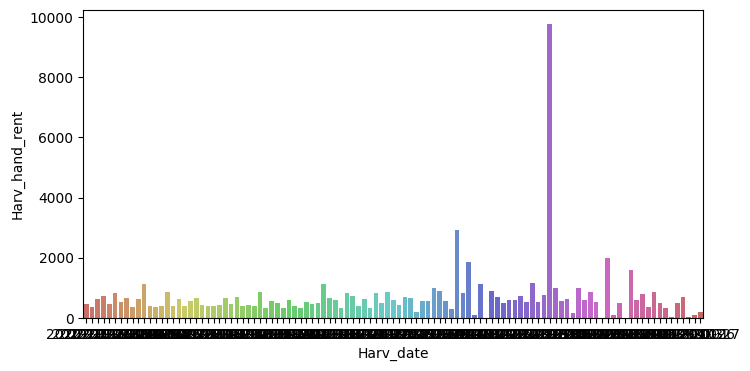

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




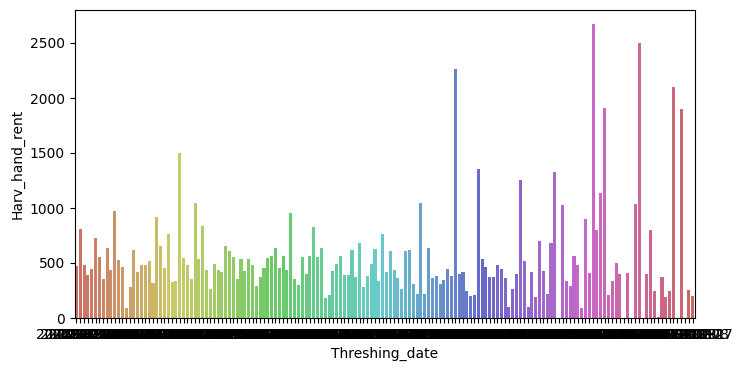

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




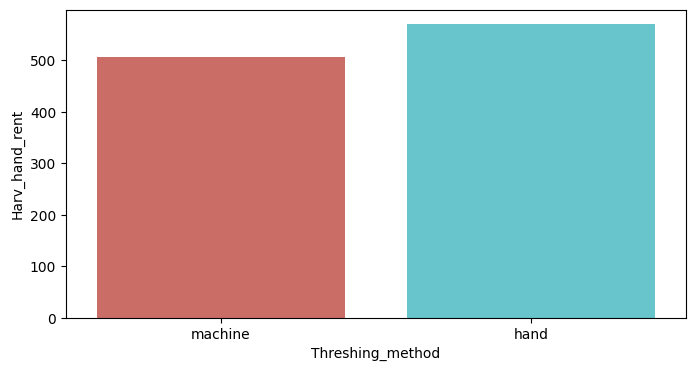

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




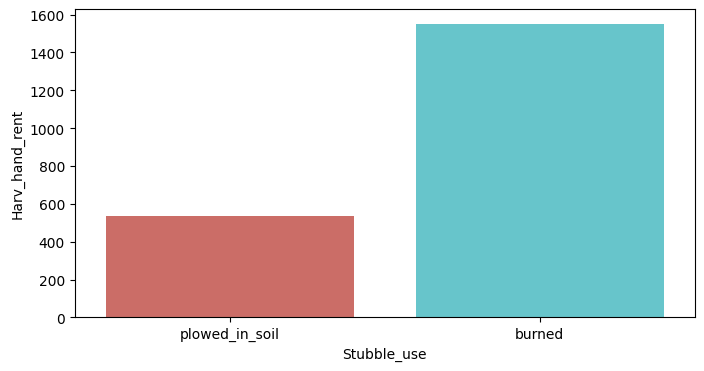

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




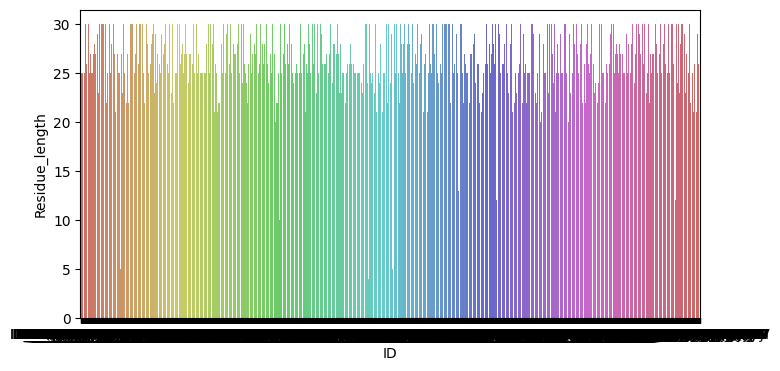

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




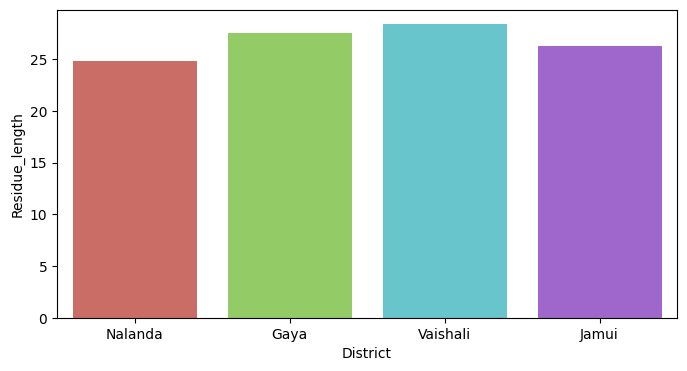

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




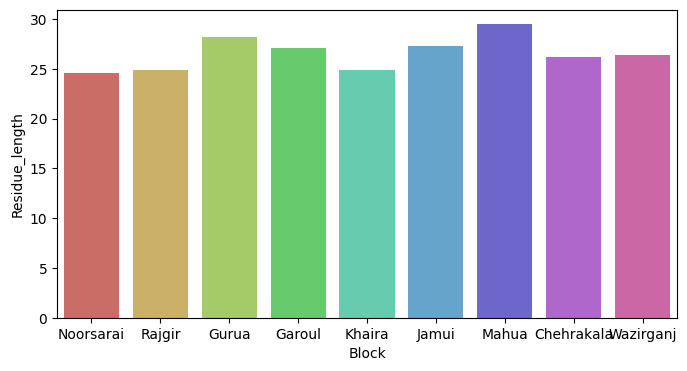

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




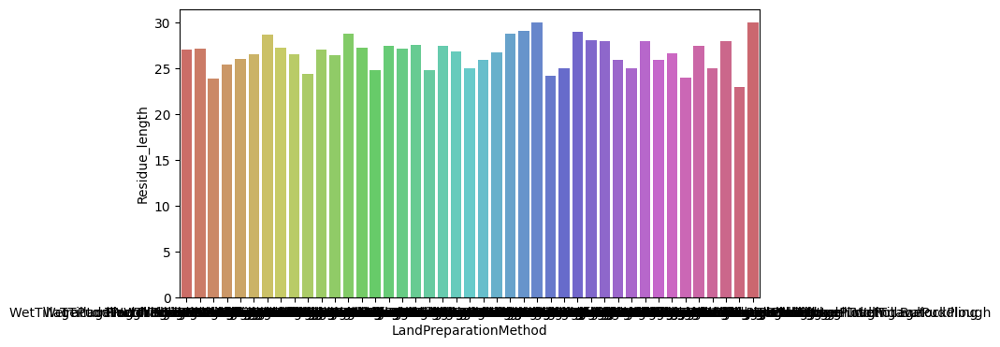

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




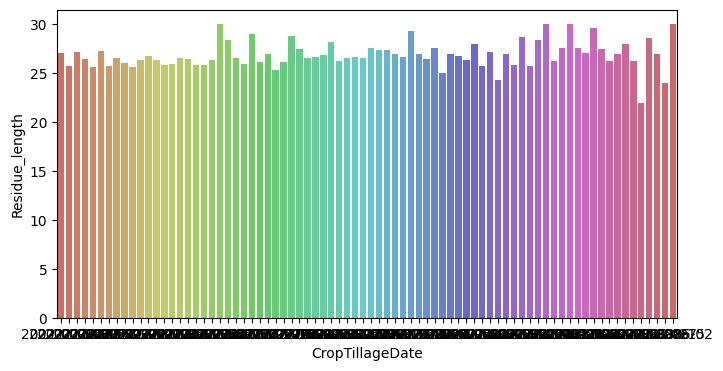

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




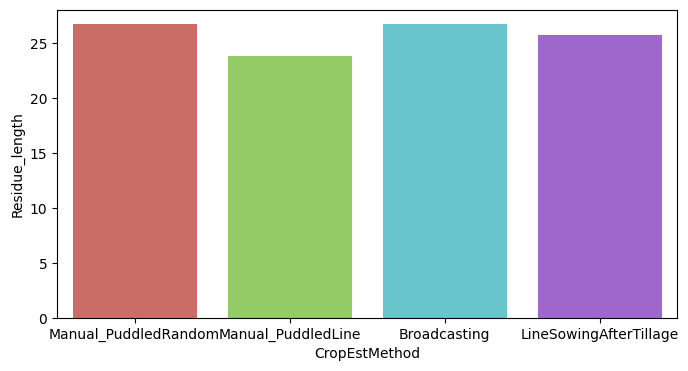

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




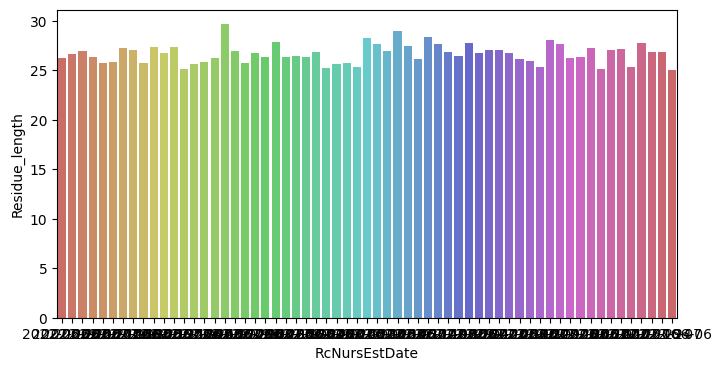

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




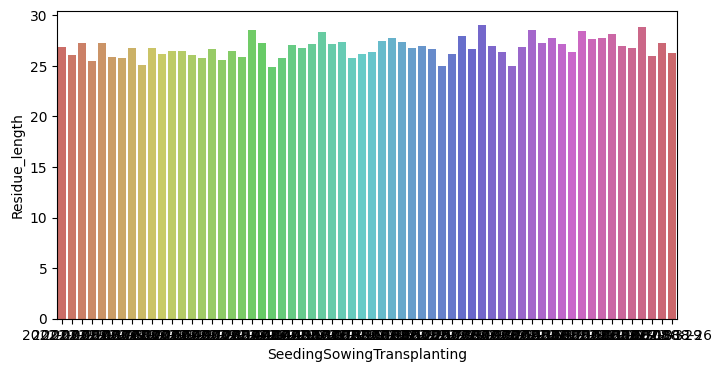

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




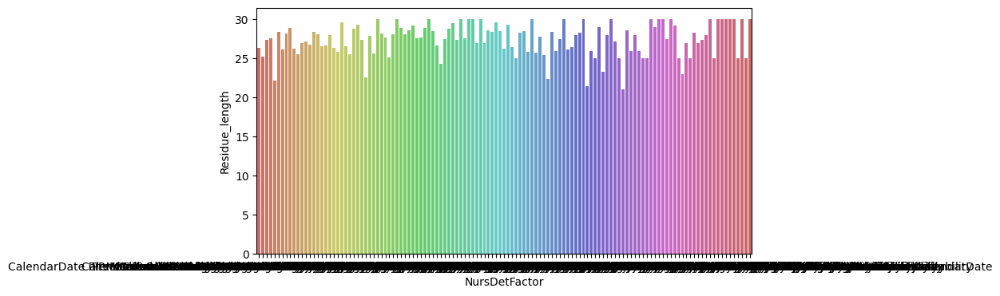

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




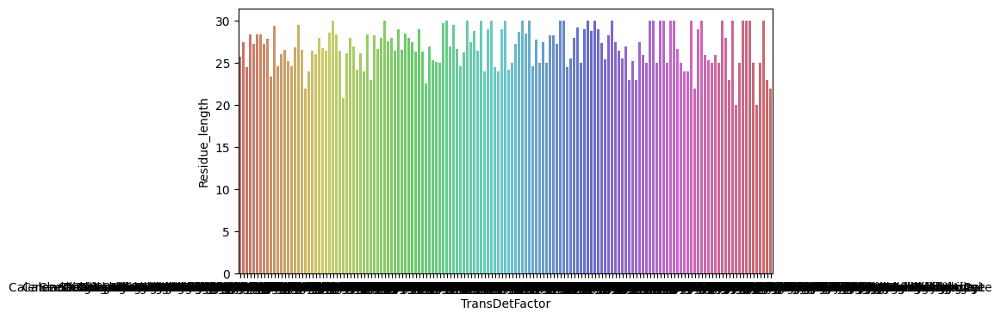

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




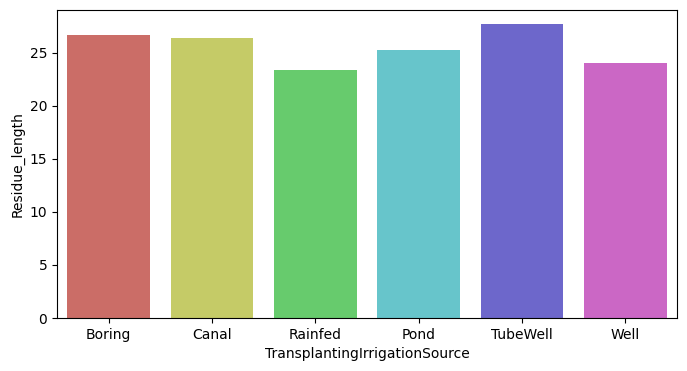

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




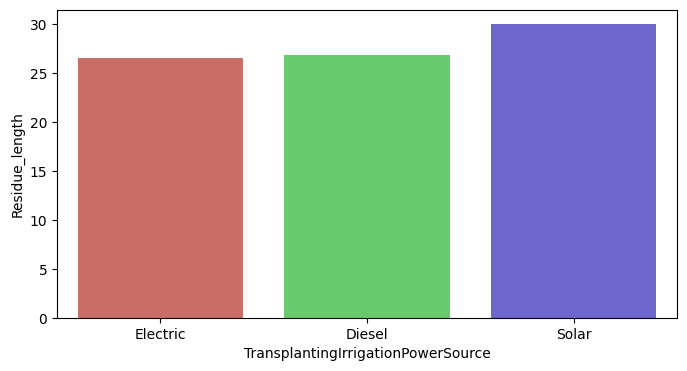

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




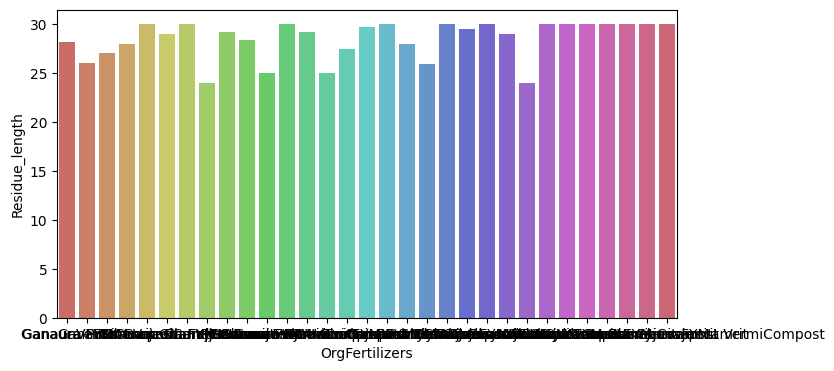

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




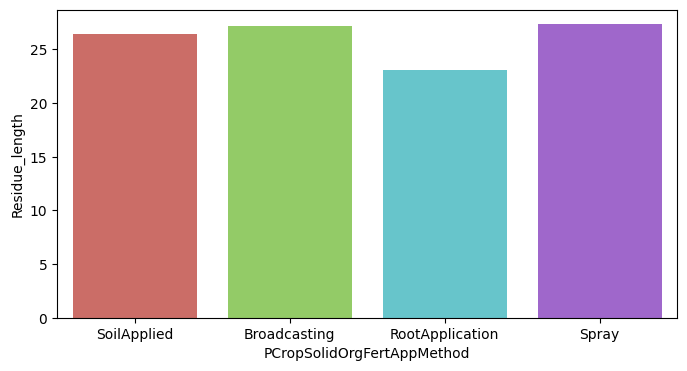

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




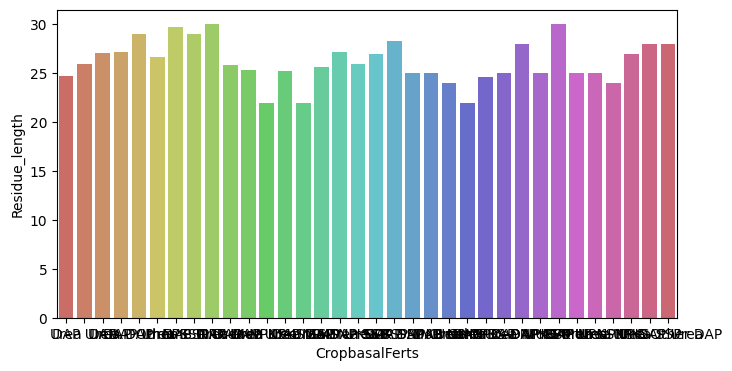

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




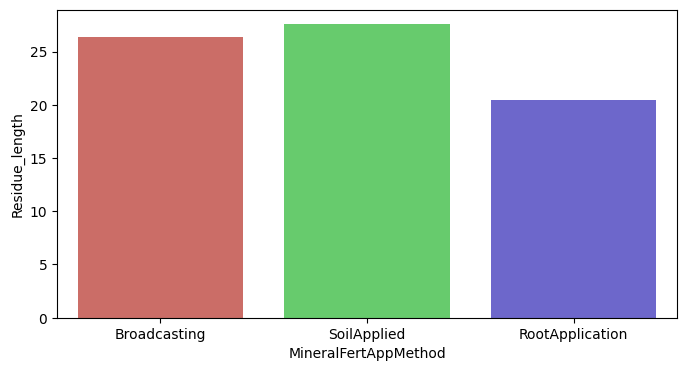

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




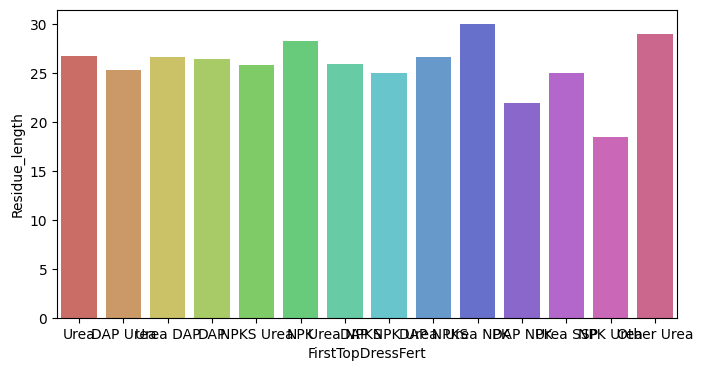

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




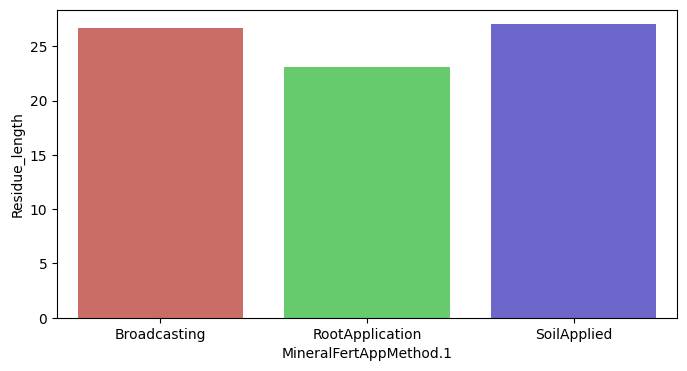

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




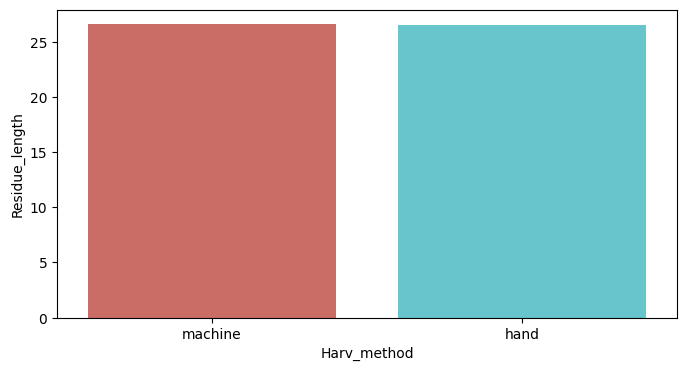

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




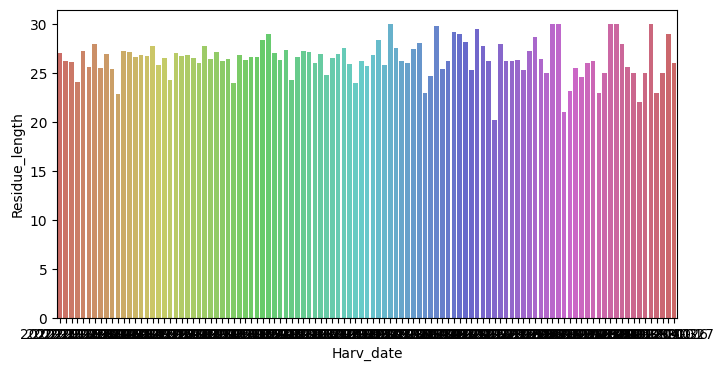

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




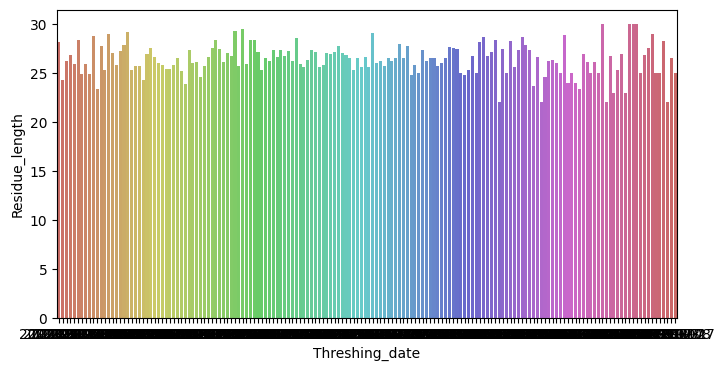

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




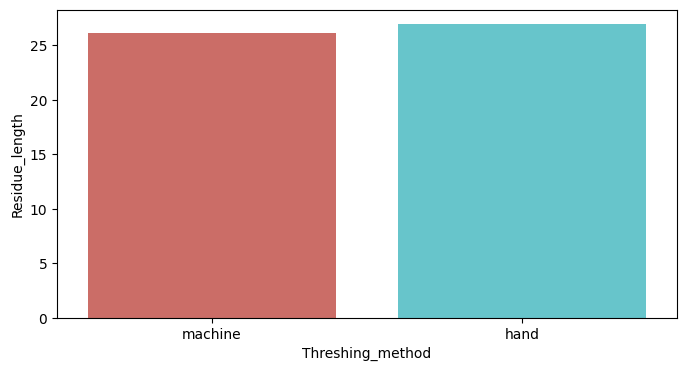

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




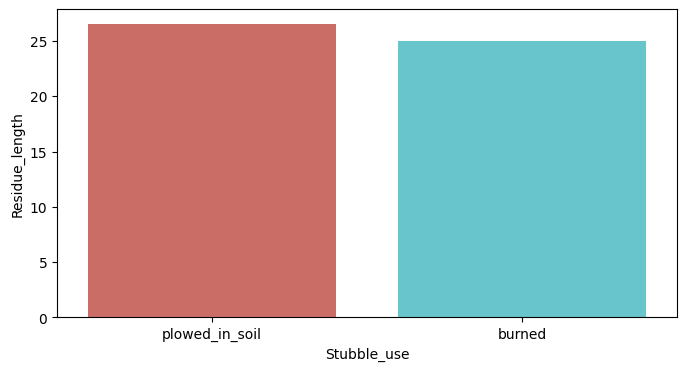

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




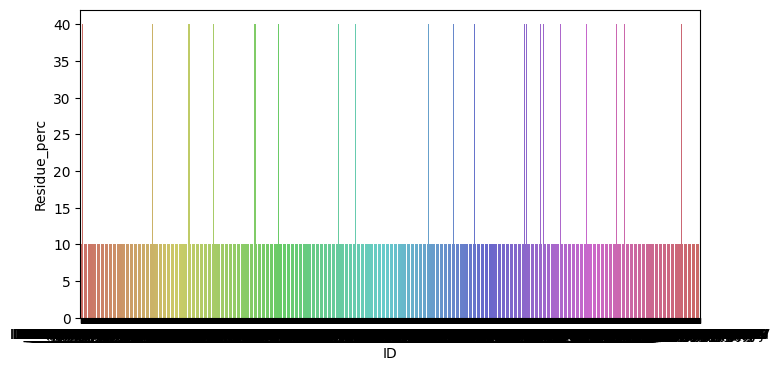

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




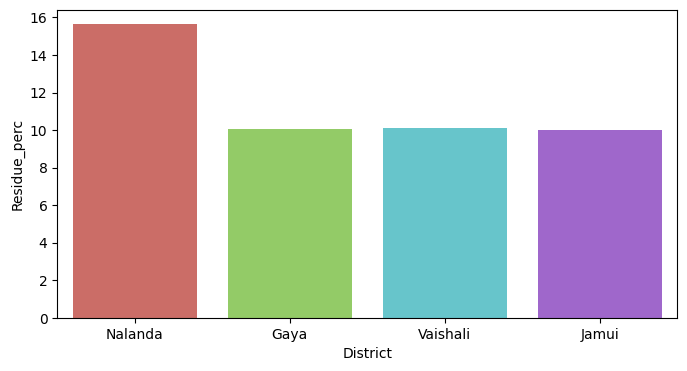

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




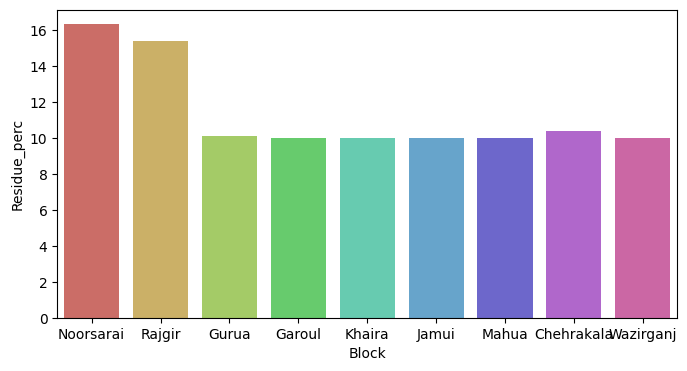

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




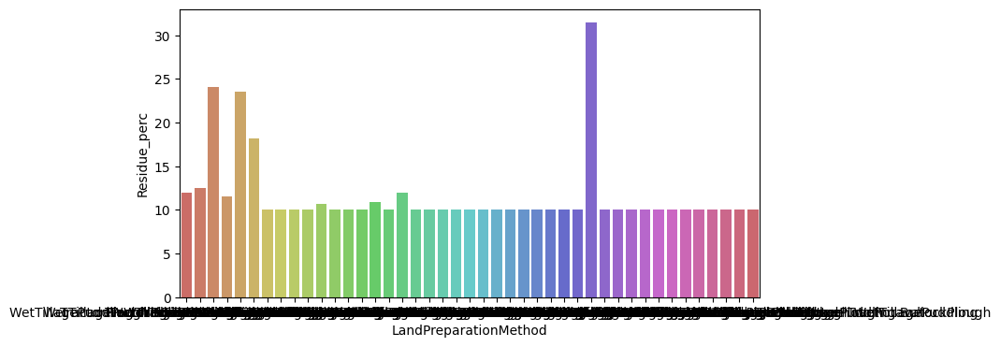

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




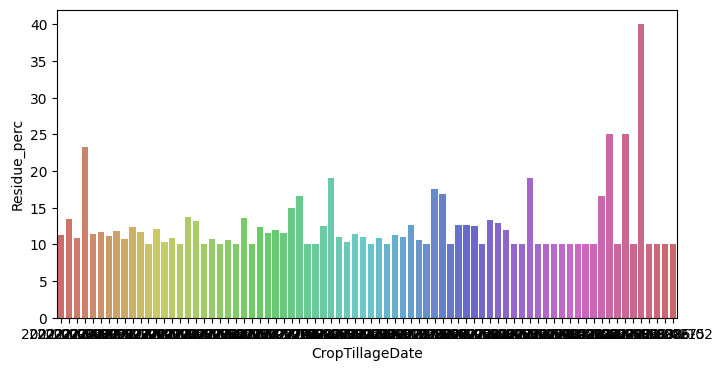

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




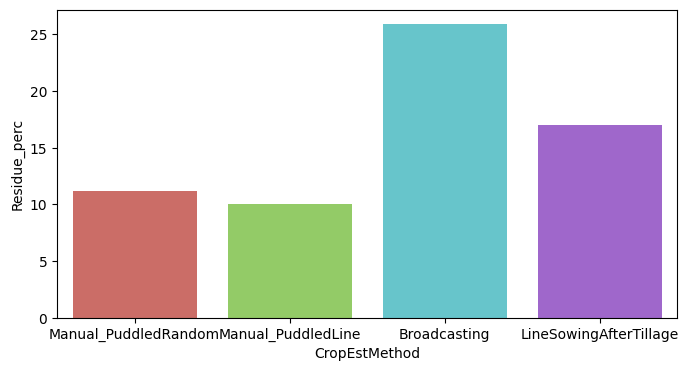

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




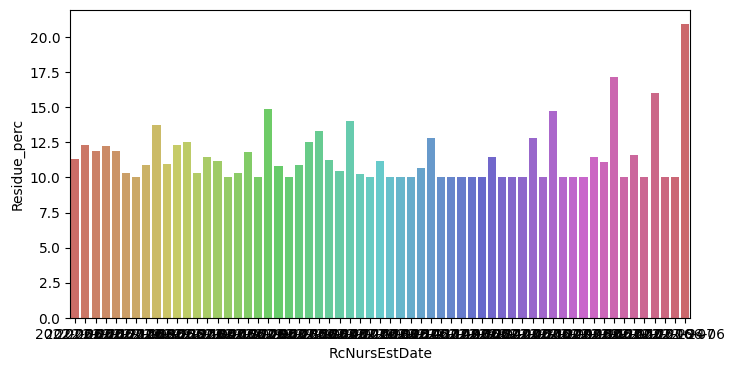

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




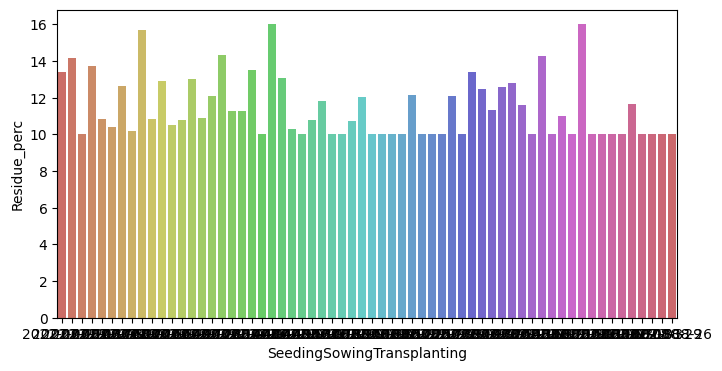

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




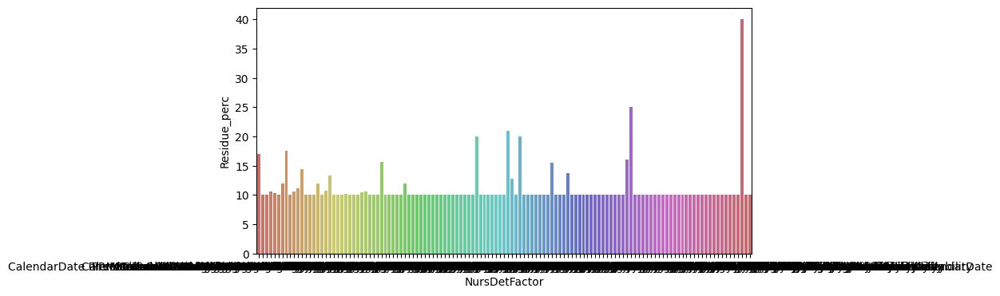

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




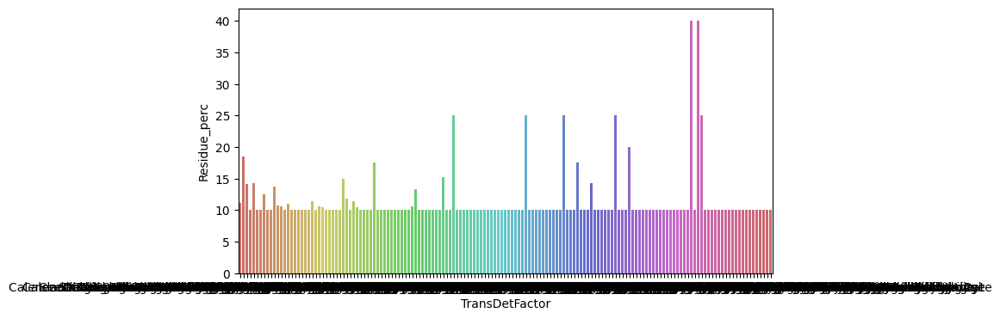

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




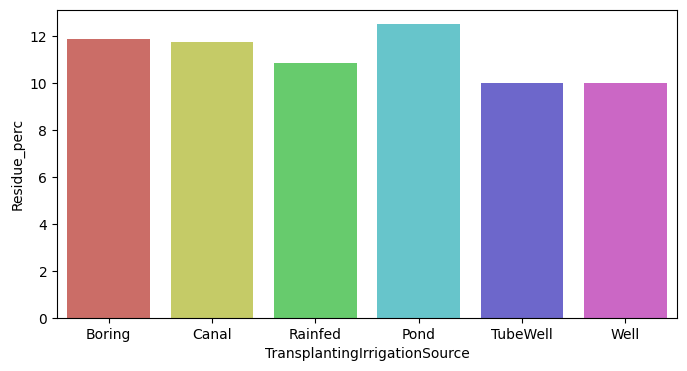

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




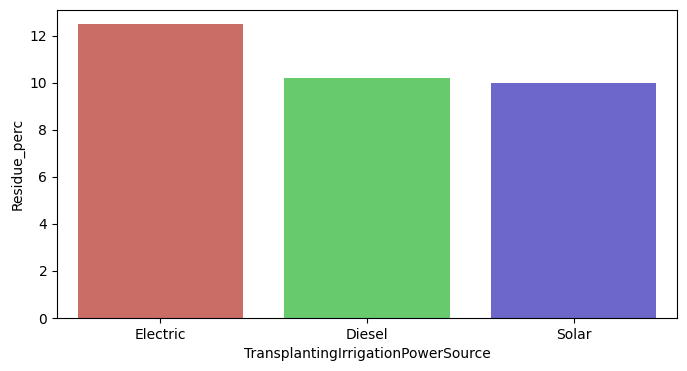

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




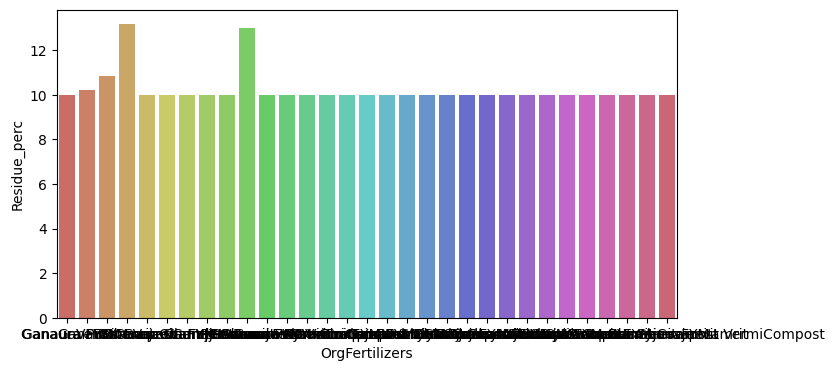

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




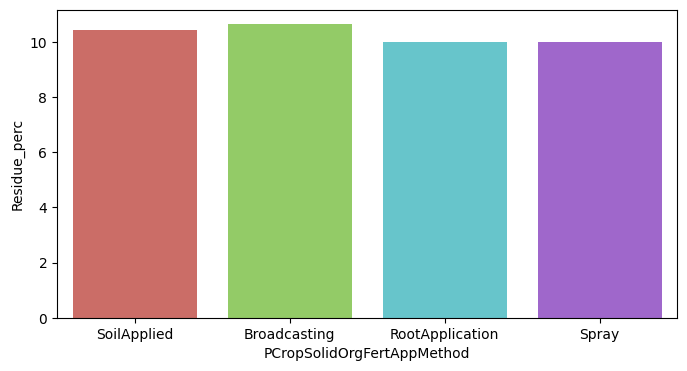

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




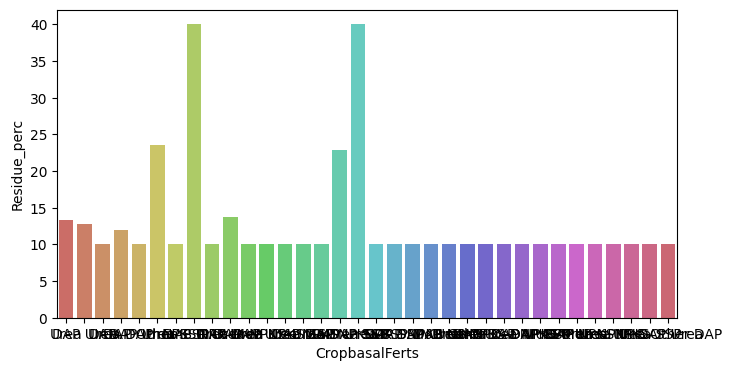

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




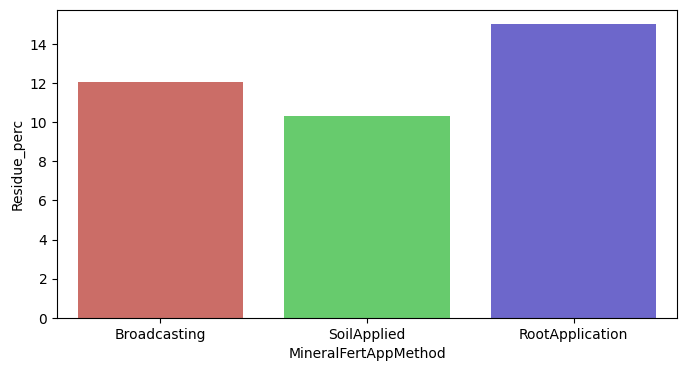

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




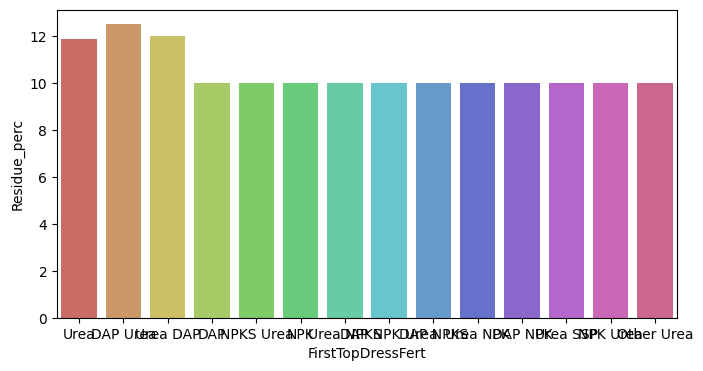

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




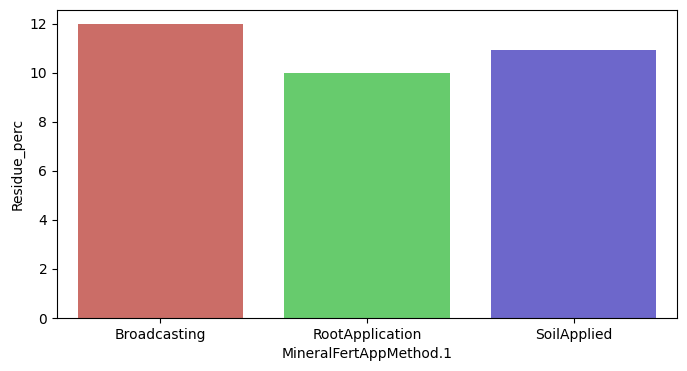

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




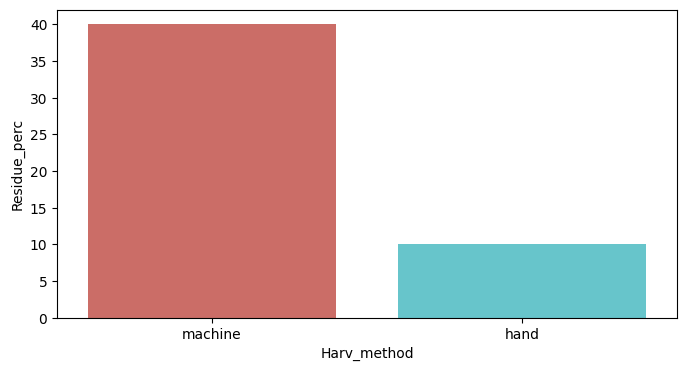

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




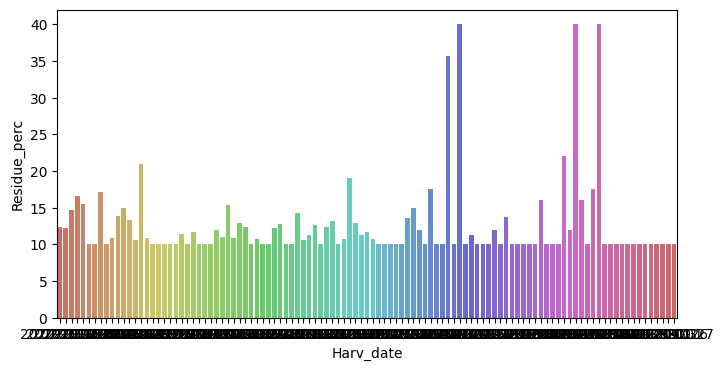

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




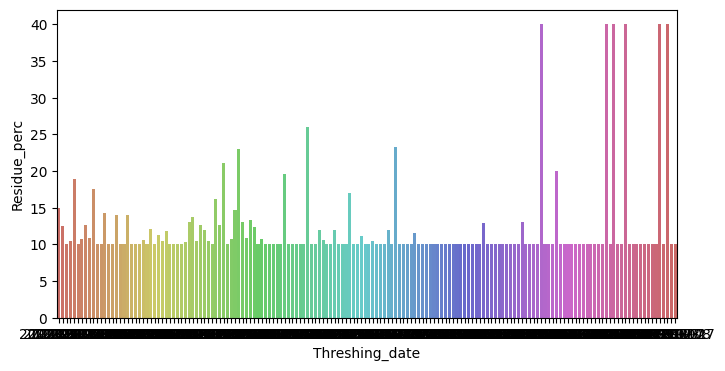

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




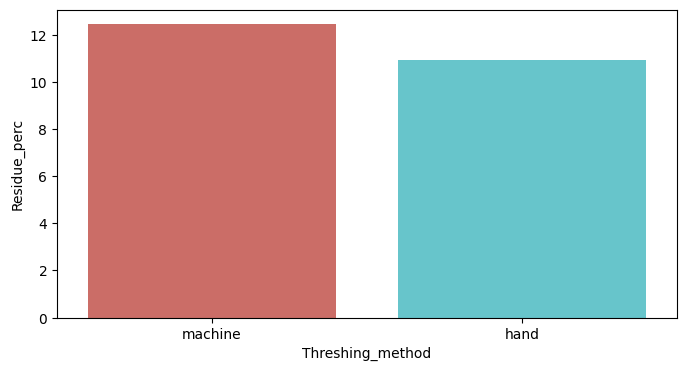

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




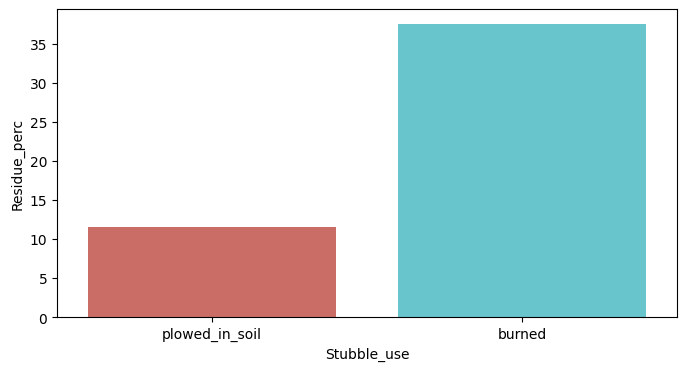

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




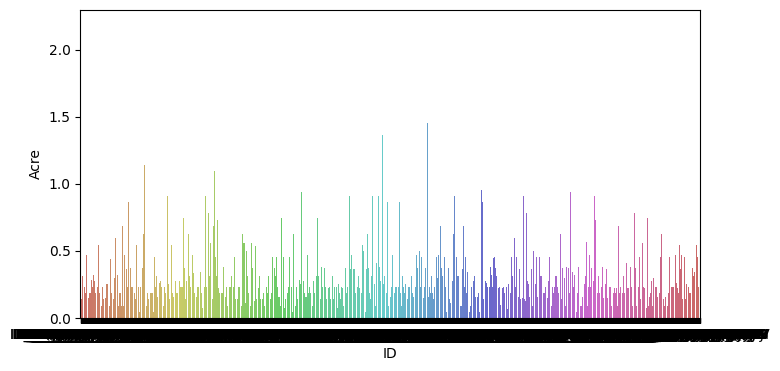

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




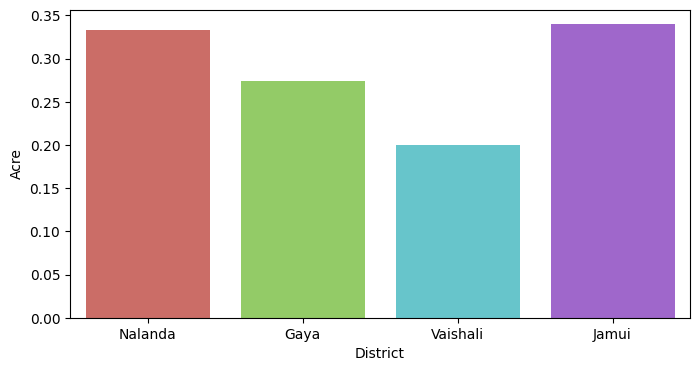

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




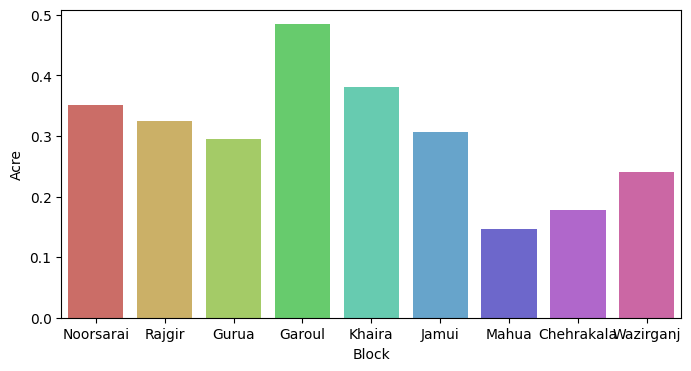

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




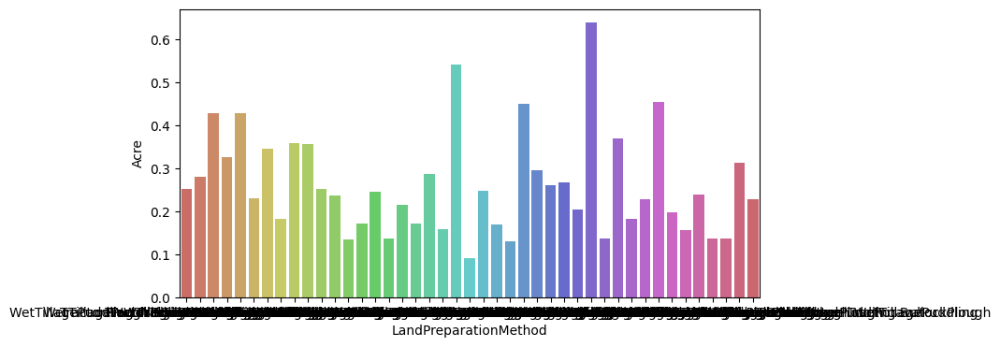

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




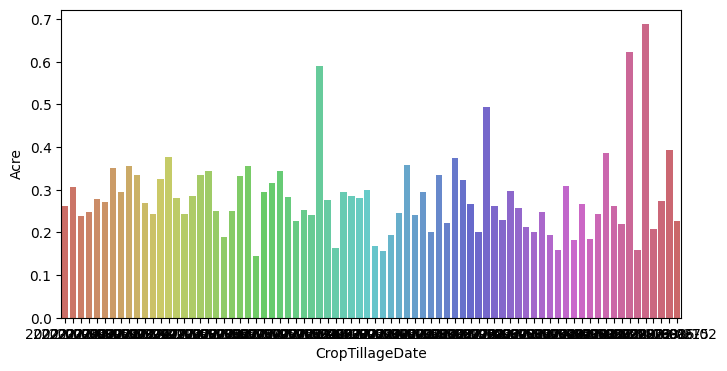

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




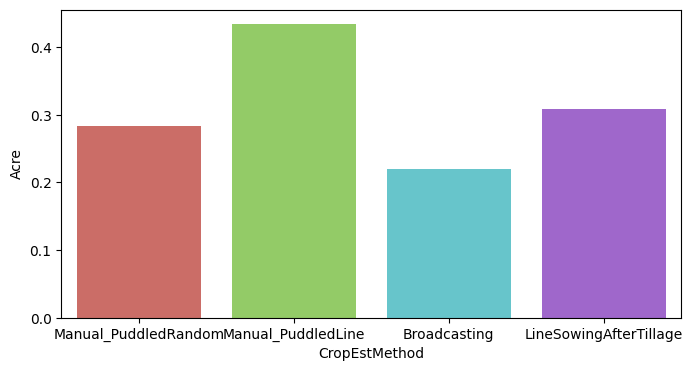

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




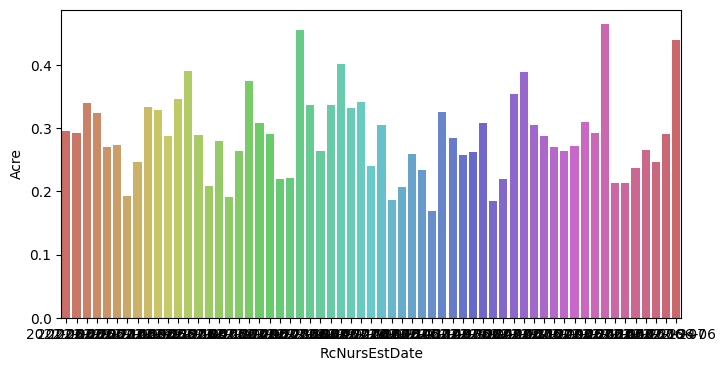

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




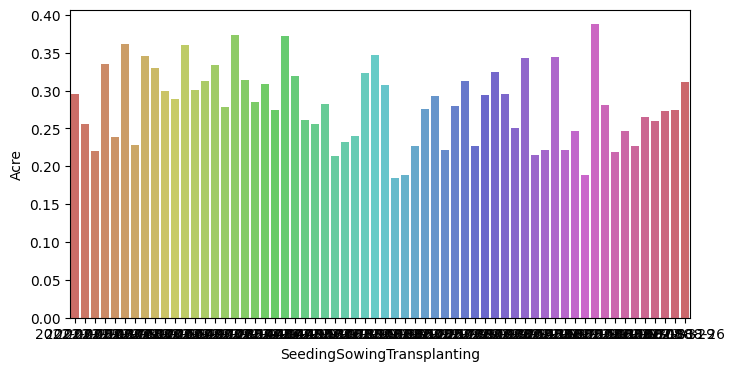

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




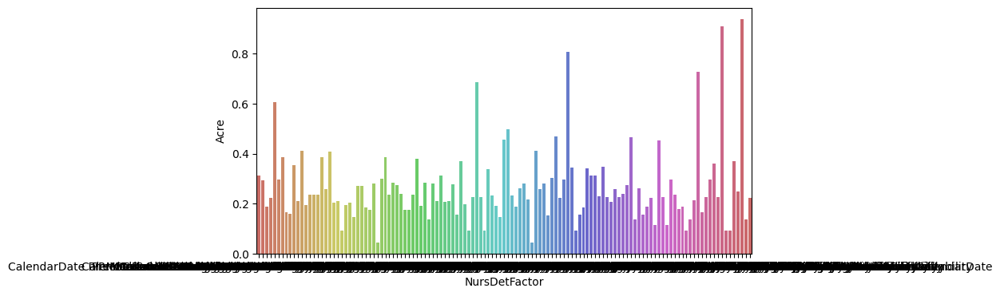

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




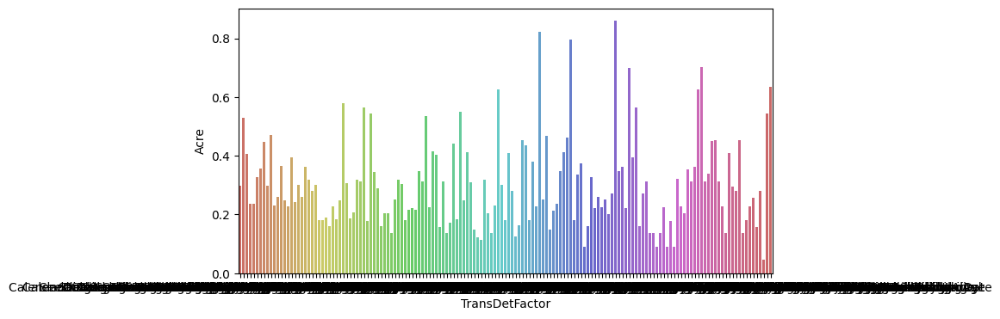

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




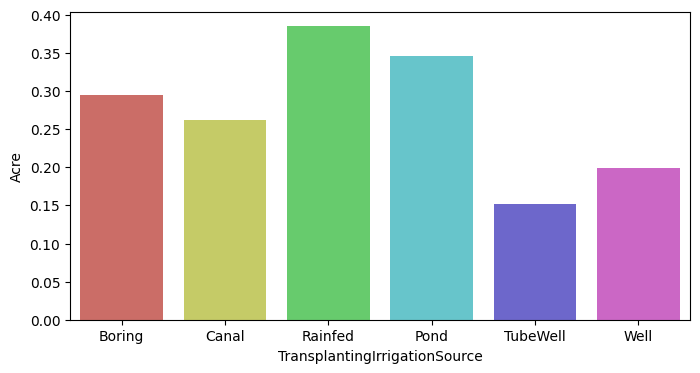

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




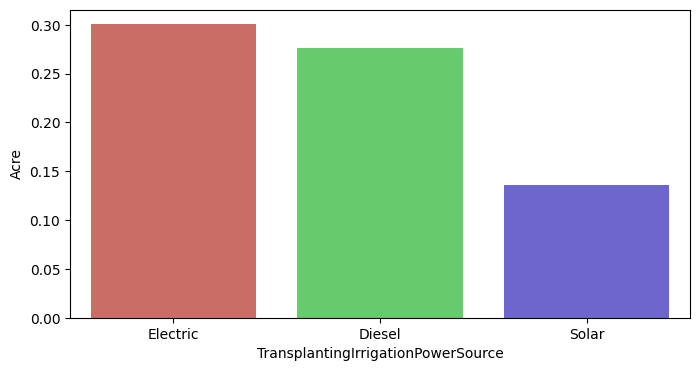

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




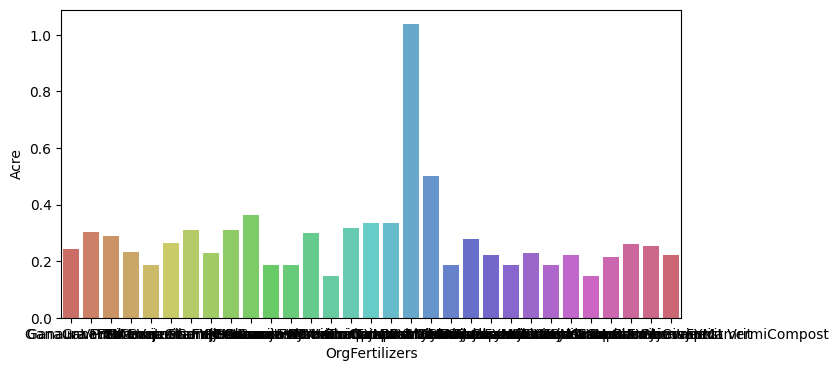

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




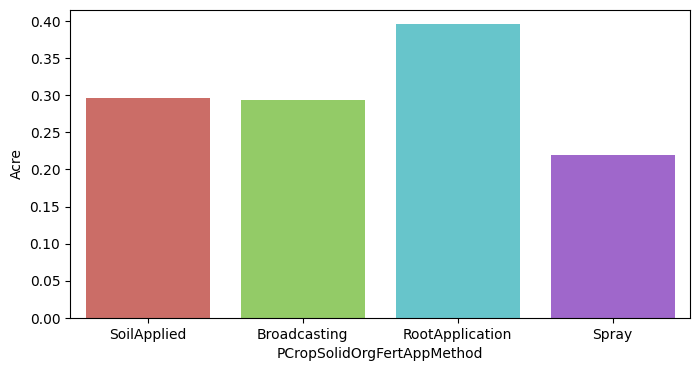

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




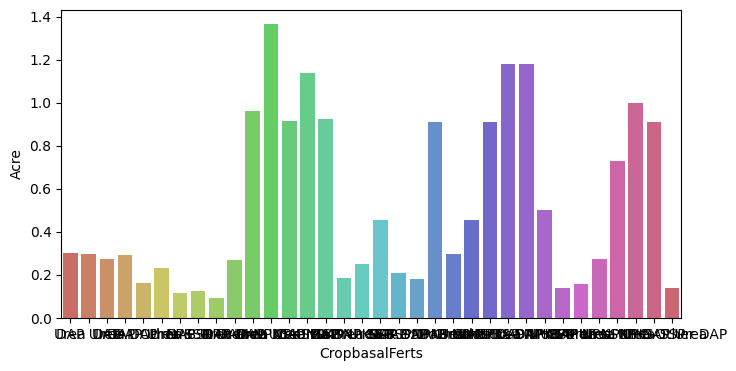

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




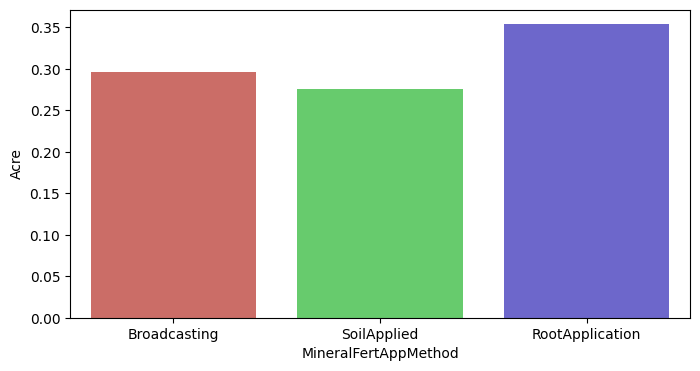

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




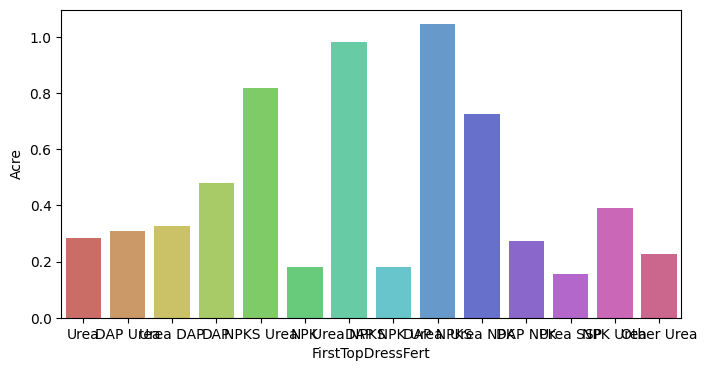

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




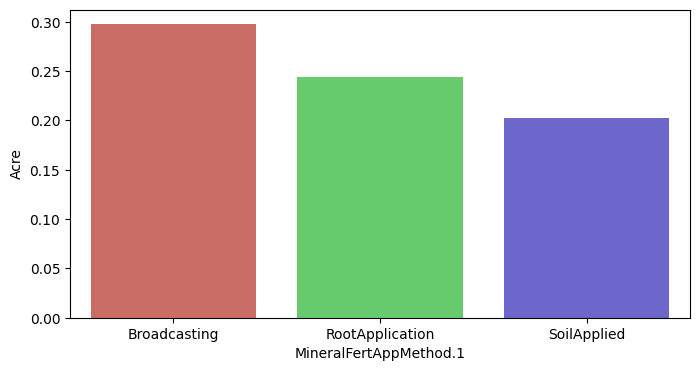

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




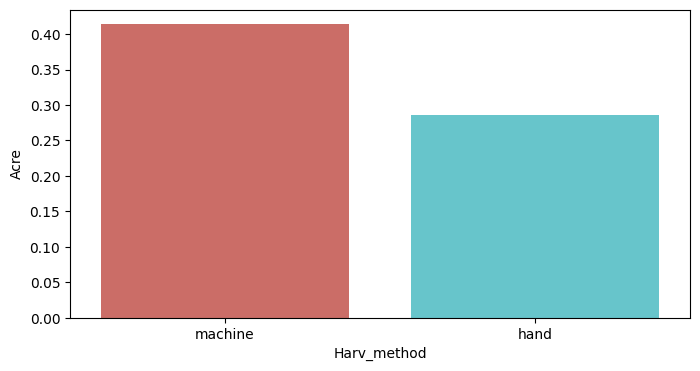

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




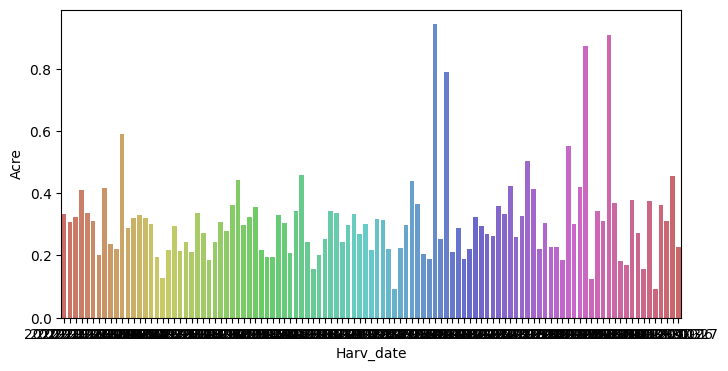

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




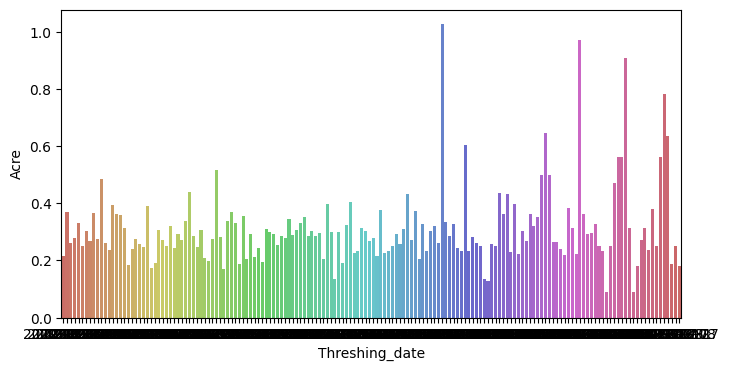

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




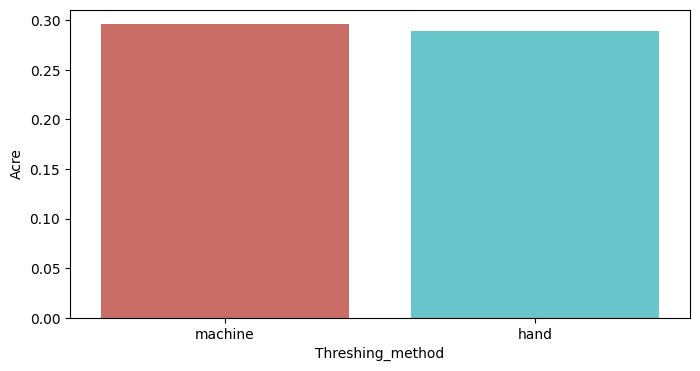

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




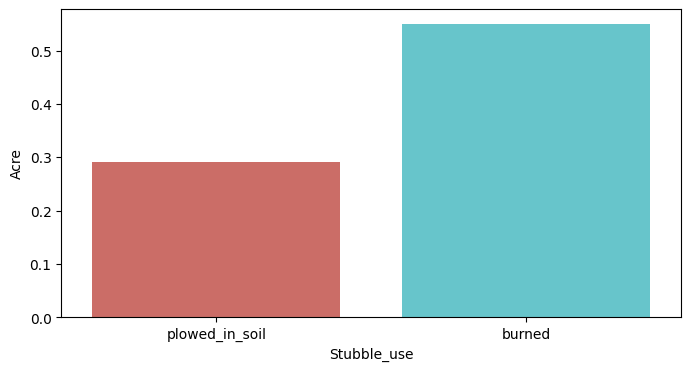

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




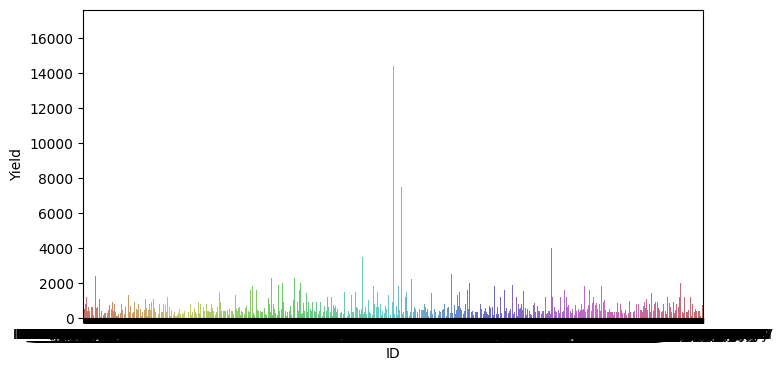

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




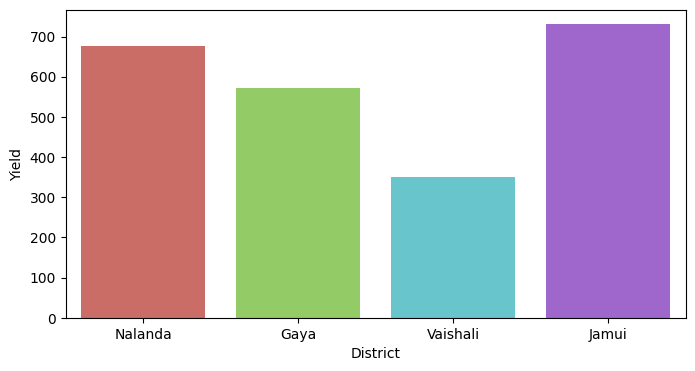

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




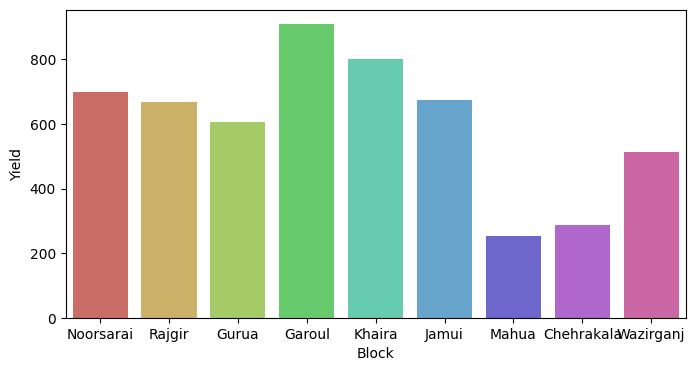

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




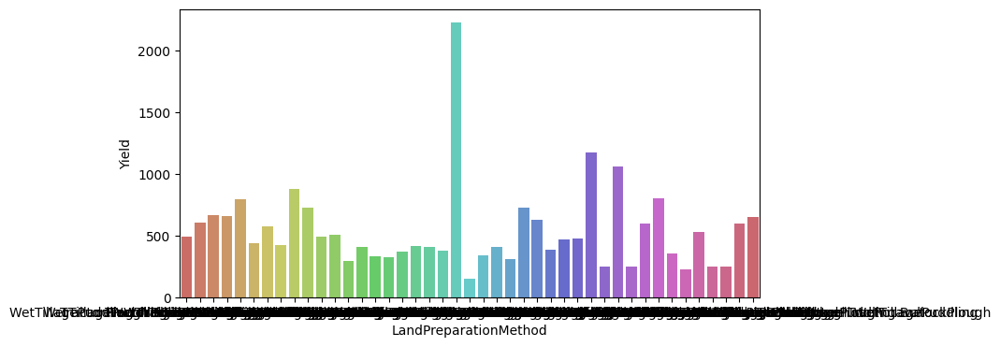

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




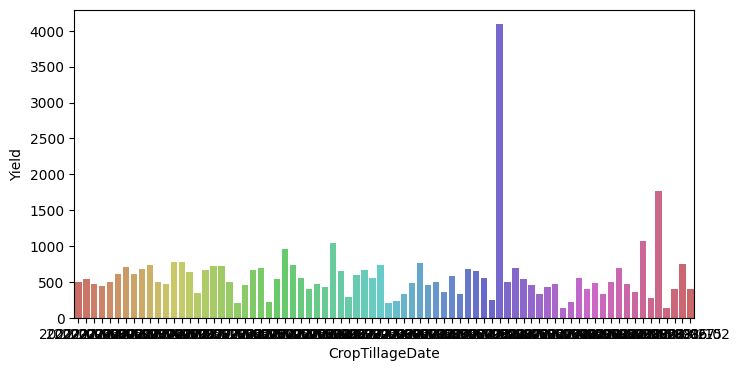

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




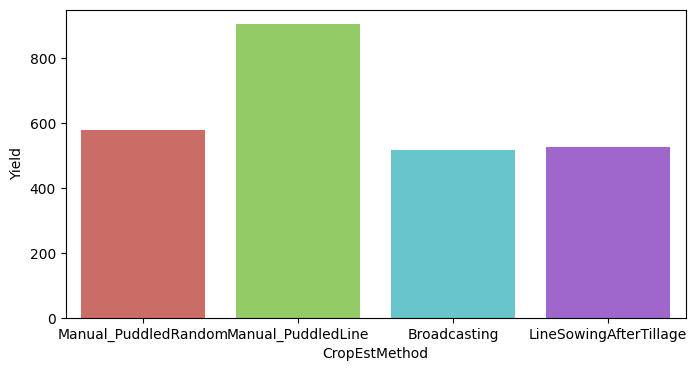

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




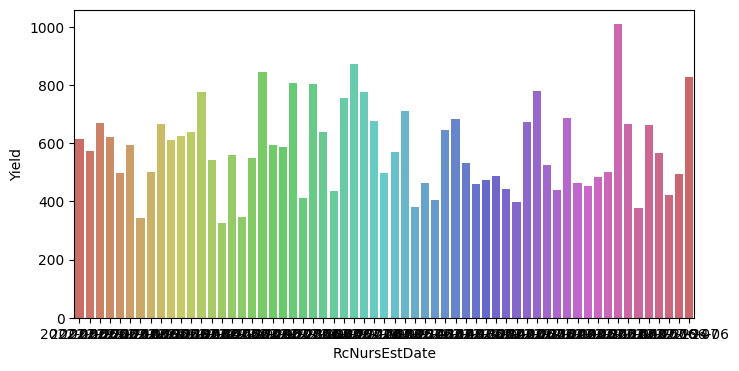

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




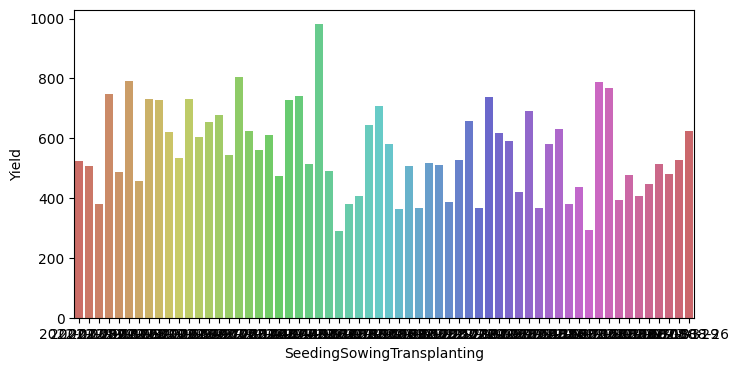

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




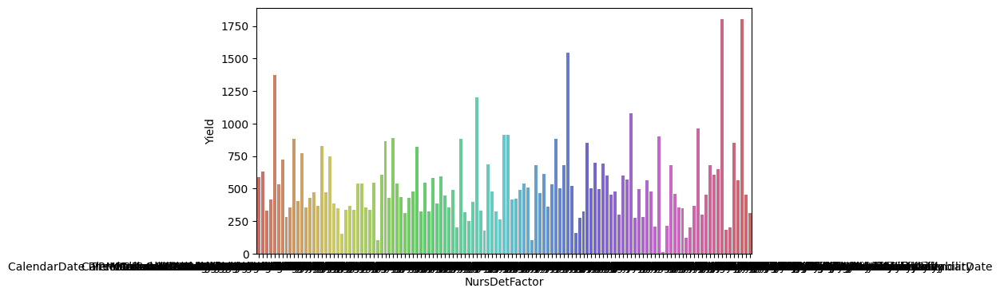

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




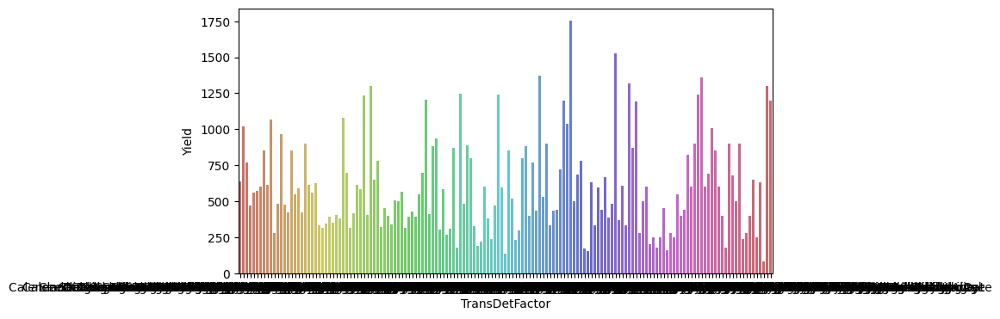

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




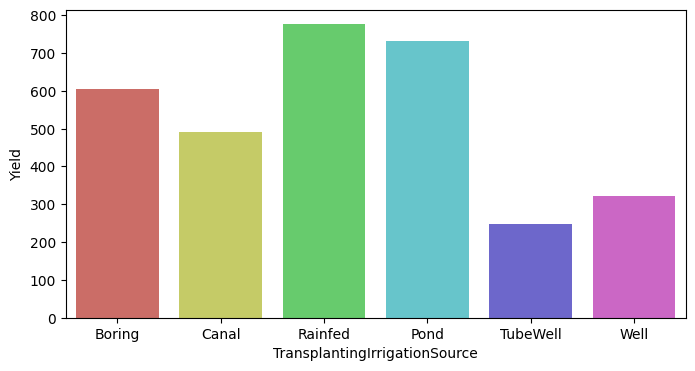

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




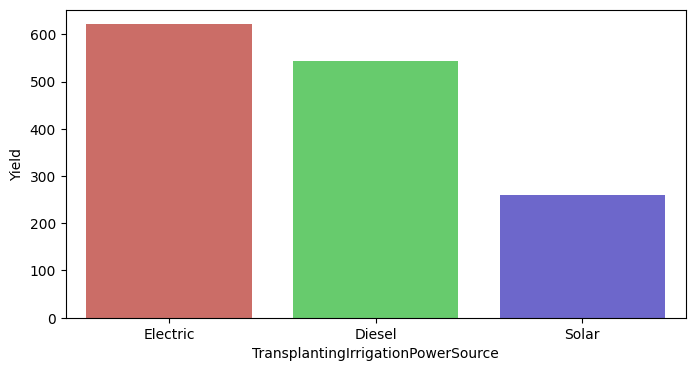

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




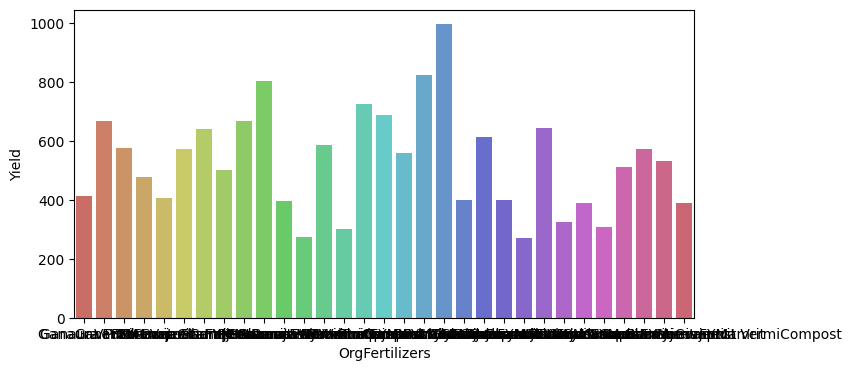

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




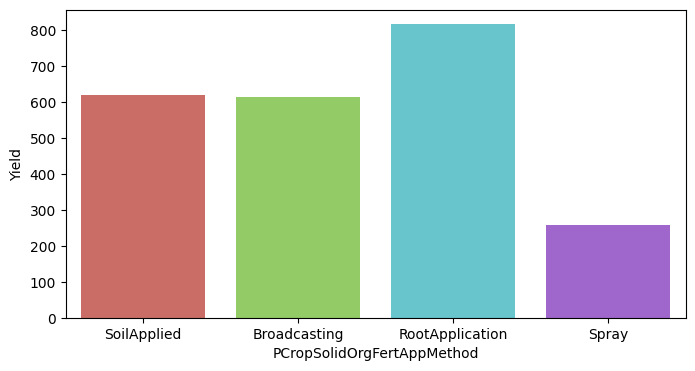

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




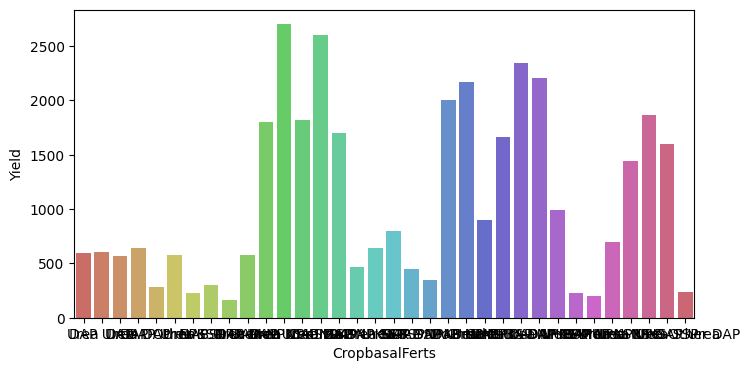

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




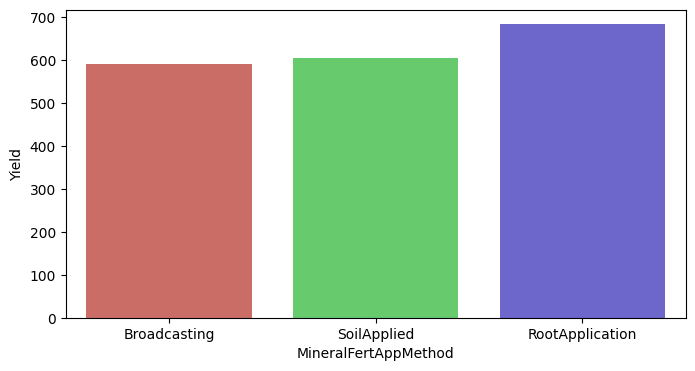

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




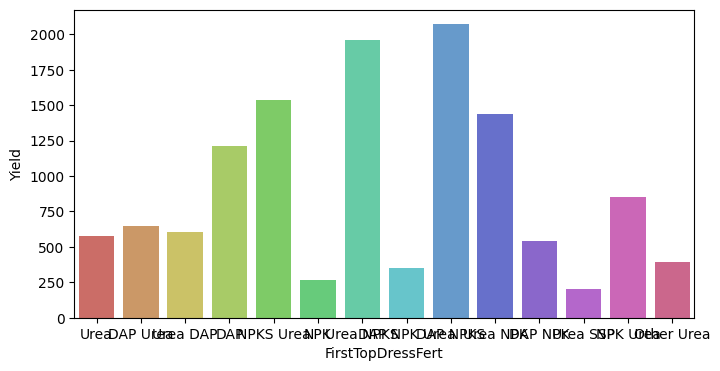

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




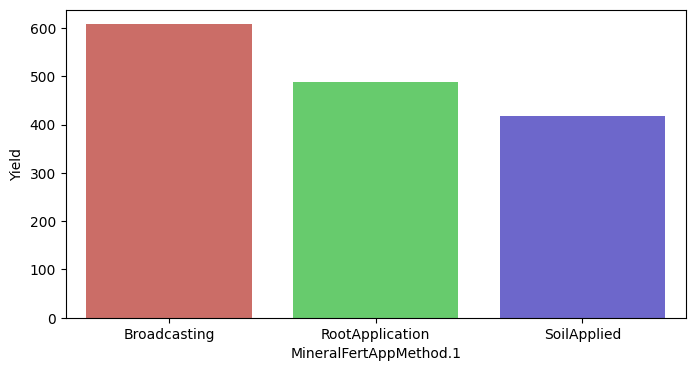

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




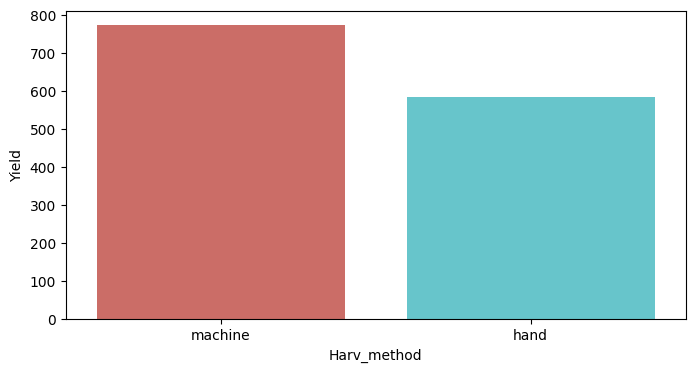

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




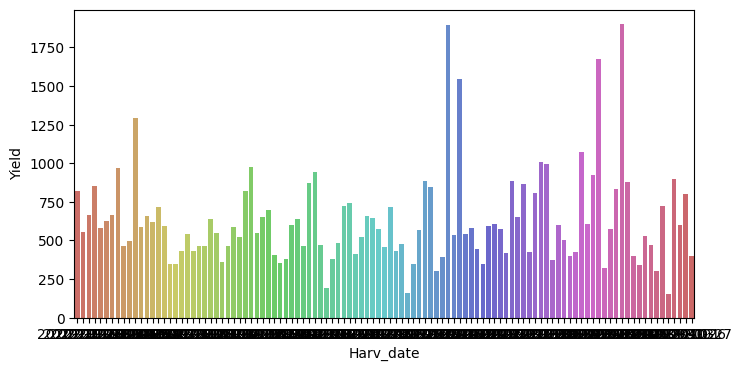

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




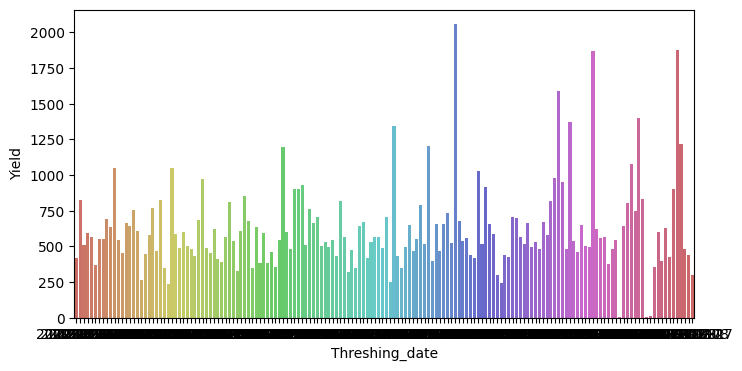

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




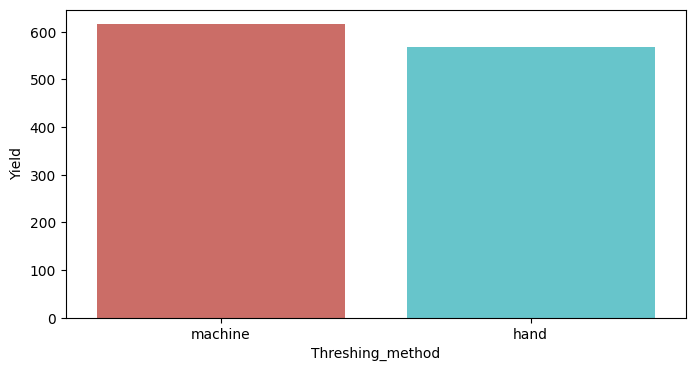

<ipython-input-83-01cd9cebe9ac>:4: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




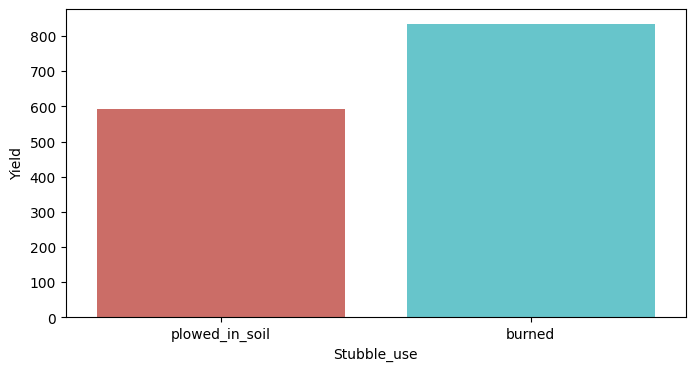

In [ ]:
for i in numeric_col:
  for j in object_col:
    plt.figure(figsize = (8, 4))
    sns.barplot(x = df[j], y = df[i], data = df, ci = None, palette = 'hls')
    plt.show()

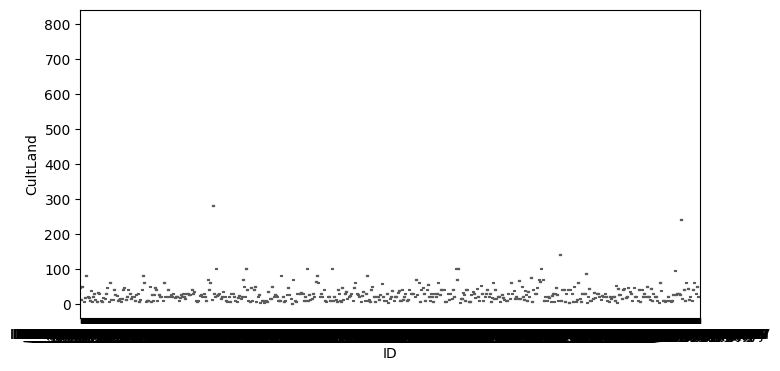

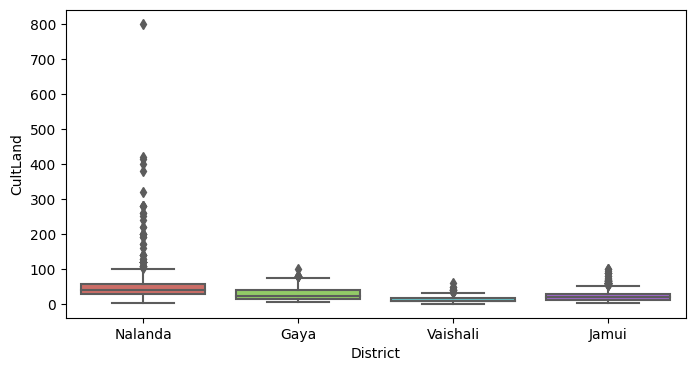

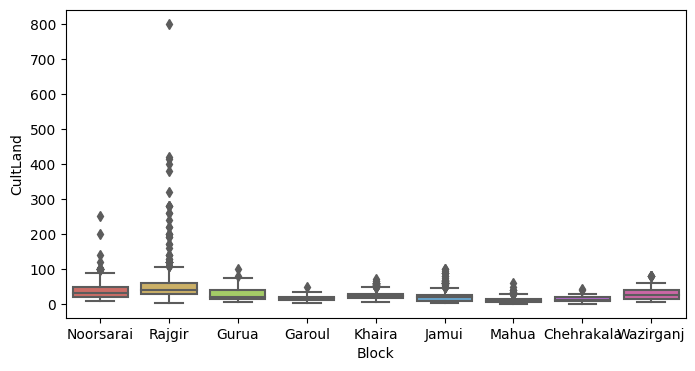

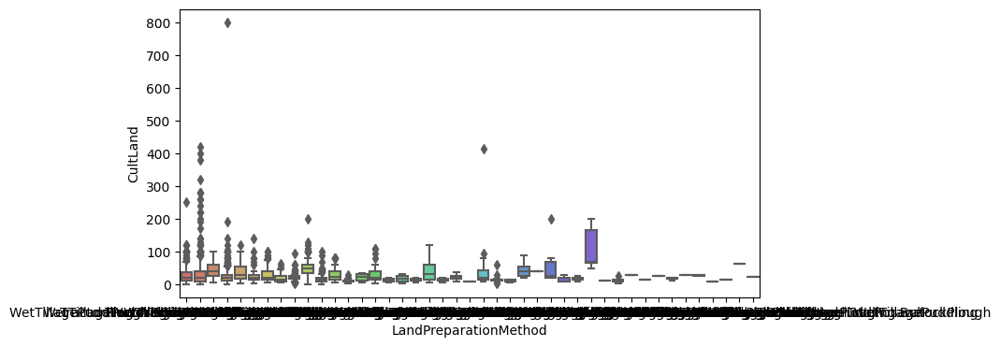

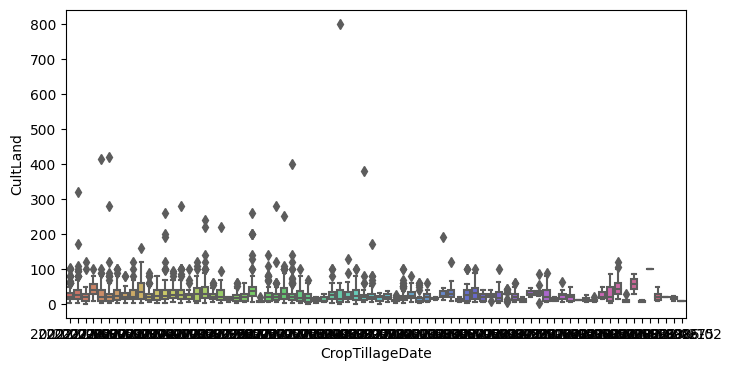

...

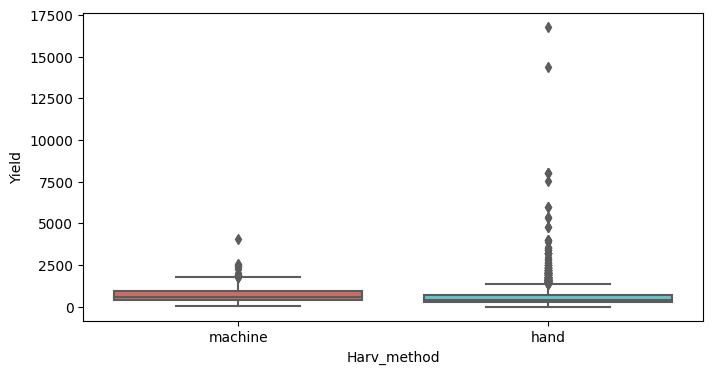

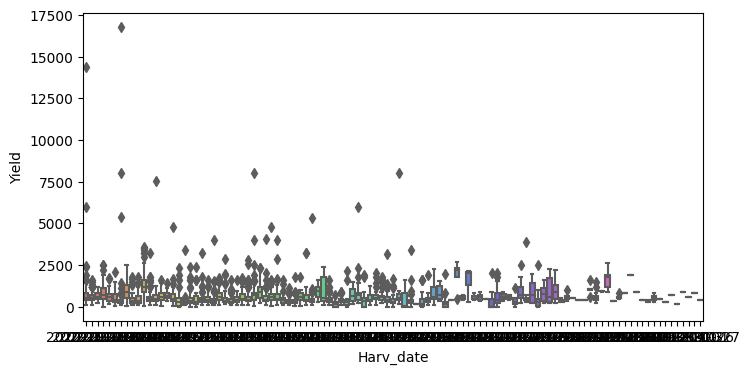

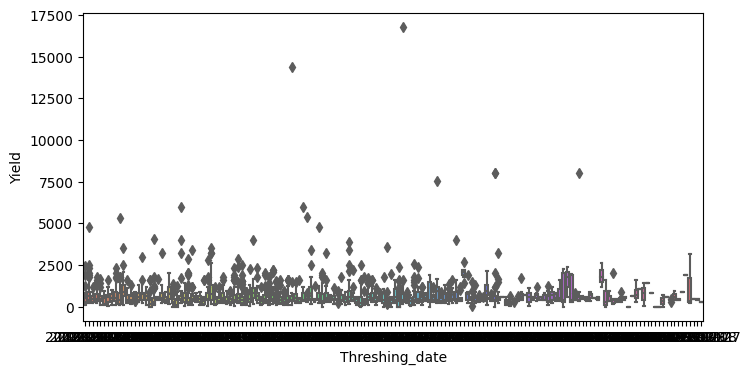

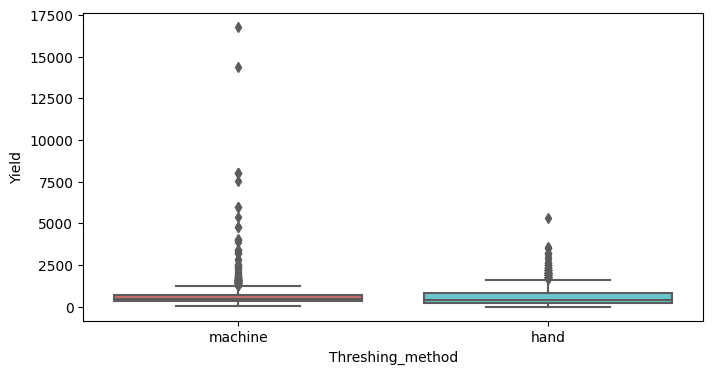

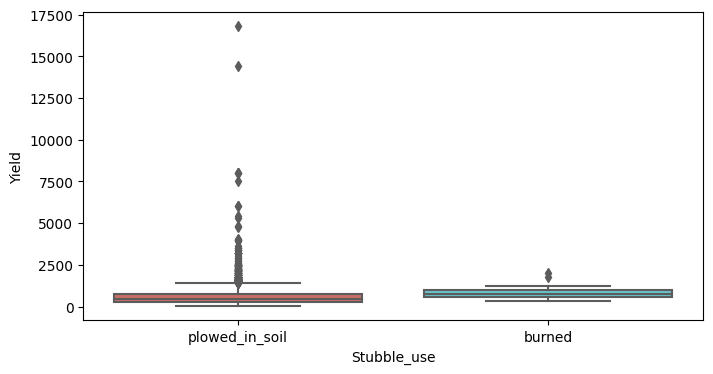

In [ ]:
for i in numeric_col:
  for j in object_col:
    plt.figure(figsize = (8, 4))
    sns.boxplot(x = df[j], y = df[i], data = df, palette = 'hls')
    plt.show()

<ipython-input-86-b9cc1292ab28>:2: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.



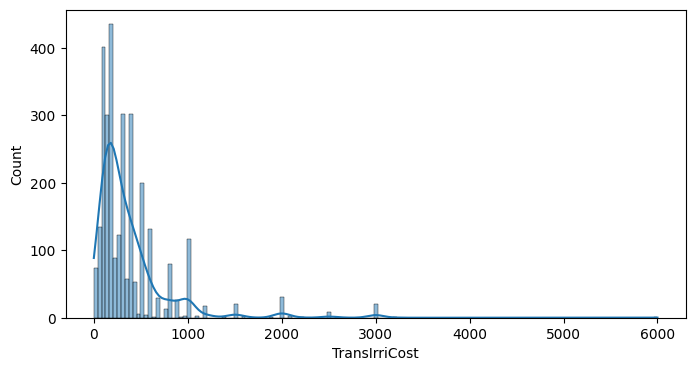

In [ ]:
plt.figure(figsize = (8, 4))
sns.histplot(df['TransIrriCost'], kde = True, palette = 'hls')
plt.xticks(rotation = 0)
plt.show()

Finding the Relevent features

In [ ]:
corr= df.corr()
corr

<ipython-input-56-63764c9a1354>:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



,CultLand,CropCultLand,CropTillageDepth,SeedlingsPerPit,TransplantingIrrigationHours,TransIrriCost,StandingWater,Ganaura,CropOrgFYM,NoFertilizerAppln,...,BasalUrea,1tdUrea,1appDaysUrea,2tdUrea,2appDaysUrea,Harv_hand_rent,Residue_length,Residue_perc,Acre,Yield
CultLand,1.000000,0.969350,0.024248,-0.048345,0.017224,-0.026350,0.171613,0.017384,0.004560,-0.042980,...,0.377142,0.449973,0.169518,0.287679,0.046797,0.093408,-0.117823,0.381639,0.409604,0.254201
CropCultLand,0.969350,1.000000,0.035786,-0.043010,0.008620,-0.009245,0.203042,0.024456,0.046272,-0.066414,...,0.359221,0.437093,0.182472,0.178640,0.050996,0.068229,-0.119789,0.370456,0.394070,0.246221
CropTillageDepth,0.024248,0.035786,1.000000,-0.048160,0.013533,-0.164576,-0.132753,0.179586,0.208100,-0.121384,...,0.034944,0.013097,0.216424,-0.162743,-0.032072,0.039687,-0.027913,-0.167916,-0.001449,-0.002953
SeedlingsPerPit,-0.048345,-0.043010,-0.048160,1.000000,-0.004252,0.037066,-0.013302,-0.020345,0.071110,-0.033294,...,-0.072365,-0.031459,-0.024683,-0.048817,0.017489,-0.023879,0.033023,-0.018989,-0.033684,-0.023557
TransplantingIrrigationHours,0.017224,0.008620,0.013533,-0.004252,1.000000,0.125979,-0.068434,0.014478,0.026567,0.035796,...,0.036301,0.022539,0.003003,0.019404,-0.127031,0.015802,0.041072,0.006777,0.017651,-0.007763
TransIrriCost,-0.026350,-0.009245,-0.164576,0.037066,0.125979,1.000000,-0.169588,-0.120001,0.606718,0.045348,...,0.286765,0.122852,-0.168597,0.145310,-0.110523,0.098437,0.062878,-0.019887,0.381061,0.274761
StandingWater,0.171613,0.203042,-0.132753,-0.013302,-0.068434,-0.169588,1.000000,-0.129067,-0.057793,-0.269534,...,0.053836,0.156344,0.285711,0.006033,0.194153,-0.003548,-0.169711,0.020989,0.031833,0.000103
Ganaura,0.017384,0.024456,0.179586,-0.020345,0.014478,-0.120001,-0.129067,1.000000,0.647287,-0.068061,...,-0.102336,-0.076371,-0.103807,0.042108,0.005574,-0.023180,-0.273999,0.014435,-0.088846,-0.040204
CropOrgFYM,0.004560,0.046272,0.208100,0.071110,0.026567,0.606718,-0.057793,0.647287,1.000000,-0.223009,...,0.461624,0.281865,-0.109821,0.311710,0.086100,0.132168,-0.099817,-0.019349,0.447550,0.372322
NoFertilizerAppln,-0.042980,-0.066414,-0.121384,-0.033294,0.035796,0.045348,-0.269534,-0.068061,-0.223009,1.000000,...,-0.098576,-0.306572,-0.125879,-0.003029,-0.013039,-0.005958,0.195066,-0.029513,-0.011640,-0.020704


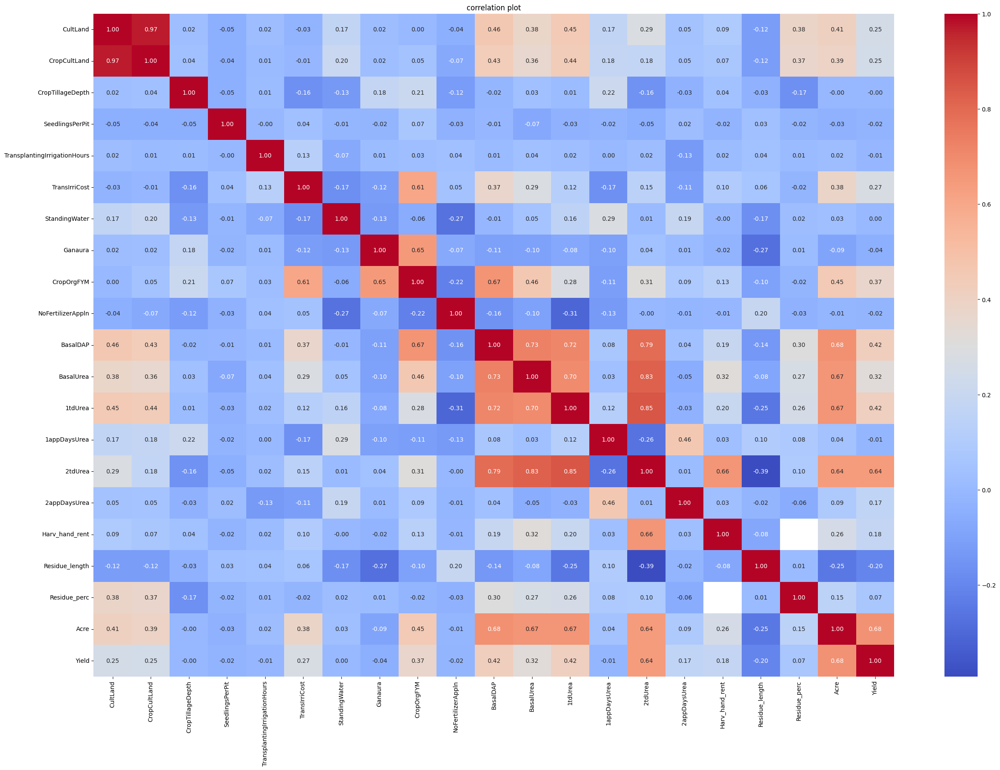

In [ ]:
#heatmap
plt.figure(figsize = (30, 20))
sns.heatmap(corr, annot = True, cmap = 'coolwarm', fmt = '.2f')
plt.title('correlation plot')
plt.show()

In [ ]:
good_features = corr[corr['Yield'].abs() > correlation_threshold]['Yield'].index.tolist()
good_features

In [ ]:
# Select relevant features
selected_features = ['CropCultLand', 'TransplantingIrrigationHours', 'StandingWater',
                     'OrgFertilizers', 'CropbasalFerts', 'BasalDAP', 'BasalUrea',
                     'FirstTopDressFert', '1tdUrea', '2tdUrea', 'Yield']

# Creating new features if needed
# creating a feature for total fertilizer applied.
data['TotalFertilizer'] = data['BasalDAP'] + data['BasalUrea'] + data['1tdUrea'] + data['2tdUrea']

# Update the selected_features list
selected_features.append('TotalFertilizer')

# Subset the data with selected features
data = data[selected_features]
data.shape

(5160, 12)

In [ ]:
categorical_columns = data.select_dtypes(include=['object']).columns
print(categorical_columns)

Index(['OrgFertilizers', 'CropbasalFerts', 'FirstTopDressFert'], dtype='object')


In [ ]:
# Example: One-hot encode 'CropbasalFerts' if it's categorical
data_encoded = pd.get_dummies(data, columns=['CropbasalFerts'])
# why only this

Making Model

In [ ]:
from sklearn.model_selection import train_test_split

X_encoded = data_encoded.drop('Yield', axis=1)
y_encoded = data_encoded['Yield']

X_train_encoded, X_test_encoded, y_train_encoded, y_test_encoded = train_test_split(X_encoded, y_encoded, test_size=0.2, random_state=42)


In [ ]:
for column in categorical_columns:
    unique_values = data[column].unique()
    print(f"Unique values in {column}: {unique_values}")


Unique values in OrgFertilizers: ['Ganaura' 'Ganaura FYM' 'FYM' 'VermiCompost'
 'Ganaura Pranamrit Ghanajeevamrit' 'FYM VermiCompost'
 'Ganaura Ghanajeevamrit' 'Ghanajeevamrit Ganaura FYM'
 'Ganaura FYM Ghanajeevamrit' 'FYM Ganaura' 'Pranamrit'
 'FYM Ganaura VermiCompost' 'Ganaura FYM VermiCompost' 'Jeevamrit'
 'VermiCompost FYM' 'Ganaura FYM VermiCompost Ghanajeevamrit'
 'Ganaura FYM PoultryManure' 'Ghanajeevamrit Ganaura' 'PoultryManure'
 'Ganaura VermiCompost FYM' 'Ganaura PoultryManure'
 'Ganaura Ghanajeevamrit VermiCompost' 'FYM Ghanajeevamrit'
 'Ghanajeevamrit FYM Ganaura' 'Ganaura Ghanajeevamrit FYM'
 'Ganaura FYM PoultryManure VermiCompost' 'Ganaura Pranamrit'
 'Ganaura VermiCompost Ghanajeevamrit' 'Ganaura Pranamrit FYM'
 'Ganaura Jeevamrit' 'Ganaura FYM Ghanajeevamrit VermiCompost'
 'FYM Ganaura Ghanajeevamrit' 'Ghanajeevamrit'
 'Ganaura Ghanajeevamrit FYM Pranamrit' 'Pranamrit Ganaura Ghanajeevamrit'
 'FYM Ghanajeevamrit Ganaura']
Unique values in CropbasalFerts: ['Urea' 'DA

In [ ]:
data['Has_DAP'] = data['CropbasalFerts'].apply(lambda x: 1 if 'DAP' in x else 0)
data['Has_Urea'] = data['CropbasalFerts'].apply(lambda x: 1 if 'Urea' in x else 0)

In [ ]:
data['Has_Urea_FTD'] = data['FirstTopDressFert'].apply(lambda x: 1 if 'Urea' in x else 0)
data['Has_DAP_FTD'] = data['FirstTopDressFert'].apply(lambda x: 1 if 'DAP' in x else 0)

In [ ]:
# Drop OrgFertilizers column
data.drop(columns=['OrgFertilizers'], inplace=True)

# Create binary columns for CropbasalFerts
data['Has_DAP'] = data['CropbasalFerts'].apply(lambda x: 1 if 'DAP' in x else 0)
data['Has_Urea'] = data['CropbasalFerts'].apply(lambda x: 1 if 'Urea' in x else 0)
data.drop(columns=['CropbasalFerts'], inplace=True)

# Create binary columns for FirstTopDressFert
data['Has_Urea_FTD'] = data['FirstTopDressFert'].apply(lambda x: 1 if 'Urea' in x else 0)
data['Has_DAP_FTD'] = data['FirstTopDressFert'].apply(lambda x: 1 if 'DAP' in x else 0)
data.drop(columns=['FirstTopDressFert'], inplace=True)

In [ ]:
from sklearn.model_selection import train_test_split

X = data.drop('Yield', axis=1)
y = data['Yield']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [ ]:
from sklearn.linear_model import LinearRegression
# Initialize the model
model = LinearRegression()

# Train the model
model.fit(X_train, y_train)


LinearRegression()

In [ ]:
from sklearn.metrics import r2_score

# Assuming y_true and y_pred are two arrays
y_true = [1, 2, 3, 4]  # Example true values
y_pred = [1.5, 2.2, 2.8, 3.5]  # Example predicted values

# Calculate R2 score
r2 = r2_score(y_true, y_pred)
print("R-squared (R2) Score:", r2)

# Map the R2 score to a percentage scale (if needed)
accuracy = max(0, min(100, (r2 * 100)))  # Constrain the value between 0% and 100%
print("Accuracy:", accuracy, "%")


R-squared (R2) Score: 0.884
Accuracy: 88.4 %


In [ ]:
import joblib

# Save your model to a file (replace 'your_model.pkl' with your chosen filename)
joblib.dump(model, 'irrigationOptimization.pkl')


['irrigationOptimization.pkl']

In [ ]:
import pickle
with open("irrigationOptimization.pkl", "rb") as file:
    model = pickle.load(file)

In [ ]:
import os

# List files in the current directory
files = os.listdir()
print(files)


['.config', 'Test.csv', 'irrigationOptimization.pkl', 'Train.csv', 'sample_data']


In [ ]:
from google.colab import files

# Specify the filename you want to download
filename = 'irrigationOptimization.pkl'

# Download the file to your local machine
files.download(filename)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>